In [44]:
import numpy as np
import os
import torch
from sklearn.model_selection import train_test_split, StratifiedKFold, StratifiedGroupKFold
from torch.utils.data import DataLoader, Subset
import torch.nn as nn
from torch.utils.tensorboard import SummaryWriter
import timm
import timm.data
import timm.loss
import timm.optim
import timm.utils
from timm.scheduler import CosineLRScheduler
import albumentations as A
import torchvision.datasets as datasets
import utils
import training_funcs
from albumentations.pytorch.transforms import ToTensorV2 
import torchvision.transforms as transforms
from pathlib import Path
import torchvision.datasets as datasets
from custom_model import ConvNet

Now Let's Train my custom Model ConvNet()

In [17]:
from custom_model import ConvNet

In [18]:
utils.seed_everything(420)  # seed random number generator (To make everything deterministic/reproducible)
device = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')
# device = 'cpu'
print(device)

#Basic setup


path=r"C:\Users\satya\Downloads\Cifar10"

transform_train= transforms.Compose([
    transforms.ToTensor(),
    transforms.RandomHorizontalFlip(p=0.5),
    transforms.Normalize(mean=(0.4913997551666284, 0.48215855929893703, 0.4465309133731618),std=(0.24703225141799082, 0.24348516474564, 0.26158783926049628)),
])

transform_val = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize(mean=(0.4913997551666284, 0.48215855929893703, 0.4465309133731618),std=(0.24703225141799082, 0.24348516474564, 0.26158783926049628)),
])

# Load CIFAR-10 dataset
cifar10_train = datasets.CIFAR10(root=path, train=True, download=True, transform=transform_train)
cifar10_test = datasets.CIFAR10(root=path, train=False, download=True, transform=transform_val)

# Extract digit classes (0-9)
digit_classes = [0, 1, 2, 3, 4, 5, 6, 7, 8, 9]

# Create subsets for digits
train_indices = [i for i, (_, label) in enumerate(cifar10_train) if label in digit_classes]
train_labels = [cifar10_train.targets[i] for i in train_indices]

# Perform stratified split into train and validation sets
train_indices, val_indices = train_test_split(
    train_indices,
    test_size=0.2,
    stratify=train_labels,
    random_state=42
)

#Model selection and parameters

model_name = 'Custom_ConvNet'
run = 'ConvNet'
num_classes = 10

# model = timm.create_model('resnet50', num_classes=num_classes, pretrained=True)
model = ConvNet()
# model= nn.DataParallel(model)

model=model.to(device)
for params in model.parameters():
    params.requires_grad = True

print(f'Model Name : ',model_name)
print(f"Total number of trainable parameters in model {sum(p.numel() for p in model.parameters() if p.requires_grad is True)}")

#Hyperparameters

batch_size = 128
# lr = 0.0001
lr = 1e-4
num_epochs = 100
grad_accum = 1

#Loss Function
criterion = nn.CrossEntropyLoss().to(device=device)
#Optimizer
optimizer = timm.optim.AdamW(model.parameters(), lr = lr)
#Scheduler
scheduler = timm.scheduler.CosineLRScheduler(optimizer, t_initial = num_epochs, lr_min = 1e-6)
#scaler
scaler = torch.amp.GradScaler()

# #Data and paths set up

train_subset = Subset(cifar10_train, train_indices)
val_subset = Subset(cifar10_train, val_indices)

# Create DataLoaders
train_loader = DataLoader(train_subset, batch_size=batch_size, shuffle=True)
val_loader = DataLoader(val_subset, batch_size=batch_size, shuffle=False)


# base_path = "D:\\Experiments"
base_path = r"C:\Users\satya\Downloads\New"
iteration='3'


#Model details and tensorboard
training_des = 'with_overlay'

tb_path = f'TB_data_iteration_{iteration}_{model_name}_{training_des}_effective_bs:_{batch_size*grad_accum}_epochs:_{num_epochs}'

writer_train = SummaryWriter(os.path.join(base_path, 'tensorboard_logs\\'  f'Iteration_{iteration}' + '_train'))
writer_val = SummaryWriter(os.path.join(base_path, 'tensorboard_logs\\' + f'Iteration_{iteration}' + '_val'))

if not os.path.exists(os.path.join(base_path, 'tensorboard_logs')):
    os.mkdir(os.path.join(base_path, 'tensorboard_logs'))

#Model saving path
save_dir = os.path.join(base_path,'training_weights')
if not os.path.exists(save_dir):
    os.mkdir(save_dir)

resume = False # Setting resume variable true to resume training from last epoch trained
resume_checkpoint = None
##Ensure the base_path for checkpoint. This is to ensure the tensorboard logs are correct
if resume:
    assert os.path.isfile(resume_checkpoint), 'The path does not exist'
    checkpoint = torch.load(resume_checkpoint)
    model.load_state_dict(checkpoint['model_state_dict'])
    optimizer.load_state_dict(checkpoint['opt_state_dict'])
    scaler.load_state_dict(checkpoint['scalar_state'])
    scheduler.load_state_dict(checkpoint['scheduler_state'])
    start_epoch = checkpoint['epoch'] + 1
    min_loss_diff = checkpoint['min_loss_diff']
    min_loss_mean = checkpoint['min_loss_mean']

else:
    start_epoch = 0
    min_loss_diff = 1000
    min_loss_mean = 1000


cuda:0
Files already downloaded and verified
Files already downloaded and verified
Model Name :  Custom_ConvNet
Total number of trainable parameters in model 2791434


[Epoch: 1 training...]


(Epoch 1 | 313/313) | Data: 0.056s | Batch: 0.101s | Loss: 2.0685 | GPU usage: 0.800 GB: 100%|██████████| 313/313 [00:31<00:00,  9.89it/s]

learning rate is 0.0001
training loss: 2.06817
training accuracy: 0.23125
training precision: 0.23407
training recall: 0.23125
training F1-Score: 0.20732


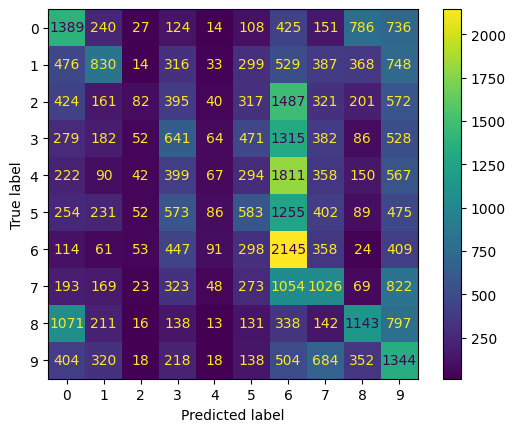

validation...


(Epoch 1 | 79/79) | Data: 0.053s | Batch: 0.069s | Loss: 1.8633| GPU usage: 0.780 GB: 100%|██████████| 79/79 [00:05<00:00, 14.26it/s]


validation loss: 1.86210
validation accuracy: 0.33489
validation precision: 0.31340
validation recall: 0.31340
validation F1-Score: 0.27918
[Epoch: 2 training...]


(Epoch 2 | 313/313) | Data: 0.055s | Batch: 0.099s | Loss: 1.7793 | GPU usage: 0.846 GB: 100%|██████████| 313/313 [00:31<00:00, 10.03it/s]


learning rate is 9.997557473810373e-05
training loss: 1.77927
training accuracy: 0.35168
training precision: 0.34467
training recall: 0.35168
training F1-Score: 0.34046


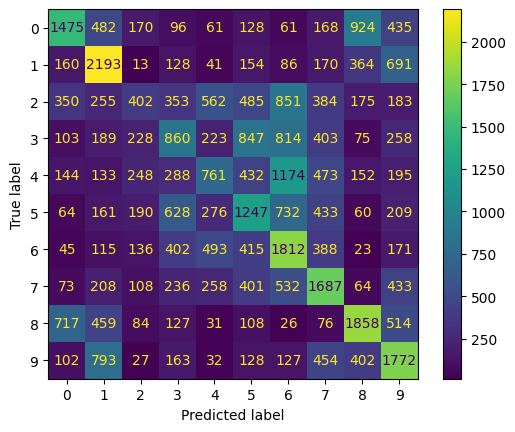

validation...


(Epoch 2 | 79/79) | Data: 0.056s | Batch: 0.075s | Loss: 1.6531| GPU usage: 0.846 GB: 100%|██████████| 79/79 [00:06<00:00, 13.04it/s]


validation loss: 1.65091
validation accuracy: 0.40051
validation precision: 0.40560
validation recall: 0.40560
validation F1-Score: 0.39182
[Epoch: 3 training...]


(Epoch 3 | 313/313) | Data: 0.054s | Batch: 0.095s | Loss: 1.6474 | GPU usage: 0.846 GB: 100%|██████████| 313/313 [00:29<00:00, 10.55it/s]


learning rate is 9.990232305719945e-05
training loss: 1.64746
training accuracy: 0.40360
training precision: 0.39580
training recall: 0.40360
training F1-Score: 0.39576


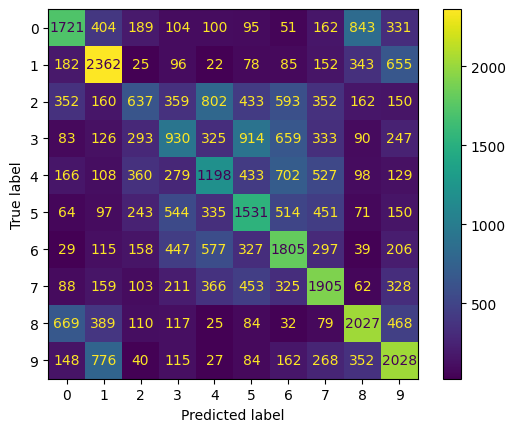

validation...


(Epoch 3 | 79/79) | Data: 0.056s | Batch: 0.077s | Loss: 1.5473| GPU usage: 0.846 GB: 100%|██████████| 79/79 [00:06<00:00, 12.72it/s]


validation loss: 1.54430
validation accuracy: 0.43312
validation precision: 0.43970
validation recall: 0.43970
validation F1-Score: 0.42809
[Epoch: 4 training...]


(Epoch 4 | 313/313) | Data: 0.054s | Batch: 0.093s | Loss: 1.5767 | GPU usage: 0.846 GB: 100%|██████████| 313/313 [00:29<00:00, 10.71it/s]


learning rate is 9.978031724785247e-05
training loss: 1.57690
training accuracy: 0.43238
training precision: 0.42489
training recall: 0.43237
training F1-Score: 0.42616


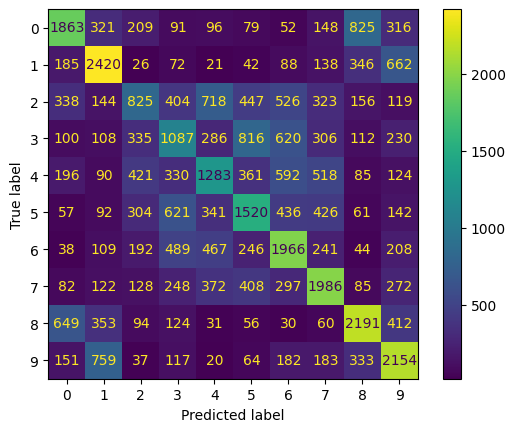

validation...


(Epoch 4 | 79/79) | Data: 0.056s | Batch: 0.075s | Loss: 1.4876| GPU usage: 0.846 GB: 100%|██████████| 79/79 [00:05<00:00, 13.24it/s]


validation loss: 1.48496
validation accuracy: 0.45481
validation precision: 0.46150
validation recall: 0.46150
validation F1-Score: 0.45259
[Epoch: 5 training...]


(Epoch 5 | 313/313) | Data: 0.054s | Batch: 0.091s | Loss: 1.5151 | GPU usage: 0.846 GB: 100%|██████████| 313/313 [00:28<00:00, 10.92it/s]


learning rate is 9.960967771506667e-05
training loss: 1.51517
training accuracy: 0.45320
training precision: 0.44625
training recall: 0.45320
training F1-Score: 0.44804


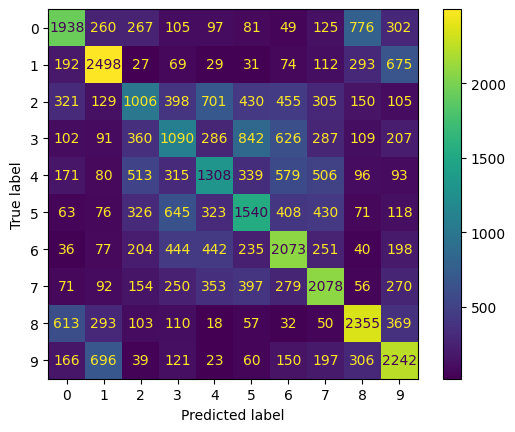

validation...


(Epoch 5 | 79/79) | Data: 0.058s | Batch: 0.081s | Loss: 1.4372| GPU usage: 0.846 GB: 100%|██████████| 79/79 [00:06<00:00, 12.19it/s]


validation loss: 1.43406
validation accuracy: 0.47418
validation precision: 0.47960
validation recall: 0.47960
validation F1-Score: 0.47280
[Epoch: 6 training...]


(Epoch 6 | 313/313) | Data: 0.055s | Batch: 0.100s | Loss: 1.4695 | GPU usage: 0.846 GB: 100%|██████████| 313/313 [00:31<00:00,  9.93it/s]


learning rate is 9.939057285945933e-05
training loss: 1.46947
training accuracy: 0.47492
training precision: 0.46874
training recall: 0.47492
training F1-Score: 0.47048


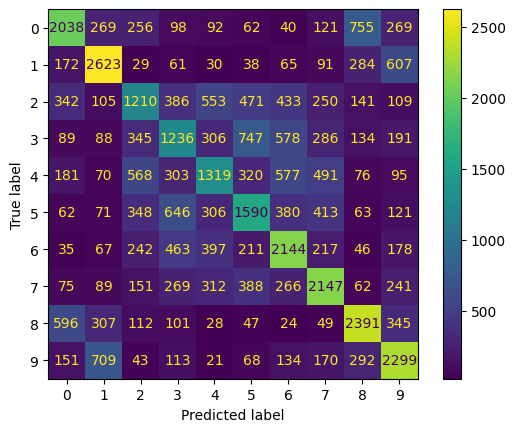

validation...


(Epoch 6 | 79/79) | Data: 0.059s | Batch: 0.082s | Loss: 1.3951| GPU usage: 0.846 GB: 100%|██████████| 79/79 [00:06<00:00, 12.01it/s]


validation loss: 1.39179
validation accuracy: 0.48837
validation precision: 0.49330
validation recall: 0.49330
validation F1-Score: 0.48773
saving with validation loss of 1.3917948007583618
[Epoch: 7 training...]


(Epoch 7 | 313/313) | Data: 0.054s | Batch: 0.090s | Loss: 1.4279 | GPU usage: 0.846 GB: 100%|██████████| 313/313 [00:28<00:00, 11.06it/s]


learning rate is 9.91232189110701e-05
training loss: 1.42785
training accuracy: 0.48645
training precision: 0.48009
training recall: 0.48645
training F1-Score: 0.48215


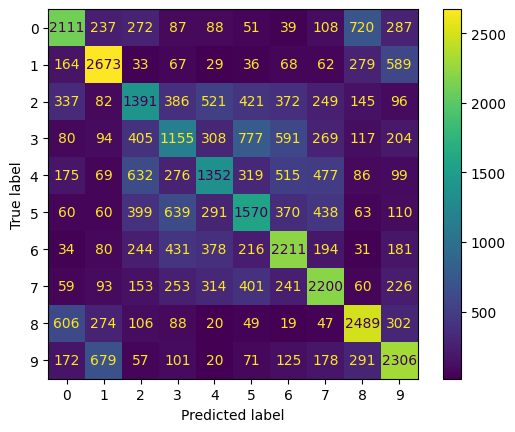

validation...


(Epoch 7 | 79/79) | Data: 0.058s | Batch: 0.078s | Loss: 1.3560| GPU usage: 0.846 GB: 100%|██████████| 79/79 [00:06<00:00, 12.60it/s]


validation loss: 1.35269
validation accuracy: 0.51283
validation precision: 0.51730
validation recall: 0.51730
validation F1-Score: 0.51178
saving with validation loss of 1.3526936769485474
[Epoch: 8 training...]


(Epoch 8 | 313/313) | Data: 0.055s | Batch: 0.100s | Loss: 1.3902 | GPU usage: 0.846 GB: 100%|██████████| 313/313 [00:31<00:00,  9.98it/s]


learning rate is 9.8807879715968e-05
training loss: 1.39034
training accuracy: 0.50215
training precision: 0.49635
training recall: 0.50215
training F1-Score: 0.49829


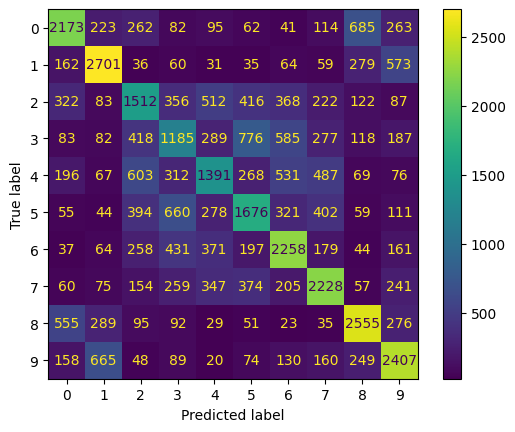

validation...


(Epoch 8 | 79/79) | Data: 0.057s | Batch: 0.076s | Loss: 1.3240| GPU usage: 0.846 GB: 100%|██████████| 79/79 [00:06<00:00, 13.00it/s]


validation loss: 1.32168
validation accuracy: 0.51656
validation precision: 0.52160
validation recall: 0.52160
validation F1-Score: 0.51649
saving with validation loss of 1.3216801881790161
[Epoch: 9 training...]


(Epoch 9 | 313/313) | Data: 0.056s | Batch: 0.100s | Loss: 1.3531 | GPU usage: 0.846 GB: 100%|██████████| 313/313 [00:31<00:00,  9.93it/s]


learning rate is 9.844486647586725e-05
training loss: 1.35296
training accuracy: 0.51643
training precision: 0.51115
training recall: 0.51643
training F1-Score: 0.51301


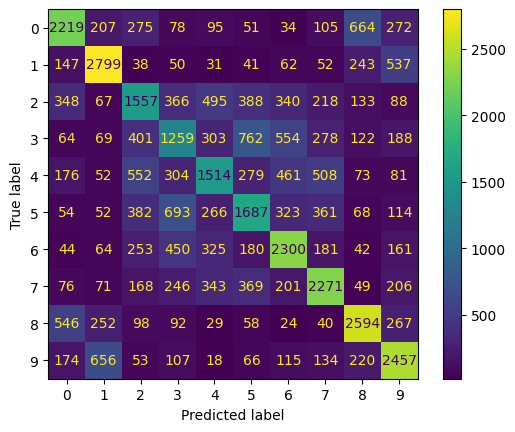

validation...


(Epoch 9 | 79/79) | Data: 0.055s | Batch: 0.074s | Loss: 1.2863| GPU usage: 0.846 GB: 100%|██████████| 79/79 [00:05<00:00, 13.32it/s]


validation loss: 1.28353
validation accuracy: 0.53344
validation precision: 0.53860
validation recall: 0.53860
validation F1-Score: 0.53366
saving with validation loss of 1.2835339307785034
[Epoch: 10 training...]


(Epoch 10 | 313/313) | Data: 0.056s | Batch: 0.104s | Loss: 1.3169 | GPU usage: 0.846 GB: 100%|██████████| 313/313 [00:32<00:00,  9.55it/s]


learning rate is 9.803453744100869e-05
training loss: 1.31697
training accuracy: 0.52868
training precision: 0.52367
training recall: 0.52868
training F1-Score: 0.52535


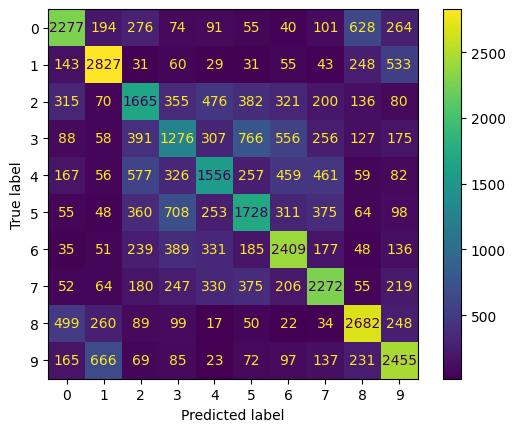

validation...


(Epoch 10 | 79/79) | Data: 0.055s | Batch: 0.075s | Loss: 1.2505| GPU usage: 0.846 GB: 100%|██████████| 79/79 [00:05<00:00, 13.22it/s]


validation loss: 1.24892
validation accuracy: 0.55019
validation precision: 0.55520
validation recall: 0.55520
validation F1-Score: 0.55065
saving with validation loss of 1.2489209175109863
[Epoch: 11 training...]


(Epoch 11 | 313/313) | Data: 0.056s | Batch: 0.104s | Loss: 1.2848 | GPU usage: 0.846 GB: 100%|██████████| 313/313 [00:32<00:00,  9.57it/s]


learning rate is 9.757729755661011e-05
training loss: 1.28490
training accuracy: 0.54317
training precision: 0.53795
training recall: 0.54317
training F1-Score: 0.53983


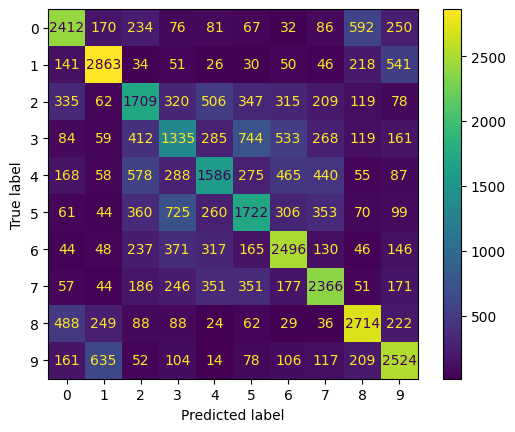

validation...


(Epoch 11 | 79/79) | Data: 0.057s | Batch: 0.076s | Loss: 1.2194| GPU usage: 0.846 GB: 100%|██████████| 79/79 [00:06<00:00, 13.02it/s]


validation loss: 1.21629
validation accuracy: 0.55802
validation precision: 0.56310
validation recall: 0.56310
validation F1-Score: 0.55870
saving with validation loss of 1.2162927389144897
[Epoch: 12 training...]


(Epoch 12 | 313/313) | Data: 0.055s | Batch: 0.094s | Loss: 1.2468 | GPU usage: 0.846 GB: 100%|██████████| 313/313 [00:29<00:00, 10.59it/s]


learning rate is 9.707359806323417e-05
training loss: 1.24697
training accuracy: 0.55663
training precision: 0.55164
training recall: 0.55662
training F1-Score: 0.55346


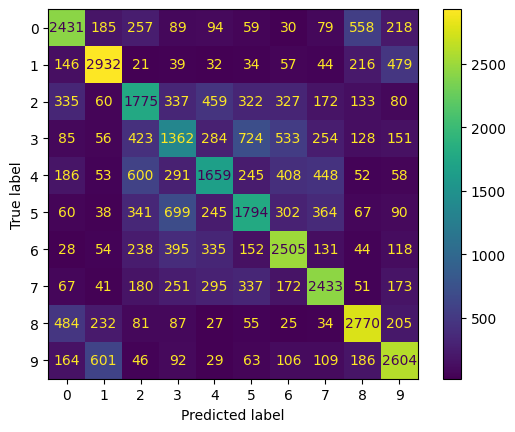

validation...


(Epoch 12 | 79/79) | Data: 0.056s | Batch: 0.073s | Loss: 1.1892| GPU usage: 0.846 GB: 100%|██████████| 79/79 [00:05<00:00, 13.48it/s]


validation loss: 1.18614
validation accuracy: 0.57430
validation precision: 0.57900
validation recall: 0.57900
validation F1-Score: 0.57527
saving with validation loss of 1.1861388683319092
[Epoch: 13 training...]


(Epoch 13 | 313/313) | Data: 0.056s | Batch: 0.098s | Loss: 1.2194 | GPU usage: 0.846 GB: 100%|██████████| 313/313 [00:30<00:00, 10.23it/s]


learning rate is 9.652393605146844e-05
training loss: 1.21941
training accuracy: 0.56925
training precision: 0.56453
training recall: 0.56925
training F1-Score: 0.56630


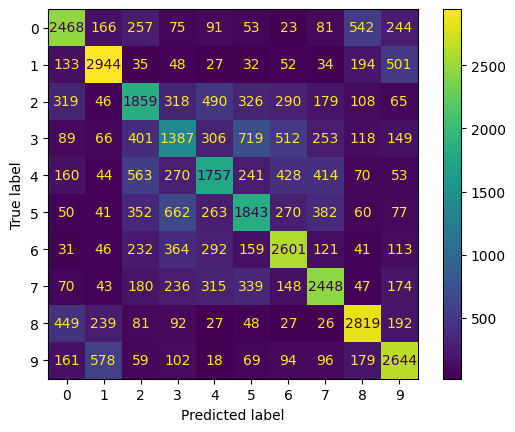

validation...


(Epoch 13 | 79/79) | Data: 0.057s | Batch: 0.077s | Loss: 1.1579| GPU usage: 0.846 GB: 100%|██████████| 79/79 [00:06<00:00, 12.87it/s]


validation loss: 1.15591
validation accuracy: 0.58554
validation precision: 0.59030
validation recall: 0.59030
validation F1-Score: 0.58676
saving with validation loss of 1.1559128761291504
[Epoch: 14 training...]


(Epoch 14 | 313/313) | Data: 0.058s | Batch: 0.101s | Loss: 1.1856 | GPU usage: 0.846 GB: 100%|██████████| 313/313 [00:31<00:00,  9.86it/s]


learning rate is 9.592885397135707e-05
training loss: 1.18557
training accuracy: 0.57870
training precision: 0.57424
training recall: 0.57870
training F1-Score: 0.57591


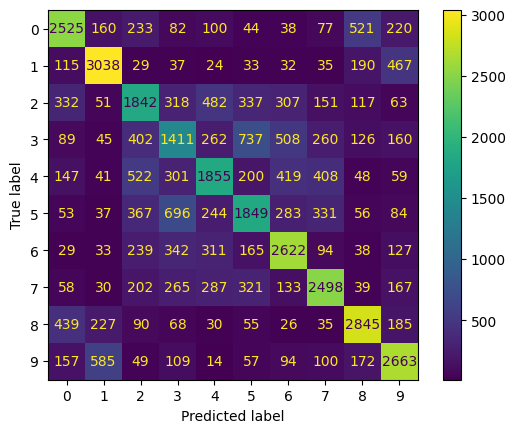

validation...


(Epoch 14 | 79/79) | Data: 0.057s | Batch: 0.077s | Loss: 1.1317| GPU usage: 0.846 GB: 100%|██████████| 79/79 [00:06<00:00, 12.81it/s]


validation loss: 1.12913
validation accuracy: 0.59440
validation precision: 0.59890
validation recall: 0.59890
validation F1-Score: 0.59534
saving with validation loss of 1.1291303634643555
[Epoch: 15 training...]


(Epoch 15 | 313/313) | Data: 0.057s | Batch: 0.099s | Loss: 1.1529 | GPU usage: 0.846 GB: 100%|██████████| 313/313 [00:31<00:00, 10.06it/s]


learning rate is 9.528893909706797e-05
training loss: 1.15330
training accuracy: 0.59165
training precision: 0.58719
training recall: 0.59165
training F1-Score: 0.58891


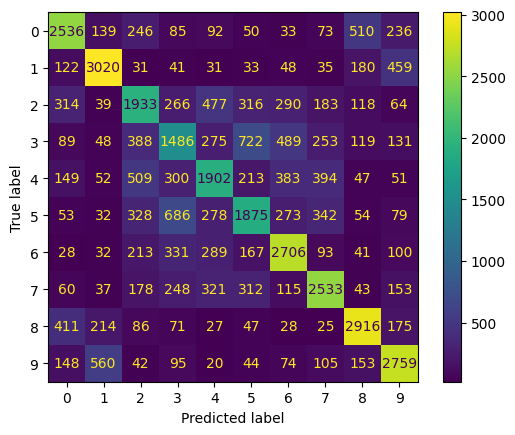

validation...


(Epoch 15 | 79/79) | Data: 0.057s | Batch: 0.076s | Loss: 1.1033| GPU usage: 0.846 GB: 100%|██████████| 79/79 [00:06<00:00, 12.92it/s]


validation loss: 1.10123
validation accuracy: 0.60630
validation precision: 0.61040
validation recall: 0.61040
validation F1-Score: 0.60747
saving with validation loss of 1.1012283563613892
[Epoch: 16 training...]


(Epoch 16 | 313/313) | Data: 0.058s | Batch: 0.103s | Loss: 1.1349 | GPU usage: 0.846 GB: 100%|██████████| 313/313 [00:32<00:00,  9.72it/s]


learning rate is 9.460482294732421e-05
training loss: 1.13485
training accuracy: 0.59755
training precision: 0.59328
training recall: 0.59755
training F1-Score: 0.59491


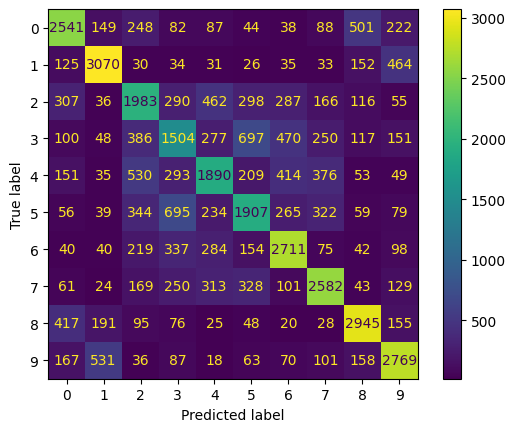

validation...


(Epoch 16 | 79/79) | Data: 0.056s | Batch: 0.079s | Loss: 1.0829| GPU usage: 0.846 GB: 100%|██████████| 79/79 [00:06<00:00, 12.55it/s]


validation loss: 1.08064
validation accuracy: 0.61133
validation precision: 0.61550
validation recall: 0.61550
validation F1-Score: 0.61261
saving with validation loss of 1.0806376934051514
[Epoch: 17 training...]


(Epoch 17 | 313/313) | Data: 0.057s | Batch: 0.101s | Loss: 1.1070 | GPU usage: 0.846 GB: 100%|██████████| 313/313 [00:31<00:00,  9.83it/s]


learning rate is 9.387718066217124e-05
training loss: 1.10711
training accuracy: 0.60855
training precision: 0.60493
training recall: 0.60855
training F1-Score: 0.60639


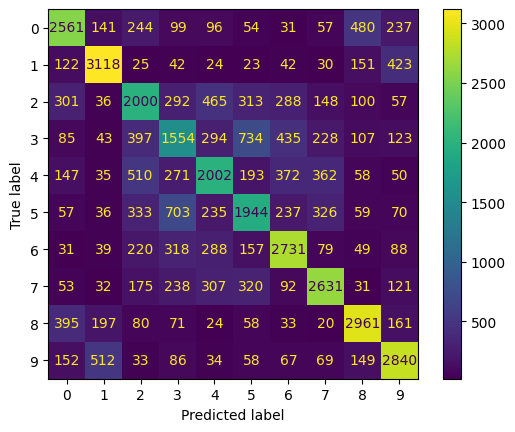

validation...


(Epoch 17 | 79/79) | Data: 0.056s | Batch: 0.072s | Loss: 1.0565| GPU usage: 0.846 GB: 100%|██████████| 79/79 [00:05<00:00, 13.70it/s]


validation loss: 1.05457
validation accuracy: 0.62227
validation precision: 0.62620
validation recall: 0.62620
validation F1-Score: 0.62353
saving with validation loss of 1.054567575454712
[Epoch: 18 training...]


(Epoch 18 | 313/313) | Data: 0.056s | Batch: 0.099s | Loss: 1.0789 | GPU usage: 0.846 GB: 100%|██████████| 313/313 [00:31<00:00, 10.04it/s]


learning rate is 9.310673033669521e-05
training loss: 1.07876
training accuracy: 0.61795
training precision: 0.61406
training recall: 0.61795
training F1-Score: 0.61568


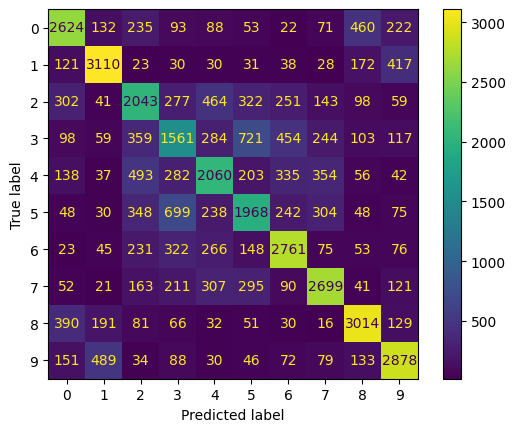

validation...


(Epoch 18 | 79/79) | Data: 0.056s | Batch: 0.075s | Loss: 1.0279| GPU usage: 0.846 GB: 100%|██████████| 79/79 [00:06<00:00, 13.14it/s]


validation loss: 1.02635
validation accuracy: 0.63542
validation precision: 0.63950
validation recall: 0.63950
validation F1-Score: 0.63668
saving with validation loss of 1.0263534784317017
[Epoch: 19 training...]


(Epoch 19 | 313/313) | Data: 0.055s | Batch: 0.100s | Loss: 1.0628 | GPU usage: 0.846 GB: 100%|██████████| 313/313 [00:31<00:00, 10.00it/s]


learning rate is 9.229423231234974e-05
training loss: 1.06276
training accuracy: 0.62460
training precision: 0.62089
training recall: 0.62460
training F1-Score: 0.62243


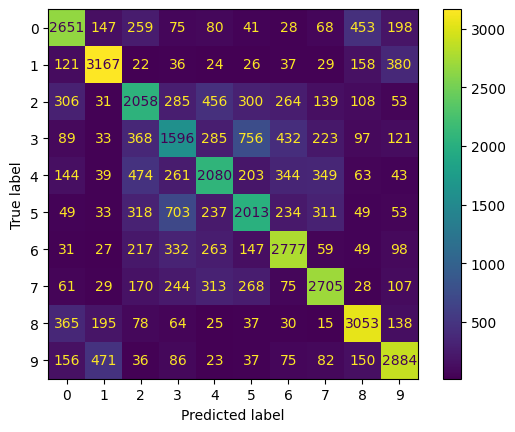

validation...


(Epoch 19 | 79/79) | Data: 0.057s | Batch: 0.077s | Loss: 1.0077| GPU usage: 0.846 GB: 100%|██████████| 79/79 [00:06<00:00, 12.79it/s]


validation loss: 1.00702
validation accuracy: 0.64190
validation precision: 0.64570
validation recall: 0.64570
validation F1-Score: 0.64317
saving with validation loss of 1.0070185661315918
[Epoch: 20 training...]


(Epoch 20 | 313/313) | Data: 0.054s | Batch: 0.095s | Loss: 1.0421 | GPU usage: 0.846 GB: 100%|██████████| 313/313 [00:29<00:00, 10.44it/s]


learning rate is 9.14404884265908e-05
training loss: 1.04223
training accuracy: 0.63360
training precision: 0.63015
training recall: 0.63360
training F1-Score: 0.63152


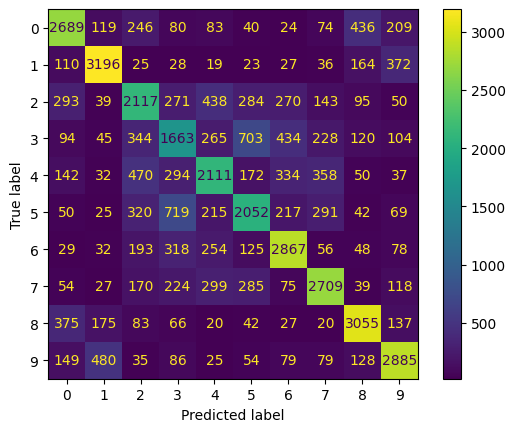

validation...


(Epoch 20 | 79/79) | Data: 0.057s | Batch: 0.080s | Loss: 0.9823| GPU usage: 0.846 GB: 100%|██████████| 79/79 [00:06<00:00, 12.35it/s]


validation loss: 0.98070
validation accuracy: 0.65117
validation precision: 0.65440
validation recall: 0.65440
validation F1-Score: 0.65200
saving with validation loss of 0.9806981682777405
[Epoch: 21 training...]


(Epoch 21 | 313/313) | Data: 0.055s | Batch: 0.096s | Loss: 1.0153 | GPU usage: 0.846 GB: 100%|██████████| 313/313 [00:30<00:00, 10.39it/s]


learning rate is 9.05463412215599e-05
training loss: 1.01530
training accuracy: 0.64202
training precision: 0.63887
training recall: 0.64203
training F1-Score: 0.64020


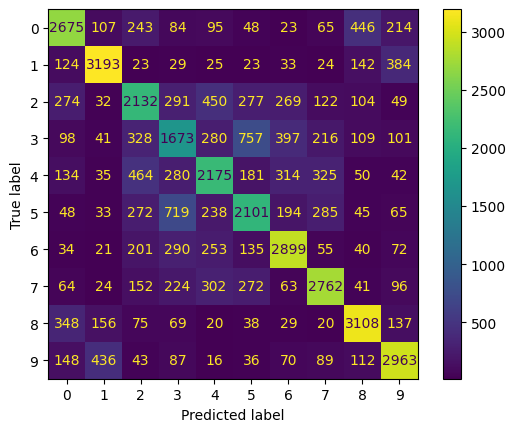

validation...


(Epoch 21 | 79/79) | Data: 0.056s | Batch: 0.077s | Loss: 0.9621| GPU usage: 0.846 GB: 100%|██████████| 79/79 [00:06<00:00, 12.78it/s]


validation loss: 0.96087
validation accuracy: 0.65658
validation precision: 0.66040
validation recall: 0.66040
validation F1-Score: 0.65780
saving with validation loss of 0.960869550704956
[Epoch: 22 training...]


(Epoch 22 | 313/313) | Data: 0.055s | Batch: 0.097s | Loss: 1.0034 | GPU usage: 0.846 GB: 100%|██████████| 313/313 [00:30<00:00, 10.25it/s]


learning rate is 8.961267311259668e-05
training loss: 1.00330
training accuracy: 0.64418
training precision: 0.64126
training recall: 0.64417
training F1-Score: 0.64248


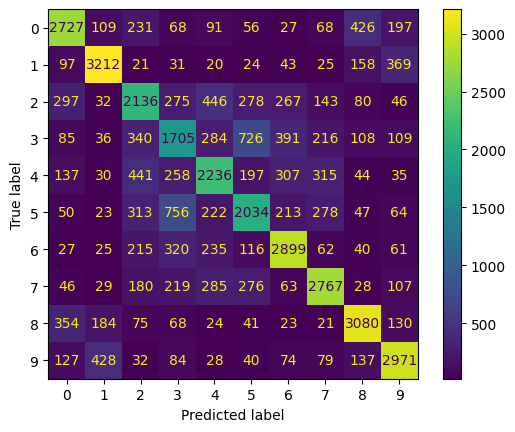

validation...


(Epoch 22 | 79/79) | Data: 0.057s | Batch: 0.078s | Loss: 0.9417| GPU usage: 0.846 GB: 100%|██████████| 79/79 [00:06<00:00, 12.68it/s]


validation loss: 0.94033
validation accuracy: 0.66548
validation precision: 0.66850
validation recall: 0.66850
validation F1-Score: 0.66652
saving with validation loss of 0.9403250217437744
[Epoch: 23 training...]


(Epoch 23 | 313/313) | Data: 0.055s | Batch: 0.094s | Loss: 0.9837 | GPU usage: 0.846 GB: 100%|██████████| 313/313 [00:29<00:00, 10.59it/s]


learning rate is 8.864040551740158e-05
training loss: 0.98339
training accuracy: 0.65522
training precision: 0.65232
training recall: 0.65523
training F1-Score: 0.65357


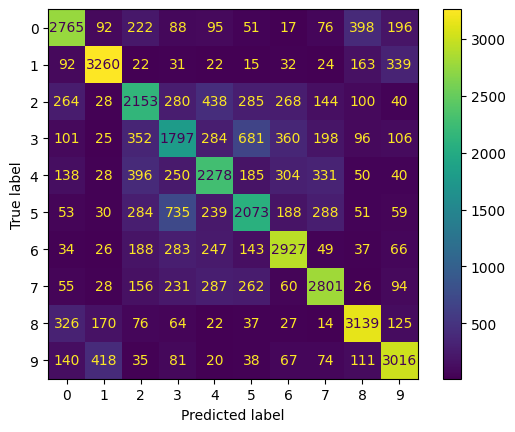

validation...


(Epoch 23 | 79/79) | Data: 0.058s | Batch: 0.077s | Loss: 0.9319| GPU usage: 0.846 GB: 100%|██████████| 79/79 [00:06<00:00, 12.81it/s]


validation loss: 0.93147
validation accuracy: 0.66982
validation precision: 0.67300
validation recall: 0.67300
validation F1-Score: 0.67087
saving with validation loss of 0.931469202041626
[Epoch: 24 training...]


(Epoch 24 | 313/313) | Data: 0.055s | Batch: 0.097s | Loss: 0.9624 | GPU usage: 0.846 GB: 100%|██████████| 313/313 [00:30<00:00, 10.23it/s]


learning rate is 8.763049794670775e-05
training loss: 0.96263
training accuracy: 0.66112
training precision: 0.65843
training recall: 0.66113
training F1-Score: 0.65960


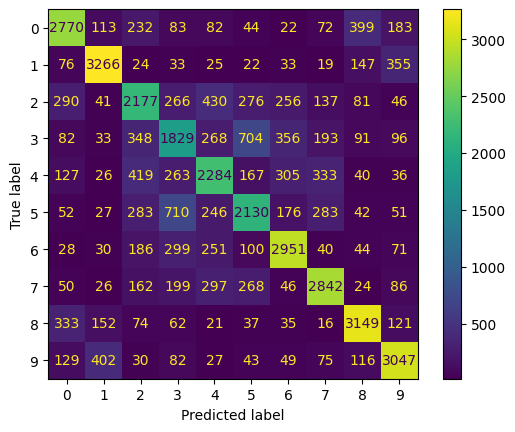

validation...


(Epoch 24 | 79/79) | Data: 0.057s | Batch: 0.076s | Loss: 0.9144| GPU usage: 0.846 GB: 100%|██████████| 79/79 [00:06<00:00, 12.93it/s]


validation loss: 0.91338
validation accuracy: 0.67769
validation precision: 0.68050
validation recall: 0.68050
validation F1-Score: 0.67861
saving with validation loss of 0.9133785963058472
[Epoch: 25 training...]


(Epoch 25 | 313/313) | Data: 0.055s | Batch: 0.099s | Loss: 0.9467 | GPU usage: 0.846 GB: 100%|██████████| 313/313 [00:30<00:00, 10.11it/s]


learning rate is 8.658394705735987e-05
training loss: 0.94657
training accuracy: 0.66763
training precision: 0.66497
training recall: 0.66762
training F1-Score: 0.66613


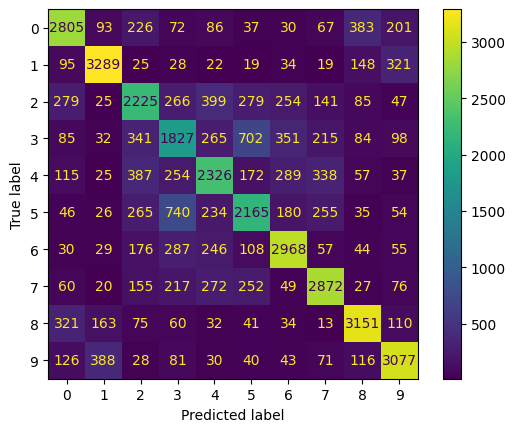

validation...


(Epoch 25 | 79/79) | Data: 0.056s | Batch: 0.075s | Loss: 0.9029| GPU usage: 0.846 GB: 100%|██████████| 79/79 [00:06<00:00, 13.12it/s]


validation loss: 0.90165
validation accuracy: 0.68208
validation precision: 0.68470
validation recall: 0.68470
validation F1-Score: 0.68304
saving with validation loss of 0.901648998260498
[Epoch: 26 training...]


(Epoch 26 | 313/313) | Data: 0.055s | Batch: 0.095s | Loss: 0.9351 | GPU usage: 0.846 GB: 100%|██████████| 313/313 [00:29<00:00, 10.53it/s]


learning rate is 8.55017856687341e-05
training loss: 0.93487
training accuracy: 0.67212
training precision: 0.67006
training recall: 0.67213
training F1-Score: 0.67096


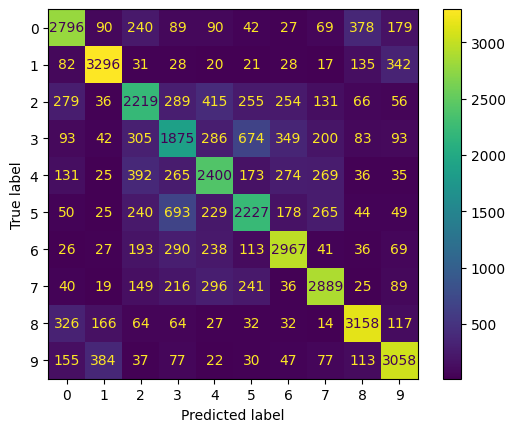

validation...


(Epoch 26 | 79/79) | Data: 0.056s | Batch: 0.074s | Loss: 0.8847| GPU usage: 0.846 GB: 100%|██████████| 79/79 [00:05<00:00, 13.30it/s]


validation loss: 0.88393
validation accuracy: 0.68819
validation precision: 0.69050
validation recall: 0.69050
validation F1-Score: 0.68897
saving with validation loss of 0.8839302062988281
[Epoch: 27 training...]


(Epoch 27 | 313/313) | Data: 0.056s | Batch: 0.099s | Loss: 0.9123 | GPU usage: 0.846 GB: 100%|██████████| 313/313 [00:31<00:00, 10.09it/s]


learning rate is 8.438508174347009e-05
training loss: 0.91226
training accuracy: 0.67855
training precision: 0.67652
training recall: 0.67855
training F1-Score: 0.67738


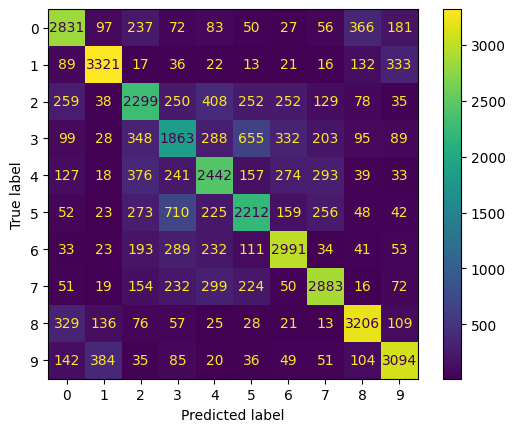

validation...


(Epoch 27 | 79/79) | Data: 0.056s | Batch: 0.076s | Loss: 0.8751| GPU usage: 0.846 GB: 100%|██████████| 79/79 [00:06<00:00, 13.01it/s]


validation loss: 0.87381
validation accuracy: 0.68844
validation precision: 0.69150
validation recall: 0.69150
validation F1-Score: 0.68956
saving with validation loss of 0.8738133311271667
[Epoch: 28 training...]


(Epoch 28 | 313/313) | Data: 0.054s | Batch: 0.097s | Loss: 0.9036 | GPU usage: 0.846 GB: 100%|██████████| 313/313 [00:30<00:00, 10.32it/s]


learning rate is 8.323493733352077e-05
training loss: 0.90378
training accuracy: 0.68330
training precision: 0.68118
training recall: 0.68330
training F1-Score: 0.68212


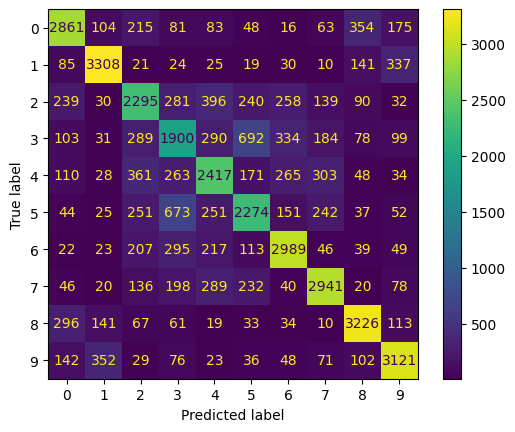

validation...


(Epoch 28 | 79/79) | Data: 0.058s | Batch: 0.078s | Loss: 0.8635| GPU usage: 0.846 GB: 100%|██████████| 79/79 [00:06<00:00, 12.66it/s]


validation loss: 0.86196
validation accuracy: 0.69571
validation precision: 0.69830
validation recall: 0.69830
validation F1-Score: 0.69660
saving with validation loss of 0.8619645833969116
[Epoch: 29 training...]


(Epoch 29 | 313/313) | Data: 0.055s | Batch: 0.096s | Loss: 0.8909 | GPU usage: 0.846 GB: 100%|██████████| 313/313 [00:30<00:00, 10.35it/s]


learning rate is 8.205248749256015e-05
training loss: 0.89071
training accuracy: 0.68758
training precision: 0.68533
training recall: 0.68758
training F1-Score: 0.68630


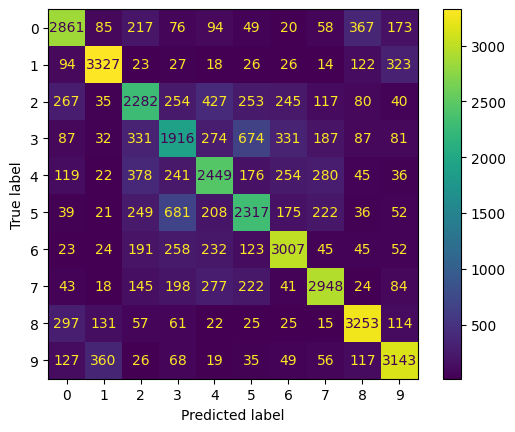

validation...


(Epoch 29 | 79/79) | Data: 0.056s | Batch: 0.078s | Loss: 0.8525| GPU usage: 0.846 GB: 100%|██████████| 79/79 [00:06<00:00, 12.71it/s]


validation loss: 0.85116
validation accuracy: 0.69728
validation precision: 0.69960
validation recall: 0.69960
validation F1-Score: 0.69805
saving with validation loss of 0.8511632680892944
[Epoch: 30 training...]


(Epoch 30 | 313/313) | Data: 0.055s | Batch: 0.097s | Loss: 0.8779 | GPU usage: 0.846 GB: 100%|██████████| 313/313 [00:30<00:00, 10.25it/s]


learning rate is 8.083889915582235e-05
training loss: 0.87803
training accuracy: 0.69207
training precision: 0.69022
training recall: 0.69208
training F1-Score: 0.69101


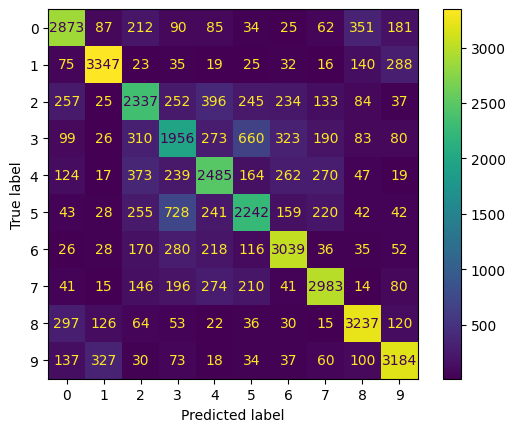

validation...


(Epoch 30 | 79/79) | Data: 0.056s | Batch: 0.075s | Loss: 0.8469| GPU usage: 0.846 GB: 100%|██████████| 79/79 [00:06<00:00, 13.07it/s]


validation loss: 0.84616
validation accuracy: 0.70402
validation precision: 0.70570
validation recall: 0.70570
validation F1-Score: 0.70453
saving with validation loss of 0.8461623787879944
[Epoch: 31 training...]


(Epoch 31 | 313/313) | Data: 0.055s | Batch: 0.099s | Loss: 0.8594 | GPU usage: 0.846 GB: 100%|██████████| 313/313 [00:31<00:00, 10.06it/s]


learning rate is 7.959536998847744e-05
training loss: 0.85933
training accuracy: 0.69820
training precision: 0.69634
training recall: 0.69820
training F1-Score: 0.69713


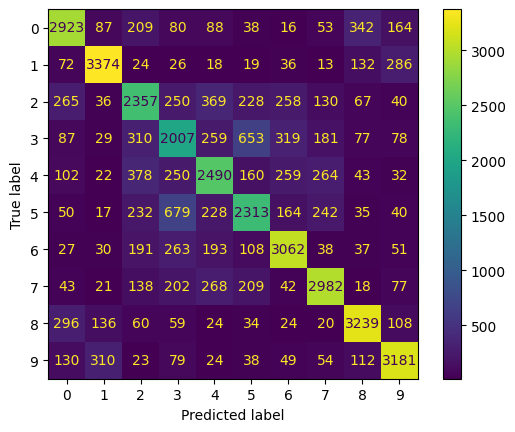

validation...


(Epoch 31 | 79/79) | Data: 0.056s | Batch: 0.078s | Loss: 0.8301| GPU usage: 0.846 GB: 100%|██████████| 79/79 [00:06<00:00, 12.65it/s]


validation loss: 0.82962
validation accuracy: 0.70567
validation precision: 0.70770
validation recall: 0.70770
validation F1-Score: 0.70634
saving with validation loss of 0.8296204805374146
[Epoch: 32 training...]


(Epoch 32 | 313/313) | Data: 0.055s | Batch: 0.096s | Loss: 0.8508 | GPU usage: 0.846 GB: 100%|██████████| 313/313 [00:30<00:00, 10.36it/s]


learning rate is 7.832312720368048e-05
training loss: 0.85089
training accuracy: 0.70042
training precision: 0.69852
training recall: 0.70042
training F1-Score: 0.69936


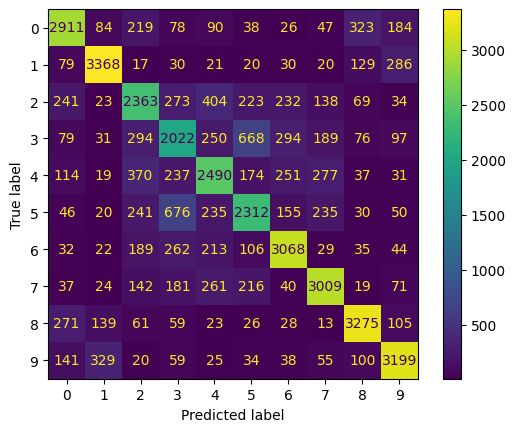

validation...


(Epoch 32 | 79/79) | Data: 0.056s | Batch: 0.075s | Loss: 0.8190| GPU usage: 0.846 GB: 100%|██████████| 79/79 [00:05<00:00, 13.20it/s]


validation loss: 0.81875
validation accuracy: 0.71580
validation precision: 0.71760
validation recall: 0.71760
validation F1-Score: 0.71637
saving with validation loss of 0.8187509179115295
[Epoch: 33 training...]


(Epoch 33 | 313/313) | Data: 0.055s | Batch: 0.096s | Loss: 0.8389 | GPU usage: 0.846 GB: 100%|██████████| 313/313 [00:30<00:00, 10.35it/s]


learning rate is 7.702342635146033e-05
training loss: 0.83940
training accuracy: 0.70413
training precision: 0.70260
training recall: 0.70413
training F1-Score: 0.70327


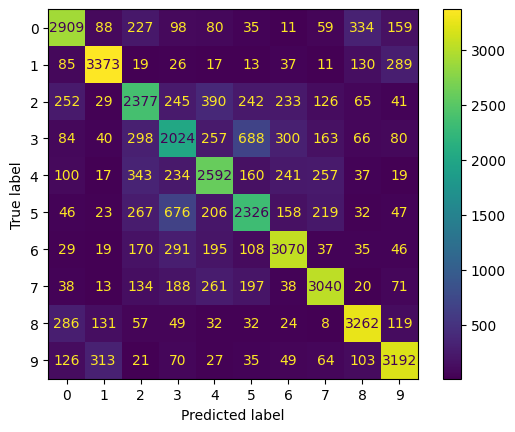

validation...


(Epoch 33 | 79/79) | Data: 0.058s | Batch: 0.080s | Loss: 0.8150| GPU usage: 0.846 GB: 100%|██████████| 79/79 [00:06<00:00, 12.34it/s]


validation loss: 0.81355
validation accuracy: 0.71160
validation precision: 0.71360
validation recall: 0.71360
validation F1-Score: 0.71226
saving with validation loss of 0.8135523796081543
[Epoch: 34 training...]


(Epoch 34 | 313/313) | Data: 0.058s | Batch: 0.101s | Loss: 0.8243 | GPU usage: 0.846 GB: 100%|██████████| 313/313 [00:31<00:00,  9.92it/s]


learning rate is 7.569755007964338e-05
training loss: 0.82417
training accuracy: 0.71030
training precision: 0.70858
training recall: 0.71030
training F1-Score: 0.70935


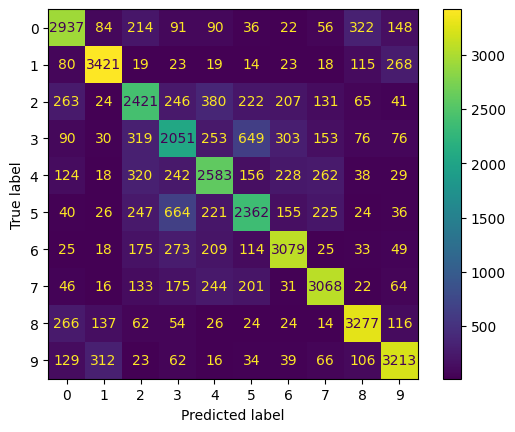

validation...


(Epoch 34 | 79/79) | Data: 45.862s | Batch: 45.873s | Loss: 0.8070| GPU usage: 0.321 GB: 100%|██████████| 79/79 [1:00:23<00:00, 45.87s/it]   


validation loss: 0.80579
validation accuracy: 0.71625
validation precision: 0.71800
validation recall: 0.71800
validation F1-Score: 0.71680
saving with validation loss of 0.8057923913002014
[Epoch: 35 training...]


(Epoch 35 | 313/313) | Data: 0.054s | Batch: 0.080s | Loss: 0.8151 | GPU usage: 0.321 GB: 100%|██████████| 313/313 [00:25<00:00, 12.41it/s]


learning rate is 7.43468068680349e-05
training loss: 0.81537
training accuracy: 0.71288
training precision: 0.71151
training recall: 0.71288
training F1-Score: 0.71208


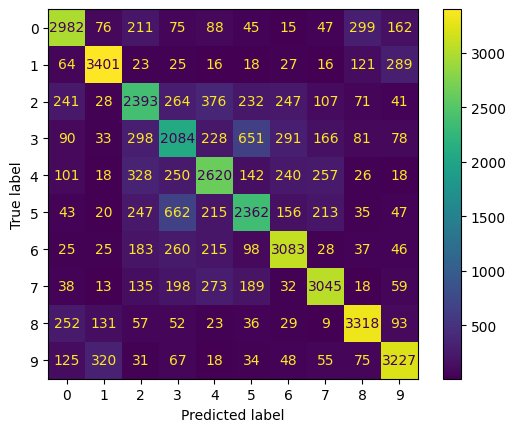

validation...


(Epoch 35 | 79/79) | Data: 0.056s | Batch: 0.075s | Loss: 0.7987| GPU usage: 0.321 GB: 100%|██████████| 79/79 [00:05<00:00, 13.18it/s]


validation loss: 0.79849
validation accuracy: 0.71948
validation precision: 0.72150
validation recall: 0.72150
validation F1-Score: 0.72011
saving with validation loss of 0.7984868884086609
[Epoch: 36 training...]


(Epoch 36 | 313/313) | Data: 0.052s | Batch: 0.087s | Loss: 0.8060 | GPU usage: 0.321 GB: 100%|██████████| 313/313 [00:27<00:00, 11.42it/s]


learning rate is 7.297252973710757e-05
training loss: 0.80630
training accuracy: 0.71883
training precision: 0.71743
training recall: 0.71882
training F1-Score: 0.71801


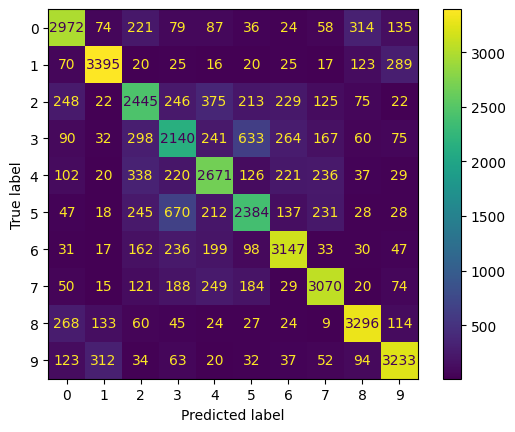

validation...


(Epoch 36 | 79/79) | Data: 0.050s | Batch: 0.064s | Loss: 0.7891| GPU usage: 0.321 GB: 100%|██████████| 79/79 [00:05<00:00, 15.55it/s]


validation loss: 0.78785
validation accuracy: 0.72326
validation precision: 0.72530
validation recall: 0.72530
validation F1-Score: 0.72396
saving with validation loss of 0.7878542542457581
[Epoch: 37 training...]


(Epoch 37 | 313/313) | Data: 0.051s | Batch: 0.081s | Loss: 0.7869 | GPU usage: 0.321 GB: 100%|██████████| 313/313 [00:25<00:00, 12.35it/s]


learning rate is 7.15760749324711e-05
training loss: 0.78691
training accuracy: 0.72483
training precision: 0.72333
training recall: 0.72482
training F1-Score: 0.72398


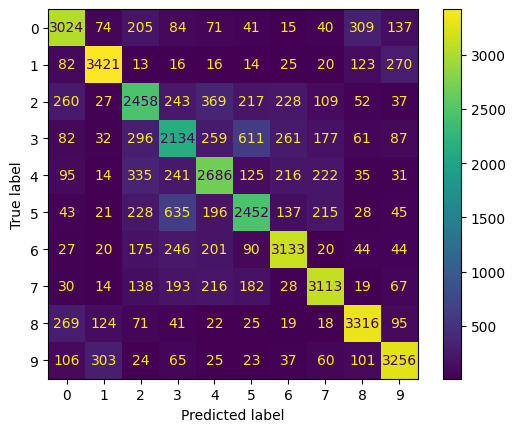

validation...


(Epoch 37 | 79/79) | Data: 0.054s | Batch: 0.076s | Loss: 0.7827| GPU usage: 0.321 GB: 100%|██████████| 79/79 [00:06<00:00, 12.99it/s]


validation loss: 0.78235
validation accuracy: 0.72224
validation precision: 0.72360
validation recall: 0.72360
validation F1-Score: 0.72260
saving with validation loss of 0.7823507785797119
[Epoch: 38 training...]


(Epoch 38 | 313/313) | Data: 0.054s | Batch: 0.097s | Loss: 0.7851 | GPU usage: 0.321 GB: 100%|██████████| 313/313 [00:30<00:00, 10.30it/s]


learning rate is 7.015882058642164e-05
training loss: 0.78527
training accuracy: 0.72580
training precision: 0.72480
training recall: 0.72580
training F1-Score: 0.72524


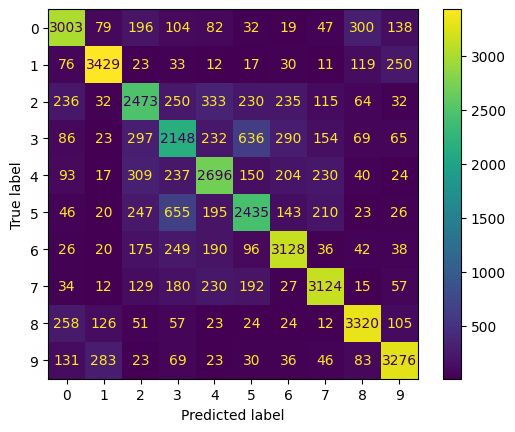

validation...


(Epoch 38 | 79/79) | Data: 0.054s | Batch: 0.073s | Loss: 0.7813| GPU usage: 0.321 GB: 100%|██████████| 79/79 [00:05<00:00, 13.57it/s]


validation loss: 0.78116
validation accuracy: 0.72812
validation precision: 0.72990
validation recall: 0.72990
validation F1-Score: 0.72873
saving with validation loss of 0.7811583876609802
[Epoch: 39 training...]


(Epoch 39 | 313/313) | Data: 0.053s | Batch: 0.097s | Loss: 0.7734 | GPU usage: 0.321 GB: 100%|██████████| 313/313 [00:30<00:00, 10.27it/s]


learning rate is 6.872216535789157e-05
training loss: 0.77384
training accuracy: 0.72925
training precision: 0.72805
training recall: 0.72925
training F1-Score: 0.72856


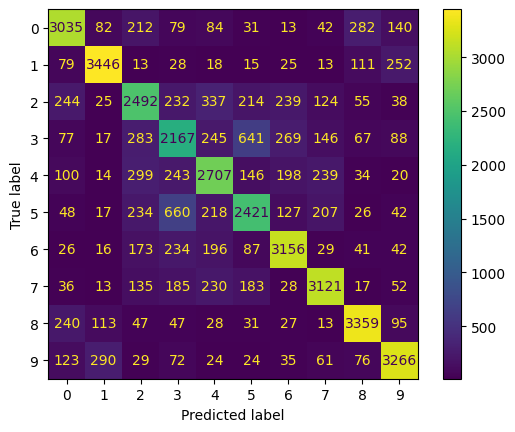

validation...


(Epoch 39 | 79/79) | Data: 0.055s | Batch: 0.073s | Loss: 0.7716| GPU usage: 0.321 GB: 100%|██████████| 79/79 [00:05<00:00, 13.45it/s]


validation loss: 0.77184
validation accuracy: 0.73070
validation precision: 0.73220
validation recall: 0.73220
validation F1-Score: 0.73117
saving with validation loss of 0.771843671798706
[Epoch: 40 training...]


(Epoch 40 | 313/313) | Data: 0.056s | Batch: 0.099s | Loss: 0.7620 | GPU usage: 0.321 GB: 100%|██████████| 313/313 [00:31<00:00, 10.06it/s]


learning rate is 6.726752705214194e-05
training loss: 0.76183
training accuracy: 0.73508
training precision: 0.73393
training recall: 0.73507
training F1-Score: 0.73439


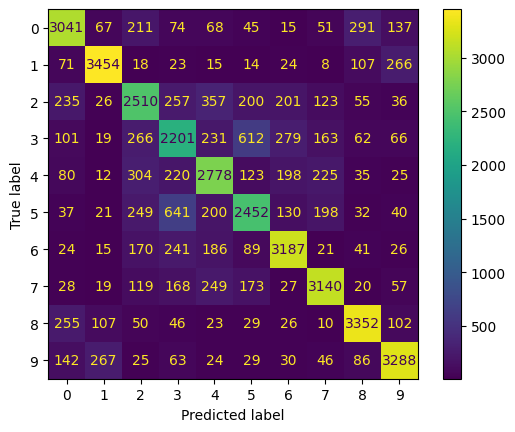

validation...


(Epoch 40 | 79/79) | Data: 0.055s | Batch: 0.073s | Loss: 0.7623| GPU usage: 0.321 GB: 100%|██████████| 79/79 [00:05<00:00, 13.46it/s]


validation loss: 0.76275
validation accuracy: 0.73223
validation precision: 0.73360
validation recall: 0.73360
validation F1-Score: 0.73263
saving with validation loss of 0.7627496123313904
[Epoch: 41 training...]


(Epoch 41 | 313/313) | Data: 0.053s | Batch: 0.093s | Loss: 0.7596 | GPU usage: 0.321 GB: 100%|██████████| 313/313 [00:29<00:00, 10.73it/s]


learning rate is 6.57963412215599e-05
training loss: 0.75951
training accuracy: 0.73493
training precision: 0.73388
training recall: 0.73493
training F1-Score: 0.73435


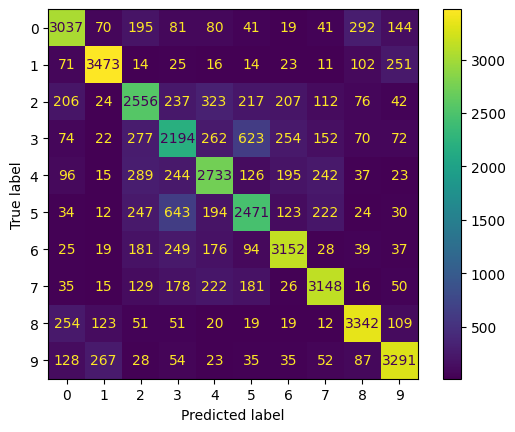

validation...


(Epoch 41 | 79/79) | Data: 0.054s | Batch: 0.076s | Loss: 0.7690| GPU usage: 0.321 GB: 100%|██████████| 79/79 [00:06<00:00, 12.97it/s]


validation loss: 0.76734
validation accuracy: 0.72978
validation precision: 0.73040
validation recall: 0.73040
validation F1-Score: 0.72985
[Epoch: 42 training...]


(Epoch 42 | 313/313) | Data: 0.053s | Batch: 0.094s | Loss: 0.7448 | GPU usage: 0.321 GB: 100%|██████████| 313/313 [00:29<00:00, 10.64it/s]


learning rate is 6.431005974894185e-05
training loss: 0.74538
training accuracy: 0.73840
training precision: 0.73724
training recall: 0.73840
training F1-Score: 0.73774


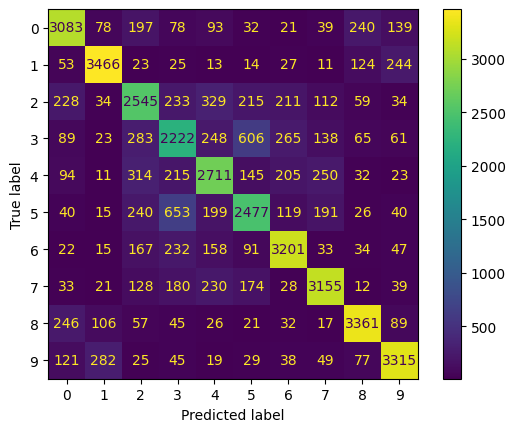

validation...


(Epoch 42 | 79/79) | Data: 0.053s | Batch: 0.069s | Loss: 0.7598| GPU usage: 0.321 GB: 100%|██████████| 79/79 [00:05<00:00, 14.39it/s]


validation loss: 0.75903
validation accuracy: 0.72989
validation precision: 0.73180
validation recall: 0.73180
validation F1-Score: 0.73053
saving with validation loss of 0.7590339779853821
[Epoch: 43 training...]


(Epoch 43 | 313/313) | Data: 0.054s | Batch: 0.095s | Loss: 0.7330 | GPU usage: 0.321 GB: 100%|██████████| 313/313 [00:29<00:00, 10.47it/s]


learning rate is 6.281014941466031e-05
training loss: 0.73303
training accuracy: 0.74530
training precision: 0.74437
training recall: 0.74530
training F1-Score: 0.74478


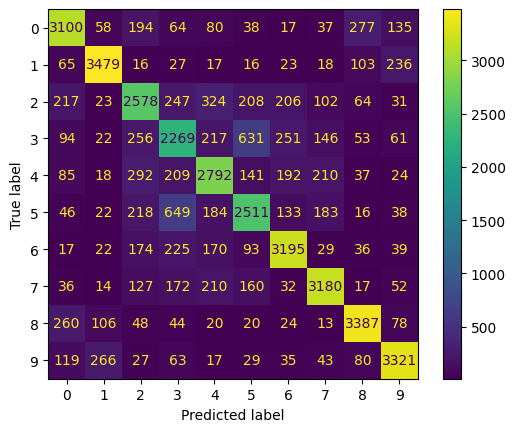

validation...


(Epoch 43 | 79/79) | Data: 0.057s | Batch: 0.077s | Loss: 0.7490| GPU usage: 0.321 GB: 100%|██████████| 79/79 [00:06<00:00, 12.88it/s]


validation loss: 0.74688
validation accuracy: 0.73807
validation precision: 0.73950
validation recall: 0.73950
validation F1-Score: 0.73838
saving with validation loss of 0.7468805313110352
[Epoch: 44 training...]


(Epoch 44 | 313/313) | Data: 0.052s | Batch: 0.091s | Loss: 0.7267 | GPU usage: 0.321 GB: 100%|██████████| 313/313 [00:28<00:00, 10.92it/s]


learning rate is 6.129809044912887e-05
training loss: 0.72695
training accuracy: 0.74897
training precision: 0.74766
training recall: 0.74897
training F1-Score: 0.74822


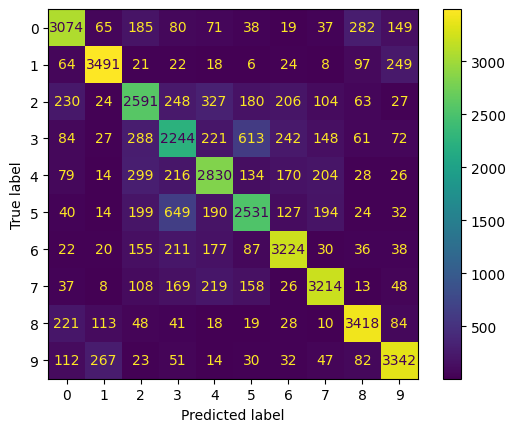

validation...


(Epoch 44 | 79/79) | Data: 0.053s | Batch: 0.071s | Loss: 0.7471| GPU usage: 0.321 GB: 100%|██████████| 79/79 [00:05<00:00, 13.93it/s]


validation loss: 0.74631
validation accuracy: 0.74073
validation precision: 0.74180
validation recall: 0.74180
validation F1-Score: 0.74103
saving with validation loss of 0.7463060617446899
[Epoch: 45 training...]


(Epoch 45 | 313/313) | Data: 0.052s | Batch: 0.088s | Loss: 0.7162 | GPU usage: 0.321 GB: 100%|██████████| 313/313 [00:27<00:00, 11.32it/s]


learning rate is 5.977537507199338e-05
training loss: 0.71654
training accuracy: 0.75055
training precision: 0.74922
training recall: 0.75055
training F1-Score: 0.74979


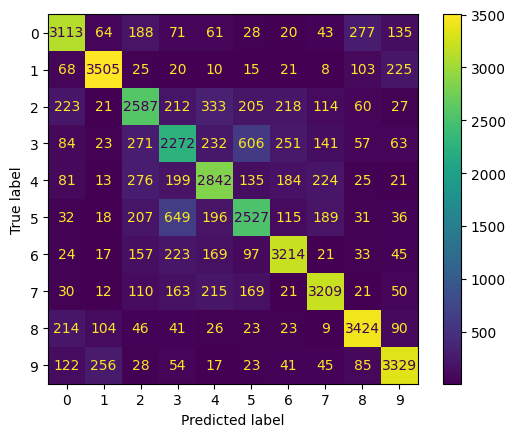

validation...


(Epoch 45 | 79/79) | Data: 0.055s | Batch: 0.077s | Loss: 0.7443| GPU usage: 0.321 GB: 100%|██████████| 79/79 [00:06<00:00, 12.88it/s]


validation loss: 0.74407
validation accuracy: 0.73673
validation precision: 0.73780
validation recall: 0.73780
validation F1-Score: 0.73701
saving with validation loss of 0.7440698742866516
[Epoch: 46 training...]


(Epoch 46 | 313/313) | Data: 0.052s | Batch: 0.088s | Loss: 0.7127 | GPU usage: 0.321 GB: 100%|██████████| 313/313 [00:27<00:00, 11.34it/s]


learning rate is 5.8243506019491436e-05
training loss: 0.71255
training accuracy: 0.75105
training precision: 0.75017
training recall: 0.75105
training F1-Score: 0.75051


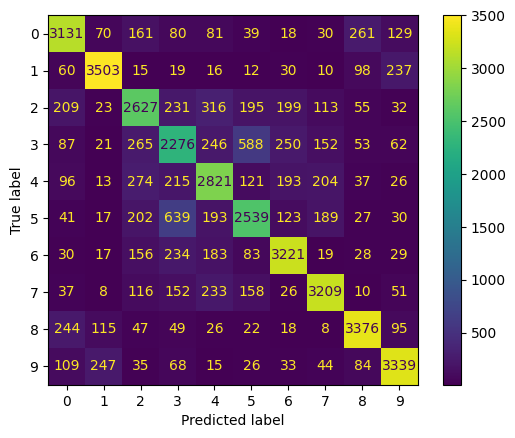

validation...


(Epoch 46 | 79/79) | Data: 0.056s | Batch: 0.078s | Loss: 0.7383| GPU usage: 0.321 GB: 100%|██████████| 79/79 [00:06<00:00, 12.66it/s]


validation loss: 0.73580
validation accuracy: 0.74255
validation precision: 0.74390
validation recall: 0.74390
validation F1-Score: 0.74305
saving with validation loss of 0.7358023524284363
[Epoch: 47 training...]


(Epoch 47 | 313/313) | Data: 0.053s | Batch: 0.093s | Loss: 0.6973 | GPU usage: 0.321 GB: 100%|██████████| 313/313 [00:29<00:00, 10.68it/s]


learning rate is 5.6703995061433075e-05
training loss: 0.69744
training accuracy: 0.75592
training precision: 0.75514
training recall: 0.75592
training F1-Score: 0.75548


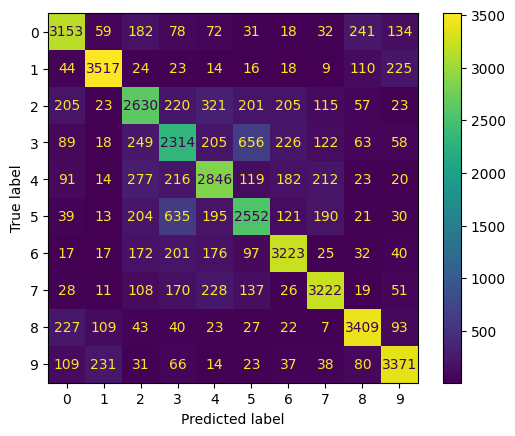

validation...


(Epoch 47 | 79/79) | Data: 0.055s | Batch: 0.074s | Loss: 0.7328| GPU usage: 0.321 GB: 100%|██████████| 79/79 [00:05<00:00, 13.26it/s]


validation loss: 0.73275
validation accuracy: 0.74528
validation precision: 0.74640
validation recall: 0.74640
validation F1-Score: 0.74566
saving with validation loss of 0.7327466011047363
[Epoch: 48 training...]


(Epoch 48 | 313/313) | Data: 0.053s | Batch: 0.092s | Loss: 0.6894 | GPU usage: 0.321 GB: 100%|██████████| 313/313 [00:28<00:00, 10.83it/s]


learning rate is 5.515836150926646e-05
training loss: 0.68974
training accuracy: 0.76055
training precision: 0.75961
training recall: 0.76055
training F1-Score: 0.76001


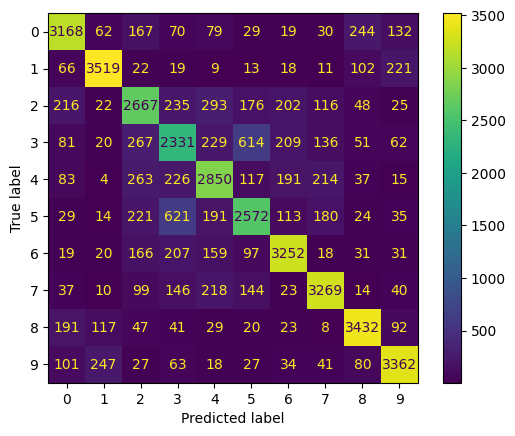

validation...


(Epoch 48 | 79/79) | Data: 0.056s | Batch: 0.077s | Loss: 0.7227| GPU usage: 0.321 GB: 100%|██████████| 79/79 [00:06<00:00, 12.86it/s]


validation loss: 0.72066
validation accuracy: 0.74645
validation precision: 0.74750
validation recall: 0.74750
validation F1-Score: 0.74679
saving with validation loss of 0.7206589579582214
[Epoch: 49 training...]


(Epoch 49 | 313/313) | Data: 0.053s | Batch: 0.096s | Loss: 0.6844 | GPU usage: 0.321 GB: 100%|██████████| 313/313 [00:30<00:00, 10.35it/s]


learning rate is 5.360813071670102e-05
training loss: 0.68439
training accuracy: 0.76135
training precision: 0.76031
training recall: 0.76135
training F1-Score: 0.76074


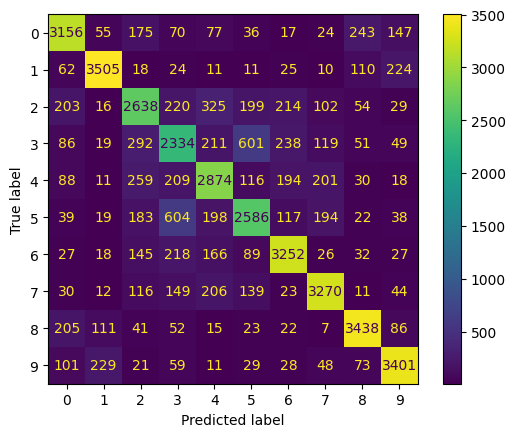

validation...


(Epoch 49 | 79/79) | Data: 0.054s | Batch: 0.073s | Loss: 0.7238| GPU usage: 0.321 GB: 100%|██████████| 79/79 [00:05<00:00, 13.54it/s]


validation loss: 0.72332
validation accuracy: 0.74925
validation precision: 0.75050
validation recall: 0.75050
validation F1-Score: 0.74967
saving with validation loss of 0.7233172059059143
[Epoch: 50 training...]


(Epoch 50 | 313/313) | Data: 0.053s | Batch: 0.096s | Loss: 0.6763 | GPU usage: 0.321 GB: 100%|██████████| 313/313 [00:30<00:00, 10.34it/s]


learning rate is 5.205483257436735e-05
training loss: 0.67625
training accuracy: 0.76407
training precision: 0.76318
training recall: 0.76407
training F1-Score: 0.76354


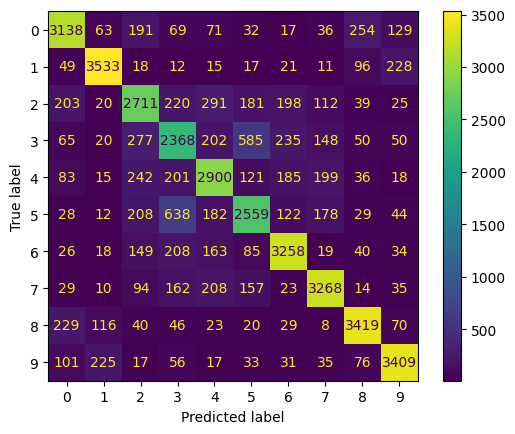

validation...


(Epoch 50 | 79/79) | Data: 0.056s | Batch: 0.075s | Loss: 0.7217| GPU usage: 0.321 GB: 100%|██████████| 79/79 [00:05<00:00, 13.21it/s]


validation loss: 0.72004
validation accuracy: 0.74868
validation precision: 0.74930
validation recall: 0.74930
validation F1-Score: 0.74880
saving with validation loss of 0.7200437784194946
[Epoch: 51 training...]


(Epoch 51 | 313/313) | Data: 0.052s | Batch: 0.087s | Loss: 0.6696 | GPU usage: 0.321 GB: 100%|██████████| 313/313 [00:27<00:00, 11.41it/s]


learning rate is 5.05e-05
training loss: 0.66987
training accuracy: 0.76612
training precision: 0.76517
training recall: 0.76612
training F1-Score: 0.76559


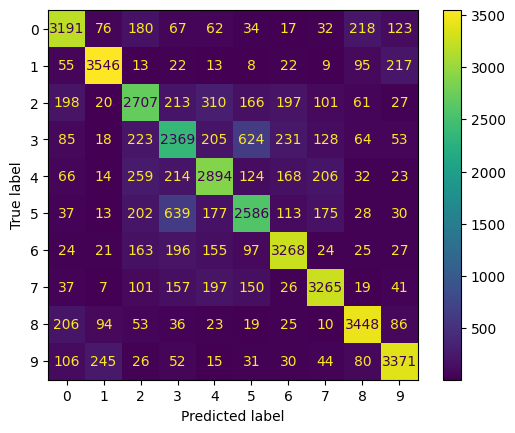

validation...


(Epoch 51 | 79/79) | Data: 0.055s | Batch: 0.078s | Loss: 0.7203| GPU usage: 0.321 GB: 100%|██████████| 79/79 [00:06<00:00, 12.71it/s]


validation loss: 0.71863
validation accuracy: 0.74783
validation precision: 0.74950
validation recall: 0.74950
validation F1-Score: 0.74847
saving with validation loss of 0.7186294198036194
[Epoch: 52 training...]


(Epoch 52 | 313/313) | Data: 0.056s | Batch: 0.097s | Loss: 0.6632 | GPU usage: 0.321 GB: 100%|██████████| 313/313 [00:30<00:00, 10.27it/s]


learning rate is 4.894516742563265e-05
training loss: 0.66341
training accuracy: 0.76865
training precision: 0.76767
training recall: 0.76865
training F1-Score: 0.76808


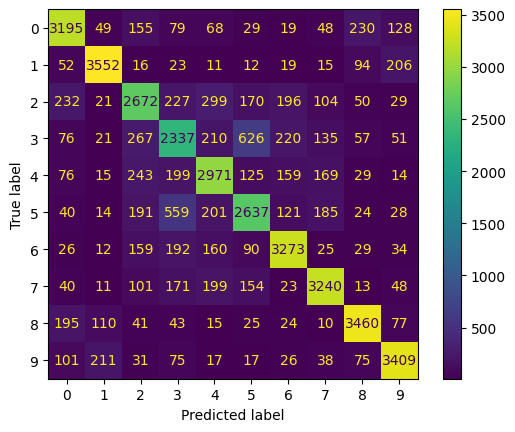

validation...


(Epoch 52 | 79/79) | Data: 0.056s | Batch: 0.080s | Loss: 0.7169| GPU usage: 0.321 GB: 100%|██████████| 79/79 [00:06<00:00, 12.40it/s]


validation loss: 0.71688
validation accuracy: 0.75087
validation precision: 0.75180
validation recall: 0.75180
validation F1-Score: 0.75113
saving with validation loss of 0.7168754935264587
[Epoch: 53 training...]


(Epoch 53 | 313/313) | Data: 0.054s | Batch: 0.094s | Loss: 0.6592 | GPU usage: 0.321 GB: 100%|██████████| 313/313 [00:29<00:00, 10.60it/s]


learning rate is 4.739186928329899e-05
training loss: 0.65907
training accuracy: 0.77102
training precision: 0.77015
training recall: 0.77102
training F1-Score: 0.77050


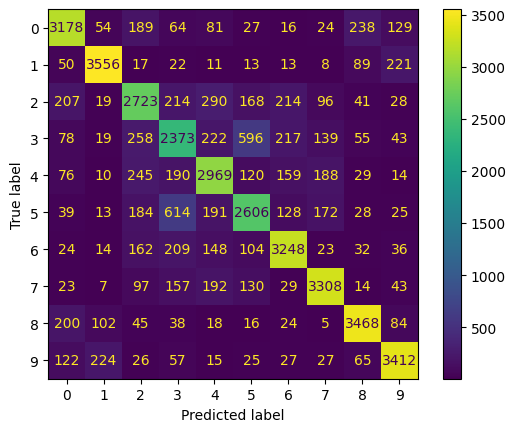

validation...


(Epoch 53 | 79/79) | Data: 0.054s | Batch: 0.076s | Loss: 0.7195| GPU usage: 0.321 GB: 100%|██████████| 79/79 [00:06<00:00, 12.93it/s]


validation loss: 0.71972
validation accuracy: 0.74734
validation precision: 0.74830
validation recall: 0.74830
validation F1-Score: 0.74767
saving with validation loss of 0.719720721244812
[Epoch: 54 training...]


(Epoch 54 | 313/313) | Data: 0.053s | Batch: 0.091s | Loss: 0.6505 | GPU usage: 0.321 GB: 100%|██████████| 313/313 [00:28<00:00, 10.93it/s]


learning rate is 4.584163849073354e-05
training loss: 0.64998
training accuracy: 0.77528
training precision: 0.77445
training recall: 0.77528
training F1-Score: 0.77479


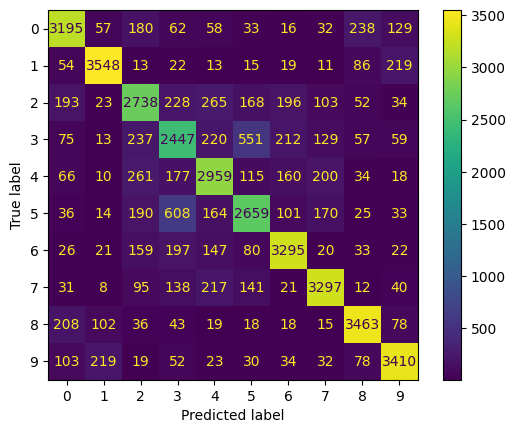

validation...


(Epoch 54 | 79/79) | Data: 0.053s | Batch: 0.072s | Loss: 0.7123| GPU usage: 0.321 GB: 100%|██████████| 79/79 [00:05<00:00, 13.68it/s]


validation loss: 0.71075
validation accuracy: 0.74958
validation precision: 0.75080
validation recall: 0.75080
validation F1-Score: 0.75003
saving with validation loss of 0.7107518315315247
[Epoch: 55 training...]


(Epoch 55 | 313/313) | Data: 0.053s | Batch: 0.092s | Loss: 0.6403 | GPU usage: 0.321 GB: 100%|██████████| 313/313 [00:28<00:00, 10.84it/s]


learning rate is 4.429600493856695e-05
training loss: 0.64010
training accuracy: 0.77672
training precision: 0.77623
training recall: 0.77673
training F1-Score: 0.77645


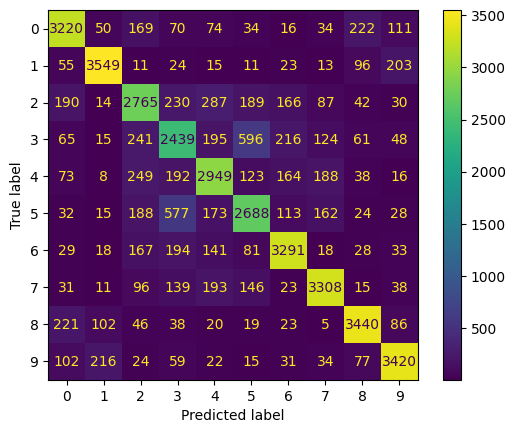

validation...


(Epoch 55 | 79/79) | Data: 0.056s | Batch: 0.076s | Loss: 0.7136| GPU usage: 0.321 GB: 100%|██████████| 79/79 [00:06<00:00, 13.01it/s]


validation loss: 0.71199
validation accuracy: 0.74784
validation precision: 0.74920
validation recall: 0.74920
validation F1-Score: 0.74828
saving with validation loss of 0.7119902968406677
[Epoch: 56 training...]


(Epoch 56 | 313/313) | Data: 0.052s | Batch: 0.089s | Loss: 0.6401 | GPU usage: 0.321 GB: 100%|██████████| 313/313 [00:27<00:00, 11.22it/s]


learning rate is 4.275649398050857e-05
training loss: 0.63975
training accuracy: 0.77610
training precision: 0.77548
training recall: 0.77610
training F1-Score: 0.77573


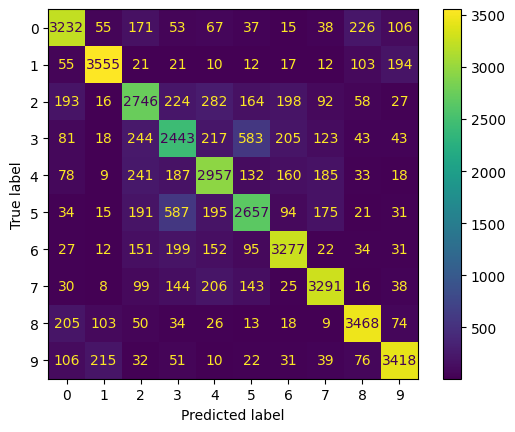

validation...


(Epoch 56 | 79/79) | Data: 0.055s | Batch: 0.077s | Loss: 0.7058| GPU usage: 0.321 GB: 100%|██████████| 79/79 [00:06<00:00, 12.84it/s]


validation loss: 0.70390
validation accuracy: 0.75242
validation precision: 0.75340
validation recall: 0.75340
validation F1-Score: 0.75266
saving with validation loss of 0.7038965225219727
[Epoch: 57 training...]


(Epoch 57 | 313/313) | Data: 0.053s | Batch: 0.093s | Loss: 0.6330 | GPU usage: 0.321 GB: 100%|██████████| 313/313 [00:29<00:00, 10.72it/s]


learning rate is 4.122462492800663e-05
training loss: 0.63296
training accuracy: 0.78007
training precision: 0.77918
training recall: 0.78007
training F1-Score: 0.77956


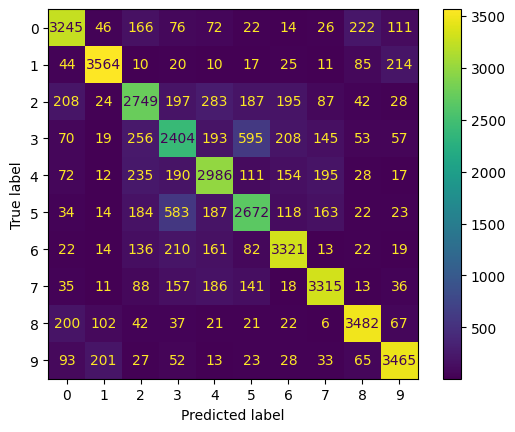

validation...


(Epoch 57 | 79/79) | Data: 0.055s | Batch: 0.076s | Loss: 0.7057| GPU usage: 0.321 GB: 100%|██████████| 79/79 [00:06<00:00, 12.91it/s]


validation loss: 0.70463
validation accuracy: 0.75395
validation precision: 0.75480
validation recall: 0.75480
validation F1-Score: 0.75425
saving with validation loss of 0.7046308517456055
[Epoch: 58 training...]


(Epoch 58 | 313/313) | Data: 0.053s | Batch: 0.092s | Loss: 0.6266 | GPU usage: 0.321 GB: 100%|██████████| 313/313 [00:28<00:00, 10.82it/s]


learning rate is 3.9701909550871155e-05
training loss: 0.62650
training accuracy: 0.78187
training precision: 0.78141
training recall: 0.78188
training F1-Score: 0.78161


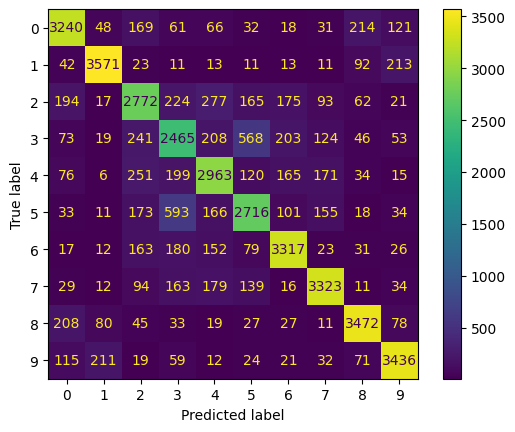

validation...


(Epoch 58 | 79/79) | Data: 0.055s | Batch: 0.075s | Loss: 0.7080| GPU usage: 0.321 GB: 100%|██████████| 79/79 [00:06<00:00, 13.15it/s]


validation loss: 0.70736
validation accuracy: 0.75733
validation precision: 0.75810
validation recall: 0.75810
validation F1-Score: 0.75754
saving with validation loss of 0.7073612809181213
[Epoch: 59 training...]


(Epoch 59 | 313/313) | Data: 0.053s | Batch: 0.090s | Loss: 0.6168 | GPU usage: 0.321 GB: 100%|██████████| 313/313 [00:28<00:00, 11.07it/s]


learning rate is 3.818985058533969e-05
training loss: 0.61674
training accuracy: 0.78438
training precision: 0.78361
training recall: 0.78438
training F1-Score: 0.78392


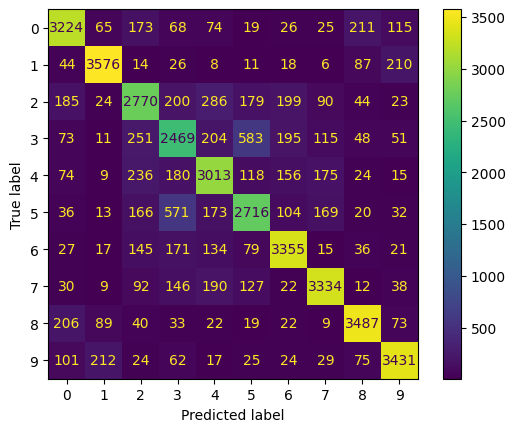

validation...


(Epoch 59 | 79/79) | Data: 0.056s | Batch: 0.079s | Loss: 0.7084| GPU usage: 0.321 GB: 100%|██████████| 79/79 [00:06<00:00, 12.53it/s]


validation loss: 0.70827
validation accuracy: 0.75583
validation precision: 0.75690
validation recall: 0.75690
validation F1-Score: 0.75619
saving with validation loss of 0.7082733511924744
[Epoch: 60 training...]


(Epoch 60 | 313/313) | Data: 0.052s | Batch: 0.090s | Loss: 0.6125 | GPU usage: 0.321 GB: 100%|██████████| 313/313 [00:28<00:00, 11.04it/s]


learning rate is 3.668994025105816e-05
training loss: 0.61222
training accuracy: 0.78702
training precision: 0.78630
training recall: 0.78703
training F1-Score: 0.78663


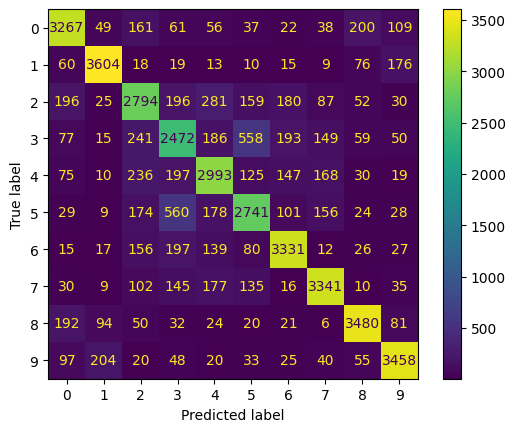

validation...


(Epoch 60 | 79/79) | Data: 0.052s | Batch: 0.067s | Loss: 0.6961| GPU usage: 0.321 GB: 100%|██████████| 79/79 [00:05<00:00, 14.81it/s]


validation loss: 0.69567
validation accuracy: 0.75858
validation precision: 0.75920
validation recall: 0.75920
validation F1-Score: 0.75870
saving with validation loss of 0.6956668496131897
[Epoch: 61 training...]


(Epoch 61 | 313/313) | Data: 0.055s | Batch: 0.098s | Loss: 0.6083 | GPU usage: 0.321 GB: 100%|██████████| 313/313 [00:30<00:00, 10.16it/s]


learning rate is 3.520365877844012e-05
training loss: 0.60846
training accuracy: 0.78758
training precision: 0.78680
training recall: 0.78758
training F1-Score: 0.78715


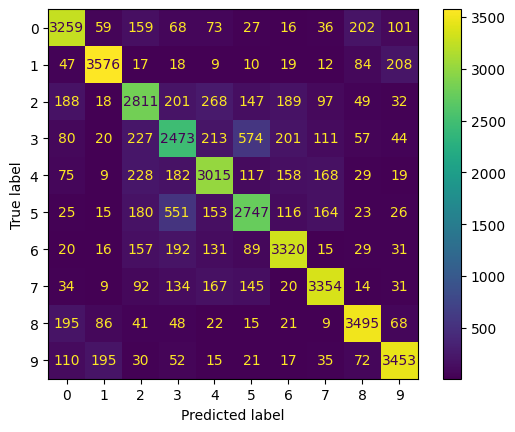

validation...


(Epoch 61 | 79/79) | Data: 0.056s | Batch: 0.078s | Loss: 0.7046| GPU usage: 0.321 GB: 100%|██████████| 79/79 [00:06<00:00, 12.69it/s]


validation loss: 0.70342
validation accuracy: 0.75711
validation precision: 0.75780
validation recall: 0.75780
validation F1-Score: 0.75725
[Epoch: 62 training...]


(Epoch 62 | 313/313) | Data: 0.053s | Batch: 0.093s | Loss: 0.6062 | GPU usage: 0.321 GB: 100%|██████████| 313/313 [00:29<00:00, 10.76it/s]


learning rate is 3.373247294785808e-05
training loss: 0.60626
training accuracy: 0.78833
training precision: 0.78746
training recall: 0.78833
training F1-Score: 0.78785


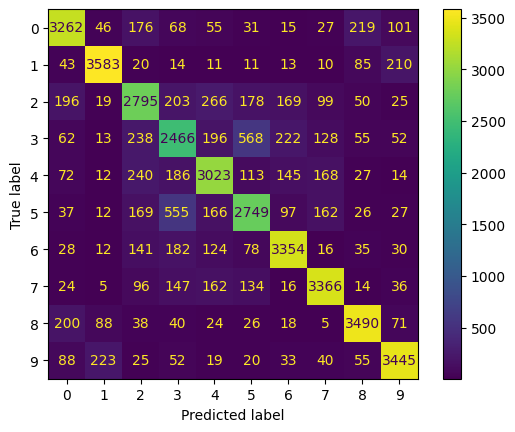

validation...


(Epoch 62 | 79/79) | Data: 0.052s | Batch: 0.068s | Loss: 0.7025| GPU usage: 0.321 GB: 100%|██████████| 79/79 [00:05<00:00, 14.54it/s]


validation loss: 0.70362
validation accuracy: 0.75390
validation precision: 0.75440
validation recall: 0.75440
validation F1-Score: 0.75395
[Epoch: 63 training...]


(Epoch 63 | 313/313) | Data: 0.053s | Batch: 0.094s | Loss: 0.5975 | GPU usage: 0.321 GB: 100%|██████████| 313/313 [00:29<00:00, 10.59it/s]


learning rate is 3.2277834642108455e-05
training loss: 0.59744
training accuracy: 0.79317
training precision: 0.79270
training recall: 0.79317
training F1-Score: 0.79289


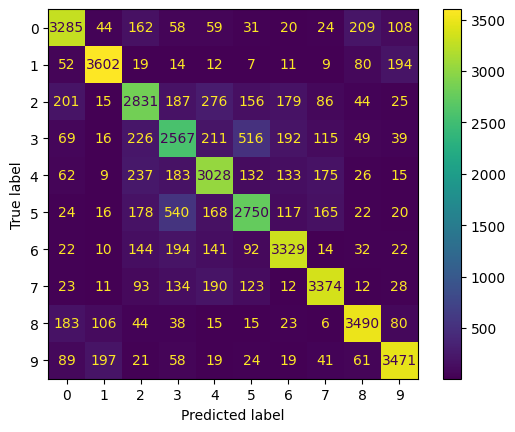

validation...


(Epoch 63 | 79/79) | Data: 0.057s | Batch: 0.080s | Loss: 0.6909| GPU usage: 0.321 GB: 100%|██████████| 79/79 [00:06<00:00, 12.38it/s]


validation loss: 0.69116
validation accuracy: 0.76085
validation precision: 0.76120
validation recall: 0.76120
validation F1-Score: 0.76082
saving with validation loss of 0.6911627650260925
[Epoch: 64 training...]


(Epoch 64 | 313/313) | Data: 0.052s | Batch: 0.090s | Loss: 0.5944 | GPU usage: 0.321 GB: 100%|██████████| 313/313 [00:28<00:00, 11.09it/s]


learning rate is 3.084117941357835e-05
training loss: 0.59435
training accuracy: 0.79420
training precision: 0.79363
training recall: 0.79420
training F1-Score: 0.79385


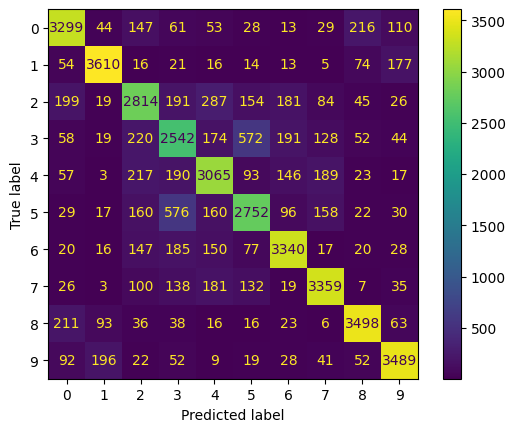

validation...


(Epoch 64 | 79/79) | Data: 0.056s | Batch: 0.079s | Loss: 0.6994| GPU usage: 0.321 GB: 100%|██████████| 79/79 [00:06<00:00, 12.48it/s]


validation loss: 0.69967
validation accuracy: 0.76271
validation precision: 0.76330
validation recall: 0.76330
validation F1-Score: 0.76282
[Epoch: 65 training...]


(Epoch 65 | 313/313) | Data: 0.053s | Batch: 0.093s | Loss: 0.5910 | GPU usage: 0.321 GB: 100%|██████████| 313/313 [00:29<00:00, 10.77it/s]


learning rate is 2.9423925067528905e-05
training loss: 0.59100
training accuracy: 0.79348
training precision: 0.79313
training recall: 0.79347
training F1-Score: 0.79321


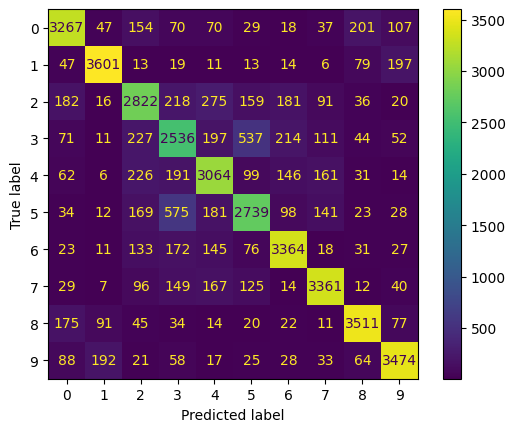

validation...


(Epoch 65 | 79/79) | Data: 0.053s | Batch: 0.069s | Loss: 0.7019| GPU usage: 0.321 GB: 100%|██████████| 79/79 [00:05<00:00, 14.21it/s]


validation loss: 0.70153
validation accuracy: 0.76139
validation precision: 0.76180
validation recall: 0.76180
validation F1-Score: 0.76148
[Epoch: 66 training...]


(Epoch 66 | 313/313) | Data: 0.054s | Batch: 0.095s | Loss: 0.5855 | GPU usage: 0.321 GB: 100%|██████████| 313/313 [00:29<00:00, 10.45it/s]


learning rate is 2.8027470262892437e-05
training loss: 0.58574
training accuracy: 0.79697
training precision: 0.79628
training recall: 0.79697
training F1-Score: 0.79659


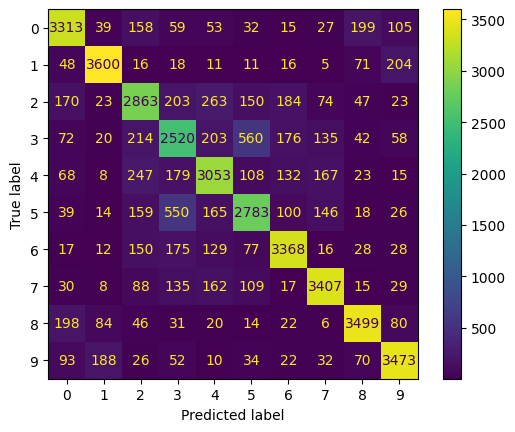

validation...


(Epoch 66 | 79/79) | Data: 0.055s | Batch: 0.075s | Loss: 0.6902| GPU usage: 0.321 GB: 100%|██████████| 79/79 [00:05<00:00, 13.23it/s]


validation loss: 0.68802
validation accuracy: 0.76221
validation precision: 0.76270
validation recall: 0.76270
validation F1-Score: 0.76233
saving with validation loss of 0.68802410364151
[Epoch: 67 training...]


(Epoch 67 | 313/313) | Data: 0.053s | Batch: 0.090s | Loss: 0.5840 | GPU usage: 0.321 GB: 100%|██████████| 313/313 [00:28<00:00, 11.10it/s]


learning rate is 2.665319313196509e-05
training loss: 0.58403
training accuracy: 0.79700
training precision: 0.79662
training recall: 0.79700
training F1-Score: 0.79674


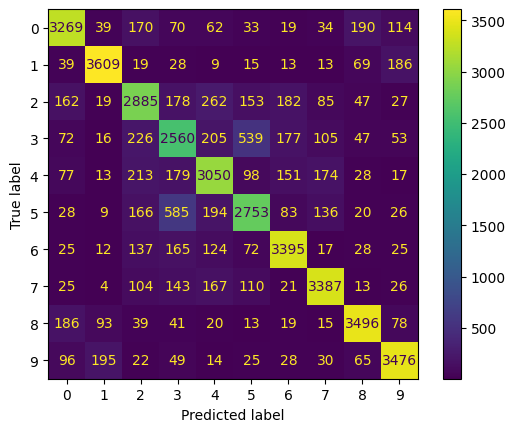

validation...


(Epoch 67 | 79/79) | Data: 0.054s | Batch: 0.076s | Loss: 0.6927| GPU usage: 0.321 GB: 100%|██████████| 79/79 [00:06<00:00, 13.09it/s]


validation loss: 0.69150
validation accuracy: 0.76210
validation precision: 0.76300
validation recall: 0.76300
validation F1-Score: 0.76237
[Epoch: 68 training...]


(Epoch 68 | 313/313) | Data: 0.053s | Batch: 0.094s | Loss: 0.5757 | GPU usage: 0.321 GB: 100%|██████████| 313/313 [00:29<00:00, 10.64it/s]


learning rate is 2.5302449920356623e-05
training loss: 0.57571
training accuracy: 0.79807
training precision: 0.79765
training recall: 0.79807
training F1-Score: 0.79782


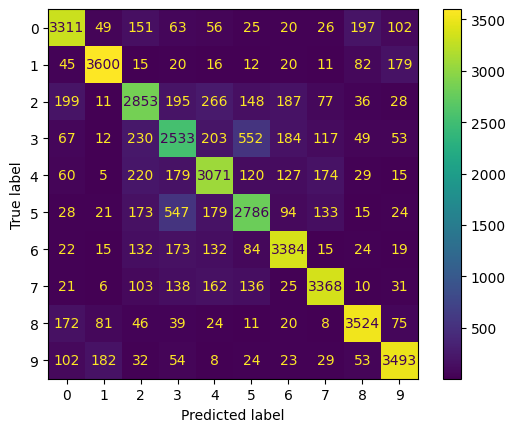

validation...


(Epoch 68 | 79/79) | Data: 0.053s | Batch: 0.069s | Loss: 0.6942| GPU usage: 0.321 GB: 100%|██████████| 79/79 [00:05<00:00, 14.36it/s]


validation loss: 0.69335
validation accuracy: 0.75878
validation precision: 0.76000
validation recall: 0.76000
validation F1-Score: 0.75915
saving with validation loss of 0.6933476328849792
[Epoch: 69 training...]


(Epoch 69 | 313/313) | Data: 0.056s | Batch: 0.099s | Loss: 0.5738 | GPU usage: 0.321 GB: 100%|██████████| 313/313 [00:30<00:00, 10.11it/s]


learning rate is 2.3976573648539656e-05
training loss: 0.57368
training accuracy: 0.79827
training precision: 0.79749
training recall: 0.79828
training F1-Score: 0.79783


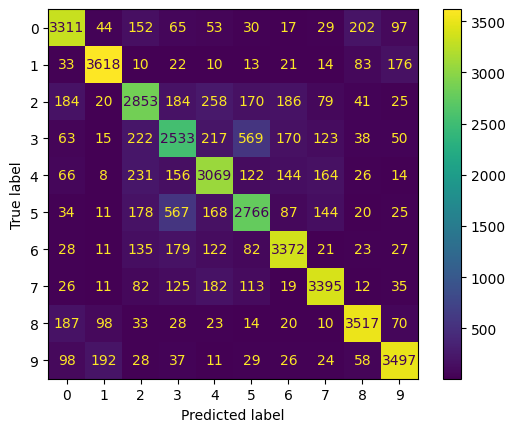

validation...


(Epoch 69 | 79/79) | Data: 0.055s | Batch: 0.074s | Loss: 0.6918| GPU usage: 0.321 GB: 100%|██████████| 79/79 [00:05<00:00, 13.33it/s]


validation loss: 0.69120
validation accuracy: 0.76220
validation precision: 0.76310
validation recall: 0.76310
validation F1-Score: 0.76248
saving with validation loss of 0.6912010312080383
[Epoch: 70 training...]


(Epoch 70 | 313/313) | Data: 34.575s | Batch: 50.448s | Loss: 0.5676 | GPU usage: 0.321 GB: 100%|██████████| 313/313 [4:23:10<00:00, 50.45s/it]     


learning rate is 2.2676872796319533e-05
training loss: 0.56746
training accuracy: 0.80280
training precision: 0.80219
training recall: 0.80280
training F1-Score: 0.80246


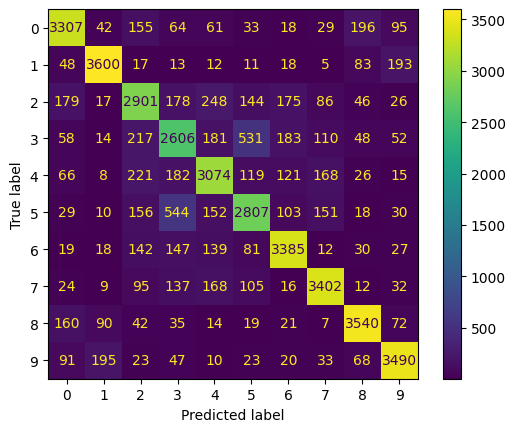

validation...


(Epoch 70 | 79/79) | Data: 0.059s | Batch: 0.063s | Loss: 0.6921| GPU usage: 0.321 GB: 100%|██████████| 79/79 [00:05<00:00, 15.77it/s]


validation loss: 0.69185
validation accuracy: 0.76358
validation precision: 0.76430
validation recall: 0.76430
validation F1-Score: 0.76378
saving with validation loss of 0.6918511986732483
[Epoch: 71 training...]


(Epoch 71 | 313/313) | Data: 0.055s | Batch: 0.093s | Loss: 0.5666 | GPU usage: 0.321 GB: 100%|██████████| 313/313 [00:29<00:00, 10.72it/s]


learning rate is 2.1404630011522586e-05
training loss: 0.56670
training accuracy: 0.80240
training precision: 0.80155
training recall: 0.80240
training F1-Score: 0.80192


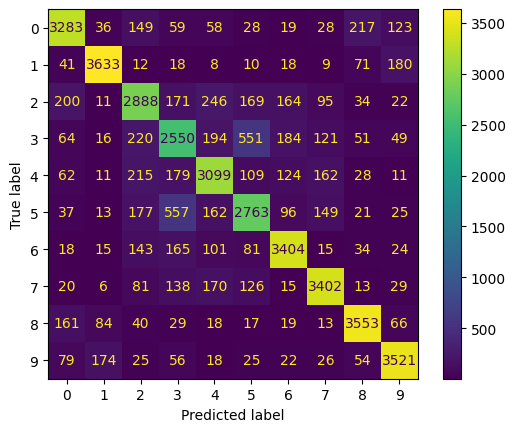

validation...


(Epoch 71 | 79/79) | Data: 0.057s | Batch: 0.076s | Loss: 0.6883| GPU usage: 0.321 GB: 100%|██████████| 79/79 [00:06<00:00, 12.98it/s]


validation loss: 0.68837
validation accuracy: 0.76217
validation precision: 0.76290
validation recall: 0.76290
validation F1-Score: 0.76239
saving with validation loss of 0.6883707642555237
[Epoch: 72 training...]


(Epoch 72 | 313/313) | Data: 0.053s | Batch: 0.086s | Loss: 0.5598 | GPU usage: 0.321 GB: 100%|██████████| 313/313 [00:26<00:00, 11.62it/s]


learning rate is 2.016110084417766e-05
training loss: 0.55948
training accuracy: 0.80553
training precision: 0.80498
training recall: 0.80553
training F1-Score: 0.80521


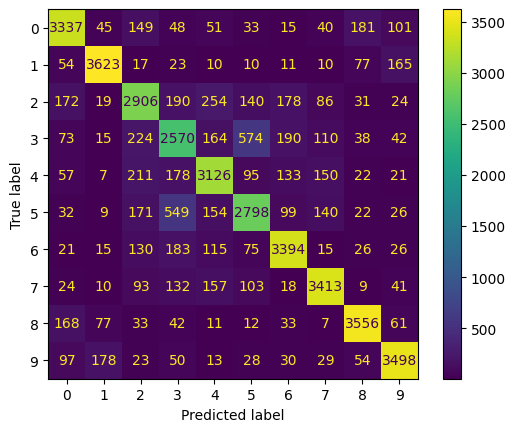

validation...


(Epoch 72 | 79/79) | Data: 0.056s | Batch: 0.077s | Loss: 0.6926| GPU usage: 0.321 GB: 100%|██████████| 79/79 [00:06<00:00, 12.80it/s]


validation loss: 0.69270
validation accuracy: 0.76272
validation precision: 0.76320
validation recall: 0.76320
validation F1-Score: 0.76278
saving with validation loss of 0.6926966905593872
[Epoch: 73 training...]


(Epoch 73 | 313/313) | Data: 0.056s | Batch: 0.100s | Loss: 0.5563 | GPU usage: 0.321 GB: 100%|██████████| 313/313 [00:31<00:00, 10.02it/s]


learning rate is 1.8947512507439858e-05
training loss: 0.55612
training accuracy: 0.80490
training precision: 0.80433
training recall: 0.80490
training F1-Score: 0.80454


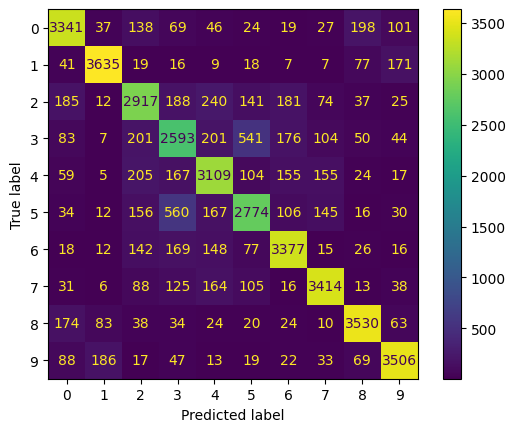

validation...


(Epoch 73 | 79/79) | Data: 0.056s | Batch: 0.076s | Loss: 0.6919| GPU usage: 0.321 GB: 100%|██████████| 79/79 [00:06<00:00, 12.94it/s]


validation loss: 0.69239
validation accuracy: 0.76247
validation precision: 0.76320
validation recall: 0.76320
validation F1-Score: 0.76265
saving with validation loss of 0.6923858523368835
[Epoch: 74 training...]


(Epoch 74 | 313/313) | Data: 0.054s | Batch: 0.091s | Loss: 0.5540 | GPU usage: 0.321 GB: 100%|██████████| 313/313 [00:28<00:00, 10.98it/s]


learning rate is 1.776506266647924e-05
training loss: 0.55399
training accuracy: 0.80585
training precision: 0.80541
training recall: 0.80585
training F1-Score: 0.80558


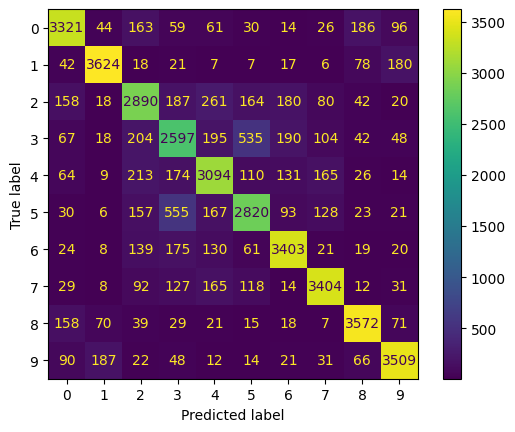

validation...


(Epoch 74 | 79/79) | Data: 0.059s | Batch: 0.081s | Loss: 0.6904| GPU usage: 0.321 GB: 100%|██████████| 79/79 [00:06<00:00, 12.19it/s]


validation loss: 0.69079
validation accuracy: 0.76476
validation precision: 0.76550
validation recall: 0.76550
validation F1-Score: 0.76488
saving with validation loss of 0.6907860636711121
[Epoch: 75 training...]


(Epoch 75 | 313/313) | Data: 0.055s | Batch: 0.093s | Loss: 0.5518 | GPU usage: 0.321 GB: 100%|██████████| 313/313 [00:29<00:00, 10.73it/s]


learning rate is 1.661491825652991e-05
training loss: 0.55167
training accuracy: 0.80695
training precision: 0.80632
training recall: 0.80695
training F1-Score: 0.80658


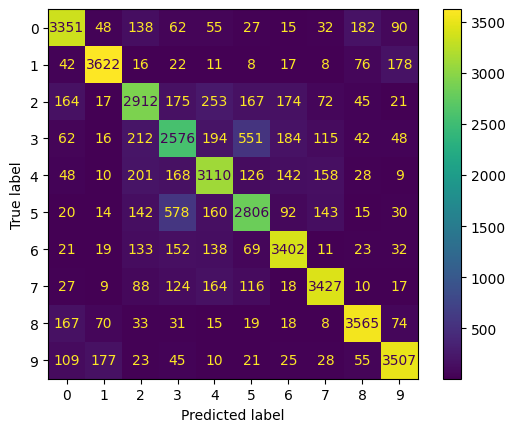

validation...


(Epoch 75 | 79/79) | Data: 0.058s | Batch: 0.079s | Loss: 0.6949| GPU usage: 0.321 GB: 100%|██████████| 79/79 [00:06<00:00, 12.44it/s]


validation loss: 0.69416
validation accuracy: 0.76497
validation precision: 0.76560
validation recall: 0.76560
validation F1-Score: 0.76513
[Epoch: 76 training...]


(Epoch 76 | 313/313) | Data: 0.055s | Batch: 0.096s | Loss: 0.5521 | GPU usage: 0.321 GB: 100%|██████████| 313/313 [00:30<00:00, 10.37it/s]


learning rate is 1.54982143312659e-05
training loss: 0.55205
training accuracy: 0.80588
training precision: 0.80519
training recall: 0.80588
training F1-Score: 0.80549


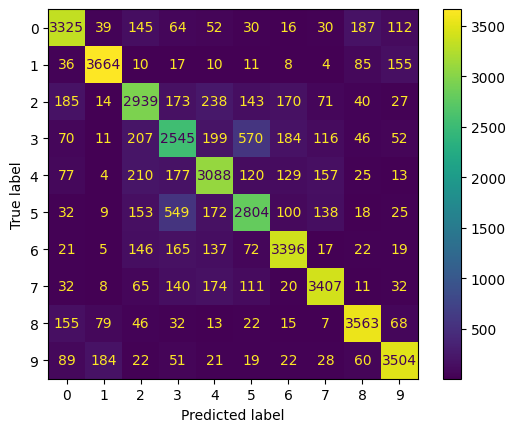

validation...


(Epoch 76 | 79/79) | Data: 0.056s | Batch: 0.074s | Loss: 0.6890| GPU usage: 0.321 GB: 100%|██████████| 79/79 [00:05<00:00, 13.30it/s]


validation loss: 0.68808
validation accuracy: 0.76858
validation precision: 0.76900
validation recall: 0.76900
validation F1-Score: 0.76863
saving with validation loss of 0.6880761384963989
[Epoch: 77 training...]


(Epoch 77 | 313/313) | Data: 0.053s | Batch: 0.090s | Loss: 0.5467 | GPU usage: 0.321 GB: 100%|██████████| 313/313 [00:28<00:00, 11.12it/s]


learning rate is 1.441605294264014e-05
training loss: 0.54679
training accuracy: 0.80697
training precision: 0.80642
training recall: 0.80697
training F1-Score: 0.80663


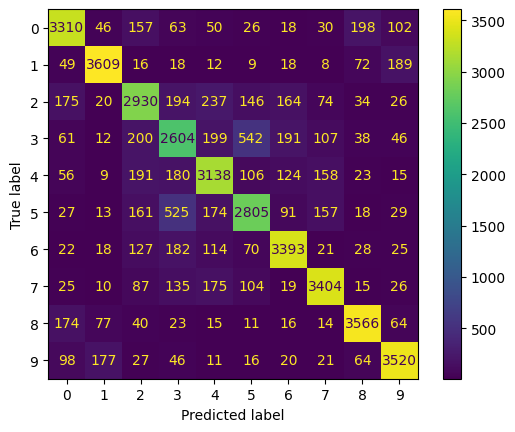

validation...


(Epoch 77 | 79/79) | Data: 0.057s | Batch: 0.079s | Loss: 0.6958| GPU usage: 0.321 GB: 100%|██████████| 79/79 [00:06<00:00, 12.46it/s]


validation loss: 0.69362
validation accuracy: 0.76307
validation precision: 0.76340
validation recall: 0.76340
validation F1-Score: 0.76316
[Epoch: 78 training...]


(Epoch 78 | 313/313) | Data: 0.054s | Batch: 0.090s | Loss: 0.5427 | GPU usage: 0.321 GB: 100%|██████████| 313/313 [00:28<00:00, 11.02it/s]


learning rate is 1.3369502053292257e-05
training loss: 0.54266
training accuracy: 0.81205
training precision: 0.81137
training recall: 0.81205
training F1-Score: 0.81167


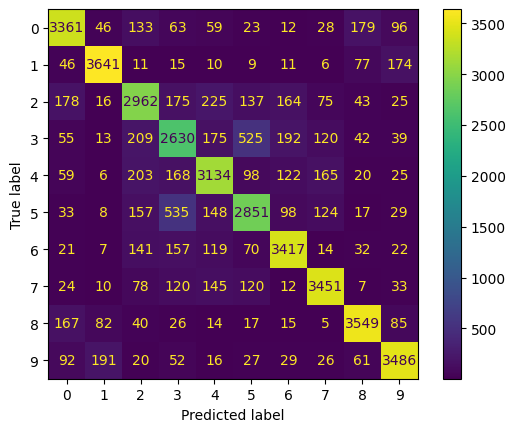

validation...


(Epoch 78 | 79/79) | Data: 0.056s | Batch: 0.078s | Loss: 0.6947| GPU usage: 0.321 GB: 100%|██████████| 79/79 [00:06<00:00, 12.73it/s]


validation loss: 0.69265
validation accuracy: 0.76440
validation precision: 0.76480
validation recall: 0.76480
validation F1-Score: 0.76436
saving with validation loss of 0.6926457285881042
[Epoch: 79 training...]


(Epoch 79 | 313/313) | Data: 0.059s | Batch: 0.104s | Loss: 0.5420 | GPU usage: 0.321 GB: 100%|██████████| 313/313 [00:32<00:00,  9.60it/s]


learning rate is 1.235959448259844e-05
training loss: 0.54199
training accuracy: 0.80830
training precision: 0.80786
training recall: 0.80830
training F1-Score: 0.80804


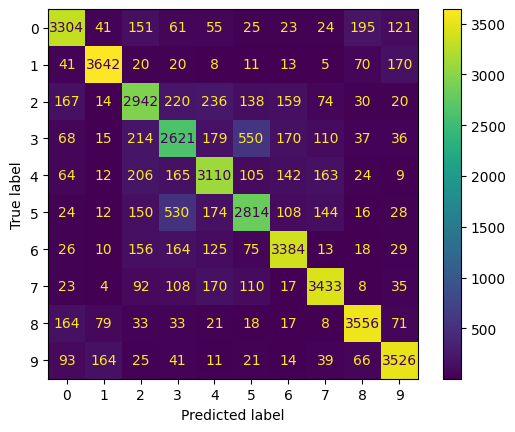

validation...


(Epoch 79 | 79/79) | Data: 0.074s | Batch: 0.097s | Loss: 0.6946| GPU usage: 0.321 GB: 100%|██████████| 79/79 [00:07<00:00, 10.20it/s]


validation loss: 0.69486
validation accuracy: 0.76297
validation precision: 0.76390
validation recall: 0.76390
validation F1-Score: 0.76326
[Epoch: 80 training...]


(Epoch 80 | 313/313) | Data: 0.054s | Batch: 0.088s | Loss: 0.5371 | GPU usage: 0.321 GB: 100%|██████████| 313/313 [00:27<00:00, 11.27it/s]


learning rate is 1.1387326887403327e-05
training loss: 0.53691
training accuracy: 0.81373
training precision: 0.81314
training recall: 0.81373
training F1-Score: 0.81338


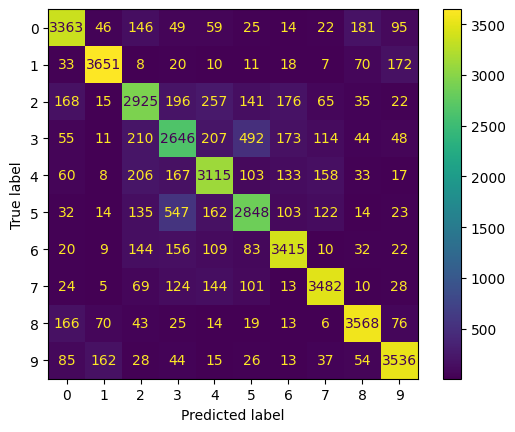

validation...


(Epoch 80 | 79/79) | Data: 0.054s | Batch: 0.076s | Loss: 0.6944| GPU usage: 0.321 GB: 100%|██████████| 79/79 [00:06<00:00, 12.95it/s]


validation loss: 0.69215
validation accuracy: 0.76404
validation precision: 0.76450
validation recall: 0.76450
validation F1-Score: 0.76412
saving with validation loss of 0.6921452283859253
[Epoch: 81 training...]


(Epoch 81 | 313/313) | Data: 0.054s | Batch: 0.095s | Loss: 0.5361 | GPU usage: 0.321 GB: 100%|██████████| 313/313 [00:29<00:00, 10.54it/s]


learning rate is 1.0453658778440109e-05
training loss: 0.53589
training accuracy: 0.81353
training precision: 0.81312
training recall: 0.81352
training F1-Score: 0.81329


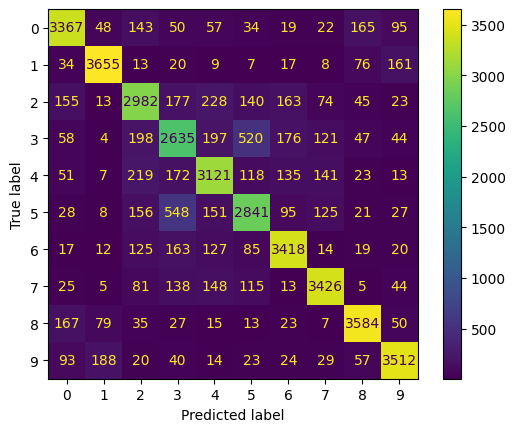

validation...


(Epoch 81 | 79/79) | Data: 0.055s | Batch: 0.074s | Loss: 0.6945| GPU usage: 0.321 GB: 100%|██████████| 79/79 [00:05<00:00, 13.30it/s]


validation loss: 0.69266
validation accuracy: 0.76477
validation precision: 0.76580
validation recall: 0.76580
validation F1-Score: 0.76517
saving with validation loss of 0.6926594376564026
[Epoch: 82 training...]


(Epoch 82 | 313/313) | Data: 0.053s | Batch: 0.091s | Loss: 0.5340 | GPU usage: 0.321 GB: 100%|██████████| 313/313 [00:28<00:00, 10.92it/s]


learning rate is 9.559511573409202e-06
training loss: 0.53409
training accuracy: 0.81345
training precision: 0.81293
training recall: 0.81345
training F1-Score: 0.81313


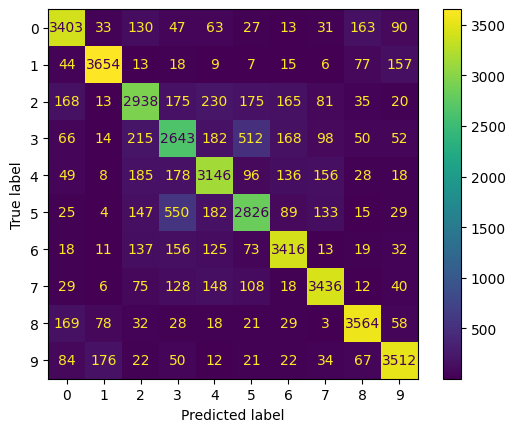

validation...


(Epoch 82 | 79/79) | Data: 0.057s | Batch: 0.076s | Loss: 0.6965| GPU usage: 0.321 GB: 100%|██████████| 79/79 [00:06<00:00, 12.95it/s]


validation loss: 0.69695
validation accuracy: 0.76607
validation precision: 0.76700
validation recall: 0.76700
validation F1-Score: 0.76642
[Epoch: 83 training...]


(Epoch 83 | 313/313) | Data: 0.053s | Batch: 0.091s | Loss: 0.5313 | GPU usage: 0.321 GB: 100%|██████████| 313/313 [00:28<00:00, 11.00it/s]


learning rate is 8.705767687650266e-06
training loss: 0.53130
training accuracy: 0.81322
training precision: 0.81281
training recall: 0.81322
training F1-Score: 0.81297


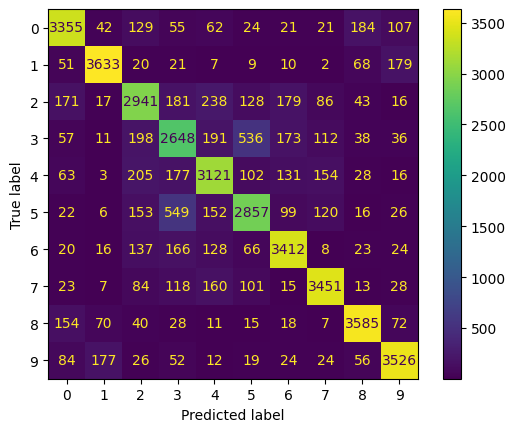

validation...


(Epoch 83 | 79/79) | Data: 0.057s | Batch: 0.080s | Loss: 0.6949| GPU usage: 0.321 GB: 100%|██████████| 79/79 [00:06<00:00, 12.29it/s]


validation loss: 0.69568
validation accuracy: 0.76560
validation precision: 0.76620
validation recall: 0.76620
validation F1-Score: 0.76575
saving with validation loss of 0.6956767439842224
[Epoch: 84 training...]


(Epoch 84 | 313/313) | Data: 0.056s | Batch: 0.103s | Loss: 0.5341 | GPU usage: 0.321 GB: 100%|██████████| 313/313 [00:32<00:00,  9.72it/s]


learning rate is 7.893269663304785e-06
training loss: 0.53379
training accuracy: 0.81245
training precision: 0.81192
training recall: 0.81245
training F1-Score: 0.81212


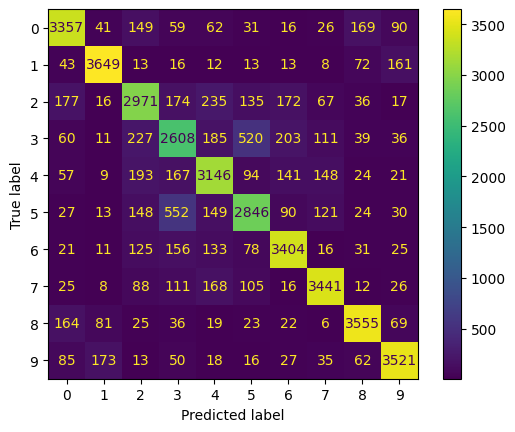

validation...


(Epoch 84 | 79/79) | Data: 0.056s | Batch: 0.075s | Loss: 0.6883| GPU usage: 0.321 GB: 100%|██████████| 79/79 [00:06<00:00, 13.16it/s]


validation loss: 0.68777
validation accuracy: 0.76224
validation precision: 0.76310
validation recall: 0.76310
validation F1-Score: 0.76253
saving with validation loss of 0.6877650618553162
[Epoch: 85 training...]


(Epoch 85 | 313/313) | Data: 0.052s | Batch: 0.088s | Loss: 0.5269 | GPU usage: 0.321 GB: 100%|██████████| 313/313 [00:27<00:00, 11.32it/s]


learning rate is 7.122819337828753e-06
training loss: 0.52726
training accuracy: 0.81655
training precision: 0.81620
training recall: 0.81655
training F1-Score: 0.81634


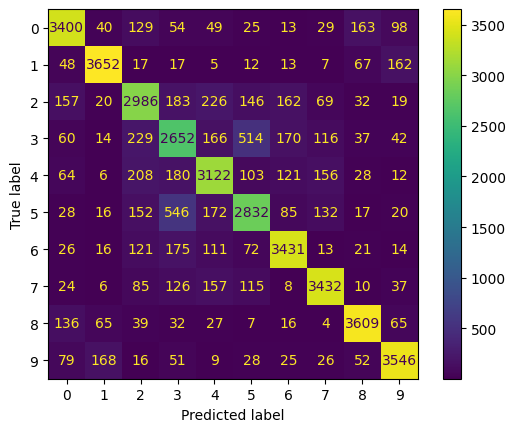

validation...


(Epoch 85 | 79/79) | Data: 0.055s | Batch: 0.075s | Loss: 0.6928| GPU usage: 0.321 GB: 100%|██████████| 79/79 [00:06<00:00, 13.11it/s]


validation loss: 0.69001
validation accuracy: 0.76320
validation precision: 0.76410
validation recall: 0.76410
validation F1-Score: 0.76342
saving with validation loss of 0.6900137066841125
[Epoch: 86 training...]


(Epoch 86 | 313/313) | Data: 0.052s | Batch: 0.088s | Loss: 0.5314 | GPU usage: 0.321 GB: 100%|██████████| 313/313 [00:27<00:00, 11.32it/s]


learning rate is 6.395177052675795e-06
training loss: 0.53171
training accuracy: 0.81330
training precision: 0.81264
training recall: 0.81330
training F1-Score: 0.81292


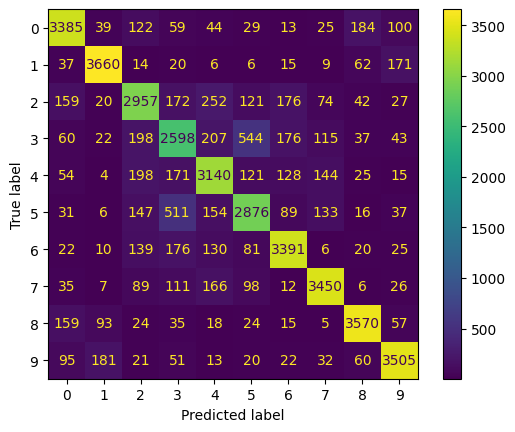

validation...


(Epoch 86 | 79/79) | Data: 0.055s | Batch: 0.076s | Loss: 0.6939| GPU usage: 0.321 GB: 100%|██████████| 79/79 [00:06<00:00, 13.01it/s]


validation loss: 0.69221
validation accuracy: 0.76496
validation precision: 0.76560
validation recall: 0.76560
validation F1-Score: 0.76515
saving with validation loss of 0.6922071576118469
[Epoch: 87 training...]


(Epoch 87 | 313/313) | Data: 0.052s | Batch: 0.087s | Loss: 0.5259 | GPU usage: 0.321 GB: 100%|██████████| 313/313 [00:27<00:00, 11.50it/s]


learning rate is 5.711060902932042e-06
training loss: 0.52580
training accuracy: 0.81590
training precision: 0.81525
training recall: 0.81590
training F1-Score: 0.81552


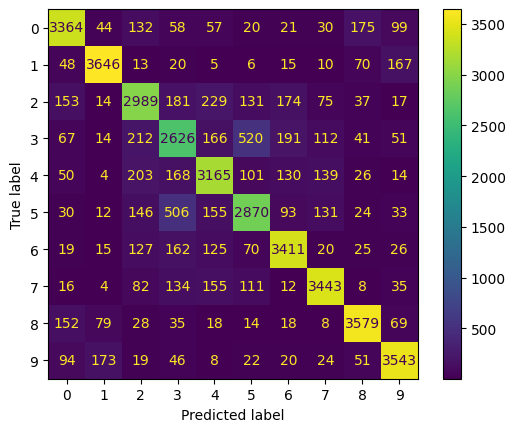

validation...


(Epoch 87 | 79/79) | Data: 0.054s | Batch: 0.074s | Loss: 0.6942| GPU usage: 0.321 GB: 100%|██████████| 79/79 [00:05<00:00, 13.32it/s]


validation loss: 0.69271
validation accuracy: 0.76502
validation precision: 0.76580
validation recall: 0.76580
validation F1-Score: 0.76528
saving with validation loss of 0.6927143931388855
[Epoch: 88 training...]


(Epoch 88 | 313/313) | Data: 0.053s | Batch: 0.091s | Loss: 0.5217 | GPU usage: 0.321 GB: 100%|██████████| 313/313 [00:28<00:00, 11.01it/s]


learning rate is 5.071146028642945e-06
training loss: 0.52184
training accuracy: 0.81912
training precision: 0.81881
training recall: 0.81912
training F1-Score: 0.81890


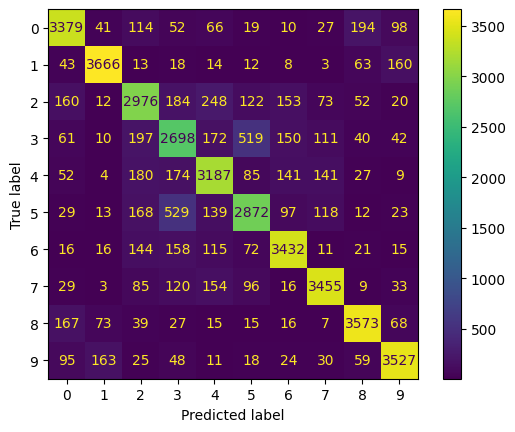

validation...


(Epoch 88 | 79/79) | Data: 0.055s | Batch: 0.075s | Loss: 0.6939| GPU usage: 0.321 GB: 100%|██████████| 79/79 [00:05<00:00, 13.24it/s]


validation loss: 0.69184
validation accuracy: 0.76574
validation precision: 0.76620
validation recall: 0.76620
validation F1-Score: 0.76584
saving with validation loss of 0.6918426752090454
[Epoch: 89 training...]


(Epoch 89 | 313/313) | Data: 0.051s | Batch: 0.085s | Loss: 0.5265 | GPU usage: 0.321 GB: 100%|██████████| 313/313 [00:26<00:00, 11.67it/s]


learning rate is 4.476063948531558e-06
training loss: 0.52686
training accuracy: 0.81393
training precision: 0.81329
training recall: 0.81393
training F1-Score: 0.81357


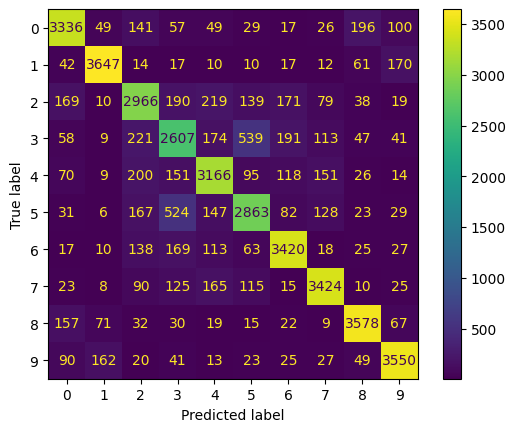

validation...


(Epoch 89 | 79/79) | Data: 0.055s | Batch: 0.078s | Loss: 0.6934| GPU usage: 0.321 GB: 100%|██████████| 79/79 [00:06<00:00, 12.69it/s]


validation loss: 0.69335
validation accuracy: 0.76273
validation precision: 0.76360
validation recall: 0.76360
validation F1-Score: 0.76302
saving with validation loss of 0.6933466196060181
[Epoch: 90 training...]


(Epoch 90 | 313/313) | Data: 0.053s | Batch: 0.089s | Loss: 0.5254 | GPU usage: 0.321 GB: 100%|██████████| 313/313 [00:27<00:00, 11.21it/s]


learning rate is 3.92640193676584e-06
training loss: 0.52541
training accuracy: 0.81647
training precision: 0.81602
training recall: 0.81648
training F1-Score: 0.81619


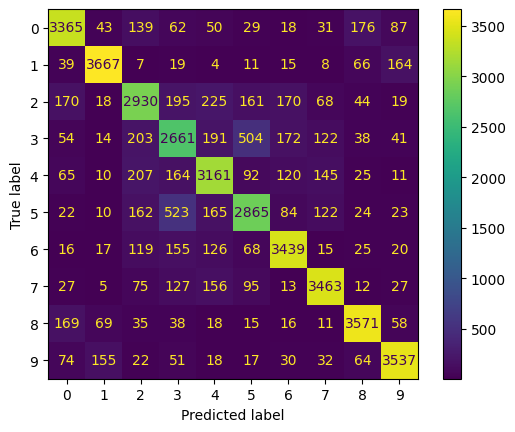

validation...


(Epoch 90 | 79/79) | Data: 0.056s | Batch: 0.076s | Loss: 0.6872| GPU usage: 0.321 GB: 100%|██████████| 79/79 [00:06<00:00, 12.93it/s]


validation loss: 0.68601
validation accuracy: 0.76575
validation precision: 0.76660
validation recall: 0.76660
validation F1-Score: 0.76605
saving with validation loss of 0.6860139966011047
[Epoch: 91 training...]


(Epoch 91 | 313/313) | Data: 0.053s | Batch: 0.094s | Loss: 0.5298 | GPU usage: 0.321 GB: 100%|██████████| 313/313 [00:29<00:00, 10.62it/s]


learning rate is 3.4227024433899e-06
training loss: 0.52981
training accuracy: 0.81583
training precision: 0.81541
training recall: 0.81582
training F1-Score: 0.81554


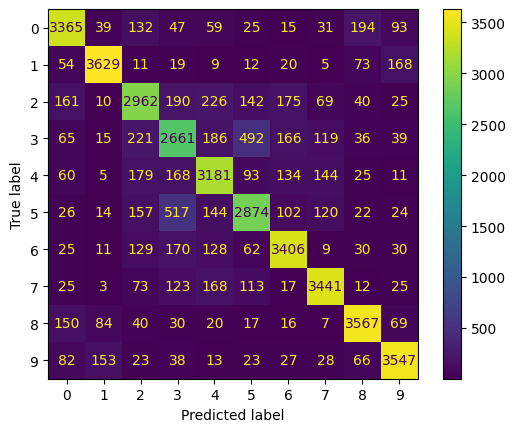

validation...


(Epoch 91 | 79/79) | Data: 0.055s | Batch: 0.076s | Loss: 0.6904| GPU usage: 0.321 GB: 100%|██████████| 79/79 [00:06<00:00, 12.99it/s]


validation loss: 0.68970
validation accuracy: 0.76470
validation precision: 0.76540
validation recall: 0.76540
validation F1-Score: 0.76487
saving with validation loss of 0.6896958947181702
[Epoch: 92 training...]


(Epoch 92 | 313/313) | Data: 0.053s | Batch: 0.090s | Loss: 0.5274 | GPU usage: 0.321 GB: 100%|██████████| 313/313 [00:28<00:00, 11.05it/s]


learning rate is 2.965462558991324e-06
training loss: 0.52727
training accuracy: 0.81770
training precision: 0.81713
training recall: 0.81770
training F1-Score: 0.81738


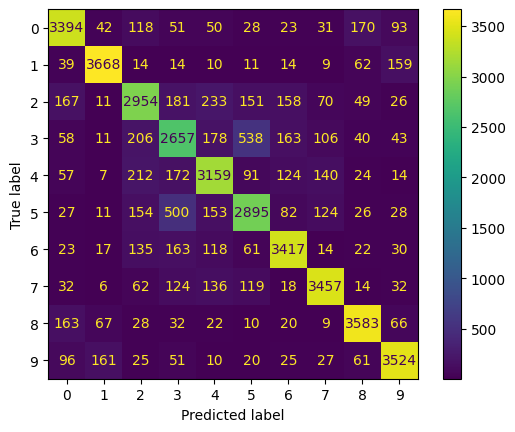

validation...


(Epoch 92 | 79/79) | Data: 0.053s | Batch: 0.072s | Loss: 0.6928| GPU usage: 0.321 GB: 100%|██████████| 79/79 [00:05<00:00, 13.67it/s]


validation loss: 0.69181
validation accuracy: 0.76595
validation precision: 0.76630
validation recall: 0.76630
validation F1-Score: 0.76600
saving with validation loss of 0.691813051700592
[Epoch: 93 training...]


(Epoch 93 | 313/313) | Data: 0.056s | Batch: 0.095s | Loss: 0.5241 | GPU usage: 0.321 GB: 100%|██████████| 313/313 [00:29<00:00, 10.49it/s]


learning rate is 2.5551335241327673e-06
training loss: 0.52434
training accuracy: 0.81778
training precision: 0.81736
training recall: 0.81777
training F1-Score: 0.81751


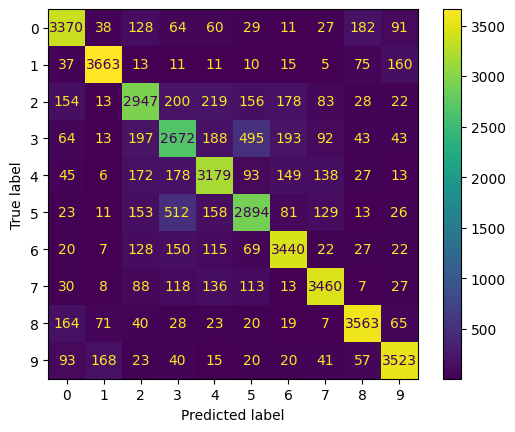

validation...


(Epoch 93 | 79/79) | Data: 0.055s | Batch: 0.075s | Loss: 0.6904| GPU usage: 0.321 GB: 100%|██████████| 79/79 [00:06<00:00, 13.14it/s]


validation loss: 0.68985
validation accuracy: 0.76773
validation precision: 0.76820
validation recall: 0.76820
validation F1-Score: 0.76776
saving with validation loss of 0.6898475289344788
[Epoch: 94 training...]


(Epoch 94 | 313/313) | Data: 0.053s | Batch: 0.093s | Loss: 0.5237 | GPU usage: 0.321 GB: 100%|██████████| 313/313 [00:29<00:00, 10.69it/s]


learning rate is 2.1921202840320077e-06
training loss: 0.52339
training accuracy: 0.81537
training precision: 0.81498
training recall: 0.81538
training F1-Score: 0.81513


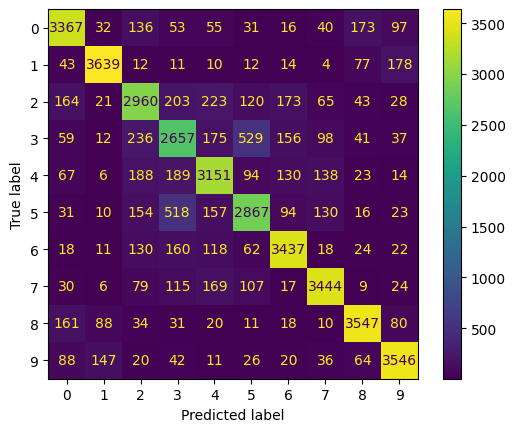

validation...


(Epoch 94 | 79/79) | Data: 0.056s | Batch: 0.077s | Loss: 0.6873| GPU usage: 0.321 GB: 100%|██████████| 79/79 [00:06<00:00, 12.82it/s]


validation loss: 0.68676
validation accuracy: 0.76521
validation precision: 0.76570
validation recall: 0.76570
validation F1-Score: 0.76525
saving with validation loss of 0.6867565512657166
[Epoch: 95 training...]


(Epoch 95 | 313/313) | Data: 0.053s | Batch: 0.089s | Loss: 0.5177 | GPU usage: 0.321 GB: 100%|██████████| 313/313 [00:27<00:00, 11.23it/s]


learning rate is 1.8767810889299083e-06
training loss: 0.51761
training accuracy: 0.81960
training precision: 0.81904
training recall: 0.81960
training F1-Score: 0.81926


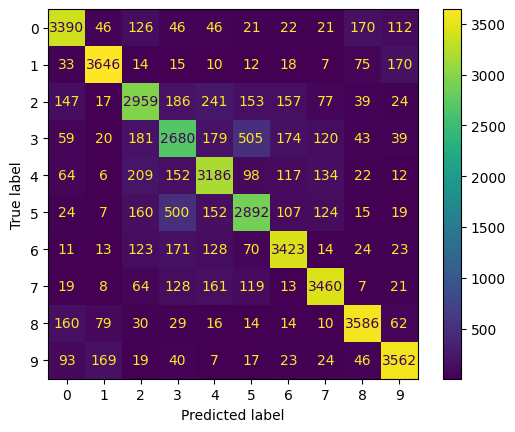

validation...


(Epoch 95 | 79/79) | Data: 0.057s | Batch: 0.079s | Loss: 0.6915| GPU usage: 0.321 GB: 100%|██████████| 79/79 [00:06<00:00, 12.55it/s]


validation loss: 0.69153
validation accuracy: 0.76584
validation precision: 0.76650
validation recall: 0.76650
validation F1-Score: 0.76606
saving with validation loss of 0.6915324926376343
[Epoch: 96 training...]


(Epoch 96 | 313/313) | Data: 0.054s | Batch: 0.093s | Loss: 0.5189 | GPU usage: 0.321 GB: 100%|██████████| 313/313 [00:29<00:00, 10.77it/s]


learning rate is 1.6094271405406859e-06
training loss: 0.51910
training accuracy: 0.81755
training precision: 0.81732
training recall: 0.81755
training F1-Score: 0.81737


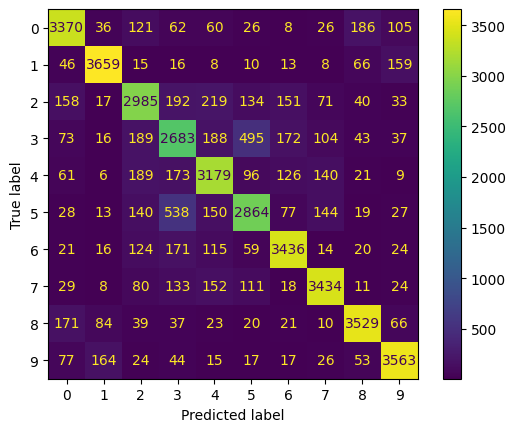

validation...


(Epoch 96 | 79/79) | Data: 0.056s | Batch: 0.077s | Loss: 0.6956| GPU usage: 0.321 GB: 100%|██████████| 79/79 [00:06<00:00, 12.92it/s]


validation loss: 0.69324
validation accuracy: 0.76118
validation precision: 0.76150
validation recall: 0.76150
validation F1-Score: 0.76115
[Epoch: 97 training...]


(Epoch 97 | 313/313) | Data: 0.052s | Batch: 0.086s | Loss: 0.5207 | GPU usage: 0.321 GB: 100%|██████████| 313/313 [00:26<00:00, 11.62it/s]


learning rate is 1.3903222849333507e-06
training loss: 0.52075
training accuracy: 0.81858
training precision: 0.81805
training recall: 0.81857
training F1-Score: 0.81827


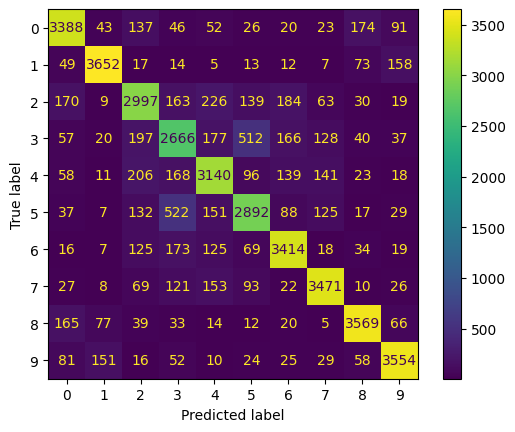

validation...


(Epoch 97 | 79/79) | Data: 0.056s | Batch: 0.081s | Loss: 0.6936| GPU usage: 0.321 GB: 100%|██████████| 79/79 [00:06<00:00, 12.26it/s]


validation loss: 0.69345
validation accuracy: 0.76627
validation precision: 0.76660
validation recall: 0.76660
validation F1-Score: 0.76621
saving with validation loss of 0.6934473514556885
[Epoch: 98 training...]


(Epoch 98 | 313/313) | Data: 0.052s | Batch: 0.088s | Loss: 0.5198 | GPU usage: 0.321 GB: 100%|██████████| 313/313 [00:27<00:00, 11.38it/s]


learning rate is 1.21968275214754e-06
training loss: 0.51972
training accuracy: 0.81712
training precision: 0.81676
training recall: 0.81713
training F1-Score: 0.81687


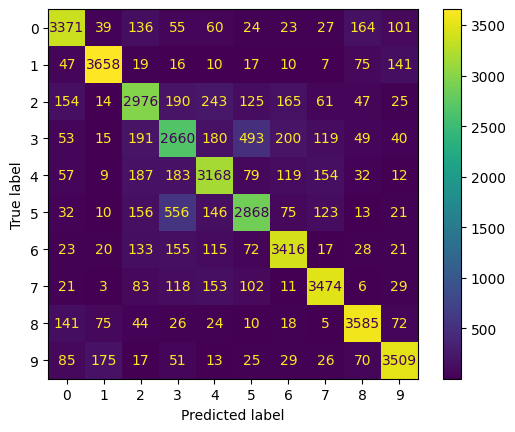

validation...


(Epoch 98 | 79/79) | Data: 0.055s | Batch: 0.078s | Loss: 0.6908| GPU usage: 0.321 GB: 100%|██████████| 79/79 [00:06<00:00, 12.64it/s]


validation loss: 0.69086
validation accuracy: 0.76440
validation precision: 0.76550
validation recall: 0.76550
validation F1-Score: 0.76482
saving with validation loss of 0.6908624768257141
[Epoch: 99 training...]


(Epoch 99 | 313/313) | Data: 0.053s | Batch: 0.090s | Loss: 0.5218 | GPU usage: 0.321 GB: 100%|██████████| 313/313 [00:28<00:00, 11.11it/s]


learning rate is 1.0976769428005578e-06
training loss: 0.52159
training accuracy: 0.82005
training precision: 0.81954
training recall: 0.82005
training F1-Score: 0.81976


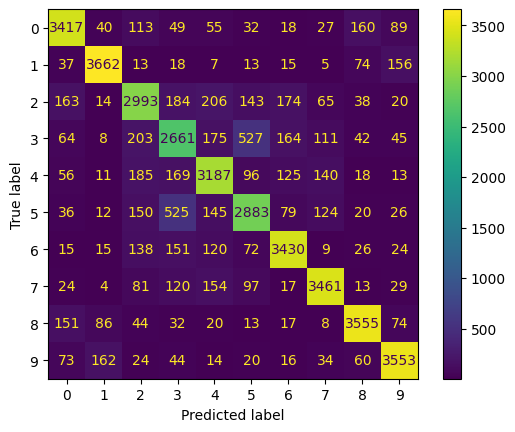

validation...


(Epoch 99 | 79/79) | Data: 0.053s | Batch: 0.075s | Loss: 0.6947| GPU usage: 0.321 GB: 100%|██████████| 79/79 [00:05<00:00, 13.18it/s]


validation loss: 0.69442
validation accuracy: 0.76598
validation precision: 0.76650
validation recall: 0.76650
validation F1-Score: 0.76608
[Epoch: 100 training...]


(Epoch 100 | 313/313) | Data: 0.053s | Batch: 0.091s | Loss: 0.5238 | GPU usage: 0.321 GB: 100%|██████████| 313/313 [00:28<00:00, 10.96it/s]


learning rate is 1.0244252618962857e-06
training loss: 0.52375
training accuracy: 0.81890
training precision: 0.81847
training recall: 0.81890
training F1-Score: 0.81862


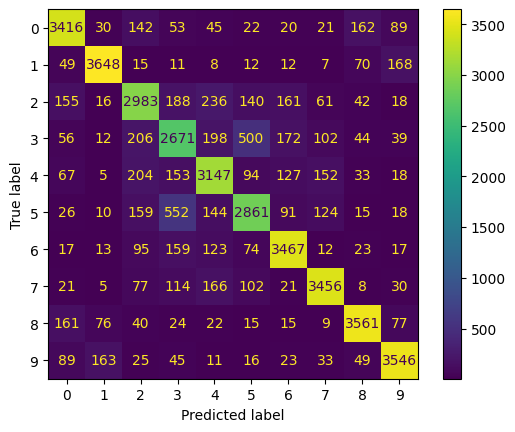

validation...


(Epoch 100 | 79/79) | Data: 0.055s | Batch: 0.074s | Loss: 0.6911| GPU usage: 0.321 GB: 100%|██████████| 79/79 [00:05<00:00, 13.32it/s]


validation loss: 0.69096
validation accuracy: 0.76693
validation precision: 0.76760
validation recall: 0.76760
validation F1-Score: 0.76706
saving with validation loss of 0.6909593939781189


In [19]:
training_funcs.train_model(model, train_loader, num_epochs, writer_train, writer_val, device, val_loader, optimizer, criterion, num_classes, scheduler, training_des, lr, model_name, save_dir, grad_accum, start_epoch, min_loss_diff, min_loss_mean, scaler)


I Ran the custom ConvNet Model initially for 100 epochs , However upon inspection (looking at the tensorboard graphs)(The train/val loss is decreasing, train/val accuracy is increasing) i think we should train it for a few more epochs.

Here i showcase the use of the Resume Functionality in my script wherein i load the last epoch's saved weights and other parameters states and train the model for a few more epochs. (With this we dont have to train the model from scratch)

Lets train it till 150 epochs

In [28]:
utils.seed_everything(420)  # seed random number generator (To make everything deterministic/reproducible)
device = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')
# device = 'cpu'
print(device)

#Basic setup


path=r"C:\Users\satya\Downloads\Cifar10"

transform_train= transforms.Compose([
    transforms.ToTensor(),
    transforms.RandomHorizontalFlip(p=0.5),
    transforms.Normalize(mean=(0.4913997551666284, 0.48215855929893703, 0.4465309133731618),std=(0.24703225141799082, 0.24348516474564, 0.26158783926049628)),
])

transform_val = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize(mean=(0.4913997551666284, 0.48215855929893703, 0.4465309133731618),std=(0.24703225141799082, 0.24348516474564, 0.26158783926049628)),
])

# Load CIFAR-10 dataset
cifar10_train = datasets.CIFAR10(root=path, train=True, download=True, transform=transform_train)
cifar10_test = datasets.CIFAR10(root=path, train=False, download=True, transform=transform_val)

# Extract digit classes (0-9)
digit_classes = [0, 1, 2, 3, 4, 5, 6, 7, 8, 9]

# Create subsets for digits
train_indices = [i for i, (_, label) in enumerate(cifar10_train) if label in digit_classes]
train_labels = [cifar10_train.targets[i] for i in train_indices]

# Perform stratified split into train and validation sets
train_indices, val_indices = train_test_split(
    train_indices,
    test_size=0.2,
    stratify=train_labels,
    random_state=42
)

#Model selection and parameters

model_name = 'Custom_ConvNet'
run = 'ConvNet'
num_classes = 10

# model = timm.create_model('resnet50', num_classes=num_classes, pretrained=True)
model = ConvNet()
# model= nn.DataParallel(model)

model=model.to(device)
for params in model.parameters():
    params.requires_grad = True

print(f'Model Name : ',model_name)
print(f"Total number of trainable parameters in model {sum(p.numel() for p in model.parameters() if p.requires_grad is True)}")

#Hyperparameters

batch_size = 128
# lr = 0.0001
lr = 1e-4
num_epochs = 150
grad_accum = 1

#Loss Function
# criterion = smp.losses.TverskyLoss(mode = 'multiclass', from_logits=True,alpha = 0.50,beta = 0.50).to(device = device)
# criterion = smp.losses.DiceLoss(mode = 'multiclass', from_logits=True).to(device = device)
criterion = nn.CrossEntropyLoss().to(device=device)

#Optimizer
optimizer = timm.optim.AdamW(model.parameters(), lr = lr)
#Scheduler
scheduler = timm.scheduler.CosineLRScheduler(optimizer, t_initial = num_epochs, lr_min = 1e-6)
#scaler
scaler = torch.amp.GradScaler()

# #Data and paths set up

train_subset = Subset(cifar10_train, train_indices)
val_subset = Subset(cifar10_train, val_indices)

# Create DataLoaders
train_loader = DataLoader(train_subset, batch_size=batch_size, shuffle=True)
val_loader = DataLoader(val_subset, batch_size=batch_size, shuffle=False)


# base_path = "D:\\Experiments"
base_path = r"C:\Users\satya\Downloads\New"
iteration='3'


#Model details and tensorboard
training_des = 'with_overlay'

tb_path = f'TB_data_iteration_{iteration}_{model_name}_{training_des}_effective_bs:_{batch_size*grad_accum}_epochs:_{num_epochs}'

# writer_train = SummaryWriter(os.path.join(base_path, '\\tensorboard_logs\\'  + f'{tb_path}' + '_train'))
# writer_val = SummaryWriter(os.path.join(base_path, '\\tensorboard_logs\\' + f'{tb_path}' + '_val'))
writer_train = SummaryWriter(os.path.join(base_path, 'tensorboard_logs\\'  f'Iteration_{iteration}' + '_train'))
writer_val = SummaryWriter(os.path.join(base_path, 'tensorboard_logs\\' + f'Iteration_{iteration}' + '_val'))

if not os.path.exists(os.path.join(base_path, 'tensorboard_logs')):
    os.mkdir(os.path.join(base_path, 'tensorboard_logs'))

#Model saving path
save_dir = os.path.join(base_path,'training_weights')
if not os.path.exists(save_dir):
    os.mkdir(save_dir)

resume = True # Setting resume variable true to resume training from 100th epoch
resume_checkpoint = r"C:\Users\satya\Downloads\New\training_weights\Last_Model_with_overlay_0.0001_Custom_ConvNet_99.pt"
##Ensure the base_path for checkpoint. This is to ensure the tensorboard logs are correct
if resume:
    assert os.path.isfile(resume_checkpoint), 'The path does not exist'
    checkpoint = torch.load(resume_checkpoint,weights_only=True)
    model.load_state_dict(checkpoint['model_state_dict'])
    optimizer.load_state_dict(checkpoint['opt_state_dict'])
    scaler.load_state_dict(checkpoint['scalar_state'])
    scheduler.load_state_dict(checkpoint['scheduler_state'])
    start_epoch = checkpoint['epoch'] + 1
    min_loss_diff = checkpoint['min_loss_diff']
    min_loss_mean = checkpoint['min_loss_mean']
    print(f"Resuming Training from Epoch : ",start_epoch)
else:
    start_epoch = 0
    min_loss_diff = 1000
    min_loss_mean = 1000


cuda:0
Files already downloaded and verified
Files already downloaded and verified
Model Name :  Custom_ConvNet
Total number of trainable parameters in model 2791434
Resuming Training from Epoch :  100


[Epoch: 101 training...]


(Epoch 101 | 313/313) | Data: 0.054s | Batch: 0.095s | Loss: 0.5204 | GPU usage: 0.418 GB: 100%|██████████| 313/313 [00:29<00:00, 10.56it/s]


learning rate is 1e-06
training loss: 0.52046
training accuracy: 0.81695
training precision: 0.81663
training recall: 0.81695
training F1-Score: 0.81673


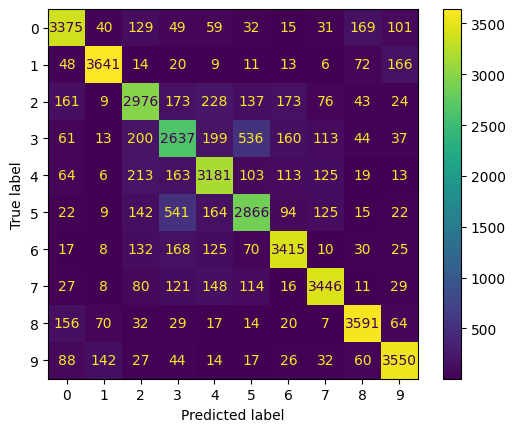

validation...


(Epoch 101 | 79/79) | Data: 0.056s | Batch: 0.075s | Loss: 0.6923| GPU usage: 0.418 GB: 100%|██████████| 79/79 [00:06<00:00, 13.13it/s]


validation loss: 0.69098
validation accuracy: 0.76753
validation precision: 0.76840
validation recall: 0.76840
validation F1-Score: 0.76779
saving with validation loss of 0.690979540348053
[Epoch: 102 training...]


(Epoch 102 | 313/313) | Data: 0.052s | Batch: 0.088s | Loss: 0.5164 | GPU usage: 0.418 GB: 100%|██████████| 313/313 [00:27<00:00, 11.29it/s]


learning rate is 1e-06
training loss: 0.51649
training accuracy: 0.81940
training precision: 0.81902
training recall: 0.81940
training F1-Score: 0.81917


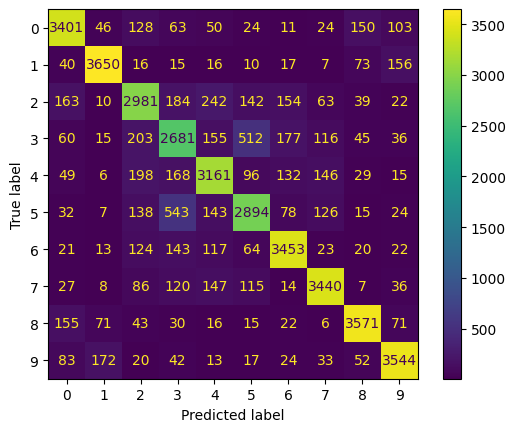

validation...


(Epoch 102 | 79/79) | Data: 0.055s | Batch: 0.074s | Loss: 0.6901| GPU usage: 0.418 GB: 100%|██████████| 79/79 [00:05<00:00, 13.25it/s]


validation loss: 0.68944
validation accuracy: 0.76653
validation precision: 0.76740
validation recall: 0.76740
validation F1-Score: 0.76678
saving with validation loss of 0.689444899559021
[Epoch: 103 training...]


(Epoch 103 | 313/313) | Data: 0.052s | Batch: 0.088s | Loss: 0.5155 | GPU usage: 0.418 GB: 100%|██████████| 313/313 [00:27<00:00, 11.27it/s]


learning rate is 1e-06
training loss: 0.51552
training accuracy: 0.82037
training precision: 0.81992
training recall: 0.82037
training F1-Score: 0.82011


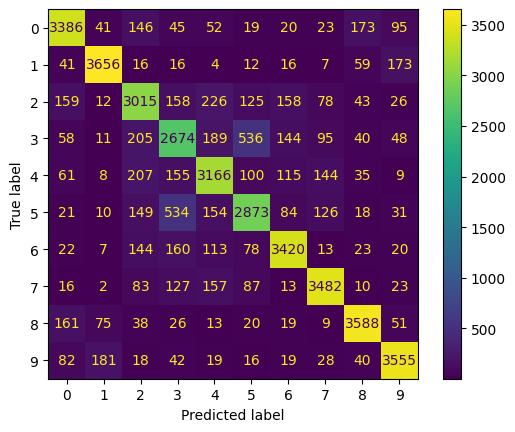

validation...


(Epoch 103 | 79/79) | Data: 0.052s | Batch: 0.067s | Loss: 0.6953| GPU usage: 0.418 GB: 100%|██████████| 79/79 [00:05<00:00, 14.74it/s]


validation loss: 0.69468
validation accuracy: 0.76570
validation precision: 0.76670
validation recall: 0.76670
validation F1-Score: 0.76603
[Epoch: 104 training...]


(Epoch 104 | 313/313) | Data: 0.052s | Batch: 0.088s | Loss: 0.5172 | GPU usage: 0.418 GB: 100%|██████████| 313/313 [00:27<00:00, 11.39it/s]


learning rate is 1e-06
training loss: 0.51737
training accuracy: 0.81968
training precision: 0.81940
training recall: 0.81967
training F1-Score: 0.81945


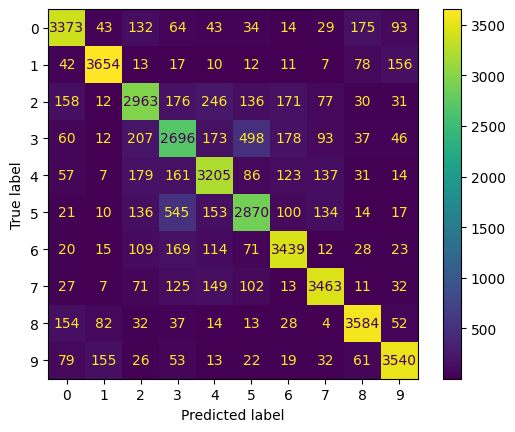

validation...


(Epoch 104 | 79/79) | Data: 0.055s | Batch: 0.075s | Loss: 0.6919| GPU usage: 0.418 GB: 100%|██████████| 79/79 [00:05<00:00, 13.21it/s]


validation loss: 0.68924
validation accuracy: 0.76558
validation precision: 0.76620
validation recall: 0.76620
validation F1-Score: 0.76576
saving with validation loss of 0.6892394423484802
[Epoch: 105 training...]


(Epoch 105 | 313/313) | Data: 0.054s | Batch: 0.093s | Loss: 0.5197 | GPU usage: 0.418 GB: 100%|██████████| 313/313 [00:29<00:00, 10.72it/s]


learning rate is 1e-06
training loss: 0.51949
training accuracy: 0.81907
training precision: 0.81860
training recall: 0.81907
training F1-Score: 0.81879


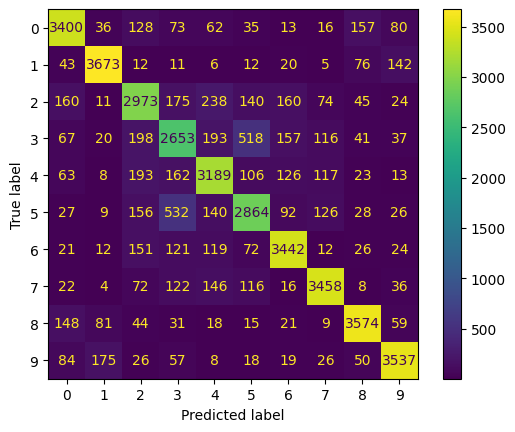

validation...


(Epoch 105 | 79/79) | Data: 0.053s | Batch: 0.070s | Loss: 0.6918| GPU usage: 0.418 GB: 100%|██████████| 79/79 [00:05<00:00, 14.12it/s]


validation loss: 0.69006
validation accuracy: 0.76418
validation precision: 0.76510
validation recall: 0.76510
validation F1-Score: 0.76454
saving with validation loss of 0.6900631785392761
[Epoch: 106 training...]


(Epoch 106 | 313/313) | Data: 0.051s | Batch: 0.086s | Loss: 0.5163 | GPU usage: 0.418 GB: 100%|██████████| 313/313 [00:26<00:00, 11.60it/s]


learning rate is 1e-06
training loss: 0.51601
training accuracy: 0.82145
training precision: 0.82082
training recall: 0.82145
training F1-Score: 0.82106


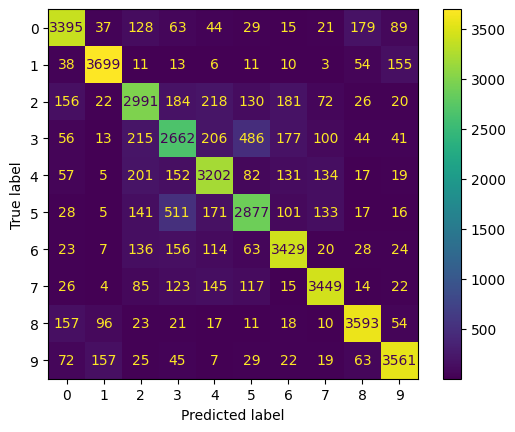

validation...


(Epoch 106 | 79/79) | Data: 0.056s | Batch: 0.079s | Loss: 0.6904| GPU usage: 0.418 GB: 100%|██████████| 79/79 [00:06<00:00, 12.44it/s]


validation loss: 0.68872
validation accuracy: 0.76482
validation precision: 0.76520
validation recall: 0.76520
validation F1-Score: 0.76485
saving with validation loss of 0.6887155771255493
[Epoch: 107 training...]


(Epoch 107 | 313/313) | Data: 0.051s | Batch: 0.087s | Loss: 0.5192 | GPU usage: 0.418 GB: 100%|██████████| 313/313 [00:27<00:00, 11.49it/s]


learning rate is 1e-06
training loss: 0.51922
training accuracy: 0.81840
training precision: 0.81805
training recall: 0.81840
training F1-Score: 0.81815


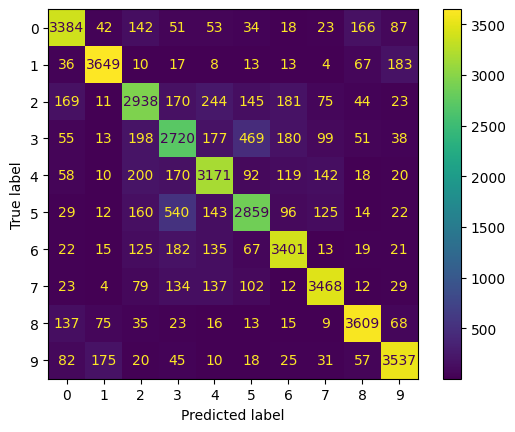

validation...


(Epoch 107 | 79/79) | Data: 0.054s | Batch: 0.075s | Loss: 0.6889| GPU usage: 0.418 GB: 100%|██████████| 79/79 [00:05<00:00, 13.18it/s]


validation loss: 0.68828
validation accuracy: 0.76607
validation precision: 0.76680
validation recall: 0.76680
validation F1-Score: 0.76628
saving with validation loss of 0.6882836818695068
[Epoch: 108 training...]


(Epoch 108 | 313/313) | Data: 0.054s | Batch: 0.095s | Loss: 0.5161 | GPU usage: 0.418 GB: 100%|██████████| 313/313 [00:29<00:00, 10.45it/s]


learning rate is 1e-06
training loss: 0.51629
training accuracy: 0.82137
training precision: 0.82093
training recall: 0.82138
training F1-Score: 0.82112


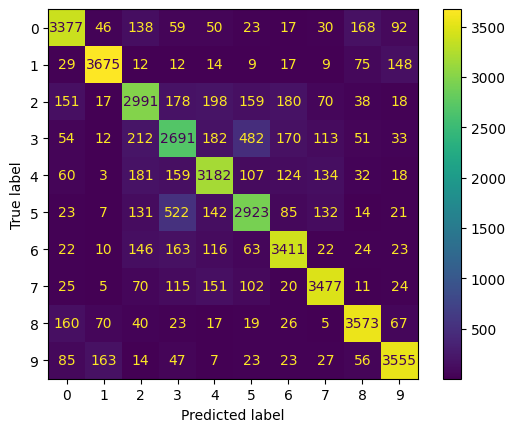

validation...


(Epoch 108 | 79/79) | Data: 0.055s | Batch: 0.071s | Loss: 0.6971| GPU usage: 0.418 GB: 100%|██████████| 79/79 [00:05<00:00, 13.95it/s]


validation loss: 0.69761
validation accuracy: 0.76267
validation precision: 0.76320
validation recall: 0.76320
validation F1-Score: 0.76281
[Epoch: 109 training...]


(Epoch 109 | 313/313) | Data: 0.052s | Batch: 0.086s | Loss: 0.5112 | GPU usage: 0.418 GB: 100%|██████████| 313/313 [00:26<00:00, 11.64it/s]


learning rate is 1e-06
training loss: 0.51109
training accuracy: 0.82278
training precision: 0.82257
training recall: 0.82278
training F1-Score: 0.82261


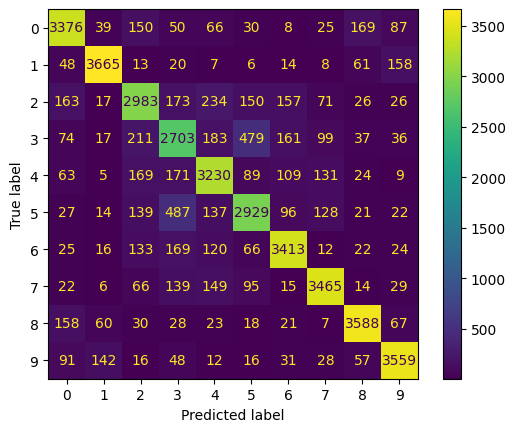

validation...


(Epoch 109 | 79/79) | Data: 0.057s | Batch: 0.081s | Loss: 0.6937| GPU usage: 0.418 GB: 100%|██████████| 79/79 [00:06<00:00, 12.18it/s]


validation loss: 0.69344
validation accuracy: 0.76600
validation precision: 0.76600
validation recall: 0.76600
validation F1-Score: 0.76584
saving with validation loss of 0.6934409737586975
[Epoch: 110 training...]


(Epoch 110 | 313/313) | Data: 0.054s | Batch: 0.094s | Loss: 0.5121 | GPU usage: 0.418 GB: 100%|██████████| 313/313 [00:29<00:00, 10.60it/s]


learning rate is 1e-06
training loss: 0.51218
training accuracy: 0.82073
training precision: 0.82016
training recall: 0.82072
training F1-Score: 0.82041


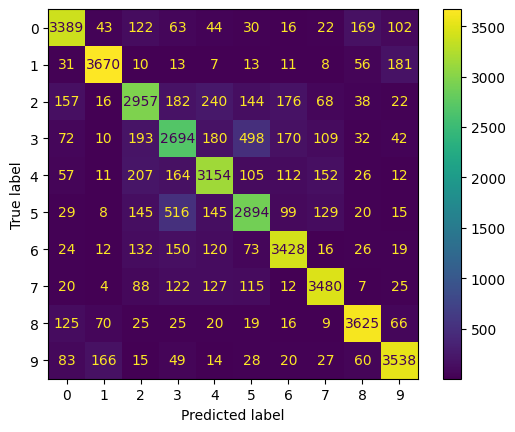

validation...


(Epoch 110 | 79/79) | Data: 0.056s | Batch: 0.075s | Loss: 0.6969| GPU usage: 0.418 GB: 100%|██████████| 79/79 [00:06<00:00, 13.13it/s]


validation loss: 0.69711
validation accuracy: 0.76591
validation precision: 0.76650
validation recall: 0.76650
validation F1-Score: 0.76600
[Epoch: 111 training...]


(Epoch 111 | 313/313) | Data: 0.053s | Batch: 0.091s | Loss: 0.5072 | GPU usage: 0.418 GB: 100%|██████████| 313/313 [00:28<00:00, 11.01it/s]


learning rate is 1e-06
training loss: 0.50708
training accuracy: 0.82380
training precision: 0.82356
training recall: 0.82380
training F1-Score: 0.82362


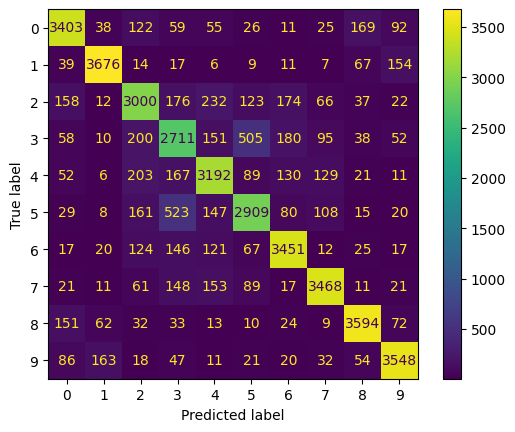

validation...


(Epoch 111 | 79/79) | Data: 0.057s | Batch: 0.078s | Loss: 0.6876| GPU usage: 0.418 GB: 100%|██████████| 79/79 [00:06<00:00, 12.70it/s]


validation loss: 0.68815
validation accuracy: 0.76753
validation precision: 0.76800
validation recall: 0.76800
validation F1-Score: 0.76762
saving with validation loss of 0.6881462335586548
[Epoch: 112 training...]


(Epoch 112 | 313/313) | Data: 0.055s | Batch: 0.094s | Loss: 0.5098 | GPU usage: 0.418 GB: 100%|██████████| 313/313 [00:29<00:00, 10.58it/s]


learning rate is 1e-06
training loss: 0.50981
training accuracy: 0.82188
training precision: 0.82156
training recall: 0.82188
training F1-Score: 0.82166


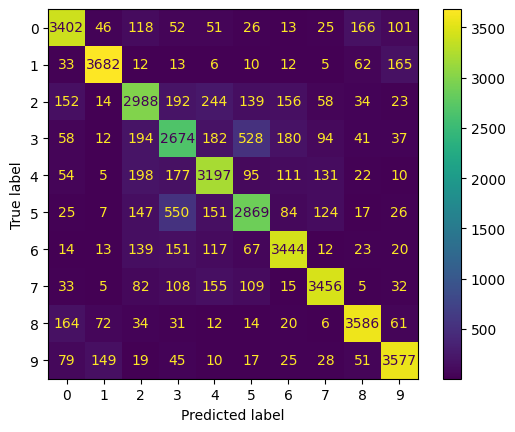

validation...


(Epoch 112 | 79/79) | Data: 0.055s | Batch: 0.075s | Loss: 0.6971| GPU usage: 0.418 GB: 100%|██████████| 79/79 [00:06<00:00, 13.14it/s]


validation loss: 0.69576
validation accuracy: 0.76326
validation precision: 0.76360
validation recall: 0.76360
validation F1-Score: 0.76328
[Epoch: 113 training...]


(Epoch 113 | 313/313) | Data: 0.052s | Batch: 0.089s | Loss: 0.5071 | GPU usage: 0.418 GB: 100%|██████████| 313/313 [00:27<00:00, 11.25it/s]


learning rate is 1e-06
training loss: 0.50717
training accuracy: 0.82130
training precision: 0.82075
training recall: 0.82130
training F1-Score: 0.82097


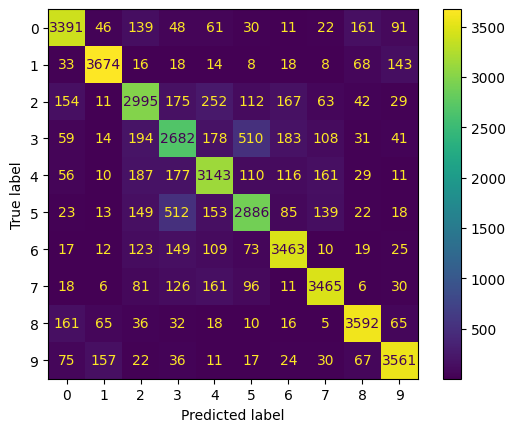

validation...


(Epoch 113 | 79/79) | Data: 0.057s | Batch: 0.080s | Loss: 0.6881| GPU usage: 0.400 GB: 100%|██████████| 79/79 [00:06<00:00, 12.30it/s]


validation loss: 0.68777
validation accuracy: 0.76711
validation precision: 0.76770
validation recall: 0.76770
validation F1-Score: 0.76723
saving with validation loss of 0.6877732276916504
[Epoch: 114 training...]


(Epoch 114 | 313/313) | Data: 0.056s | Batch: 0.091s | Loss: 0.5092 | GPU usage: 0.396 GB: 100%|██████████| 313/313 [00:28<00:00, 10.99it/s]


learning rate is 1e-06
training loss: 0.50923
training accuracy: 0.82363
training precision: 0.82329
training recall: 0.82363
training F1-Score: 0.82342


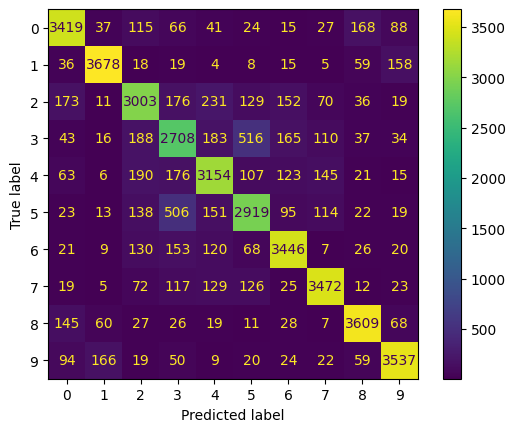

validation...


(Epoch 114 | 79/79) | Data: 0.058s | Batch: 0.080s | Loss: 0.6962| GPU usage: 0.396 GB: 100%|██████████| 79/79 [00:06<00:00, 12.36it/s]


validation loss: 0.69532
validation accuracy: 0.76488
validation precision: 0.76550
validation recall: 0.76550
validation F1-Score: 0.76506
[Epoch: 115 training...]


(Epoch 115 | 313/313) | Data: 0.054s | Batch: 0.090s | Loss: 0.5075 | GPU usage: 0.396 GB: 100%|██████████| 313/313 [00:28<00:00, 11.04it/s]


learning rate is 1e-06
training loss: 0.50758
training accuracy: 0.82240
training precision: 0.82182
training recall: 0.82240
training F1-Score: 0.82207


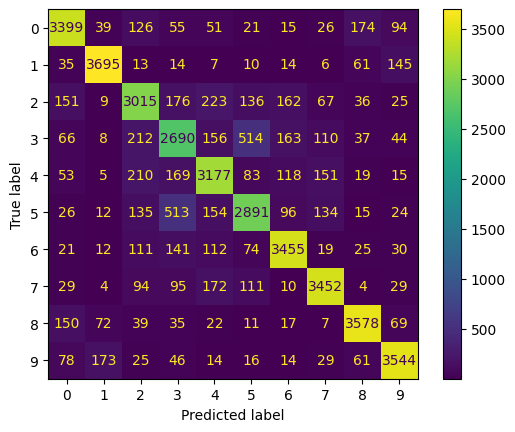

validation...


(Epoch 115 | 79/79) | Data: 0.055s | Batch: 0.078s | Loss: 0.6948| GPU usage: 0.396 GB: 100%|██████████| 79/79 [00:06<00:00, 12.61it/s]


validation loss: 0.69374
validation accuracy: 0.76429
validation precision: 0.76540
validation recall: 0.76540
validation F1-Score: 0.76471
[Epoch: 116 training...]


(Epoch 116 | 313/313) | Data: 0.053s | Batch: 0.086s | Loss: 0.5093 | GPU usage: 0.397 GB: 100%|██████████| 313/313 [00:26<00:00, 11.66it/s]


learning rate is 1e-06
training loss: 0.50917
training accuracy: 0.82208
training precision: 0.82169
training recall: 0.82207
training F1-Score: 0.82182


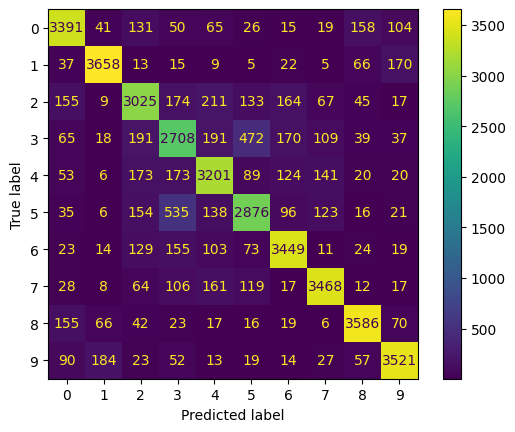

validation...


(Epoch 116 | 79/79) | Data: 0.059s | Batch: 0.083s | Loss: 0.6938| GPU usage: 0.397 GB: 100%|██████████| 79/79 [00:06<00:00, 11.91it/s]


validation loss: 0.69113
validation accuracy: 0.76809
validation precision: 0.76760
validation recall: 0.76760
validation F1-Score: 0.76766
[Epoch: 117 training...]


(Epoch 117 | 313/313) | Data: 0.053s | Batch: 0.091s | Loss: 0.5043 | GPU usage: 0.397 GB: 100%|██████████| 313/313 [00:28<00:00, 10.99it/s]


learning rate is 1e-06
training loss: 0.50423
training accuracy: 0.82535
training precision: 0.82494
training recall: 0.82535
training F1-Score: 0.82510


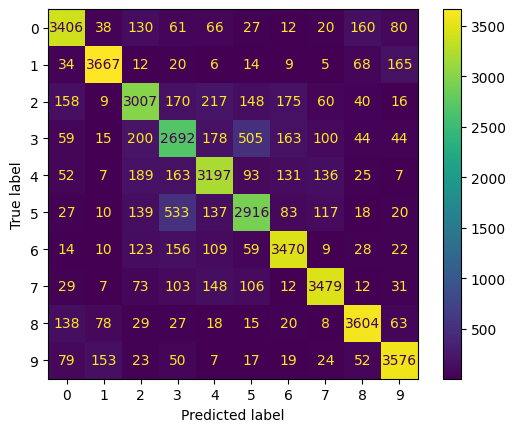

validation...


(Epoch 117 | 79/79) | Data: 0.056s | Batch: 0.076s | Loss: 0.6897| GPU usage: 0.397 GB: 100%|██████████| 79/79 [00:06<00:00, 12.91it/s]


validation loss: 0.68834
validation accuracy: 0.76578
validation precision: 0.76610
validation recall: 0.76610
validation F1-Score: 0.76580
saving with validation loss of 0.6883360147476196
[Epoch: 118 training...]


(Epoch 118 | 313/313) | Data: 0.055s | Batch: 0.094s | Loss: 0.5041 | GPU usage: 0.416 GB: 100%|██████████| 313/313 [00:29<00:00, 10.60it/s]


learning rate is 1e-06
training loss: 0.50402
training accuracy: 0.82550
training precision: 0.82493
training recall: 0.82550
training F1-Score: 0.82517


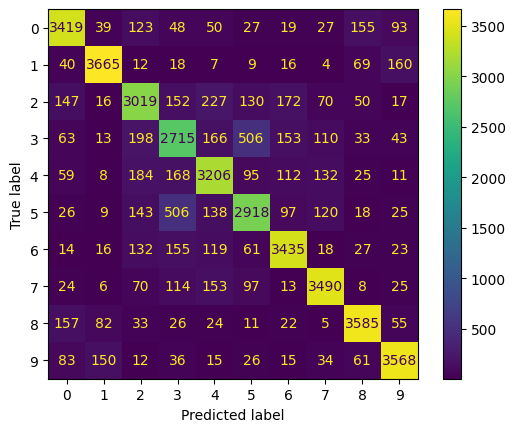

validation...


(Epoch 118 | 79/79) | Data: 0.065s | Batch: 0.087s | Loss: 0.6882| GPU usage: 0.393 GB: 100%|██████████| 79/79 [00:06<00:00, 11.35it/s]


validation loss: 0.68751
validation accuracy: 0.76715
validation precision: 0.76780
validation recall: 0.76780
validation F1-Score: 0.76730
saving with validation loss of 0.6875078678131104
[Epoch: 119 training...]


(Epoch 119 | 313/313) | Data: 0.057s | Batch: 0.095s | Loss: 0.5019 | GPU usage: 0.413 GB: 100%|██████████| 313/313 [00:29<00:00, 10.52it/s]


learning rate is 1e-06
training loss: 0.50184
training accuracy: 0.82537
training precision: 0.82481
training recall: 0.82537
training F1-Score: 0.82505


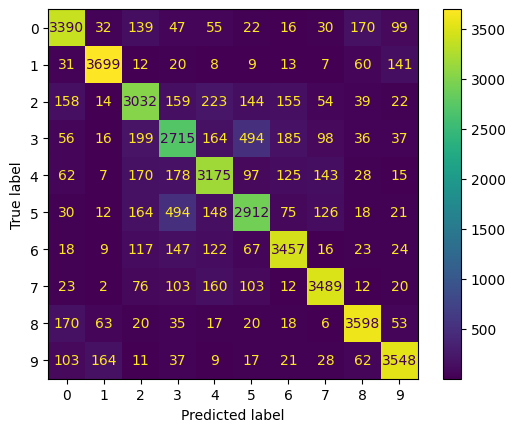

validation...


(Epoch 119 | 79/79) | Data: 0.057s | Batch: 0.078s | Loss: 0.6981| GPU usage: 0.413 GB: 100%|██████████| 79/79 [00:06<00:00, 12.57it/s]


validation loss: 0.69829
validation accuracy: 0.76621
validation precision: 0.76660
validation recall: 0.76660
validation F1-Score: 0.76627
[Epoch: 120 training...]


(Epoch 120 | 313/313) | Data: 0.056s | Batch: 0.097s | Loss: 0.5005 | GPU usage: 0.396 GB: 100%|██████████| 313/313 [00:30<00:00, 10.32it/s]


learning rate is 1e-06
training loss: 0.50047
training accuracy: 0.82637
training precision: 0.82589
training recall: 0.82637
training F1-Score: 0.82607


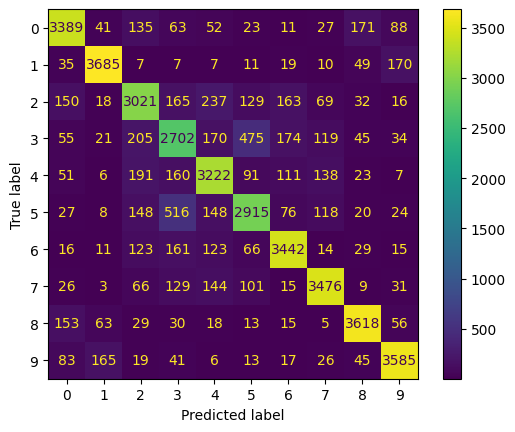

validation...


(Epoch 120 | 79/79) | Data: 0.057s | Batch: 0.077s | Loss: 0.6905| GPU usage: 0.396 GB: 100%|██████████| 79/79 [00:06<00:00, 12.84it/s]


validation loss: 0.68861
validation accuracy: 0.76711
validation precision: 0.76730
validation recall: 0.76730
validation F1-Score: 0.76710
saving with validation loss of 0.6886096000671387
[Epoch: 121 training...]


(Epoch 121 | 313/313) | Data: 0.055s | Batch: 0.094s | Loss: 0.4986 | GPU usage: 0.418 GB: 100%|██████████| 313/313 [00:29<00:00, 10.65it/s]


learning rate is 1e-06
training loss: 0.49874
training accuracy: 0.82793
training precision: 0.82759
training recall: 0.82792
training F1-Score: 0.82770


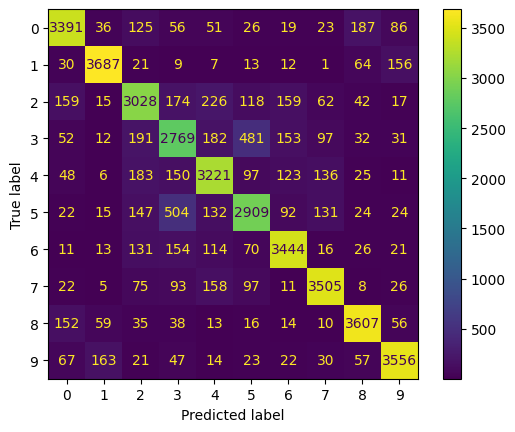

validation...


(Epoch 121 | 79/79) | Data: 0.063s | Batch: 0.085s | Loss: 0.6942| GPU usage: 0.394 GB: 100%|██████████| 79/79 [00:06<00:00, 11.65it/s]


validation loss: 0.69378
validation accuracy: 0.76300
validation precision: 0.76350
validation recall: 0.76350
validation F1-Score: 0.76310
[Epoch: 122 training...]


(Epoch 122 | 313/313) | Data: 0.055s | Batch: 0.092s | Loss: 0.4992 | GPU usage: 0.393 GB: 100%|██████████| 313/313 [00:28<00:00, 10.82it/s]


learning rate is 1e-06
training loss: 0.49910
training accuracy: 0.82632
training precision: 0.82590
training recall: 0.82633
training F1-Score: 0.82608


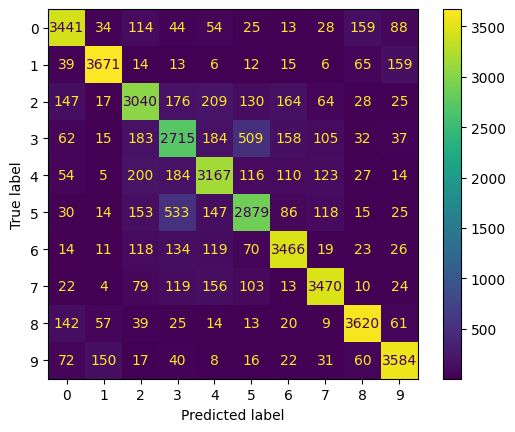

validation...


(Epoch 122 | 79/79) | Data: 0.055s | Batch: 0.076s | Loss: 0.6910| GPU usage: 0.393 GB: 100%|██████████| 79/79 [00:06<00:00, 13.06it/s]


validation loss: 0.68910
validation accuracy: 0.76598
validation precision: 0.76660
validation recall: 0.76660
validation F1-Score: 0.76611
saving with validation loss of 0.689102292060852
[Epoch: 123 training...]


(Epoch 123 | 313/313) | Data: 0.054s | Batch: 0.094s | Loss: 0.4977 | GPU usage: 0.393 GB: 100%|██████████| 313/313 [00:29<00:00, 10.57it/s]


learning rate is 1e-06
training loss: 0.49740
training accuracy: 0.82695
training precision: 0.82653
training recall: 0.82695
training F1-Score: 0.82670


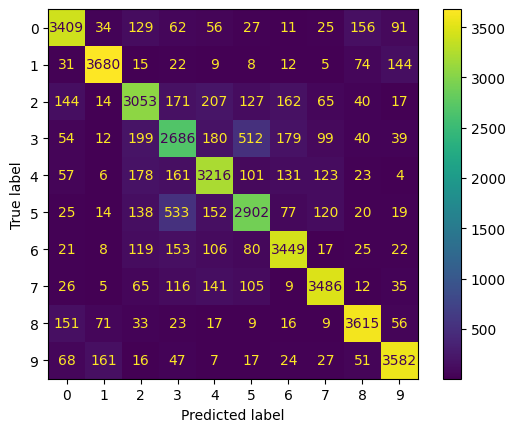

validation...


(Epoch 123 | 79/79) | Data: 0.057s | Batch: 0.077s | Loss: 0.6927| GPU usage: 0.393 GB: 100%|██████████| 79/79 [00:06<00:00, 12.82it/s]


validation loss: 0.69353
validation accuracy: 0.76528
validation precision: 0.76590
validation recall: 0.76590
validation F1-Score: 0.76538
[Epoch: 124 training...]


(Epoch 124 | 313/313) | Data: 0.053s | Batch: 0.090s | Loss: 0.4940 | GPU usage: 0.393 GB: 100%|██████████| 313/313 [00:28<00:00, 11.12it/s]


learning rate is 1e-06
training loss: 0.49404
training accuracy: 0.82920
training precision: 0.82876
training recall: 0.82920
training F1-Score: 0.82894


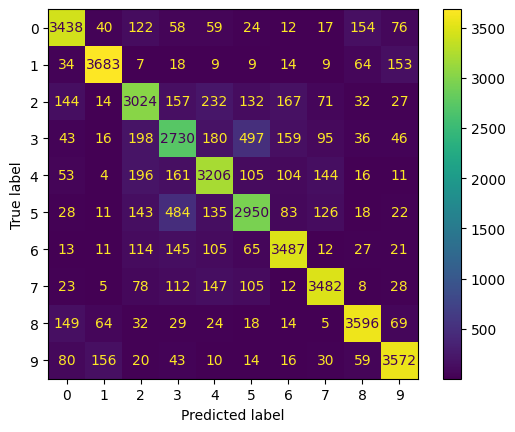

validation...


(Epoch 124 | 79/79) | Data: 0.058s | Batch: 0.081s | Loss: 0.6919| GPU usage: 0.393 GB: 100%|██████████| 79/79 [00:06<00:00, 12.21it/s]


validation loss: 0.69107
validation accuracy: 0.76507
validation precision: 0.76590
validation recall: 0.76590
validation F1-Score: 0.76531
saving with validation loss of 0.6910673975944519
[Epoch: 125 training...]


(Epoch 125 | 313/313) | Data: 0.056s | Batch: 0.099s | Loss: 0.4981 | GPU usage: 0.393 GB: 100%|██████████| 313/313 [00:31<00:00, 10.03it/s]


learning rate is 1e-06
training loss: 0.49819
training accuracy: 0.82583
training precision: 0.82556
training recall: 0.82583
training F1-Score: 0.82565


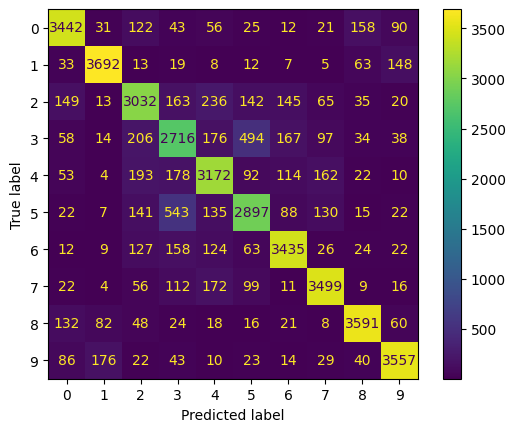

validation...


(Epoch 125 | 79/79) | Data: 0.057s | Batch: 0.076s | Loss: 0.6961| GPU usage: 0.393 GB: 100%|██████████| 79/79 [00:06<00:00, 12.96it/s]


validation loss: 0.69451
validation accuracy: 0.76470
validation precision: 0.76500
validation recall: 0.76500
validation F1-Score: 0.76473
saving with validation loss of 0.6945059895515442
[Epoch: 126 training...]


(Epoch 126 | 313/313) | Data: 0.053s | Batch: 0.092s | Loss: 0.4925 | GPU usage: 0.393 GB: 100%|██████████| 313/313 [00:28<00:00, 10.85it/s]


learning rate is 1e-06
training loss: 0.49243
training accuracy: 0.82885
training precision: 0.82839
training recall: 0.82885
training F1-Score: 0.82858


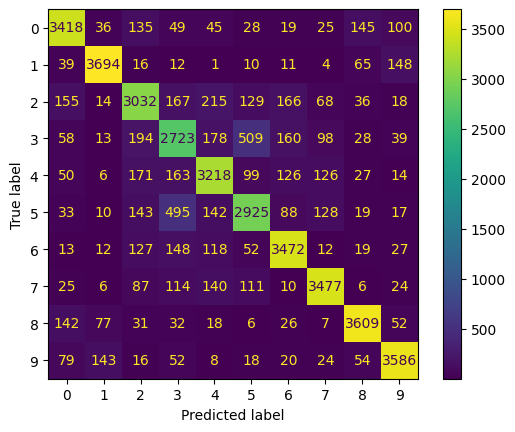

validation...


(Epoch 126 | 79/79) | Data: 0.053s | Batch: 0.072s | Loss: 0.6974| GPU usage: 0.393 GB: 100%|██████████| 79/79 [00:05<00:00, 13.73it/s]


validation loss: 0.69817
validation accuracy: 0.76448
validation precision: 0.76440
validation recall: 0.76440
validation F1-Score: 0.76429
saving with validation loss of 0.6981690526008606
[Epoch: 127 training...]


(Epoch 127 | 313/313) | Data: 0.052s | Batch: 0.086s | Loss: 0.4894 | GPU usage: 0.393 GB: 100%|██████████| 313/313 [00:27<00:00, 11.56it/s]


learning rate is 1e-06
training loss: 0.48938
training accuracy: 0.82968
training precision: 0.82957
training recall: 0.82967
training F1-Score: 0.82955


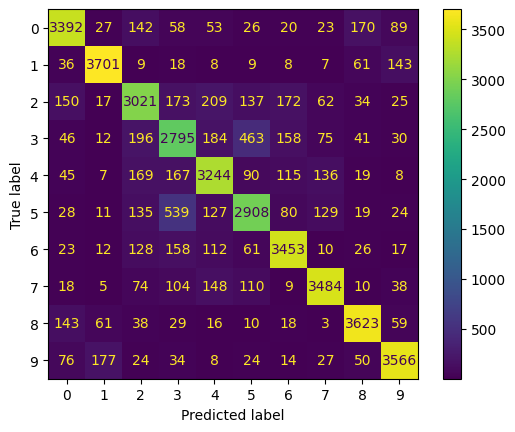

validation...


(Epoch 127 | 79/79) | Data: 0.055s | Batch: 0.075s | Loss: 0.7000| GPU usage: 0.393 GB: 100%|██████████| 79/79 [00:06<00:00, 13.15it/s]


validation loss: 0.69843
validation accuracy: 0.76851
validation precision: 0.76880
validation recall: 0.76880
validation F1-Score: 0.76847
saving with validation loss of 0.6984269022941589
[Epoch: 128 training...]


(Epoch 128 | 313/313) | Data: 0.053s | Batch: 0.092s | Loss: 0.4933 | GPU usage: 0.393 GB: 100%|██████████| 313/313 [00:28<00:00, 10.81it/s]


learning rate is 1e-06
training loss: 0.49329
training accuracy: 0.82885
training precision: 0.82859
training recall: 0.82885
training F1-Score: 0.82870


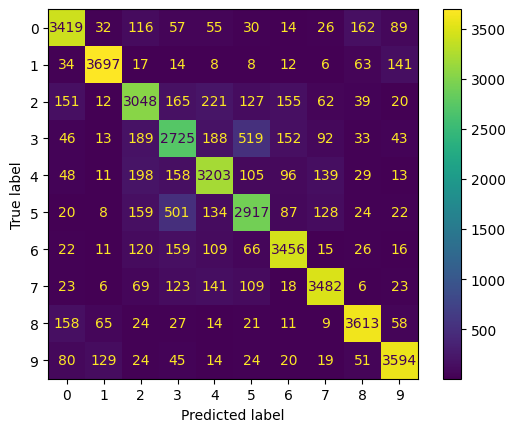

validation...


(Epoch 128 | 79/79) | Data: 0.055s | Batch: 0.075s | Loss: 0.6934| GPU usage: 0.393 GB: 100%|██████████| 79/79 [00:06<00:00, 13.17it/s]


validation loss: 0.69158
validation accuracy: 0.76805
validation precision: 0.76790
validation recall: 0.76790
validation F1-Score: 0.76779
saving with validation loss of 0.6915799379348755
[Epoch: 129 training...]


(Epoch 129 | 313/313) | Data: 0.054s | Batch: 0.094s | Loss: 0.4870 | GPU usage: 0.393 GB: 100%|██████████| 313/313 [00:29<00:00, 10.65it/s]


learning rate is 1e-06
training loss: 0.48673
training accuracy: 0.82978
training precision: 0.82943
training recall: 0.82978
training F1-Score: 0.82957


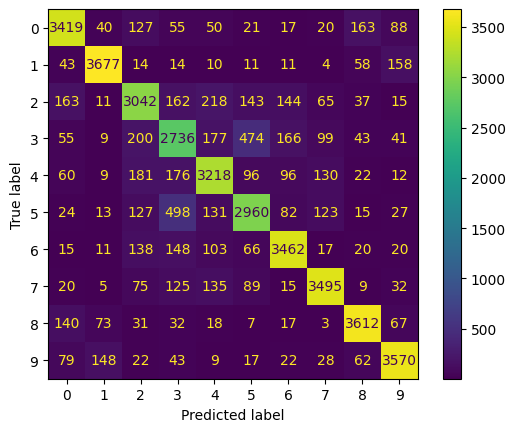

validation...


(Epoch 129 | 79/79) | Data: 0.055s | Batch: 0.075s | Loss: 0.7002| GPU usage: 0.393 GB: 100%|██████████| 79/79 [00:06<00:00, 13.12it/s]


validation loss: 0.69838
validation accuracy: 0.76307
validation precision: 0.76390
validation recall: 0.76390
validation F1-Score: 0.76332
[Epoch: 130 training...]


(Epoch 130 | 313/313) | Data: 0.054s | Batch: 0.095s | Loss: 0.4864 | GPU usage: 0.393 GB: 100%|██████████| 313/313 [00:29<00:00, 10.52it/s]


learning rate is 1e-06
training loss: 0.48658
training accuracy: 0.83037
training precision: 0.82981
training recall: 0.83038
training F1-Score: 0.83003


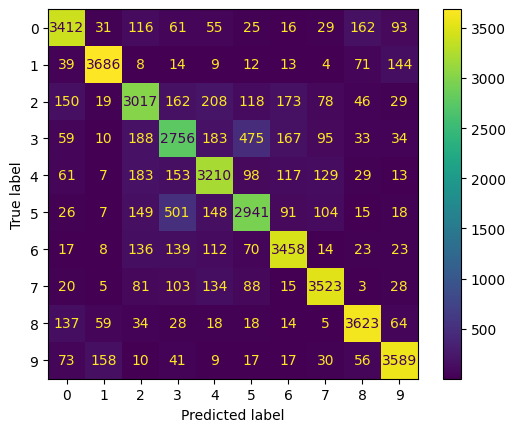

validation...


(Epoch 130 | 79/79) | Data: 0.070s | Batch: 0.093s | Loss: 0.6964| GPU usage: 0.393 GB: 100%|██████████| 79/79 [00:07<00:00, 10.67it/s]


validation loss: 0.69623
validation accuracy: 0.76592
validation precision: 0.76630
validation recall: 0.76630
validation F1-Score: 0.76597
saving with validation loss of 0.6962263584136963
[Epoch: 131 training...]


(Epoch 131 | 313/313) | Data: 0.064s | Batch: 0.107s | Loss: 0.4867 | GPU usage: 0.393 GB: 100%|██████████| 313/313 [00:33<00:00,  9.33it/s]


learning rate is 1e-06
training loss: 0.48699
training accuracy: 0.83078
training precision: 0.83028
training recall: 0.83077
training F1-Score: 0.83046


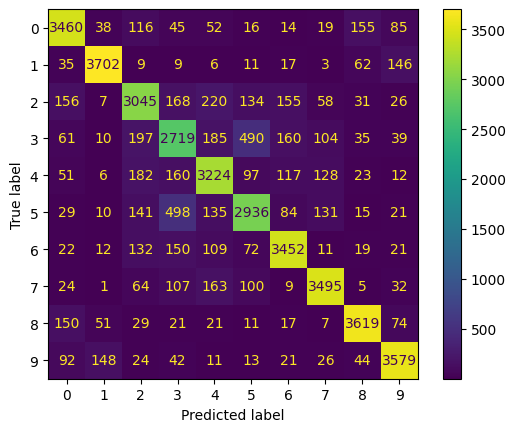

validation...


(Epoch 131 | 79/79) | Data: 0.065s | Batch: 0.089s | Loss: 0.6951| GPU usage: 0.393 GB: 100%|██████████| 79/79 [00:07<00:00, 11.09it/s]


validation loss: 0.69552
validation accuracy: 0.76262
validation precision: 0.76330
validation recall: 0.76330
validation F1-Score: 0.76284
saving with validation loss of 0.6955171227455139
[Epoch: 132 training...]


(Epoch 132 | 313/313) | Data: 0.064s | Batch: 0.108s | Loss: 0.4878 | GPU usage: 0.393 GB: 100%|██████████| 313/313 [00:33<00:00,  9.27it/s]


learning rate is 1e-06
training loss: 0.48798
training accuracy: 0.83120
training precision: 0.83066
training recall: 0.83120
training F1-Score: 0.83088


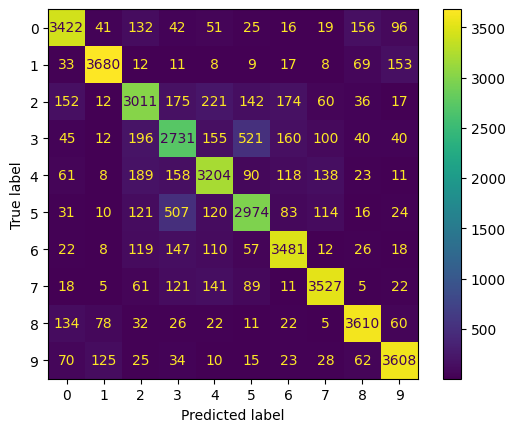

validation...


(Epoch 132 | 79/79) | Data: 0.068s | Batch: 0.093s | Loss: 0.6903| GPU usage: 0.393 GB: 100%|██████████| 79/79 [00:07<00:00, 10.67it/s]


validation loss: 0.69103
validation accuracy: 0.77022
validation precision: 0.77070
validation recall: 0.77070
validation F1-Score: 0.77031
saving with validation loss of 0.6910269260406494
[Epoch: 133 training...]


(Epoch 133 | 313/313) | Data: 0.065s | Batch: 0.112s | Loss: 0.4902 | GPU usage: 0.393 GB: 100%|██████████| 313/313 [00:35<00:00,  8.92it/s]


learning rate is 1e-06
training loss: 0.49045
training accuracy: 0.82868
training precision: 0.82867
training recall: 0.82867
training F1-Score: 0.82861


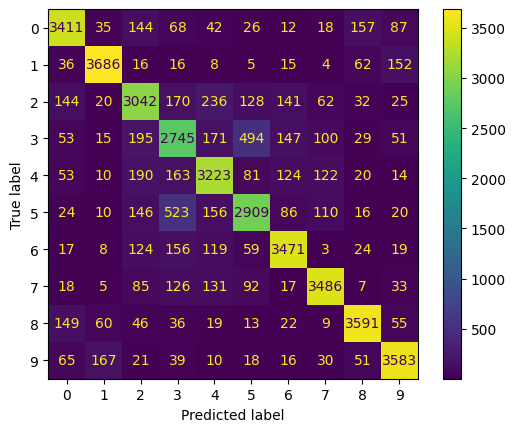

validation...


(Epoch 133 | 79/79) | Data: 0.067s | Batch: 0.092s | Loss: 0.6998| GPU usage: 0.393 GB: 100%|██████████| 79/79 [00:07<00:00, 10.74it/s]


validation loss: 0.69885
validation accuracy: 0.76359
validation precision: 0.76350
validation recall: 0.76350
validation F1-Score: 0.76340
[Epoch: 134 training...]


(Epoch 134 | 313/313) | Data: 0.063s | Batch: 0.103s | Loss: 0.4807 | GPU usage: 0.393 GB: 100%|██████████| 313/313 [00:32<00:00,  9.69it/s]


learning rate is 1e-06
training loss: 0.48070
training accuracy: 0.83195
training precision: 0.83137
training recall: 0.83195
training F1-Score: 0.83162


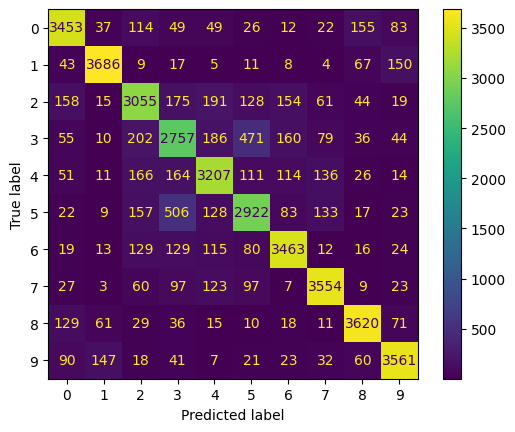

validation...


(Epoch 134 | 79/79) | Data: 0.067s | Batch: 0.093s | Loss: 0.6989| GPU usage: 0.393 GB: 100%|██████████| 79/79 [00:07<00:00, 10.67it/s]


validation loss: 0.69759
validation accuracy: 0.76563
validation precision: 0.76630
validation recall: 0.76630
validation F1-Score: 0.76582
saving with validation loss of 0.6975926160812378
[Epoch: 135 training...]


(Epoch 135 | 313/313) | Data: 0.063s | Batch: 0.107s | Loss: 0.4833 | GPU usage: 0.393 GB: 100%|██████████| 313/313 [00:33<00:00,  9.33it/s]


learning rate is 1e-06
training loss: 0.48346
training accuracy: 0.83125
training precision: 0.83092
training recall: 0.83125
training F1-Score: 0.83106


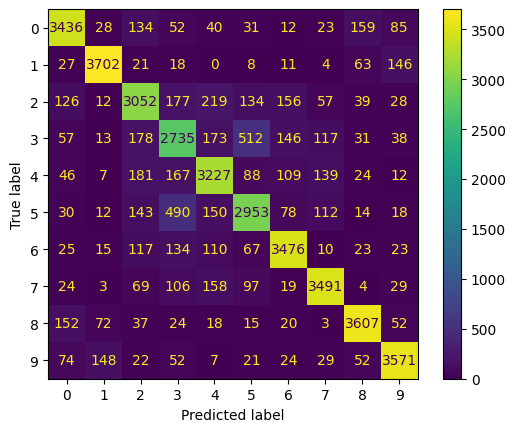

validation...


(Epoch 135 | 79/79) | Data: 0.069s | Batch: 0.094s | Loss: 0.7018| GPU usage: 0.393 GB: 100%|██████████| 79/79 [00:07<00:00, 10.54it/s]


validation loss: 0.70261
validation accuracy: 0.76173
validation precision: 0.76230
validation recall: 0.76230
validation F1-Score: 0.76179
[Epoch: 136 training...]


(Epoch 136 | 313/313) | Data: 0.064s | Batch: 0.105s | Loss: 0.4811 | GPU usage: 0.393 GB: 100%|██████████| 313/313 [00:32<00:00,  9.51it/s]


learning rate is 1e-06
training loss: 0.48138
training accuracy: 0.83413
training precision: 0.83393
training recall: 0.83413
training F1-Score: 0.83395


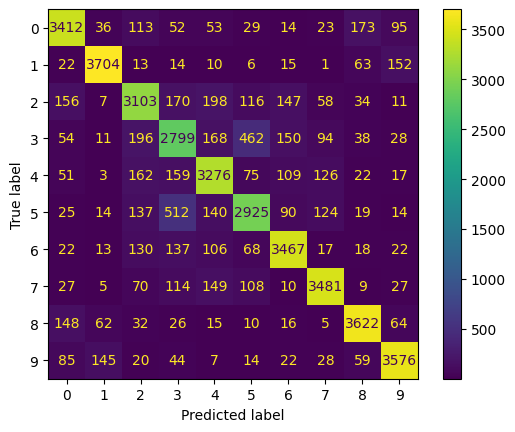

validation...


(Epoch 136 | 79/79) | Data: 0.067s | Batch: 0.092s | Loss: 0.6983| GPU usage: 0.393 GB: 100%|██████████| 79/79 [00:07<00:00, 10.79it/s]


validation loss: 0.69685
validation accuracy: 0.76569
validation precision: 0.76580
validation recall: 0.76580
validation F1-Score: 0.76562
saving with validation loss of 0.6968494057655334
[Epoch: 137 training...]


(Epoch 137 | 313/313) | Data: 0.064s | Batch: 0.106s | Loss: 0.4758 | GPU usage: 0.393 GB: 100%|██████████| 313/313 [00:33<00:00,  9.40it/s]


learning rate is 1e-06
training loss: 0.47582
training accuracy: 0.83478
training precision: 0.83443
training recall: 0.83477
training F1-Score: 0.83456


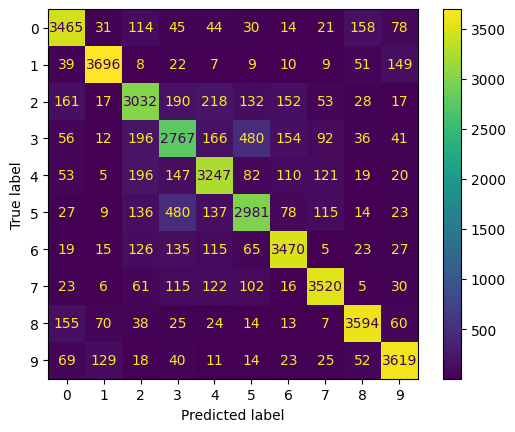

validation...


(Epoch 137 | 79/79) | Data: 0.067s | Batch: 0.089s | Loss: 0.6957| GPU usage: 0.393 GB: 100%|██████████| 79/79 [00:07<00:00, 11.14it/s]


validation loss: 0.69530
validation accuracy: 0.76538
validation precision: 0.76560
validation recall: 0.76560
validation F1-Score: 0.76530
saving with validation loss of 0.6952999830245972
[Epoch: 138 training...]


(Epoch 138 | 313/313) | Data: 0.063s | Batch: 0.108s | Loss: 0.4811 | GPU usage: 0.393 GB: 100%|██████████| 313/313 [00:33<00:00,  9.28it/s]


learning rate is 1e-06
training loss: 0.48132
training accuracy: 0.83305
training precision: 0.83279
training recall: 0.83305
training F1-Score: 0.83289


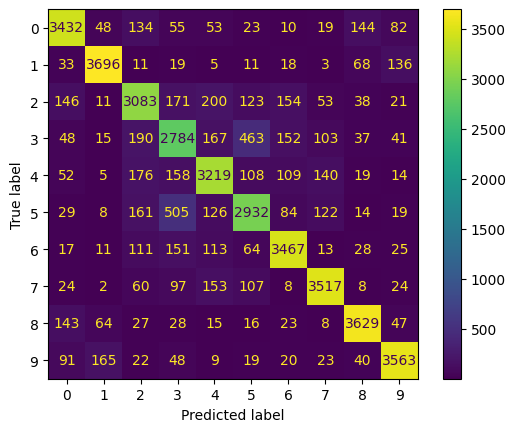

validation...


(Epoch 138 | 79/79) | Data: 0.067s | Batch: 0.092s | Loss: 0.7001| GPU usage: 0.393 GB: 100%|██████████| 79/79 [00:07<00:00, 10.72it/s]


validation loss: 0.70001
validation accuracy: 0.76566
validation precision: 0.76640
validation recall: 0.76640
validation F1-Score: 0.76588
saving with validation loss of 0.700005054473877
[Epoch: 139 training...]


(Epoch 139 | 313/313) | Data: 0.064s | Batch: 0.110s | Loss: 0.4790 | GPU usage: 0.393 GB: 100%|██████████| 313/313 [00:34<00:00,  9.11it/s]


learning rate is 1e-06
training loss: 0.47920
training accuracy: 0.83375
training precision: 0.83340
training recall: 0.83375
training F1-Score: 0.83354


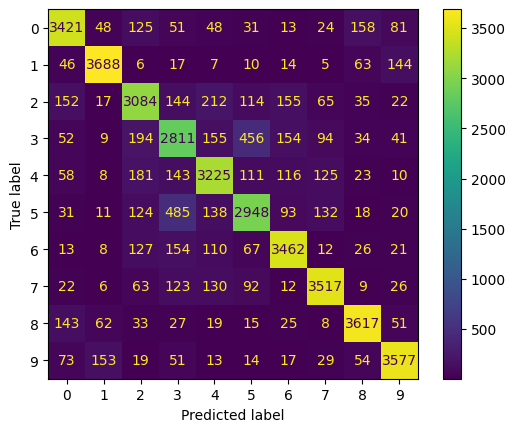

validation...


(Epoch 139 | 79/79) | Data: 0.066s | Batch: 0.089s | Loss: 0.6976| GPU usage: 0.393 GB: 100%|██████████| 79/79 [00:07<00:00, 11.09it/s]


validation loss: 0.69788
validation accuracy: 0.76472
validation precision: 0.76560
validation recall: 0.76560
validation F1-Score: 0.76497
saving with validation loss of 0.6978769898414612
[Epoch: 140 training...]


(Epoch 140 | 313/313) | Data: 0.059s | Batch: 0.098s | Loss: 0.4774 | GPU usage: 0.987 GB: 100%|██████████| 313/313 [00:30<00:00, 10.19it/s]


learning rate is 1e-06
training loss: 0.47717
training accuracy: 0.83332
training precision: 0.83297
training recall: 0.83333
training F1-Score: 0.83311


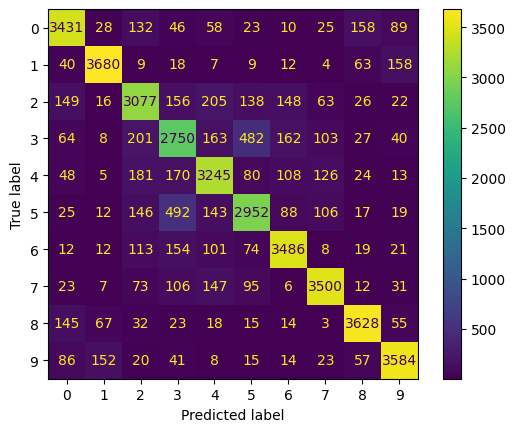

validation...


(Epoch 140 | 79/79) | Data: 0.057s | Batch: 0.080s | Loss: 0.6964| GPU usage: 0.987 GB: 100%|██████████| 79/79 [00:06<00:00, 12.27it/s]


validation loss: 0.69728
validation accuracy: 0.76756
validation precision: 0.76810
validation recall: 0.76810
validation F1-Score: 0.76768
saving with validation loss of 0.6972774863243103
[Epoch: 141 training...]


(Epoch 141 | 313/313) | Data: 0.055s | Batch: 0.097s | Loss: 0.4812 | GPU usage: 0.987 GB: 100%|██████████| 313/313 [00:30<00:00, 10.30it/s]


learning rate is 1e-06
training loss: 0.48119
training accuracy: 0.83457
training precision: 0.83429
training recall: 0.83458
training F1-Score: 0.83438


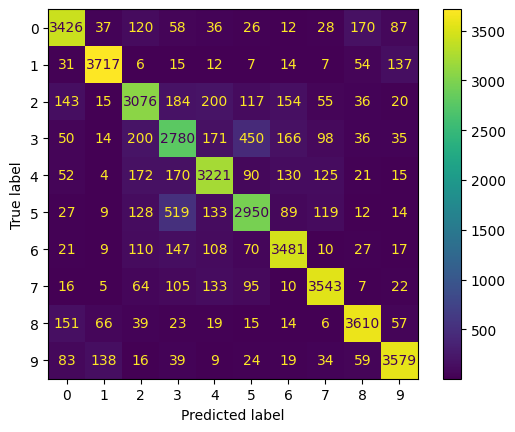

validation...


(Epoch 141 | 79/79) | Data: 0.057s | Batch: 0.074s | Loss: 0.7063| GPU usage: 0.987 GB: 100%|██████████| 79/79 [00:05<00:00, 13.35it/s]


validation loss: 0.70425
validation accuracy: 0.76077
validation precision: 0.76120
validation recall: 0.76120
validation F1-Score: 0.76076
[Epoch: 142 training...]


(Epoch 142 | 313/313) | Data: 0.054s | Batch: 0.080s | Loss: 0.4753 | GPU usage: 0.943 GB: 100%|██████████| 313/313 [00:25<00:00, 12.42it/s]


learning rate is 1e-06
training loss: 0.47596
training accuracy: 0.83485
training precision: 0.83452
training recall: 0.83485
training F1-Score: 0.83465


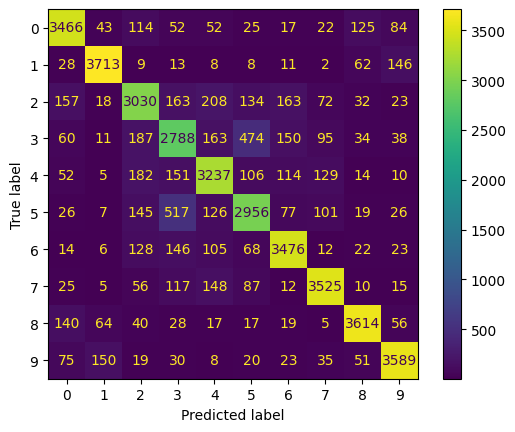

validation...


(Epoch 142 | 79/79) | Data: 0.056s | Batch: 0.079s | Loss: 0.7015| GPU usage: 0.943 GB: 100%|██████████| 79/79 [00:06<00:00, 12.53it/s]


validation loss: 0.70043
validation accuracy: 0.76473
validation precision: 0.76590
validation recall: 0.76590
validation F1-Score: 0.76512
[Epoch: 143 training...]


(Epoch 143 | 313/313) | Data: 0.055s | Batch: 0.094s | Loss: 0.4726 | GPU usage: 0.943 GB: 100%|██████████| 313/313 [00:29<00:00, 10.63it/s]


learning rate is 1e-06
training loss: 0.47265
training accuracy: 0.83567
training precision: 0.83545
training recall: 0.83568
training F1-Score: 0.83550


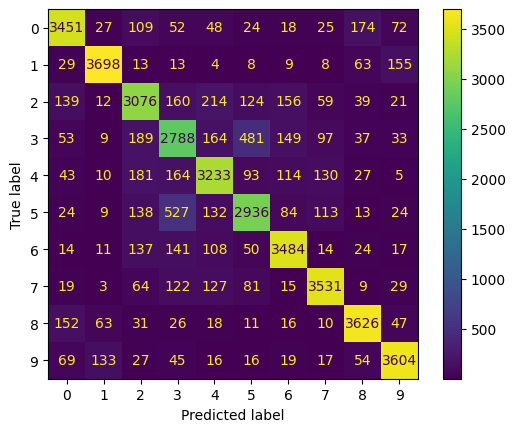

validation...


(Epoch 143 | 79/79) | Data: 0.056s | Batch: 0.079s | Loss: 0.6958| GPU usage: 0.943 GB: 100%|██████████| 79/79 [00:06<00:00, 12.45it/s]


validation loss: 0.69290
validation accuracy: 0.76778
validation precision: 0.76840
validation recall: 0.76840
validation F1-Score: 0.76787
saving with validation loss of 0.692895770072937
[Epoch: 144 training...]


(Epoch 144 | 313/313) | Data: 0.055s | Batch: 0.095s | Loss: 0.4762 | GPU usage: 0.943 GB: 100%|██████████| 313/313 [00:29<00:00, 10.45it/s]


learning rate is 1e-06
training loss: 0.47629
training accuracy: 0.83567
training precision: 0.83530
training recall: 0.83567
training F1-Score: 0.83545


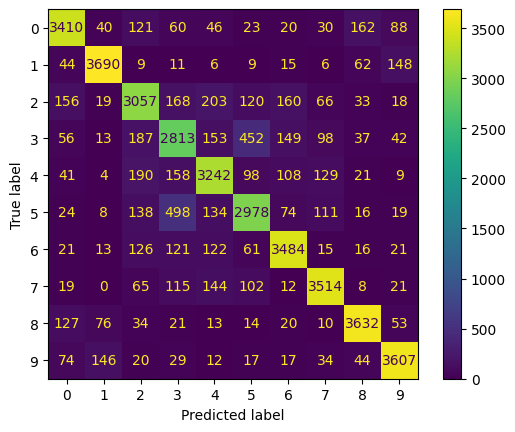

validation...


(Epoch 144 | 79/79) | Data: 0.053s | Batch: 0.069s | Loss: 0.6937| GPU usage: 0.943 GB: 100%|██████████| 79/79 [00:05<00:00, 14.25it/s]


validation loss: 0.69275
validation accuracy: 0.76521
validation precision: 0.76560
validation recall: 0.76560
validation F1-Score: 0.76520
saving with validation loss of 0.6927450299263
[Epoch: 145 training...]


(Epoch 145 | 313/313) | Data: 0.052s | Batch: 0.086s | Loss: 0.4735 | GPU usage: 0.943 GB: 100%|██████████| 313/313 [00:27<00:00, 11.57it/s]


learning rate is 1e-06
training loss: 0.47375
training accuracy: 0.83788
training precision: 0.83760
training recall: 0.83788
training F1-Score: 0.83768


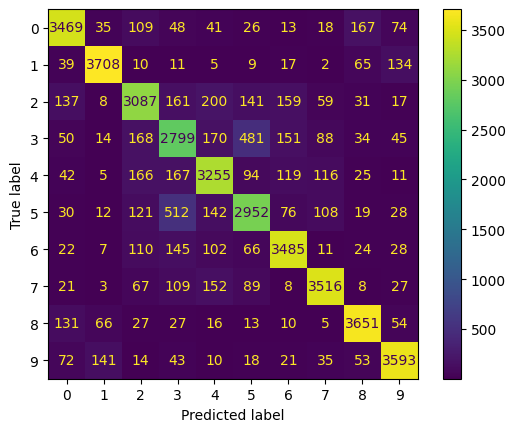

validation...


(Epoch 145 | 79/79) | Data: 0.056s | Batch: 0.080s | Loss: 0.7001| GPU usage: 0.943 GB: 100%|██████████| 79/79 [00:06<00:00, 12.28it/s]


validation loss: 0.70048
validation accuracy: 0.76233
validation precision: 0.76310
validation recall: 0.76310
validation F1-Score: 0.76252
[Epoch: 146 training...]


(Epoch 146 | 313/313) | Data: 0.055s | Batch: 0.094s | Loss: 0.4766 | GPU usage: 0.943 GB: 100%|██████████| 313/313 [00:29<00:00, 10.62it/s]


learning rate is 1e-06
training loss: 0.47641
training accuracy: 0.83332
training precision: 0.83292
training recall: 0.83332
training F1-Score: 0.83306


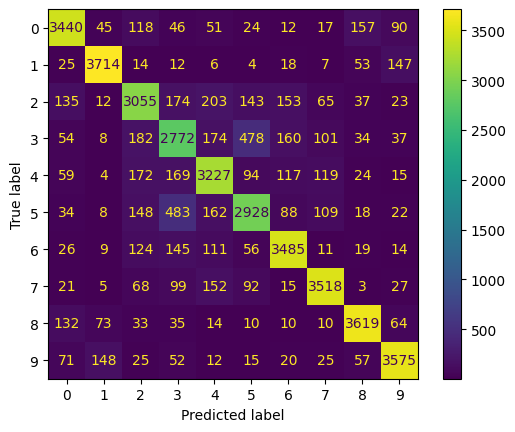

validation...


(Epoch 146 | 79/79) | Data: 0.060s | Batch: 0.080s | Loss: 0.6979| GPU usage: 0.943 GB: 100%|██████████| 79/79 [00:06<00:00, 12.42it/s]


validation loss: 0.69556
validation accuracy: 0.76674
validation precision: 0.76760
validation recall: 0.76760
validation F1-Score: 0.76707
[Epoch: 147 training...]


(Epoch 147 | 313/313) | Data: 0.054s | Batch: 0.080s | Loss: 0.4709 | GPU usage: 0.943 GB: 100%|██████████| 313/313 [00:24<00:00, 12.55it/s]


learning rate is 1e-06
training loss: 0.47081
training accuracy: 0.83778
training precision: 0.83733
training recall: 0.83778
training F1-Score: 0.83750


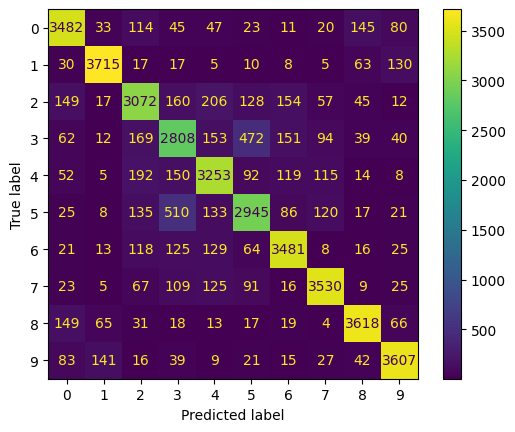

validation...


(Epoch 147 | 79/79) | Data: 0.057s | Batch: 0.069s | Loss: 0.6949| GPU usage: 0.943 GB: 100%|██████████| 79/79 [00:05<00:00, 14.36it/s]


validation loss: 0.69494
validation accuracy: 0.76691
validation precision: 0.76750
validation recall: 0.76750
validation F1-Score: 0.76711
saving with validation loss of 0.6949357986450195
[Epoch: 148 training...]


(Epoch 148 | 313/313) | Data: 0.055s | Batch: 0.077s | Loss: 0.4697 | GPU usage: 0.943 GB: 100%|██████████| 313/313 [00:24<00:00, 12.95it/s]


learning rate is 1e-06
training loss: 0.46986
training accuracy: 0.83755
training precision: 0.83735
training recall: 0.83755
training F1-Score: 0.83742


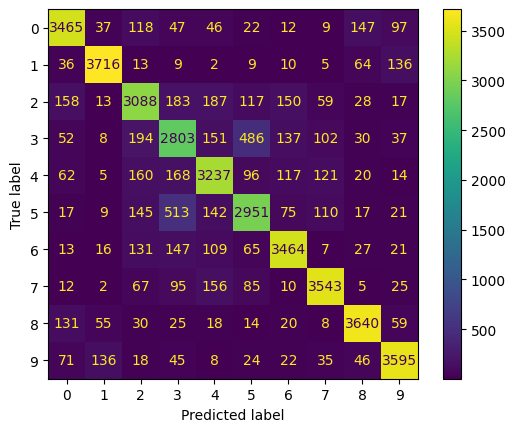

validation...


(Epoch 148 | 79/79) | Data: 0.060s | Batch: 0.072s | Loss: 0.6916| GPU usage: 0.943 GB: 100%|██████████| 79/79 [00:05<00:00, 13.68it/s]


validation loss: 0.68934
validation accuracy: 0.76776
validation precision: 0.76820
validation recall: 0.76820
validation F1-Score: 0.76786
saving with validation loss of 0.689339280128479
[Epoch: 149 training...]


(Epoch 149 | 313/313) | Data: 0.063s | Batch: 0.087s | Loss: 0.4710 | GPU usage: 0.943 GB: 100%|██████████| 313/313 [00:27<00:00, 11.53it/s]


learning rate is 1e-06
training loss: 0.47080
training accuracy: 0.83713
training precision: 0.83681
training recall: 0.83713
training F1-Score: 0.83692


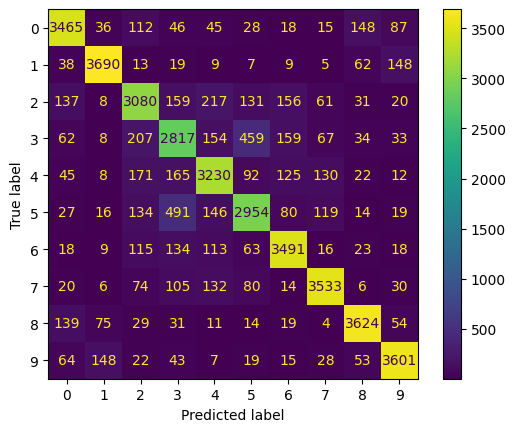

validation...


(Epoch 149 | 79/79) | Data: 0.067s | Batch: 0.080s | Loss: 0.6958| GPU usage: 0.943 GB: 100%|██████████| 79/79 [00:06<00:00, 12.44it/s]


validation loss: 0.69525
validation accuracy: 0.76850
validation precision: 0.76910
validation recall: 0.76910
validation F1-Score: 0.76867
[Epoch: 150 training...]


(Epoch 150 | 313/313) | Data: 0.063s | Batch: 0.088s | Loss: 0.4722 | GPU usage: 0.943 GB: 100%|██████████| 313/313 [00:27<00:00, 11.33it/s]


learning rate is 1e-06
training loss: 0.47221
training accuracy: 0.83713
training precision: 0.83665
training recall: 0.83713
training F1-Score: 0.83687


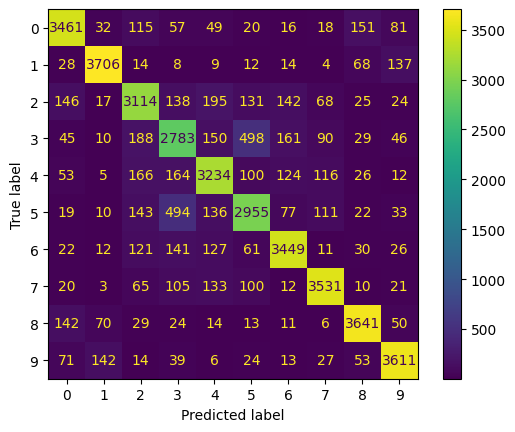

validation...


(Epoch 150 | 79/79) | Data: 0.068s | Batch: 0.083s | Loss: 0.6963| GPU usage: 0.943 GB: 100%|██████████| 79/79 [00:06<00:00, 11.96it/s]


validation loss: 0.69464
validation accuracy: 0.76774
validation precision: 0.76800
validation recall: 0.76800
validation F1-Score: 0.76773


In [29]:
training_funcs.train_model(model, train_loader, num_epochs, writer_train, writer_val, device, val_loader, optimizer, criterion, num_classes, scheduler, training_des, lr, model_name, save_dir, grad_accum, start_epoch, min_loss_diff, min_loss_mean, scaler)

Still Training is needed for more epochs . Training for another 70 epochs

In [30]:
utils.seed_everything(420)  # seed random number generator (To make everything deterministic/reproducible)
device = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')
# device = 'cpu'
print(device)

#Basic setup


path=r"C:\Users\satya\Downloads\Cifar10"

transform_train= transforms.Compose([
    transforms.ToTensor(),
    transforms.RandomHorizontalFlip(p=0.5),
    transforms.Normalize(mean=(0.4913997551666284, 0.48215855929893703, 0.4465309133731618),std=(0.24703225141799082, 0.24348516474564, 0.26158783926049628)),
])

transform_val = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize(mean=(0.4913997551666284, 0.48215855929893703, 0.4465309133731618),std=(0.24703225141799082, 0.24348516474564, 0.26158783926049628)),
])

# Load CIFAR-10 dataset
cifar10_train = datasets.CIFAR10(root=path, train=True, download=True, transform=transform_train)
cifar10_test = datasets.CIFAR10(root=path, train=False, download=True, transform=transform_val)

# Extract digit classes (0-9)
digit_classes = [0, 1, 2, 3, 4, 5, 6, 7, 8, 9]

# Create subsets for digits
train_indices = [i for i, (_, label) in enumerate(cifar10_train) if label in digit_classes]
train_labels = [cifar10_train.targets[i] for i in train_indices]

# Perform stratified split into train and validation sets
train_indices, val_indices = train_test_split(
    train_indices,
    test_size=0.2,
    stratify=train_labels,
    random_state=42
)

#Model selection and parameters

model_name = 'Custom_ConvNet'
run = 'ConvNet'
num_classes = 10

# model = timm.create_model('resnet50', num_classes=num_classes, pretrained=True)
model = ConvNet()
# model= nn.DataParallel(model)

model=model.to(device)
for params in model.parameters():
    params.requires_grad = True

print(f'Model Name : ',model_name)
print(f"Total number of trainable parameters in model {sum(p.numel() for p in model.parameters() if p.requires_grad is True)}")

#Hyperparameters

batch_size = 128
# lr = 0.0001
lr = 1e-4
num_epochs = 220
grad_accum = 1

#Loss Function
# criterion = smp.losses.TverskyLoss(mode = 'multiclass', from_logits=True,alpha = 0.50,beta = 0.50).to(device = device)
# criterion = smp.losses.DiceLoss(mode = 'multiclass', from_logits=True).to(device = device)
criterion = nn.CrossEntropyLoss().to(device=device)

#Optimizer
optimizer = timm.optim.AdamW(model.parameters(), lr = lr)
#Scheduler
scheduler = timm.scheduler.CosineLRScheduler(optimizer, t_initial = num_epochs, lr_min = 1e-6)
#scaler
scaler = torch.amp.GradScaler()

# #Data and paths set up

train_subset = Subset(cifar10_train, train_indices)
val_subset = Subset(cifar10_train, val_indices)

# Create DataLoaders
train_loader = DataLoader(train_subset, batch_size=batch_size, shuffle=True)
val_loader = DataLoader(val_subset, batch_size=batch_size, shuffle=False)


# base_path = "D:\\Experiments"
base_path = r"C:\Users\satya\Downloads\New"
iteration='3'


#Model details and tensorboard
training_des = 'with_overlay'

tb_path = f'TB_data_iteration_{iteration}_{model_name}_{training_des}_effective_bs:_{batch_size*grad_accum}_epochs:_{num_epochs}'

# writer_train = SummaryWriter(os.path.join(base_path, '\\tensorboard_logs\\'  + f'{tb_path}' + '_train'))
# writer_val = SummaryWriter(os.path.join(base_path, '\\tensorboard_logs\\' + f'{tb_path}' + '_val'))
writer_train = SummaryWriter(os.path.join(base_path, 'tensorboard_logs\\'  f'Iteration_{iteration}' + '_train'))
writer_val = SummaryWriter(os.path.join(base_path, 'tensorboard_logs\\' + f'Iteration_{iteration}' + '_val'))

if not os.path.exists(os.path.join(base_path, 'tensorboard_logs')):
    os.mkdir(os.path.join(base_path, 'tensorboard_logs'))

#Model saving path
save_dir = os.path.join(base_path,'training_weights')
if not os.path.exists(save_dir):
    os.mkdir(save_dir)

resume = True # Setting resume variable true to resume training from 100th epoch
resume_checkpoint = r"C:\Users\satya\Downloads\New\training_weights\Last_Model_with_overlay_0.0001_Custom_ConvNet_149.pt"
##Ensure the base_path for checkpoint. This is to ensure the tensorboard logs are correct
if resume:
    assert os.path.isfile(resume_checkpoint), 'The path does not exist'
    checkpoint = torch.load(resume_checkpoint,weights_only=True)
    model.load_state_dict(checkpoint['model_state_dict'])
    optimizer.load_state_dict(checkpoint['opt_state_dict'])
    scaler.load_state_dict(checkpoint['scalar_state'])
    scheduler.load_state_dict(checkpoint['scheduler_state'])
    start_epoch = checkpoint['epoch'] + 1
    min_loss_diff = checkpoint['min_loss_diff']
    min_loss_mean = checkpoint['min_loss_mean']
    print(f"Resuming Training from Epoch : ",start_epoch)
else:
    start_epoch = 0
    min_loss_diff = 1000
    min_loss_mean = 1000


cuda:0
Files already downloaded and verified
Files already downloaded and verified
Model Name :  Custom_ConvNet
Total number of trainable parameters in model 2791434
Resuming Training from Epoch :  150


[Epoch: 151 training...]


(Epoch 151 | 313/313) | Data: 0.055s | Batch: 0.096s | Loss: 0.5124 | GPU usage: 0.958 GB: 100%|██████████| 313/313 [00:30<00:00, 10.43it/s]


learning rate is 1e-06
training loss: 0.51249
training accuracy: 0.81905
training precision: 0.81872
training recall: 0.81905
training F1-Score: 0.81884


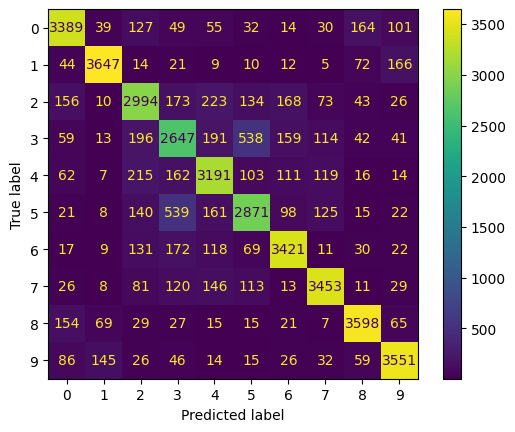

validation...


(Epoch 151 | 79/79) | Data: 0.059s | Batch: 0.079s | Loss: 0.6982| GPU usage: 0.958 GB: 100%|██████████| 79/79 [00:06<00:00, 12.56it/s]


validation loss: 0.69697
validation accuracy: 0.76602
validation precision: 0.76690
validation recall: 0.76690
validation F1-Score: 0.76631
saving with validation loss of 0.696965217590332
[Epoch: 152 training...]


(Epoch 152 | 313/313) | Data: 0.055s | Batch: 0.094s | Loss: 0.5082 | GPU usage: 0.958 GB: 100%|██████████| 313/313 [00:29<00:00, 10.64it/s]


learning rate is 1e-06
training loss: 0.50826
training accuracy: 0.82175
training precision: 0.82142
training recall: 0.82175
training F1-Score: 0.82155


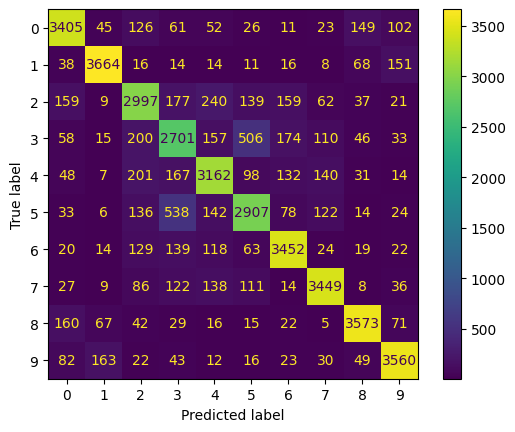

validation...


(Epoch 152 | 79/79) | Data: 0.055s | Batch: 0.072s | Loss: 0.6950| GPU usage: 0.958 GB: 100%|██████████| 79/79 [00:05<00:00, 13.78it/s]


validation loss: 0.69443
validation accuracy: 0.76595
validation precision: 0.76680
validation recall: 0.76680
validation F1-Score: 0.76620
saving with validation loss of 0.6944255828857422
[Epoch: 153 training...]


(Epoch 153 | 313/313) | Data: 0.053s | Batch: 0.089s | Loss: 0.5067 | GPU usage: 0.958 GB: 100%|██████████| 313/313 [00:27<00:00, 11.25it/s]


learning rate is 1e-06
training loss: 0.50675
training accuracy: 0.82295
training precision: 0.82251
training recall: 0.82295
training F1-Score: 0.82270


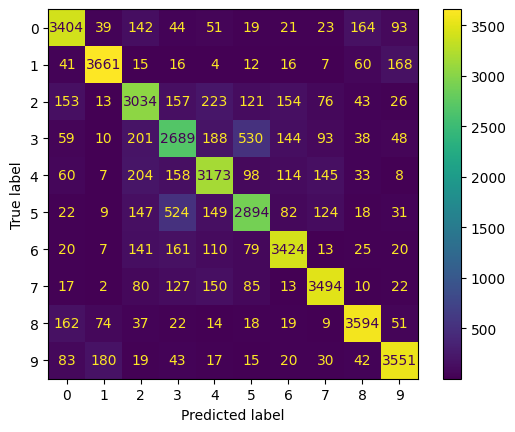

validation...


(Epoch 153 | 79/79) | Data: 0.057s | Batch: 0.075s | Loss: 0.6997| GPU usage: 1.002 GB: 100%|██████████| 79/79 [00:06<00:00, 13.15it/s]


validation loss: 0.69924
validation accuracy: 0.76550
validation precision: 0.76650
validation recall: 0.76650
validation F1-Score: 0.76582
[Epoch: 154 training...]


(Epoch 154 | 313/313) | Data: 0.054s | Batch: 0.090s | Loss: 0.5091 | GPU usage: 1.002 GB: 100%|██████████| 313/313 [00:28<00:00, 11.12it/s]


learning rate is 1e-06
training loss: 0.50925
training accuracy: 0.82250
training precision: 0.82221
training recall: 0.82250
training F1-Score: 0.82228


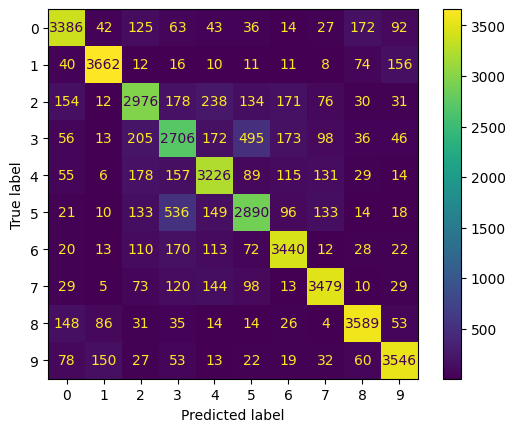

validation...


(Epoch 154 | 79/79) | Data: 0.053s | Batch: 0.069s | Loss: 0.6956| GPU usage: 1.002 GB: 100%|██████████| 79/79 [00:05<00:00, 14.24it/s]


validation loss: 0.69290
validation accuracy: 0.76621
validation precision: 0.76690
validation recall: 0.76690
validation F1-Score: 0.76643
saving with validation loss of 0.6929025650024414
[Epoch: 155 training...]


(Epoch 155 | 313/313) | Data: 0.054s | Batch: 0.093s | Loss: 0.5113 | GPU usage: 1.002 GB: 100%|██████████| 313/313 [00:29<00:00, 10.76it/s]


learning rate is 1e-06
training loss: 0.51114
training accuracy: 0.82275
training precision: 0.82230
training recall: 0.82275
training F1-Score: 0.82248


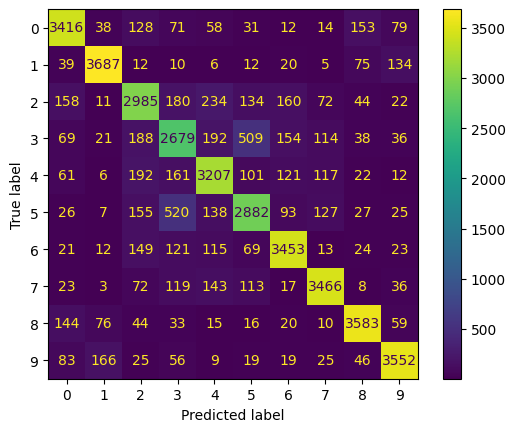

validation...


(Epoch 155 | 79/79) | Data: 0.056s | Batch: 0.075s | Loss: 0.6952| GPU usage: 1.002 GB: 100%|██████████| 79/79 [00:06<00:00, 13.12it/s]


validation loss: 0.69354
validation accuracy: 0.76415
validation precision: 0.76500
validation recall: 0.76500
validation F1-Score: 0.76448
saving with validation loss of 0.6935431957244873
[Epoch: 156 training...]


(Epoch 156 | 313/313) | Data: 0.054s | Batch: 0.094s | Loss: 0.5081 | GPU usage: 1.002 GB: 100%|██████████| 313/313 [00:29<00:00, 10.64it/s]


learning rate is 1e-06
training loss: 0.50788
training accuracy: 0.82408
training precision: 0.82352
training recall: 0.82408
training F1-Score: 0.82373


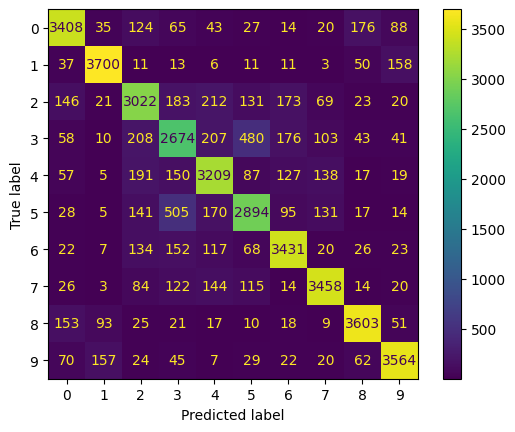

validation...


(Epoch 156 | 79/79) | Data: 0.053s | Batch: 0.069s | Loss: 0.6933| GPU usage: 1.002 GB: 100%|██████████| 79/79 [00:05<00:00, 14.39it/s]


validation loss: 0.69172
validation accuracy: 0.76477
validation precision: 0.76510
validation recall: 0.76510
validation F1-Score: 0.76478
saving with validation loss of 0.6917207837104797
[Epoch: 157 training...]


(Epoch 157 | 313/313) | Data: 0.053s | Batch: 0.088s | Loss: 0.5109 | GPU usage: 1.002 GB: 100%|██████████| 313/313 [00:27<00:00, 11.37it/s]


learning rate is 1e-06
training loss: 0.51091
training accuracy: 0.82083
training precision: 0.82046
training recall: 0.82082
training F1-Score: 0.82057


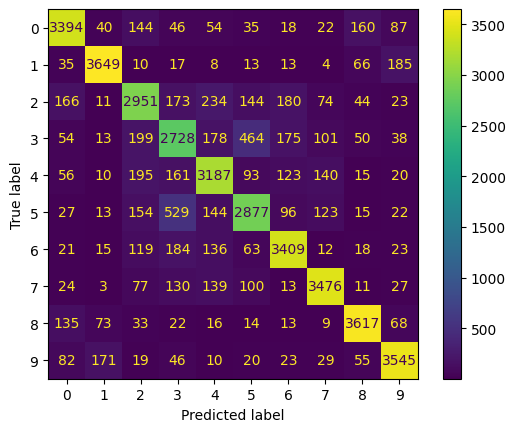

validation...


(Epoch 157 | 79/79) | Data: 0.055s | Batch: 0.075s | Loss: 0.6913| GPU usage: 1.002 GB: 100%|██████████| 79/79 [00:05<00:00, 13.18it/s]


validation loss: 0.69078
validation accuracy: 0.76655
validation precision: 0.76730
validation recall: 0.76730
validation F1-Score: 0.76679
saving with validation loss of 0.6907822489738464
[Epoch: 158 training...]


(Epoch 158 | 313/313) | Data: 0.053s | Batch: 0.091s | Loss: 0.5078 | GPU usage: 1.002 GB: 100%|██████████| 313/313 [00:28<00:00, 10.92it/s]


learning rate is 1e-06
training loss: 0.50798
training accuracy: 0.82422
training precision: 0.82379
training recall: 0.82422
training F1-Score: 0.82398


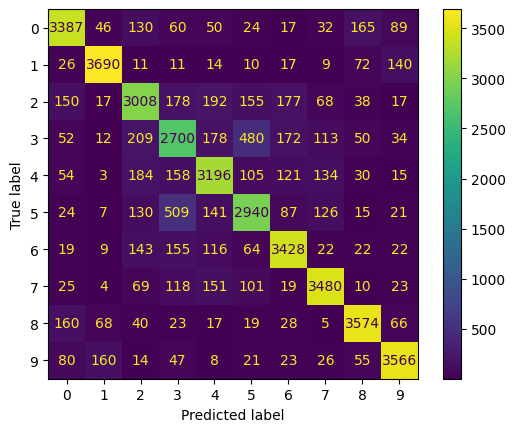

validation...


(Epoch 158 | 79/79) | Data: 0.057s | Batch: 0.080s | Loss: 0.6999| GPU usage: 1.002 GB: 100%|██████████| 79/79 [00:06<00:00, 12.38it/s]


validation loss: 0.70044
validation accuracy: 0.76364
validation precision: 0.76410
validation recall: 0.76410
validation F1-Score: 0.76375
[Epoch: 159 training...]


(Epoch 159 | 313/313) | Data: 0.055s | Batch: 0.095s | Loss: 0.5026 | GPU usage: 1.002 GB: 100%|██████████| 313/313 [00:29<00:00, 10.50it/s]


learning rate is 1e-06
training loss: 0.50253
training accuracy: 0.82557
training precision: 0.82533
training recall: 0.82557
training F1-Score: 0.82538


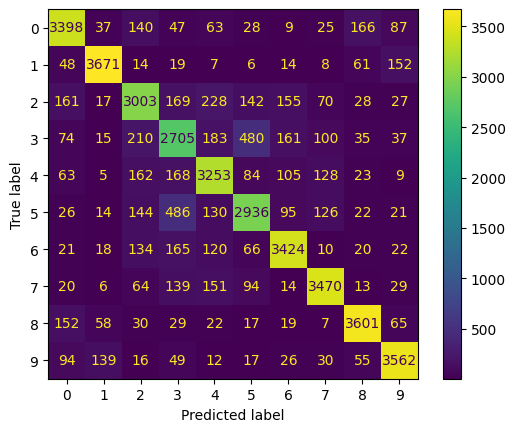

validation...


(Epoch 159 | 79/79) | Data: 0.056s | Batch: 0.076s | Loss: 0.6964| GPU usage: 1.002 GB: 100%|██████████| 79/79 [00:06<00:00, 13.01it/s]


validation loss: 0.69630
validation accuracy: 0.76654
validation precision: 0.76650
validation recall: 0.76650
validation F1-Score: 0.76636
saving with validation loss of 0.6963023543357849
[Epoch: 160 training...]


(Epoch 160 | 313/313) | Data: 0.055s | Batch: 0.097s | Loss: 0.5036 | GPU usage: 1.002 GB: 100%|██████████| 313/313 [00:30<00:00, 10.26it/s]


learning rate is 1e-06
training loss: 0.50366
training accuracy: 0.82285
training precision: 0.82228
training recall: 0.82285
training F1-Score: 0.82253


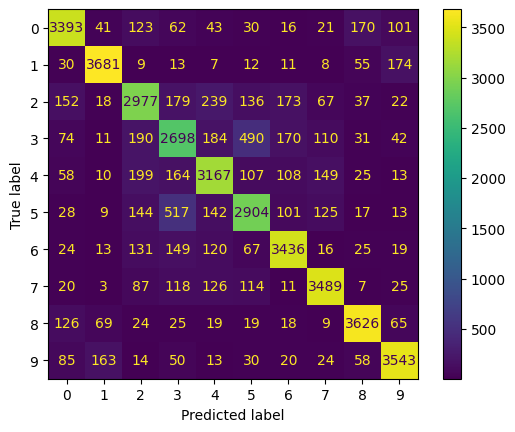

validation...


(Epoch 160 | 79/79) | Data: 0.056s | Batch: 0.078s | Loss: 0.6995| GPU usage: 1.002 GB: 100%|██████████| 79/79 [00:06<00:00, 12.73it/s]


validation loss: 0.69976
validation accuracy: 0.76667
validation precision: 0.76730
validation recall: 0.76730
validation F1-Score: 0.76678
[Epoch: 161 training...]


(Epoch 161 | 313/313) | Data: 0.053s | Batch: 0.089s | Loss: 0.4988 | GPU usage: 1.002 GB: 100%|██████████| 313/313 [00:27<00:00, 11.19it/s]


learning rate is 1e-06
training loss: 0.49866
training accuracy: 0.82657
training precision: 0.82633
training recall: 0.82658
training F1-Score: 0.82640


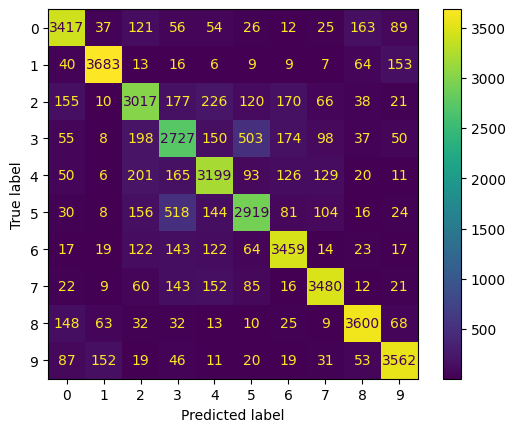

validation...


(Epoch 161 | 79/79) | Data: 0.055s | Batch: 0.077s | Loss: 0.6897| GPU usage: 1.002 GB: 100%|██████████| 79/79 [00:06<00:00, 12.76it/s]


validation loss: 0.69041
validation accuracy: 0.76748
validation precision: 0.76790
validation recall: 0.76790
validation F1-Score: 0.76757
saving with validation loss of 0.6904099583625793
[Epoch: 162 training...]


(Epoch 162 | 313/313) | Data: 0.053s | Batch: 0.091s | Loss: 0.5014 | GPU usage: 1.002 GB: 100%|██████████| 313/313 [00:28<00:00, 10.98it/s]


learning rate is 1e-06
training loss: 0.50147
training accuracy: 0.82475
training precision: 0.82444
training recall: 0.82475
training F1-Score: 0.82454


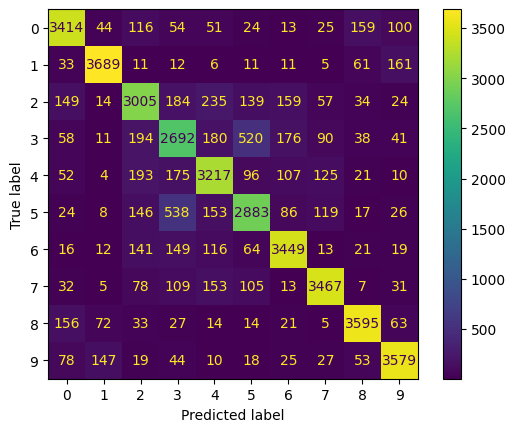

validation...


(Epoch 162 | 79/79) | Data: 0.058s | Batch: 0.077s | Loss: 0.6998| GPU usage: 1.002 GB: 100%|██████████| 79/79 [00:06<00:00, 12.92it/s]


validation loss: 0.69856
validation accuracy: 0.76429
validation precision: 0.76470
validation recall: 0.76470
validation F1-Score: 0.76434
[Epoch: 163 training...]


(Epoch 163 | 313/313) | Data: 0.063s | Batch: 0.108s | Loss: 0.4986 | GPU usage: 1.002 GB: 100%|██████████| 313/313 [00:34<00:00,  9.20it/s]


learning rate is 1e-06
training loss: 0.49872
training accuracy: 0.82368
training precision: 0.82318
training recall: 0.82368
training F1-Score: 0.82337


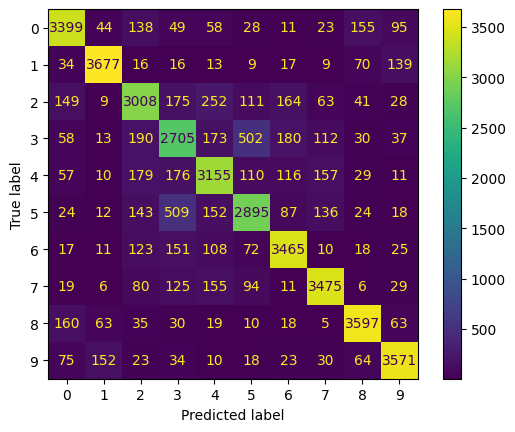

validation...


(Epoch 163 | 79/79) | Data: 0.066s | Batch: 0.088s | Loss: 0.6901| GPU usage: 1.002 GB: 100%|██████████| 79/79 [00:06<00:00, 11.30it/s]


validation loss: 0.68990
validation accuracy: 0.76635
validation precision: 0.76700
validation recall: 0.76700
validation F1-Score: 0.76649
saving with validation loss of 0.6899001598358154
[Epoch: 164 training...]


(Epoch 164 | 313/313) | Data: 0.065s | Batch: 0.108s | Loss: 0.5009 | GPU usage: 1.002 GB: 100%|██████████| 313/313 [00:33<00:00,  9.27it/s]


learning rate is 1e-06
training loss: 0.50086
training accuracy: 0.82755
training precision: 0.82723
training recall: 0.82755
training F1-Score: 0.82735


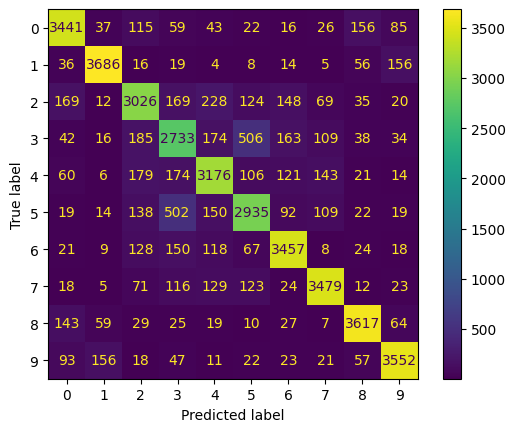

validation...


(Epoch 164 | 79/79) | Data: 0.068s | Batch: 0.093s | Loss: 0.6985| GPU usage: 1.002 GB: 100%|██████████| 79/79 [00:07<00:00, 10.56it/s]


validation loss: 0.69773
validation accuracy: 0.76492
validation precision: 0.76540
validation recall: 0.76540
validation F1-Score: 0.76502
[Epoch: 165 training...]


(Epoch 165 | 313/313) | Data: 0.065s | Batch: 0.112s | Loss: 0.4992 | GPU usage: 1.002 GB: 100%|██████████| 313/313 [00:35<00:00,  8.89it/s]


learning rate is 1e-06
training loss: 0.49934
training accuracy: 0.82595
training precision: 0.82537
training recall: 0.82595
training F1-Score: 0.82561


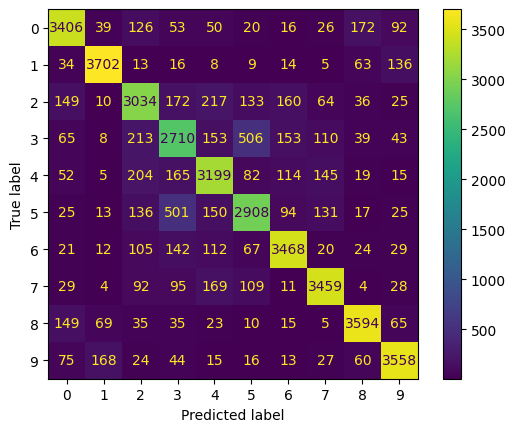

validation...


(Epoch 165 | 79/79) | Data: 0.067s | Batch: 0.091s | Loss: 0.6970| GPU usage: 1.002 GB: 100%|██████████| 79/79 [00:07<00:00, 10.89it/s]


validation loss: 0.69599
validation accuracy: 0.76390
validation precision: 0.76500
validation recall: 0.76500
validation F1-Score: 0.76433
[Epoch: 166 training...]


(Epoch 166 | 313/313) | Data: 0.064s | Batch: 0.105s | Loss: 0.5009 | GPU usage: 1.002 GB: 100%|██████████| 313/313 [00:32<00:00,  9.53it/s]


learning rate is 1e-06
training loss: 0.50083
training accuracy: 0.82565
training precision: 0.82531
training recall: 0.82565
training F1-Score: 0.82541


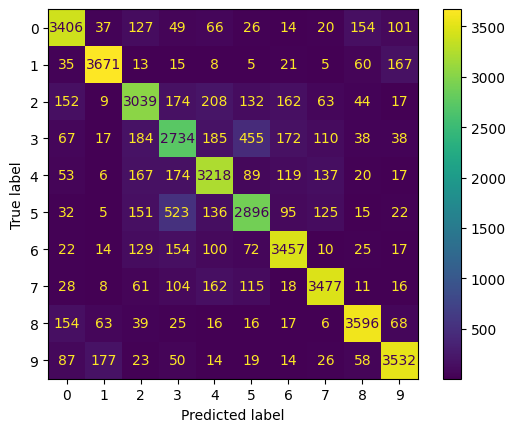

validation...


(Epoch 166 | 79/79) | Data: 0.068s | Batch: 0.092s | Loss: 0.6957| GPU usage: 1.002 GB: 100%|██████████| 79/79 [00:07<00:00, 10.72it/s]


validation loss: 0.69305
validation accuracy: 0.76770
validation precision: 0.76720
validation recall: 0.76720
validation F1-Score: 0.76726
[Epoch: 167 training...]


(Epoch 167 | 313/313) | Data: 0.065s | Batch: 0.112s | Loss: 0.4962 | GPU usage: 1.002 GB: 100%|██████████| 313/313 [00:35<00:00,  8.86it/s]


learning rate is 1e-06
training loss: 0.49618
training accuracy: 0.82815
training precision: 0.82783
training recall: 0.82815
training F1-Score: 0.82794


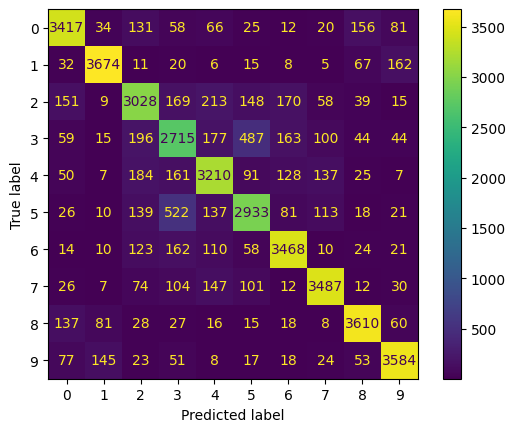

validation...


(Epoch 167 | 79/79) | Data: 0.067s | Batch: 0.090s | Loss: 0.6918| GPU usage: 1.002 GB: 100%|██████████| 79/79 [00:07<00:00, 10.97it/s]


validation loss: 0.69040
validation accuracy: 0.76550
validation precision: 0.76580
validation recall: 0.76580
validation F1-Score: 0.76551
saving with validation loss of 0.6904017329216003
[Epoch: 168 training...]


(Epoch 168 | 313/313) | Data: 0.062s | Batch: 0.111s | Loss: 0.4960 | GPU usage: 1.002 GB: 100%|██████████| 313/313 [00:34<00:00,  8.96it/s]


learning rate is 1e-06
training loss: 0.49596
training accuracy: 0.82785
training precision: 0.82737
training recall: 0.82785
training F1-Score: 0.82757


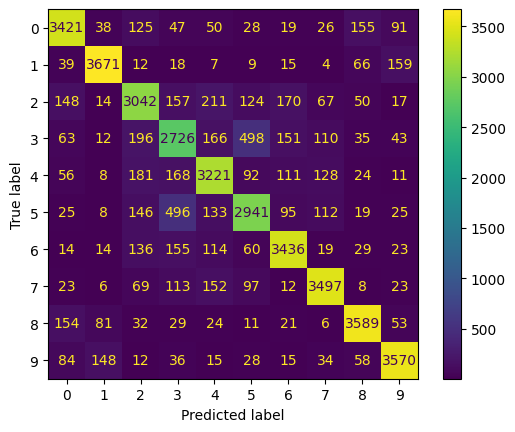

validation...


(Epoch 168 | 79/79) | Data: 0.050s | Batch: 0.057s | Loss: 0.6900| GPU usage: 1.196 GB: 100%|██████████| 79/79 [00:04<00:00, 17.22it/s]


validation loss: 0.68937
validation accuracy: 0.76700
validation precision: 0.76750
validation recall: 0.76750
validation F1-Score: 0.76708
saving with validation loss of 0.6893725991249084
[Epoch: 169 training...]


(Epoch 169 | 313/313) | Data: 0.053s | Batch: 0.082s | Loss: 0.4936 | GPU usage: 1.196 GB: 100%|██████████| 313/313 [00:25<00:00, 12.11it/s]


learning rate is 1e-06
training loss: 0.49347
training accuracy: 0.82803
training precision: 0.82750
training recall: 0.82803
training F1-Score: 0.82772


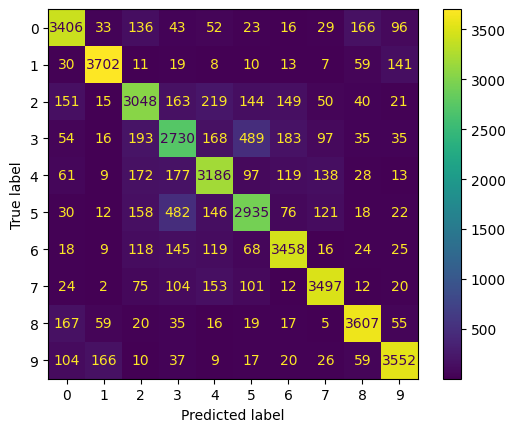

validation...


(Epoch 169 | 79/79) | Data: 0.057s | Batch: 0.079s | Loss: 0.7001| GPU usage: 1.196 GB: 100%|██████████| 79/79 [00:06<00:00, 12.56it/s]


validation loss: 0.70039
validation accuracy: 0.76530
validation precision: 0.76570
validation recall: 0.76570
validation F1-Score: 0.76537
[Epoch: 170 training...]


(Epoch 170 | 313/313) | Data: 0.058s | Batch: 0.099s | Loss: 0.4925 | GPU usage: 1.196 GB: 100%|██████████| 313/313 [00:31<00:00, 10.10it/s]


learning rate is 1e-06
training loss: 0.49248
training accuracy: 0.82873
training precision: 0.82825
training recall: 0.82873
training F1-Score: 0.82843


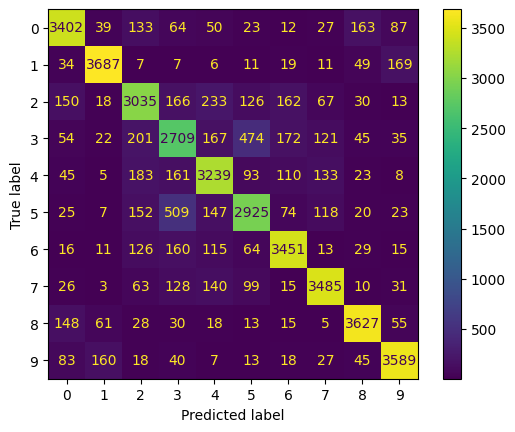

validation...


(Epoch 170 | 79/79) | Data: 0.052s | Batch: 0.058s | Loss: 0.6923| GPU usage: 1.196 GB: 100%|██████████| 79/79 [00:04<00:00, 17.07it/s]


validation loss: 0.69050
validation accuracy: 0.76600
validation precision: 0.76610
validation recall: 0.76610
validation F1-Score: 0.76594
saving with validation loss of 0.690504252910614
[Epoch: 171 training...]


(Epoch 171 | 313/313) | Data: 0.053s | Batch: 0.087s | Loss: 0.4904 | GPU usage: 1.196 GB: 100%|██████████| 313/313 [00:27<00:00, 11.41it/s]


learning rate is 1e-06
training loss: 0.49055
training accuracy: 0.83083
training precision: 0.83054
training recall: 0.83082
training F1-Score: 0.83063


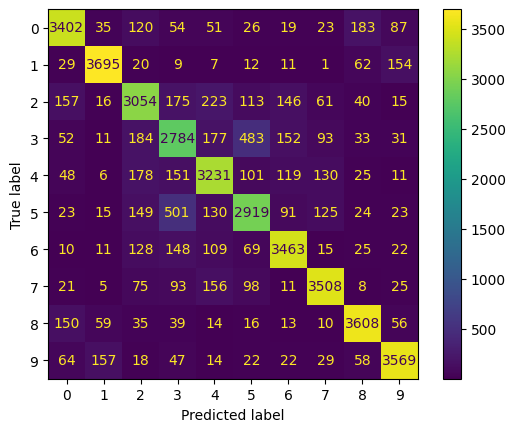

validation...


(Epoch 171 | 79/79) | Data: 0.053s | Batch: 0.068s | Loss: 0.6961| GPU usage: 1.196 GB: 100%|██████████| 79/79 [00:05<00:00, 14.48it/s]


validation loss: 0.69569
validation accuracy: 0.76365
validation precision: 0.76410
validation recall: 0.76410
validation F1-Score: 0.76372
[Epoch: 172 training...]


(Epoch 172 | 313/313) | Data: 0.054s | Batch: 0.094s | Loss: 0.4912 | GPU usage: 1.196 GB: 100%|██████████| 313/313 [00:29<00:00, 10.56it/s]


learning rate is 1e-06
training loss: 0.49107
training accuracy: 0.82870
training precision: 0.82833
training recall: 0.82870
training F1-Score: 0.82848


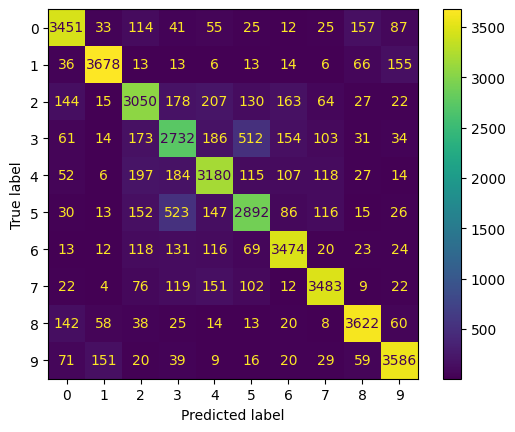

validation...


(Epoch 172 | 79/79) | Data: 0.055s | Batch: 0.075s | Loss: 0.6927| GPU usage: 1.196 GB: 100%|██████████| 79/79 [00:06<00:00, 13.13it/s]


validation loss: 0.69077
validation accuracy: 0.76628
validation precision: 0.76680
validation recall: 0.76680
validation F1-Score: 0.76636
saving with validation loss of 0.6907709836959839
[Epoch: 173 training...]


(Epoch 173 | 313/313) | Data: 0.055s | Batch: 0.095s | Loss: 0.4894 | GPU usage: 1.196 GB: 100%|██████████| 313/313 [00:29<00:00, 10.46it/s]


learning rate is 1e-06
training loss: 0.48907
training accuracy: 0.82965
training precision: 0.82925
training recall: 0.82965
training F1-Score: 0.82941


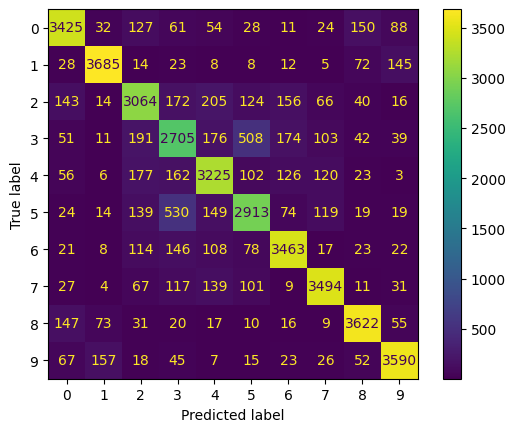

validation...


(Epoch 173 | 79/79) | Data: 0.055s | Batch: 0.073s | Loss: 0.6945| GPU usage: 1.196 GB: 100%|██████████| 79/79 [00:05<00:00, 13.55it/s]


validation loss: 0.69548
validation accuracy: 0.76539
validation precision: 0.76600
validation recall: 0.76600
validation F1-Score: 0.76552
[Epoch: 174 training...]


(Epoch 174 | 313/313) | Data: 0.054s | Batch: 0.094s | Loss: 0.4859 | GPU usage: 1.196 GB: 100%|██████████| 313/313 [00:29<00:00, 10.56it/s]


learning rate is 1e-06
training loss: 0.48595
training accuracy: 0.83235
training precision: 0.83192
training recall: 0.83235
training F1-Score: 0.83209


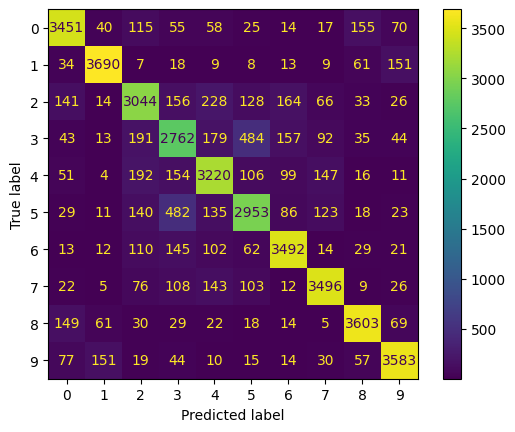

validation...


(Epoch 174 | 79/79) | Data: 0.055s | Batch: 0.076s | Loss: 0.6936| GPU usage: 1.196 GB: 100%|██████████| 79/79 [00:06<00:00, 13.03it/s]


validation loss: 0.69278
validation accuracy: 0.76458
validation precision: 0.76540
validation recall: 0.76540
validation F1-Score: 0.76482
saving with validation loss of 0.692777693271637
[Epoch: 175 training...]


(Epoch 175 | 313/313) | Data: 0.054s | Batch: 0.093s | Loss: 0.4899 | GPU usage: 1.196 GB: 100%|██████████| 313/313 [00:29<00:00, 10.72it/s]


learning rate is 1e-06
training loss: 0.49000
training accuracy: 0.82830
training precision: 0.82804
training recall: 0.82830
training F1-Score: 0.82812


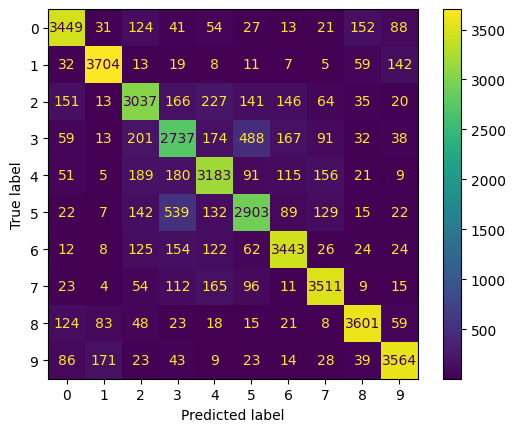

validation...


(Epoch 175 | 79/79) | Data: 0.057s | Batch: 0.080s | Loss: 0.6977| GPU usage: 1.196 GB: 100%|██████████| 79/79 [00:06<00:00, 12.34it/s]


validation loss: 0.69609
validation accuracy: 0.76541
validation precision: 0.76560
validation recall: 0.76560
validation F1-Score: 0.76538
saving with validation loss of 0.6960909366607666
[Epoch: 176 training...]


(Epoch 176 | 313/313) | Data: 0.054s | Batch: 0.090s | Loss: 0.4845 | GPU usage: 1.196 GB: 100%|██████████| 313/313 [00:28<00:00, 11.12it/s]


learning rate is 1e-06
training loss: 0.48443
training accuracy: 0.83178
training precision: 0.83142
training recall: 0.83178
training F1-Score: 0.83156


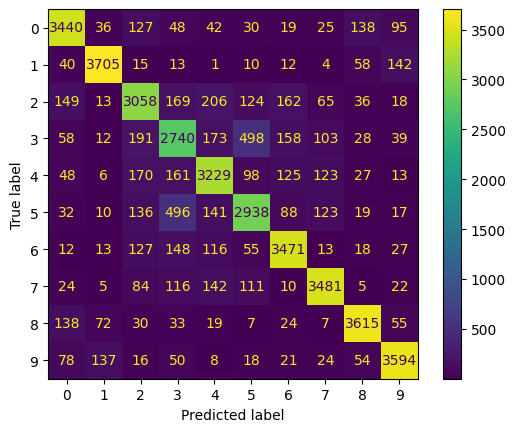

validation...


(Epoch 176 | 79/79) | Data: 0.056s | Batch: 0.079s | Loss: 0.6991| GPU usage: 1.196 GB: 100%|██████████| 79/79 [00:06<00:00, 12.40it/s]


validation loss: 0.69994
validation accuracy: 0.76537
validation precision: 0.76530
validation recall: 0.76530
validation F1-Score: 0.76518
saving with validation loss of 0.6999366879463196
[Epoch: 177 training...]


(Epoch 177 | 313/313) | Data: 0.053s | Batch: 0.085s | Loss: 0.4816 | GPU usage: 1.196 GB: 100%|██████████| 313/313 [00:26<00:00, 11.79it/s]


learning rate is 1e-06
training loss: 0.48155
training accuracy: 0.83242
training precision: 0.83237
training recall: 0.83243
training F1-Score: 0.83233


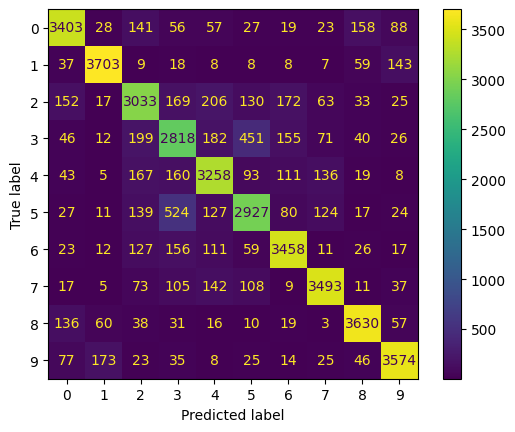

validation...


(Epoch 177 | 79/79) | Data: 0.057s | Batch: 0.077s | Loss: 0.7016| GPU usage: 1.196 GB: 100%|██████████| 79/79 [00:06<00:00, 12.80it/s]


validation loss: 0.70001
validation accuracy: 0.76971
validation precision: 0.77000
validation recall: 0.77000
validation F1-Score: 0.76968
saving with validation loss of 0.7000121474266052
[Epoch: 178 training...]


(Epoch 178 | 313/313) | Data: 0.062s | Batch: 0.108s | Loss: 0.4852 | GPU usage: 1.196 GB: 100%|██████████| 313/313 [00:33<00:00,  9.22it/s]


learning rate is 1e-06
training loss: 0.48520
training accuracy: 0.83203
training precision: 0.83184
training recall: 0.83203
training F1-Score: 0.83191


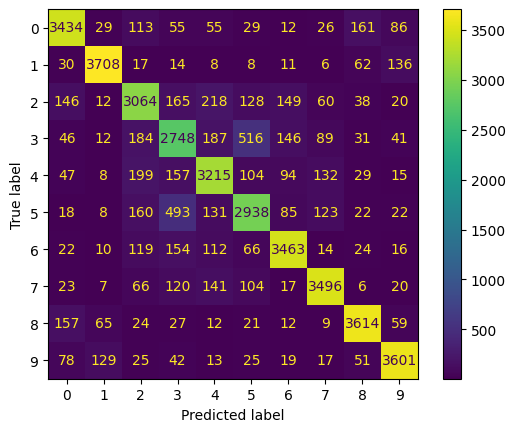

validation...


(Epoch 178 | 79/79) | Data: 0.061s | Batch: 0.083s | Loss: 0.6949| GPU usage: 1.196 GB: 100%|██████████| 79/79 [00:06<00:00, 11.92it/s]


validation loss: 0.69308
validation accuracy: 0.76778
validation precision: 0.76770
validation recall: 0.76770
validation F1-Score: 0.76757
saving with validation loss of 0.6930780410766602
[Epoch: 179 training...]


(Epoch 179 | 313/313) | Data: 0.056s | Batch: 0.101s | Loss: 0.4788 | GPU usage: 1.196 GB: 100%|██████████| 313/313 [00:31<00:00,  9.91it/s]


learning rate is 1e-06
training loss: 0.47852
training accuracy: 0.83273
training precision: 0.83235
training recall: 0.83273
training F1-Score: 0.83251


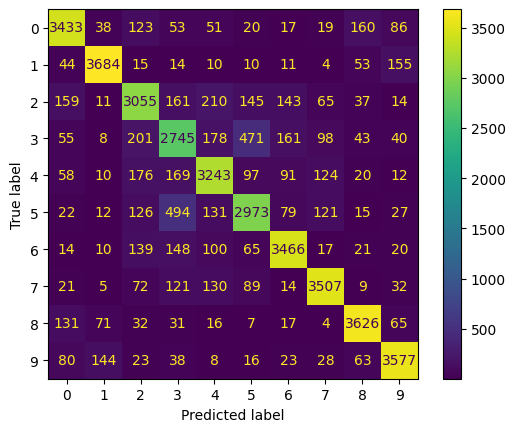

validation...


(Epoch 179 | 79/79) | Data: 0.054s | Batch: 0.071s | Loss: 0.7020| GPU usage: 1.196 GB: 100%|██████████| 79/79 [00:05<00:00, 13.82it/s]


validation loss: 0.70015
validation accuracy: 0.76304
validation precision: 0.76390
validation recall: 0.76390
validation F1-Score: 0.76331
[Epoch: 180 training...]


(Epoch 180 | 313/313) | Data: 0.055s | Batch: 0.095s | Loss: 0.4784 | GPU usage: 1.196 GB: 100%|██████████| 313/313 [00:29<00:00, 10.56it/s]


learning rate is 1e-06
training loss: 0.47850
training accuracy: 0.83403
training precision: 0.83350
training recall: 0.83402
training F1-Score: 0.83370


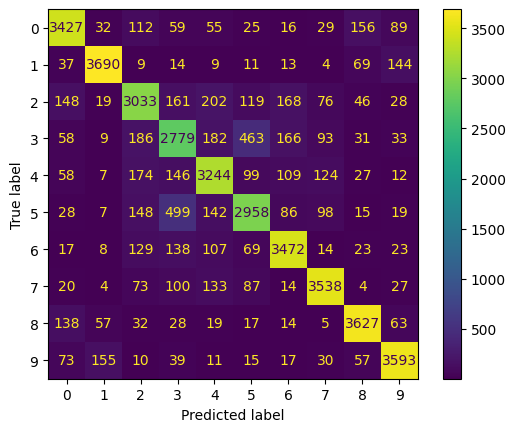

validation...


(Epoch 180 | 79/79) | Data: 0.065s | Batch: 0.089s | Loss: 0.6979| GPU usage: 1.196 GB: 100%|██████████| 79/79 [00:07<00:00, 11.10it/s]


validation loss: 0.69776
validation accuracy: 0.76580
validation precision: 0.76620
validation recall: 0.76620
validation F1-Score: 0.76586
saving with validation loss of 0.6977604031562805
[Epoch: 181 training...]


(Epoch 181 | 313/313) | Data: 0.067s | Batch: 0.116s | Loss: 0.4786 | GPU usage: 1.196 GB: 100%|██████████| 313/313 [00:36<00:00,  8.60it/s]


learning rate is 1e-06
training loss: 0.47890
training accuracy: 0.83340
training precision: 0.83288
training recall: 0.83340
training F1-Score: 0.83308


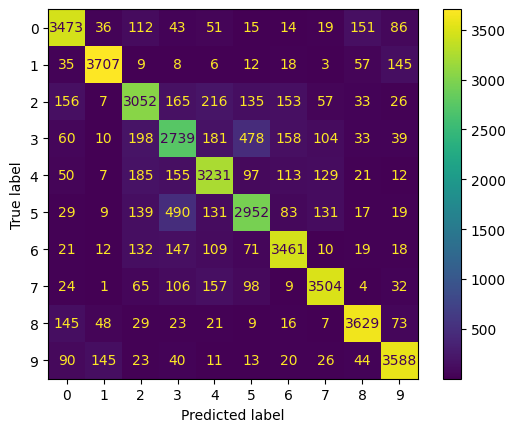

validation...


(Epoch 181 | 79/79) | Data: 0.065s | Batch: 0.085s | Loss: 0.6967| GPU usage: 1.196 GB: 100%|██████████| 79/79 [00:06<00:00, 11.59it/s]


validation loss: 0.69711
validation accuracy: 0.76304
validation precision: 0.76370
validation recall: 0.76370
validation F1-Score: 0.76325
saving with validation loss of 0.6971092820167542
[Epoch: 182 training...]


(Epoch 182 | 313/313) | Data: 0.057s | Batch: 0.089s | Loss: 0.4799 | GPU usage: 1.196 GB: 100%|██████████| 313/313 [00:27<00:00, 11.25it/s]


learning rate is 1e-06
training loss: 0.48007
training accuracy: 0.83388
training precision: 0.83335
training recall: 0.83388
training F1-Score: 0.83358


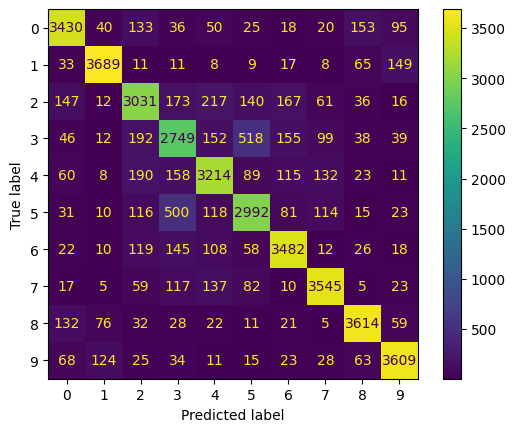

validation...


(Epoch 182 | 79/79) | Data: 0.056s | Batch: 0.077s | Loss: 0.6919| GPU usage: 1.196 GB: 100%|██████████| 79/79 [00:06<00:00, 12.85it/s]


validation loss: 0.69265
validation accuracy: 0.77018
validation precision: 0.77070
validation recall: 0.77070
validation F1-Score: 0.77028
saving with validation loss of 0.6926483511924744
[Epoch: 183 training...]


(Epoch 183 | 313/313) | Data: 0.055s | Batch: 0.096s | Loss: 0.4823 | GPU usage: 1.196 GB: 100%|██████████| 313/313 [00:30<00:00, 10.41it/s]


learning rate is 1e-06
training loss: 0.48258
training accuracy: 0.83155
training precision: 0.83146
training recall: 0.83155
training F1-Score: 0.83144


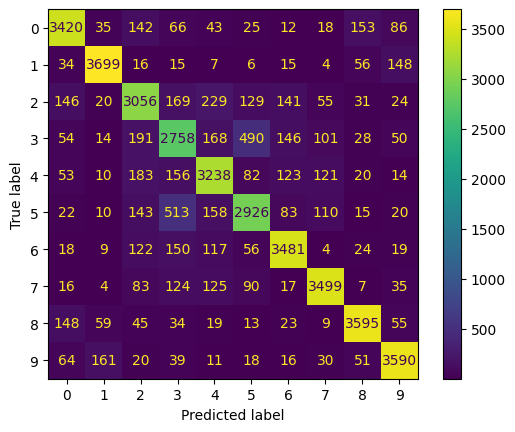

validation...


(Epoch 183 | 79/79) | Data: 0.052s | Batch: 0.059s | Loss: 0.7014| GPU usage: 1.196 GB: 100%|██████████| 79/79 [00:04<00:00, 16.88it/s]


validation loss: 0.70050
validation accuracy: 0.76383
validation precision: 0.76390
validation recall: 0.76390
validation F1-Score: 0.76370
[Epoch: 184 training...]


(Epoch 184 | 313/313) | Data: 0.054s | Batch: 0.085s | Loss: 0.4728 | GPU usage: 1.196 GB: 100%|██████████| 313/313 [00:26<00:00, 11.79it/s]


learning rate is 1e-06
training loss: 0.47275
training accuracy: 0.83408
training precision: 0.83352
training recall: 0.83408
training F1-Score: 0.83376


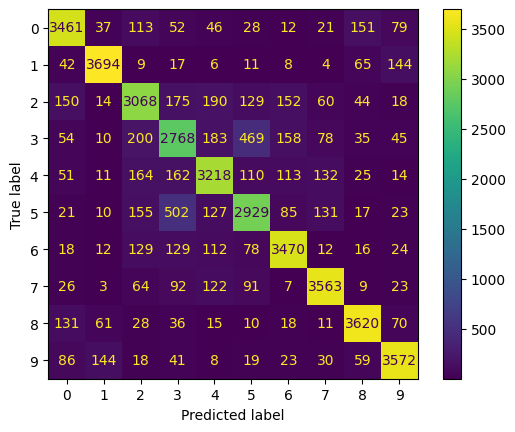

validation...


(Epoch 184 | 79/79) | Data: 0.057s | Batch: 0.076s | Loss: 0.7007| GPU usage: 1.196 GB: 100%|██████████| 79/79 [00:06<00:00, 12.92it/s]


validation loss: 0.69934
validation accuracy: 0.76631
validation precision: 0.76690
validation recall: 0.76690
validation F1-Score: 0.76647
saving with validation loss of 0.6993445754051208
[Epoch: 185 training...]


(Epoch 185 | 313/313) | Data: 0.053s | Batch: 0.089s | Loss: 0.4755 | GPU usage: 1.196 GB: 100%|██████████| 313/313 [00:28<00:00, 11.16it/s]


learning rate is 1e-06
training loss: 0.47567
training accuracy: 0.83460
training precision: 0.83432
training recall: 0.83460
training F1-Score: 0.83443


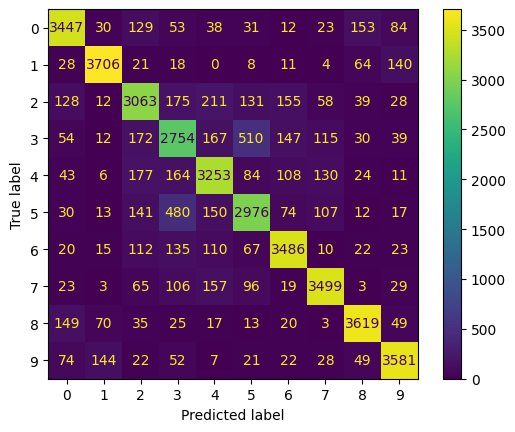

validation...


(Epoch 185 | 79/79) | Data: 0.056s | Batch: 0.077s | Loss: 0.7036| GPU usage: 1.196 GB: 100%|██████████| 79/79 [00:06<00:00, 12.84it/s]


validation loss: 0.70449
validation accuracy: 0.76176
validation precision: 0.76240
validation recall: 0.76240
validation F1-Score: 0.76185
[Epoch: 186 training...]


(Epoch 186 | 313/313) | Data: 0.053s | Batch: 0.089s | Loss: 0.4730 | GPU usage: 1.196 GB: 100%|██████████| 313/313 [00:28<00:00, 11.15it/s]


learning rate is 1e-06
training loss: 0.47324
training accuracy: 0.83667
training precision: 0.83641
training recall: 0.83667
training F1-Score: 0.83648


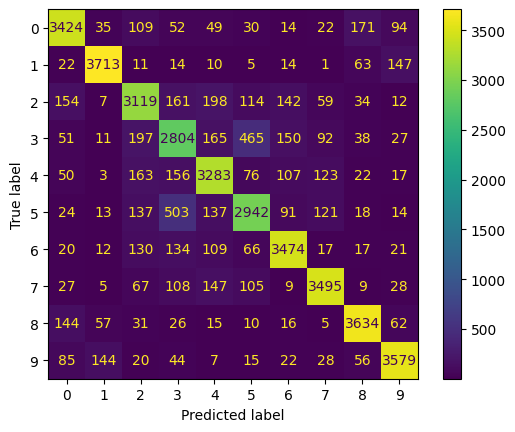

validation...


(Epoch 186 | 79/79) | Data: 0.054s | Batch: 0.076s | Loss: 0.7000| GPU usage: 1.196 GB: 100%|██████████| 79/79 [00:06<00:00, 12.93it/s]


validation loss: 0.69863
validation accuracy: 0.76621
validation precision: 0.76630
validation recall: 0.76630
validation F1-Score: 0.76613
saving with validation loss of 0.6986286640167236
[Epoch: 187 training...]


(Epoch 187 | 313/313) | Data: 0.054s | Batch: 0.086s | Loss: 0.4678 | GPU usage: 1.196 GB: 100%|██████████| 313/313 [00:27<00:00, 11.54it/s]


learning rate is 1e-06
training loss: 0.46781
training accuracy: 0.83745
training precision: 0.83720
training recall: 0.83745
training F1-Score: 0.83728


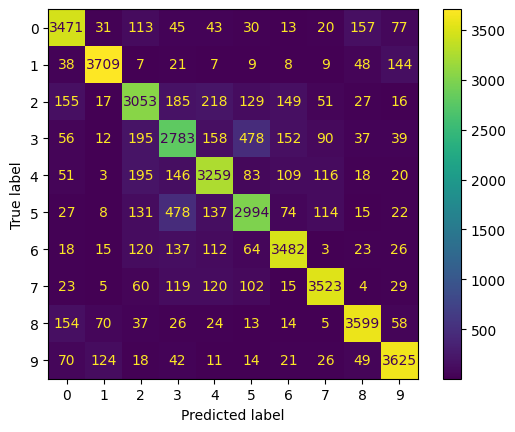

validation...


(Epoch 187 | 79/79) | Data: 0.060s | Batch: 0.082s | Loss: 0.6973| GPU usage: 1.196 GB: 100%|██████████| 79/79 [00:06<00:00, 12.08it/s]


validation loss: 0.69688
validation accuracy: 0.76554
validation precision: 0.76580
validation recall: 0.76580
validation F1-Score: 0.76547
saving with validation loss of 0.6968810558319092
[Epoch: 188 training...]


(Epoch 188 | 313/313) | Data: 0.056s | Batch: 0.089s | Loss: 0.4732 | GPU usage: 1.196 GB: 100%|██████████| 313/313 [00:27<00:00, 11.22it/s]


learning rate is 1e-06
training loss: 0.47343
training accuracy: 0.83545
training precision: 0.83524
training recall: 0.83545
training F1-Score: 0.83531


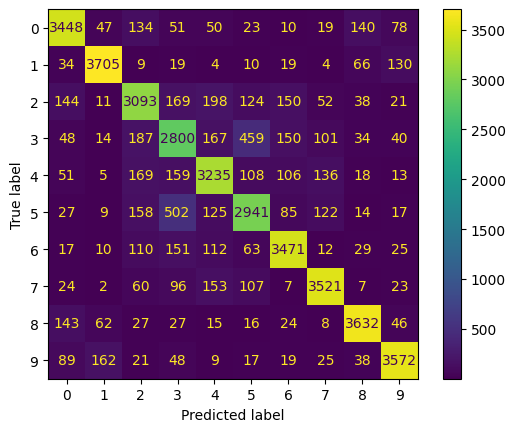

validation...


(Epoch 188 | 79/79) | Data: 0.055s | Batch: 0.075s | Loss: 0.7018| GPU usage: 1.196 GB: 100%|██████████| 79/79 [00:06<00:00, 13.16it/s]


validation loss: 0.70175
validation accuracy: 0.76582
validation precision: 0.76640
validation recall: 0.76640
validation F1-Score: 0.76596
saving with validation loss of 0.7017526030540466
[Epoch: 189 training...]


(Epoch 189 | 313/313) | Data: 0.054s | Batch: 0.094s | Loss: 0.4710 | GPU usage: 1.196 GB: 100%|██████████| 313/313 [00:29<00:00, 10.64it/s]


learning rate is 1e-06
training loss: 0.47126
training accuracy: 0.83615
training precision: 0.83584
training recall: 0.83615
training F1-Score: 0.83596


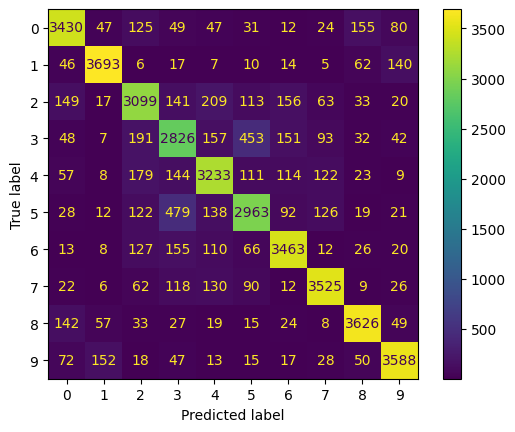

validation...


(Epoch 189 | 79/79) | Data: 0.057s | Batch: 0.076s | Loss: 0.6993| GPU usage: 1.196 GB: 100%|██████████| 79/79 [00:06<00:00, 12.95it/s]


validation loss: 0.69958
validation accuracy: 0.76404
validation precision: 0.76490
validation recall: 0.76490
validation F1-Score: 0.76430
saving with validation loss of 0.6995828747749329
[Epoch: 190 training...]


(Epoch 190 | 313/313) | Data: 0.056s | Batch: 0.098s | Loss: 0.4694 | GPU usage: 1.196 GB: 100%|██████████| 313/313 [00:30<00:00, 10.19it/s]


learning rate is 1e-06
training loss: 0.46913
training accuracy: 0.83578
training precision: 0.83539
training recall: 0.83577
training F1-Score: 0.83555


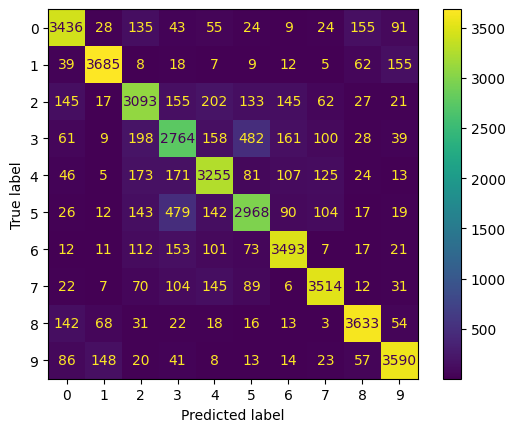

validation...


(Epoch 190 | 79/79) | Data: 0.059s | Batch: 0.082s | Loss: 0.6980| GPU usage: 1.196 GB: 100%|██████████| 79/79 [00:06<00:00, 12.11it/s]


validation loss: 0.69899
validation accuracy: 0.76743
validation precision: 0.76790
validation recall: 0.76790
validation F1-Score: 0.76754
saving with validation loss of 0.6989919543266296
[Epoch: 191 training...]


(Epoch 191 | 313/313) | Data: 0.055s | Batch: 0.093s | Loss: 0.4734 | GPU usage: 1.196 GB: 100%|██████████| 313/313 [00:29<00:00, 10.75it/s]


learning rate is 1e-06
training loss: 0.47336
training accuracy: 0.83688
training precision: 0.83659
training recall: 0.83688
training F1-Score: 0.83669


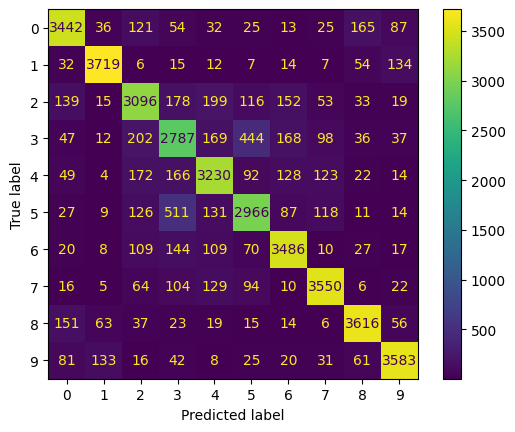

validation...


(Epoch 191 | 79/79) | Data: 0.057s | Batch: 0.078s | Loss: 0.7079| GPU usage: 1.196 GB: 100%|██████████| 79/79 [00:06<00:00, 12.71it/s]


validation loss: 0.70590
validation accuracy: 0.76129
validation precision: 0.76170
validation recall: 0.76170
validation F1-Score: 0.76129
[Epoch: 192 training...]


(Epoch 192 | 313/313) | Data: 0.055s | Batch: 0.096s | Loss: 0.4673 | GPU usage: 1.196 GB: 100%|██████████| 313/313 [00:30<00:00, 10.37it/s]


learning rate is 1e-06
training loss: 0.46791
training accuracy: 0.83770
training precision: 0.83733
training recall: 0.83770
training F1-Score: 0.83747


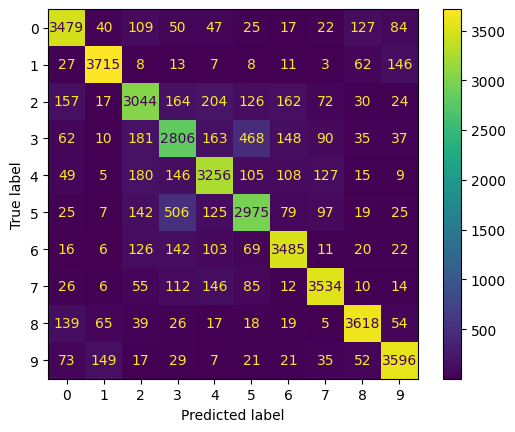

validation...


(Epoch 192 | 79/79) | Data: 0.058s | Batch: 0.081s | Loss: 0.7030| GPU usage: 1.196 GB: 100%|██████████| 79/79 [00:06<00:00, 12.15it/s]


validation loss: 0.70193
validation accuracy: 0.76417
validation precision: 0.76520
validation recall: 0.76520
validation F1-Score: 0.76452
[Epoch: 193 training...]


(Epoch 193 | 313/313) | Data: 0.057s | Batch: 0.091s | Loss: 0.4648 | GPU usage: 1.230 GB: 100%|██████████| 313/313 [00:28<00:00, 10.95it/s]


learning rate is 1e-06
training loss: 0.46480
training accuracy: 0.83850
training precision: 0.83824
training recall: 0.83850
training F1-Score: 0.83831


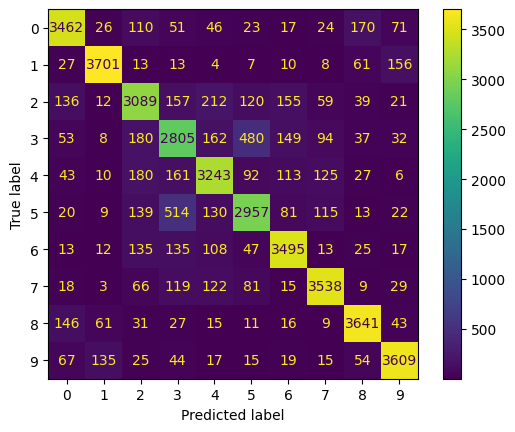

validation...


(Epoch 193 | 79/79) | Data: 0.066s | Batch: 0.081s | Loss: 0.6974| GPU usage: 1.285 GB: 100%|██████████| 79/79 [00:06<00:00, 12.25it/s]


validation loss: 0.69448
validation accuracy: 0.76747
validation precision: 0.76810
validation recall: 0.76810
validation F1-Score: 0.76760
saving with validation loss of 0.6944761276245117
[Epoch: 194 training...]


(Epoch 194 | 313/313) | Data: 0.062s | Batch: 0.090s | Loss: 0.4684 | GPU usage: 1.307 GB: 100%|██████████| 313/313 [00:28<00:00, 11.04it/s]


learning rate is 1e-06
training loss: 0.46851
training accuracy: 0.83832
training precision: 0.83801
training recall: 0.83832
training F1-Score: 0.83812


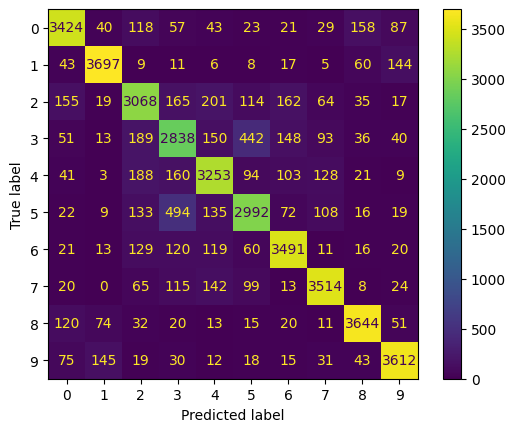

validation...


(Epoch 194 | 79/79) | Data: 0.065s | Batch: 0.082s | Loss: 0.6951| GPU usage: 1.307 GB: 100%|██████████| 79/79 [00:06<00:00, 11.99it/s]


validation loss: 0.69414
validation accuracy: 0.76584
validation precision: 0.76620
validation recall: 0.76620
validation F1-Score: 0.76583
saving with validation loss of 0.6941391229629517
[Epoch: 195 training...]


(Epoch 195 | 313/313) | Data: 0.062s | Batch: 0.095s | Loss: 0.4657 | GPU usage: 1.406 GB: 100%|██████████| 313/313 [00:29<00:00, 10.49it/s]


learning rate is 1e-06
training loss: 0.46594
training accuracy: 0.84022
training precision: 0.83996
training recall: 0.84022
training F1-Score: 0.84003


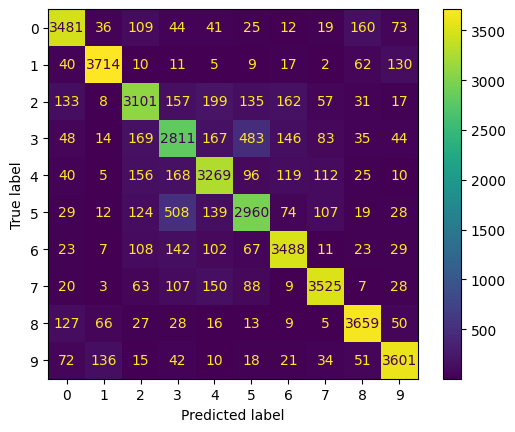

validation...


(Epoch 195 | 79/79) | Data: 0.066s | Batch: 0.084s | Loss: 0.7018| GPU usage: 1.346 GB: 100%|██████████| 79/79 [00:06<00:00, 11.76it/s]


validation loss: 0.70217
validation accuracy: 0.76280
validation precision: 0.76350
validation recall: 0.76350
validation F1-Score: 0.76297
[Epoch: 196 training...]


(Epoch 196 | 313/313) | Data: 0.062s | Batch: 0.099s | Loss: 0.4689 | GPU usage: 1.302 GB: 100%|██████████| 313/313 [00:31<00:00, 10.08it/s]


learning rate is 1e-06
training loss: 0.46867
training accuracy: 0.83605
training precision: 0.83564
training recall: 0.83605
training F1-Score: 0.83579


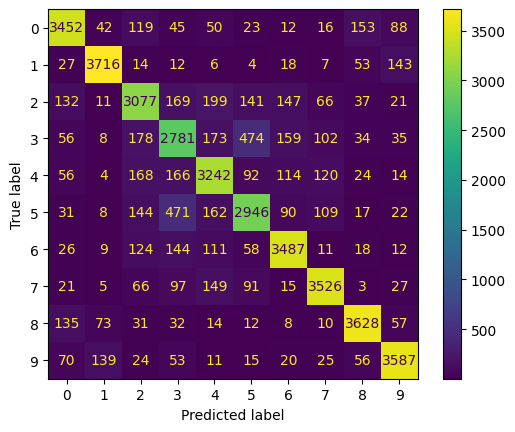

validation...


(Epoch 196 | 79/79) | Data: 0.069s | Batch: 0.094s | Loss: 0.6995| GPU usage: 1.302 GB: 100%|██████████| 79/79 [00:07<00:00, 10.58it/s]


validation loss: 0.69710
validation accuracy: 0.76706
validation precision: 0.76780
validation recall: 0.76780
validation F1-Score: 0.76733
[Epoch: 197 training...]


(Epoch 197 | 313/313) | Data: 0.062s | Batch: 0.102s | Loss: 0.4632 | GPU usage: 1.306 GB: 100%|██████████| 313/313 [00:32<00:00,  9.74it/s]


learning rate is 1e-06
training loss: 0.46314
training accuracy: 0.84065
training precision: 0.84023
training recall: 0.84065
training F1-Score: 0.84039


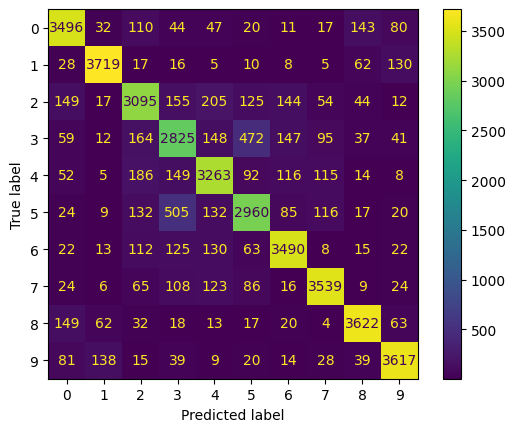

validation...


(Epoch 197 | 79/79) | Data: 0.066s | Batch: 0.092s | Loss: 0.6964| GPU usage: 1.301 GB: 100%|██████████| 79/79 [00:07<00:00, 10.78it/s]


validation loss: 0.69643
validation accuracy: 0.76694
validation precision: 0.76740
validation recall: 0.76740
validation F1-Score: 0.76708
saving with validation loss of 0.6964340806007385
[Epoch: 198 training...]


(Epoch 198 | 313/313) | Data: 0.062s | Batch: 0.104s | Loss: 0.4624 | GPU usage: 1.305 GB: 100%|██████████| 313/313 [00:32<00:00,  9.54it/s]


learning rate is 1e-06
training loss: 0.46255
training accuracy: 0.84010
training precision: 0.83987
training recall: 0.84010
training F1-Score: 0.83996


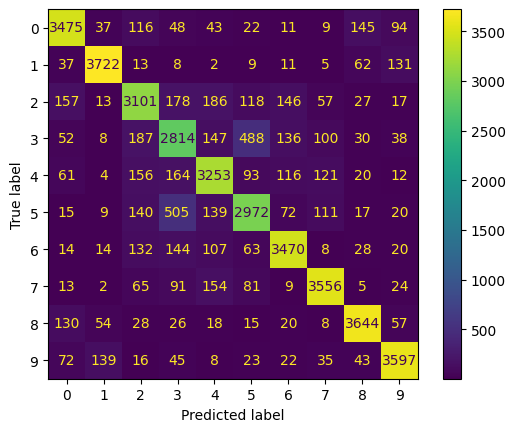

validation...


(Epoch 198 | 79/79) | Data: 0.067s | Batch: 0.088s | Loss: 0.6931| GPU usage: 1.301 GB: 100%|██████████| 79/79 [00:07<00:00, 11.18it/s]


validation loss: 0.69088
validation accuracy: 0.76781
validation precision: 0.76810
validation recall: 0.76810
validation F1-Score: 0.76783
saving with validation loss of 0.6908782720565796
[Epoch: 199 training...]


(Epoch 199 | 313/313) | Data: 0.063s | Batch: 0.106s | Loss: 0.4641 | GPU usage: 1.313 GB: 100%|██████████| 313/313 [00:33<00:00,  9.37it/s]


learning rate is 1e-06
training loss: 0.46388
training accuracy: 0.83957
training precision: 0.83925
training recall: 0.83957
training F1-Score: 0.83937


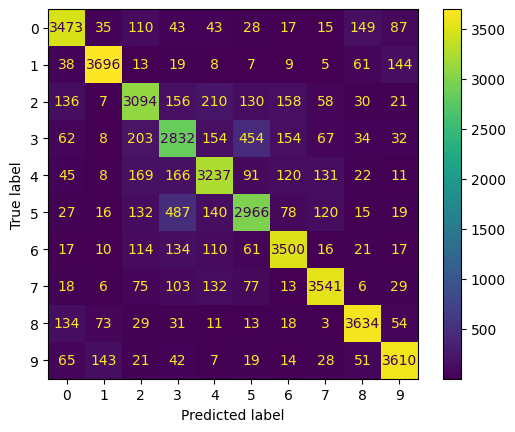

validation...


(Epoch 199 | 79/79) | Data: 0.067s | Batch: 0.092s | Loss: 0.6973| GPU usage: 1.301 GB: 100%|██████████| 79/79 [00:07<00:00, 10.73it/s]


validation loss: 0.69670
validation accuracy: 0.76799
validation precision: 0.76860
validation recall: 0.76860
validation F1-Score: 0.76817
[Epoch: 200 training...]


(Epoch 200 | 313/313) | Data: 0.062s | Batch: 0.103s | Loss: 0.4658 | GPU usage: 1.301 GB: 100%|██████████| 313/313 [00:32<00:00,  9.70it/s]


learning rate is 1e-06
training loss: 0.46574
training accuracy: 0.83942
training precision: 0.83891
training recall: 0.83942
training F1-Score: 0.83915


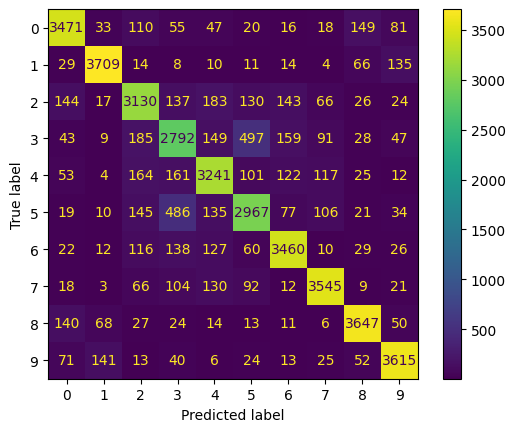

validation...


(Epoch 200 | 79/79) | Data: 0.067s | Batch: 0.090s | Loss: 0.6978| GPU usage: 1.301 GB: 100%|██████████| 79/79 [00:07<00:00, 10.95it/s]


validation loss: 0.69609
validation accuracy: 0.76741
validation precision: 0.76770
validation recall: 0.76770
validation F1-Score: 0.76741
[Epoch: 201 training...]


(Epoch 201 | 313/313) | Data: 0.062s | Batch: 0.099s | Loss: 0.4639 | GPU usage: 1.309 GB: 100%|██████████| 313/313 [00:30<00:00, 10.12it/s]


learning rate is 1e-06
training loss: 0.46389
training accuracy: 0.83975
training precision: 0.83943
training recall: 0.83975
training F1-Score: 0.83956


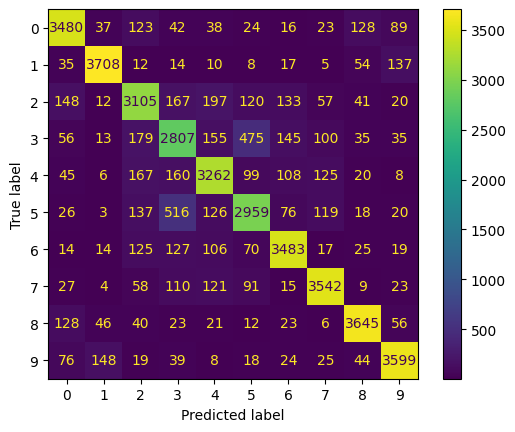

validation...


(Epoch 201 | 79/79) | Data: 0.066s | Batch: 0.087s | Loss: 0.7019| GPU usage: 1.309 GB: 100%|██████████| 79/79 [00:06<00:00, 11.41it/s]


validation loss: 0.70008
validation accuracy: 0.76336
validation precision: 0.76420
validation recall: 0.76420
validation F1-Score: 0.76369
[Epoch: 202 training...]


(Epoch 202 | 313/313) | Data: 0.062s | Batch: 0.096s | Loss: 0.4704 | GPU usage: 1.336 GB: 100%|██████████| 313/313 [00:30<00:00, 10.39it/s]


learning rate is 1e-06
training loss: 0.47042
training accuracy: 0.83835
training precision: 0.83803
training recall: 0.83835
training F1-Score: 0.83815


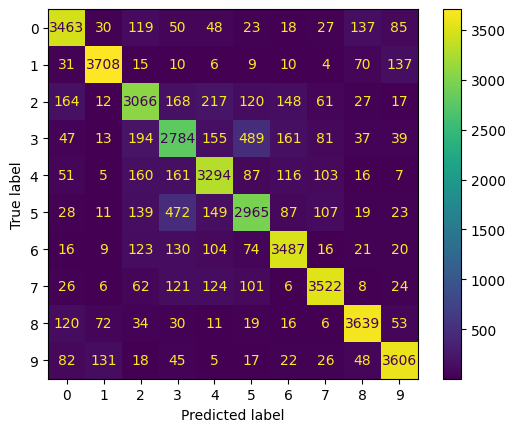

validation...


(Epoch 202 | 79/79) | Data: 0.064s | Batch: 0.081s | Loss: 0.7011| GPU usage: 1.316 GB: 100%|██████████| 79/79 [00:06<00:00, 12.28it/s]


validation loss: 0.70097
validation accuracy: 0.76917
validation precision: 0.76940
validation recall: 0.76940
validation F1-Score: 0.76912
[Epoch: 203 training...]


(Epoch 203 | 313/313) | Data: 0.062s | Batch: 0.100s | Loss: 0.4675 | GPU usage: 1.310 GB: 100%|██████████| 313/313 [00:31<00:00,  9.97it/s]


learning rate is 1e-06
training loss: 0.46738
training accuracy: 0.83860
training precision: 0.83812
training recall: 0.83860
training F1-Score: 0.83831


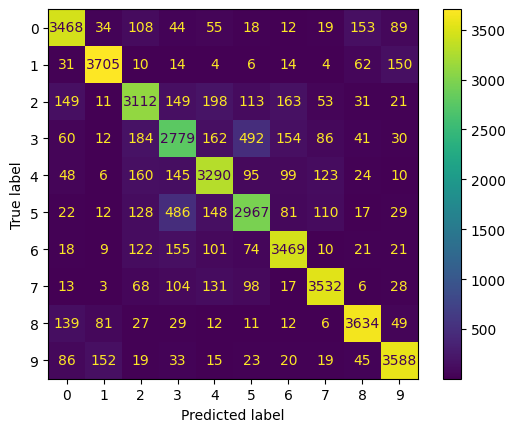

validation...


(Epoch 203 | 79/79) | Data: 0.066s | Batch: 0.088s | Loss: 0.7078| GPU usage: 1.310 GB: 100%|██████████| 79/79 [00:07<00:00, 11.18it/s]


validation loss: 0.70795
validation accuracy: 0.76358
validation precision: 0.76410
validation recall: 0.76410
validation F1-Score: 0.76370
[Epoch: 204 training...]


(Epoch 204 | 313/313) | Data: 0.058s | Batch: 0.104s | Loss: 0.4636 | GPU usage: 1.306 GB: 100%|██████████| 313/313 [00:32<00:00,  9.55it/s]


learning rate is 1e-06
training loss: 0.46318
training accuracy: 0.84022
training precision: 0.84018
training recall: 0.84022
training F1-Score: 0.84015


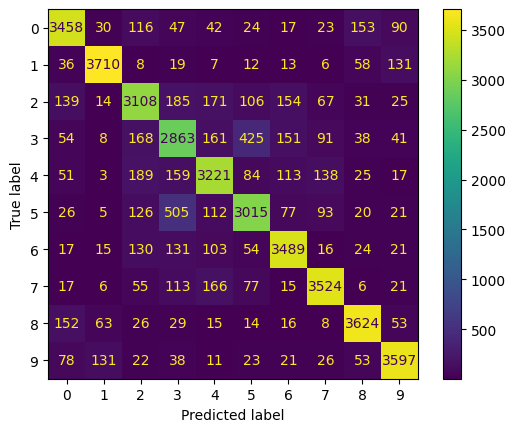

validation...


(Epoch 204 | 79/79) | Data: 0.060s | Batch: 0.079s | Loss: 0.7008| GPU usage: 1.306 GB: 100%|██████████| 79/79 [00:06<00:00, 12.48it/s]


validation loss: 0.69905
validation accuracy: 0.76545
validation precision: 0.76620
validation recall: 0.76620
validation F1-Score: 0.76569
[Epoch: 205 training...]


(Epoch 205 | 313/313) | Data: 0.055s | Batch: 0.091s | Loss: 0.4637 | GPU usage: 1.306 GB: 100%|██████████| 313/313 [00:28<00:00, 10.95it/s]


learning rate is 1e-06
training loss: 0.46346
training accuracy: 0.84057
training precision: 0.84029
training recall: 0.84058
training F1-Score: 0.84039


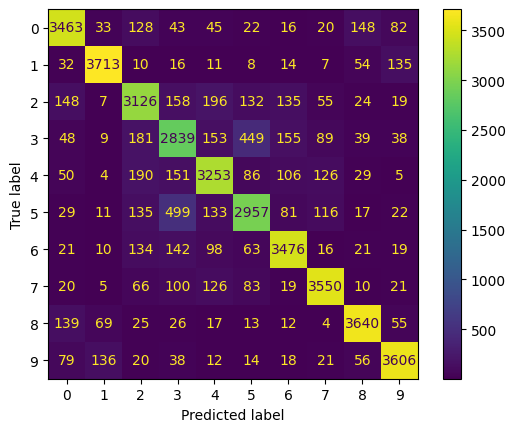

validation...


(Epoch 205 | 79/79) | Data: 0.059s | Batch: 0.080s | Loss: 0.7059| GPU usage: 1.306 GB: 100%|██████████| 79/79 [00:06<00:00, 12.28it/s]


validation loss: 0.70394
validation accuracy: 0.76031
validation precision: 0.76140
validation recall: 0.76140
validation F1-Score: 0.76073
[Epoch: 206 training...]


(Epoch 206 | 313/313) | Data: 0.054s | Batch: 0.092s | Loss: 0.4702 | GPU usage: 1.306 GB: 100%|██████████| 313/313 [00:28<00:00, 10.83it/s]


learning rate is 1e-06
training loss: 0.46994
training accuracy: 0.83762
training precision: 0.83758
training recall: 0.83763
training F1-Score: 0.83756


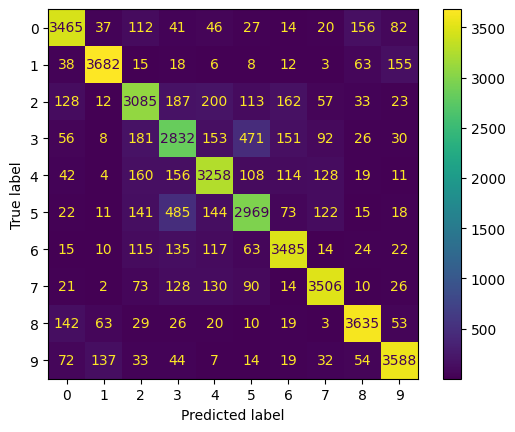

validation...


(Epoch 206 | 79/79) | Data: 0.058s | Batch: 0.081s | Loss: 0.6949| GPU usage: 1.306 GB: 100%|██████████| 79/79 [00:06<00:00, 12.13it/s]


validation loss: 0.69276
validation accuracy: 0.76580
validation precision: 0.76690
validation recall: 0.76690
validation F1-Score: 0.76615
saving with validation loss of 0.692760705947876
[Epoch: 207 training...]


(Epoch 207 | 313/313) | Data: 0.056s | Batch: 0.103s | Loss: 0.4672 | GPU usage: 1.306 GB: 100%|██████████| 313/313 [00:32<00:00,  9.70it/s]


learning rate is 1e-06
training loss: 0.46717
training accuracy: 0.83918
training precision: 0.83876
training recall: 0.83918
training F1-Score: 0.83892


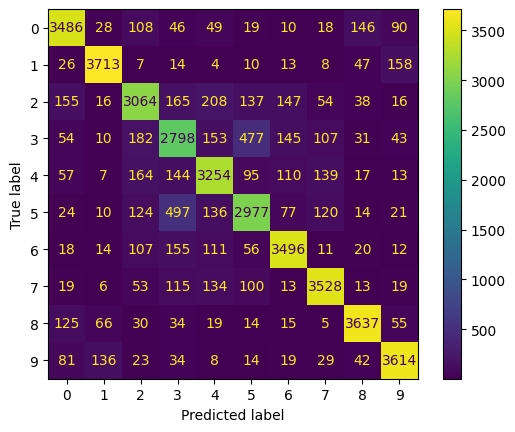

validation...


(Epoch 207 | 79/79) | Data: 0.059s | Batch: 0.079s | Loss: 0.6969| GPU usage: 1.306 GB: 100%|██████████| 79/79 [00:06<00:00, 12.43it/s]


validation loss: 0.69537
validation accuracy: 0.76688
validation precision: 0.76740
validation recall: 0.76740
validation F1-Score: 0.76706
saving with validation loss of 0.6953717470169067
[Epoch: 208 training...]


(Epoch 208 | 313/313) | Data: 0.054s | Batch: 0.091s | Loss: 0.4676 | GPU usage: 1.306 GB: 100%|██████████| 313/313 [00:28<00:00, 10.98it/s]


learning rate is 1e-06
training loss: 0.46754
training accuracy: 0.83995
training precision: 0.83972
training recall: 0.83995
training F1-Score: 0.83979


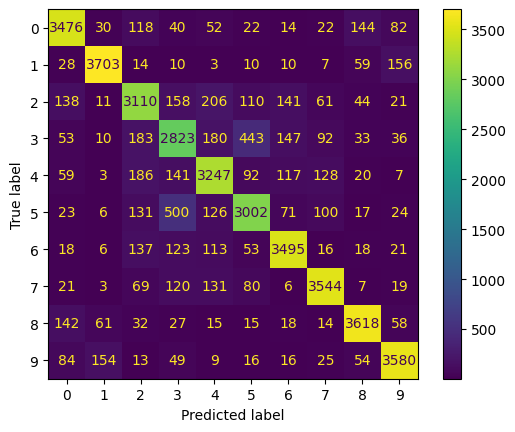

validation...


(Epoch 208 | 79/79) | Data: 0.061s | Batch: 0.085s | Loss: 0.7048| GPU usage: 1.306 GB: 100%|██████████| 79/79 [00:06<00:00, 11.56it/s]


validation loss: 0.70380
validation accuracy: 0.76670
validation precision: 0.76690
validation recall: 0.76690
validation F1-Score: 0.76665
[Epoch: 209 training...]


(Epoch 209 | 313/313) | Data: 0.055s | Batch: 0.096s | Loss: 0.4645 | GPU usage: 1.306 GB: 100%|██████████| 313/313 [00:30<00:00, 10.39it/s]


learning rate is 1e-06
training loss: 0.46450
training accuracy: 0.83908
training precision: 0.83875
training recall: 0.83908
training F1-Score: 0.83888


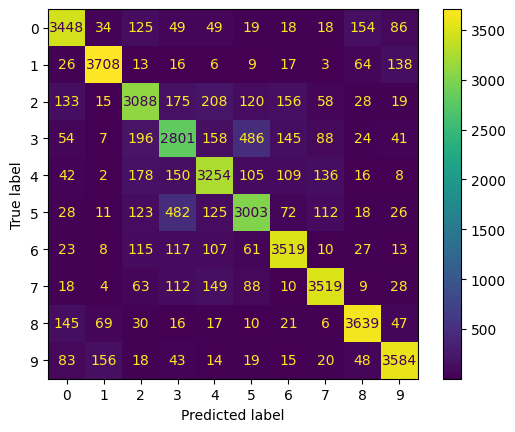

validation...


(Epoch 209 | 79/79) | Data: 0.060s | Batch: 0.081s | Loss: 0.7080| GPU usage: 1.306 GB: 100%|██████████| 79/79 [00:06<00:00, 12.19it/s]


validation loss: 0.70759
validation accuracy: 0.76480
validation precision: 0.76570
validation recall: 0.76570
validation F1-Score: 0.76513
[Epoch: 210 training...]


(Epoch 210 | 313/313) | Data: 0.054s | Batch: 0.091s | Loss: 0.4660 | GPU usage: 1.306 GB: 100%|██████████| 313/313 [00:28<00:00, 11.01it/s]


learning rate is 1e-06
training loss: 0.46576
training accuracy: 0.83865
training precision: 0.83834
training recall: 0.83865
training F1-Score: 0.83847


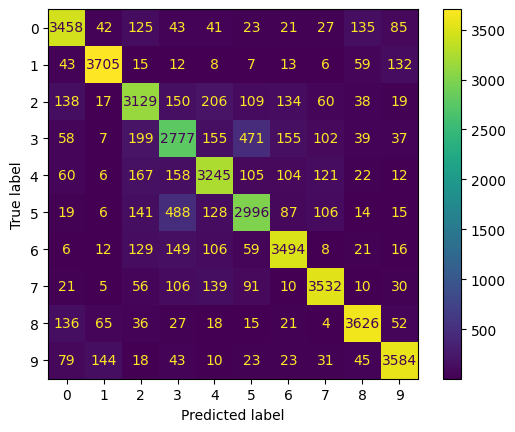

validation...


(Epoch 210 | 79/79) | Data: 0.060s | Batch: 0.084s | Loss: 0.6936| GPU usage: 1.306 GB: 100%|██████████| 79/79 [00:06<00:00, 11.76it/s]


validation loss: 0.69296
validation accuracy: 0.76916
validation precision: 0.76960
validation recall: 0.76960
validation F1-Score: 0.76926
saving with validation loss of 0.6929575204849243
[Epoch: 211 training...]


(Epoch 211 | 313/313) | Data: 0.056s | Batch: 0.099s | Loss: 0.4687 | GPU usage: 1.306 GB: 100%|██████████| 313/313 [00:31<00:00, 10.09it/s]


learning rate is 1e-06
training loss: 0.46885
training accuracy: 0.83855
training precision: 0.83833
training recall: 0.83855
training F1-Score: 0.83839


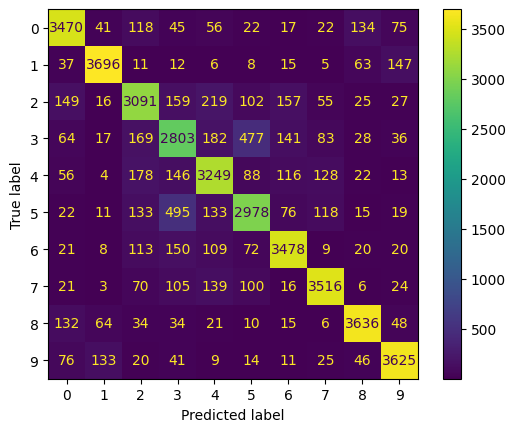

validation...


(Epoch 211 | 79/79) | Data: 0.061s | Batch: 0.080s | Loss: 0.7045| GPU usage: 1.306 GB: 100%|██████████| 79/79 [00:06<00:00, 12.32it/s]


validation loss: 0.70316
validation accuracy: 0.76413
validation precision: 0.76490
validation recall: 0.76490
validation F1-Score: 0.76435
[Epoch: 212 training...]


(Epoch 212 | 313/313) | Data: 0.061s | Batch: 0.109s | Loss: 0.4720 | GPU usage: 1.306 GB: 100%|██████████| 313/313 [00:34<00:00,  9.18it/s]


learning rate is 1e-06
training loss: 0.47205
training accuracy: 0.83585
training precision: 0.83560
training recall: 0.83585
training F1-Score: 0.83570


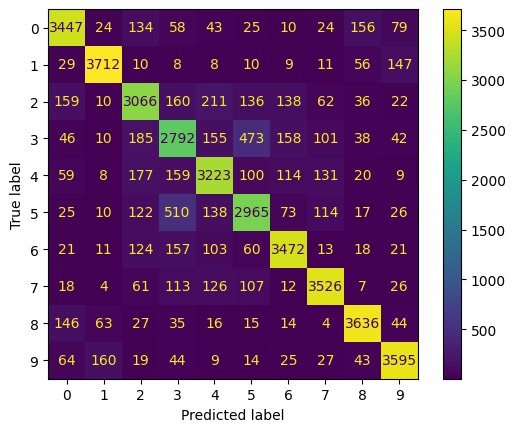

validation...


(Epoch 212 | 79/79) | Data: 0.061s | Batch: 0.081s | Loss: 0.7041| GPU usage: 1.306 GB: 100%|██████████| 79/79 [00:06<00:00, 12.26it/s]


validation loss: 0.70527
validation accuracy: 0.76124
validation precision: 0.76170
validation recall: 0.76170
validation F1-Score: 0.76129
[Epoch: 213 training...]


(Epoch 213 | 313/313) | Data: 0.057s | Batch: 0.096s | Loss: 0.4666 | GPU usage: 1.306 GB: 100%|██████████| 313/313 [00:30<00:00, 10.43it/s]


learning rate is 1e-06
training loss: 0.46651
training accuracy: 0.83910
training precision: 0.83883
training recall: 0.83910
training F1-Score: 0.83892


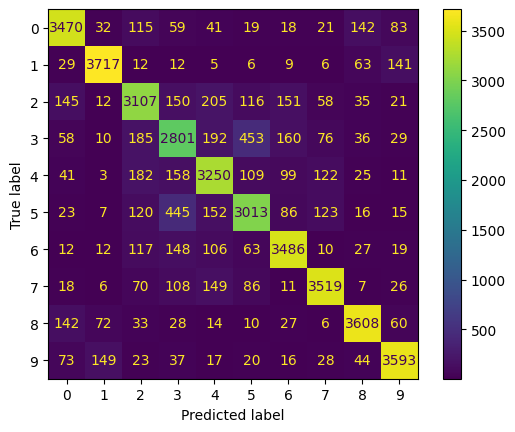

validation...


(Epoch 213 | 79/79) | Data: 0.060s | Batch: 0.080s | Loss: 0.6917| GPU usage: 1.306 GB: 100%|██████████| 79/79 [00:06<00:00, 12.31it/s]


validation loss: 0.69200
validation accuracy: 0.76665
validation precision: 0.76700
validation recall: 0.76700
validation F1-Score: 0.76664
saving with validation loss of 0.6919975876808167
[Epoch: 214 training...]


(Epoch 214 | 313/313) | Data: 0.055s | Batch: 0.093s | Loss: 0.4690 | GPU usage: 1.306 GB: 100%|██████████| 313/313 [00:29<00:00, 10.68it/s]


learning rate is 1e-06
training loss: 0.46898
training accuracy: 0.83803
training precision: 0.83769
training recall: 0.83803
training F1-Score: 0.83783


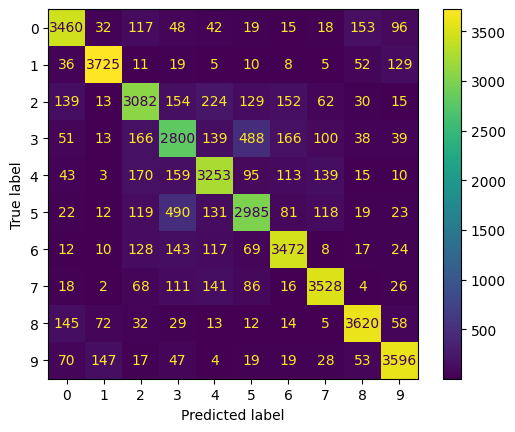

validation...


(Epoch 214 | 79/79) | Data: 0.057s | Batch: 0.078s | Loss: 0.7007| GPU usage: 1.306 GB: 100%|██████████| 79/79 [00:06<00:00, 12.69it/s]


validation loss: 0.70069
validation accuracy: 0.76727
validation precision: 0.76800
validation recall: 0.76800
validation F1-Score: 0.76742
[Epoch: 215 training...]


(Epoch 215 | 313/313) | Data: 0.053s | Batch: 0.086s | Loss: 0.4724 | GPU usage: 1.306 GB: 100%|██████████| 313/313 [00:26<00:00, 11.61it/s]


learning rate is 1e-06
training loss: 0.47241
training accuracy: 0.83735
training precision: 0.83696
training recall: 0.83735
training F1-Score: 0.83708


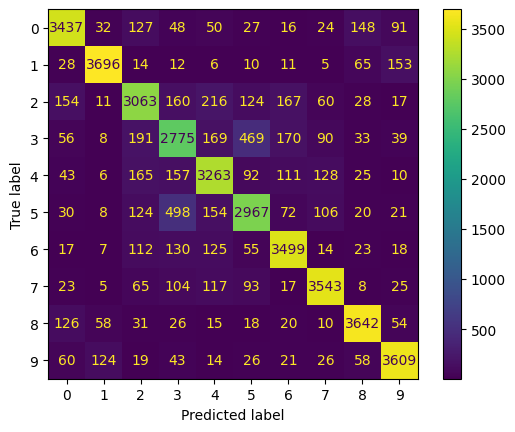

validation...


(Epoch 215 | 79/79) | Data: 0.058s | Batch: 0.081s | Loss: 0.7055| GPU usage: 1.306 GB: 100%|██████████| 79/79 [00:06<00:00, 12.21it/s]


validation loss: 0.70499
validation accuracy: 0.76566
validation precision: 0.76620
validation recall: 0.76620
validation F1-Score: 0.76576
[Epoch: 216 training...]


(Epoch 216 | 313/313) | Data: 0.054s | Batch: 0.089s | Loss: 0.4735 | GPU usage: 1.306 GB: 100%|██████████| 313/313 [00:27<00:00, 11.19it/s]


learning rate is 1e-06
training loss: 0.47372
training accuracy: 0.83652
training precision: 0.83609
training recall: 0.83652
training F1-Score: 0.83627


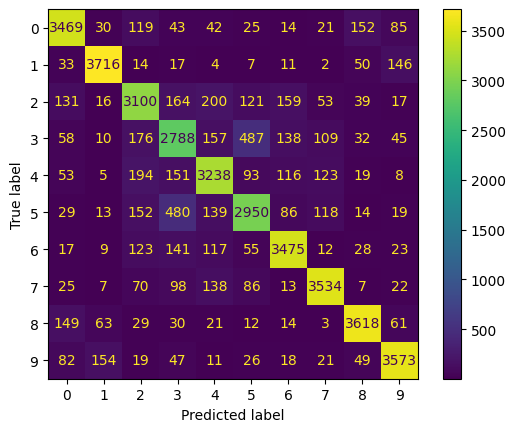

validation...


(Epoch 216 | 79/79) | Data: 0.056s | Batch: 0.072s | Loss: 0.6915| GPU usage: 1.306 GB: 100%|██████████| 79/79 [00:05<00:00, 13.72it/s]


validation loss: 0.68928
validation accuracy: 0.76986
validation precision: 0.77030
validation recall: 0.77030
validation F1-Score: 0.76998
saving with validation loss of 0.6892757415771484
[Epoch: 217 training...]


(Epoch 217 | 313/313) | Data: 0.054s | Batch: 0.092s | Loss: 0.4756 | GPU usage: 1.306 GB: 100%|██████████| 313/313 [00:28<00:00, 10.87it/s]


learning rate is 1e-06
training loss: 0.47553
training accuracy: 0.83532
training precision: 0.83516
training recall: 0.83532
training F1-Score: 0.83520


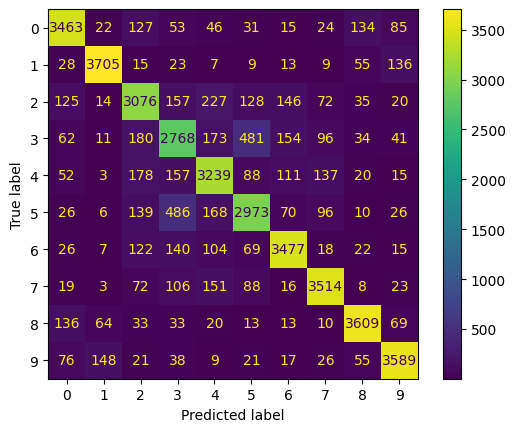

validation...


(Epoch 217 | 79/79) | Data: 0.058s | Batch: 0.080s | Loss: 0.6964| GPU usage: 1.306 GB: 100%|██████████| 79/79 [00:06<00:00, 12.39it/s]


validation loss: 0.69522
validation accuracy: 0.76655
validation precision: 0.76700
validation recall: 0.76700
validation F1-Score: 0.76664
[Epoch: 218 training...]


(Epoch 218 | 313/313) | Data: 0.055s | Batch: 0.096s | Loss: 0.4718 | GPU usage: 1.306 GB: 100%|██████████| 313/313 [00:30<00:00, 10.43it/s]


learning rate is 1e-06
training loss: 0.47180
training accuracy: 0.83700
training precision: 0.83680
training recall: 0.83700
training F1-Score: 0.83687


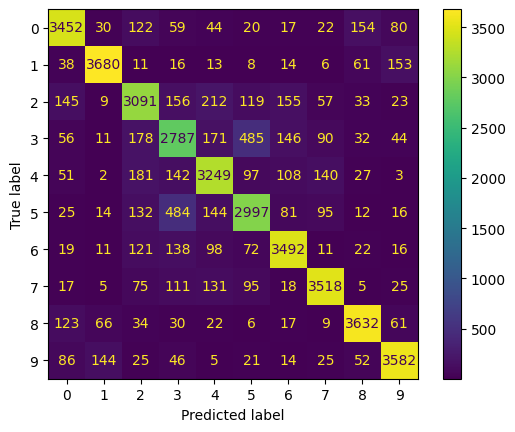

validation...


(Epoch 218 | 79/79) | Data: 0.060s | Batch: 0.080s | Loss: 0.6976| GPU usage: 1.306 GB: 100%|██████████| 79/79 [00:06<00:00, 12.27it/s]


validation loss: 0.69686
validation accuracy: 0.76339
validation precision: 0.76440
validation recall: 0.76440
validation F1-Score: 0.76369
[Epoch: 219 training...]


(Epoch 219 | 313/313) | Data: 0.055s | Batch: 0.091s | Loss: 0.4762 | GPU usage: 1.306 GB: 100%|██████████| 313/313 [00:28<00:00, 10.94it/s]


learning rate is 1e-06
training loss: 0.47601
training accuracy: 0.83530
training precision: 0.83497
training recall: 0.83530
training F1-Score: 0.83509


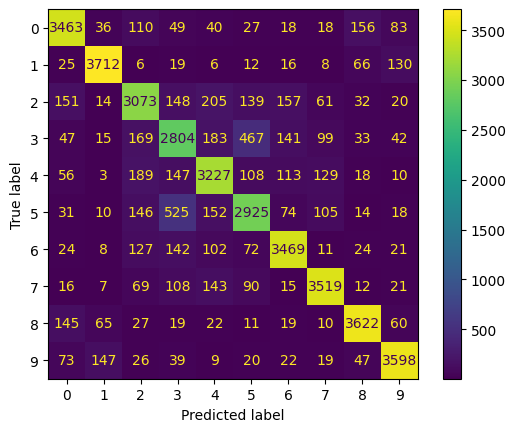

validation...


(Epoch 219 | 79/79) | Data: 0.061s | Batch: 0.084s | Loss: 0.6978| GPU usage: 1.306 GB: 100%|██████████| 79/79 [00:06<00:00, 11.79it/s]


validation loss: 0.69744
validation accuracy: 0.76696
validation precision: 0.76770
validation recall: 0.76770
validation F1-Score: 0.76717
[Epoch: 220 training...]


(Epoch 220 | 313/313) | Data: 0.055s | Batch: 0.096s | Loss: 0.4741 | GPU usage: 1.306 GB: 100%|██████████| 313/313 [00:30<00:00, 10.41it/s]


learning rate is 1e-06
training loss: 0.47386
training accuracy: 0.83532
training precision: 0.83498
training recall: 0.83532
training F1-Score: 0.83513


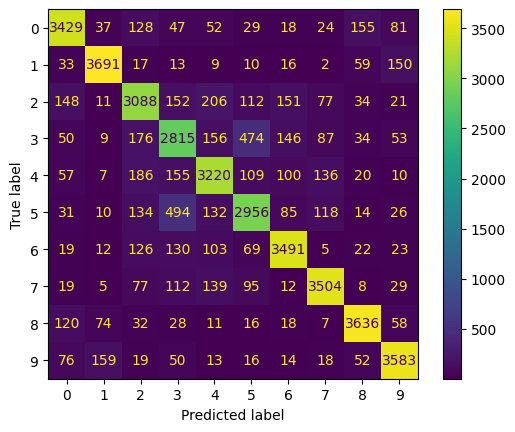

validation...


(Epoch 220 | 79/79) | Data: 0.059s | Batch: 0.079s | Loss: 0.7001| GPU usage: 1.306 GB: 100%|██████████| 79/79 [00:06<00:00, 12.43it/s]


validation loss: 0.69994
validation accuracy: 0.76595
validation precision: 0.76670
validation recall: 0.76670
validation F1-Score: 0.76617


In [31]:
training_funcs.train_model(model, train_loader, num_epochs, writer_train, writer_val, device, val_loader, optimizer, criterion, num_classes, scheduler, training_des, lr, model_name, save_dir, grad_accum, start_epoch, min_loss_diff, min_loss_mean, scaler)

Lets now Train a pretrained Resnet50 model from timm (Hugging-Face) (Transfer Learning) 

In [45]:
utils.seed_everything(420)  # seed random number generator (To make everything deterministic/reproducible)
device = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')
# device = 'cpu'
print(device)

#Transforms
transform_train= transforms.Compose([
    transforms.ToTensor(),
    transforms.RandomHorizontalFlip(p=0.5),
    transforms.Normalize(mean=(0.4913997551666284, 0.48215855929893703, 0.4465309133731618),std=(0.24703225141799082, 0.24348516474564, 0.26158783926049628)),
])

transform_val = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize(mean=(0.4913997551666284, 0.48215855929893703, 0.4465309133731618),std=(0.24703225141799082, 0.24348516474564, 0.26158783926049628)),
])

#Data Preparation

#Basic setup


root=r"C:\Users\satya\Downloads\Cifar10"

cifar10_train = datasets.CIFAR10(root=root, train=True, download=True, transform=transform_train)
# Extract digit classes (0-9)
digit_classes = [0, 1, 2, 3, 4, 5, 6, 7, 8, 9]
train_ratio = 0.8
# Create subsets for digits
train_indices = [i for i, (_, label) in enumerate(cifar10_train) if label in digit_classes]
train_labels = [cifar10_train.targets[i] for i in train_indices]

# Perform stratified split into train and validation sets
train_indices, val_indices = train_test_split(
    train_indices,
    train_size=train_ratio,
    stratify=train_labels,
    random_state=42
)

print(f'Train data: {len(train_indices)}, Val data: {len(val_indices)}')


#Model selection and parameters

model_name = 'resnet_50'
num_classes = 10

model = timm.create_model('resnet50', num_classes=num_classes, pretrained=True)
# model= nn.DataParallel(model)

model=model.to(device)
for params in model.parameters():
    params.requires_grad = True

print(f'Model Name : ',model_name)
print(f"Total number of trainable parameters in model {sum(p.numel() for p in model.parameters() if p.requires_grad is True)}")

#Hyperparameters

batch_size = 128
# lr = 0.0001
lr = 4e-4
num_epochs = 50
grad_accum = 1

#Loss Function
criterion = nn.CrossEntropyLoss().to(device=device)
#Optimizer
optimizer = timm.optim.AdamW(model.parameters(), lr = lr)
#Scheduler
scheduler = timm.scheduler.CosineLRScheduler(optimizer, t_initial = num_epochs, lr_min = 1e-6)
#scaler
scaler = torch.amp.GradScaler()

#Data and paths set up
train_subset = Subset(cifar10_train, train_indices)
val_subset = Subset(cifar10_train, val_indices)

# Create DataLoaders
train_loader = DataLoader(train_subset, batch_size=batch_size, shuffle=True)
val_loader = DataLoader(val_subset, batch_size=batch_size, shuffle=False)

base_path = Path(r"C:\Users\satya\Downloads\Runs")
iteration='1'


#Model details and tensorboard
training_des = 'with_overlay'

tb_path = f'Iteration_{iteration}_{model_name}'

tensorboard_log_dir = base_path / 'tensorboard_logs'
tensorboard_log_dir.mkdir(parents=True, exist_ok=True)  # Creates the directory if it doesn't exist

# Create TensorBoard writers
writer_train = SummaryWriter(tensorboard_log_dir / f'{tb_path}_train')
writer_val = SummaryWriter(tensorboard_log_dir / f'{tb_path}_val')

if not os.path.exists(os.path.join(base_path, 'tensorboard_logs')):
    os.mkdir(os.path.join(base_path, 'tensorboard_logs'))

#Model saving path
save_dir = os.path.join(base_path,'training_weights')
if not os.path.exists(save_dir):
    os.mkdir(save_dir)

resume = False 
resume_checkpoint = None
##Ensure the base_path for checkpoint. This is to ensure the tensorboard logs are correct
if resume:
    assert os.path.isfile(resume_checkpoint), 'The path does not exist'
    checkpoint = torch.load(resume_checkpoint)
    model.load_state_dict(checkpoint['model_state_dict'])
    optimizer.load_state_dict(checkpoint['opt_state_dict'])
    scaler.load_state_dict(checkpoint['scalar_state'])
    scheduler.load_state_dict(checkpoint['scheduler_state'])
    start_epoch = checkpoint['epoch'] + 1
    min_loss_diff = checkpoint['min_loss_diff']
    min_loss_mean = checkpoint['min_loss_mean']

else:
    start_epoch = 0
    min_loss_diff = 1000
    min_loss_mean = 1000
    

cuda:0
Files already downloaded and verified
Train data: 40000, Val data: 10000
Model Name :  resnet_50
Total number of trainable parameters in model 23528522


[Epoch: 1 training...]


(Epoch 1 | 313/313) | Data: 0.050s | Batch: 0.098s | Loss: 1.4710 | GPU usage: 1.565 GB: 100%|██████████| 313/313 [00:30<00:00, 10.14it/s]


learning rate is 0.0004
training loss: 1.47011
training accuracy: 0.50075
training precision: 0.50506
training recall: 0.50075
training F1-Score: 0.50029


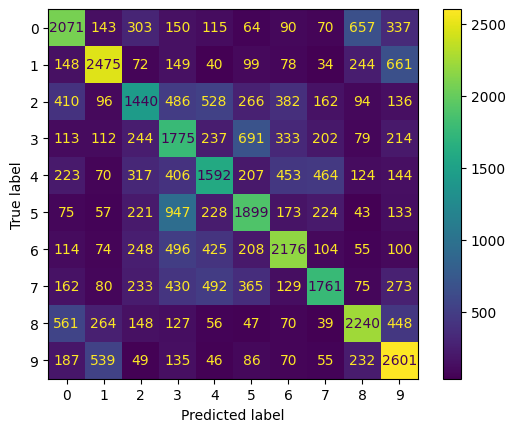

validation...


(Epoch 1 | 79/79) | Data: 0.052s | Batch: 0.078s | Loss: 0.9428| GPU usage: 1.565 GB: 100%|██████████| 79/79 [00:06<00:00, 12.72it/s]


validation loss: 0.94423
validation accuracy: 0.68170
validation precision: 0.67530
validation recall: 0.67530
validation F1-Score: 0.67684
[Epoch: 2 training...]


(Epoch 2 | 313/313) | Data: 0.050s | Batch: 0.099s | Loss: 0.7294 | GPU usage: 1.663 GB: 100%|██████████| 313/313 [00:31<00:00, 10.09it/s]


learning rate is 0.0003996063323214402
training loss: 0.72951
training accuracy: 0.75080
training precision: 0.75067
training recall: 0.75080
training F1-Score: 0.75059


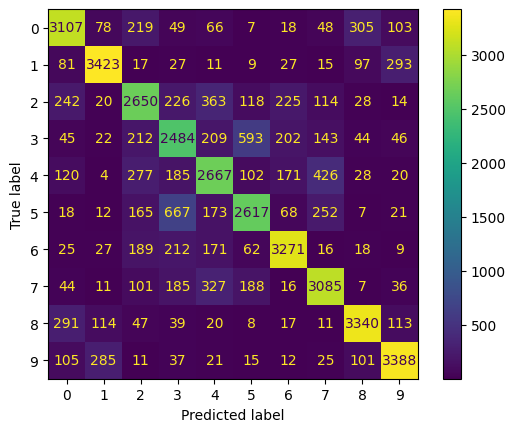

validation...


(Epoch 2 | 79/79) | Data: 0.052s | Batch: 0.077s | Loss: 0.6508| GPU usage: 1.663 GB: 100%|██████████| 79/79 [00:06<00:00, 12.94it/s]


validation loss: 0.64975
validation accuracy: 0.77557
validation precision: 0.77470
validation recall: 0.77470
validation F1-Score: 0.77422
[Epoch: 3 training...]


(Epoch 3 | 313/313) | Data: 0.050s | Batch: 0.098s | Loss: 0.5187 | GPU usage: 1.663 GB: 100%|██████████| 313/313 [00:30<00:00, 10.18it/s]


learning rate is 0.0003984268829122384
training loss: 0.51876
training accuracy: 0.82247
training precision: 0.82220
training recall: 0.82248
training F1-Score: 0.82227


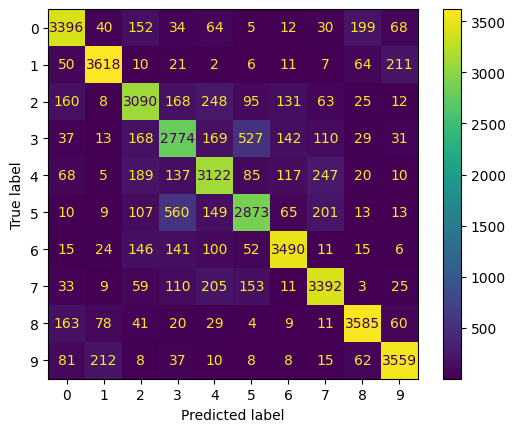

validation...


(Epoch 3 | 79/79) | Data: 0.060s | Batch: 0.089s | Loss: 0.6041| GPU usage: 1.663 GB: 100%|██████████| 79/79 [00:07<00:00, 11.15it/s]


validation loss: 0.60259
validation accuracy: 0.80221
validation precision: 0.79870
validation recall: 0.79870
validation F1-Score: 0.79896
[Epoch: 4 training...]


(Epoch 4 | 313/313) | Data: 0.057s | Batch: 0.113s | Loss: 0.3904 | GPU usage: 1.663 GB: 100%|██████████| 313/313 [00:35<00:00,  8.84it/s]


learning rate is 0.0003964663065203734
training loss: 0.39073
training accuracy: 0.86703
training precision: 0.86700
training recall: 0.86702
training F1-Score: 0.86694


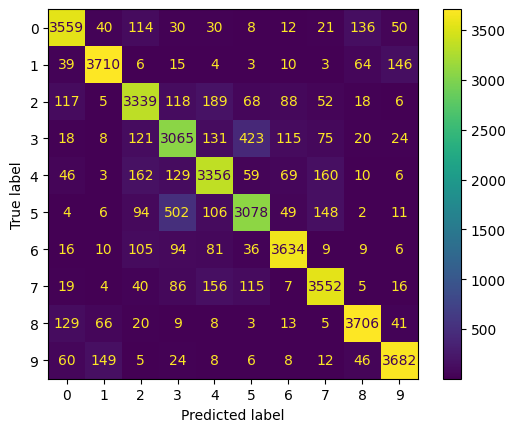

validation...


(Epoch 4 | 79/79) | Data: 0.051s | Batch: 0.078s | Loss: 0.5531| GPU usage: 1.663 GB: 100%|██████████| 79/79 [00:06<00:00, 12.77it/s]


validation loss: 0.55694
validation accuracy: 0.81874
validation precision: 0.81470
validation recall: 0.81470
validation F1-Score: 0.81489
[Epoch: 5 training...]


(Epoch 5 | 313/313) | Data: 0.057s | Batch: 0.113s | Loss: 0.3067 | GPU usage: 1.720 GB: 100%|██████████| 313/313 [00:35<00:00,  8.81it/s]


learning rate is 0.0003937323406451619
training loss: 0.30668
training accuracy: 0.89635
training precision: 0.89628
training recall: 0.89635
training F1-Score: 0.89627


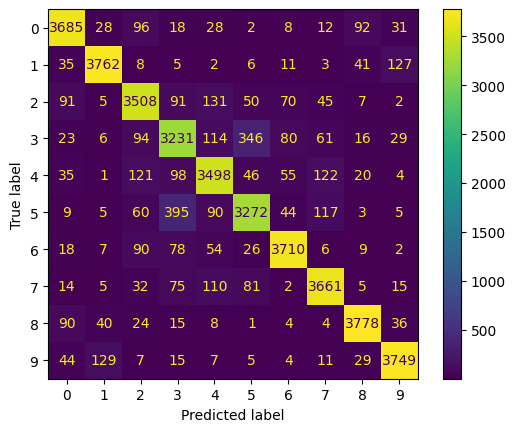

validation...


(Epoch 5 | 79/79) | Data: 0.062s | Batch: 0.089s | Loss: 0.5912| GPU usage: 1.794 GB: 100%|██████████| 79/79 [00:07<00:00, 11.22it/s]


validation loss: 0.58992
validation accuracy: 0.81251
validation precision: 0.81260
validation recall: 0.81260
validation F1-Score: 0.81043
[Epoch: 6 training...]


(Epoch 6 | 313/313) | Data: 0.059s | Batch: 0.117s | Loss: 0.2386 | GPU usage: 1.748 GB: 100%|██████████| 313/313 [00:36<00:00,  8.53it/s]


learning rate is 0.0003902357750008832
training loss: 0.23858
training accuracy: 0.91930
training precision: 0.91927
training recall: 0.91930
training F1-Score: 0.91926


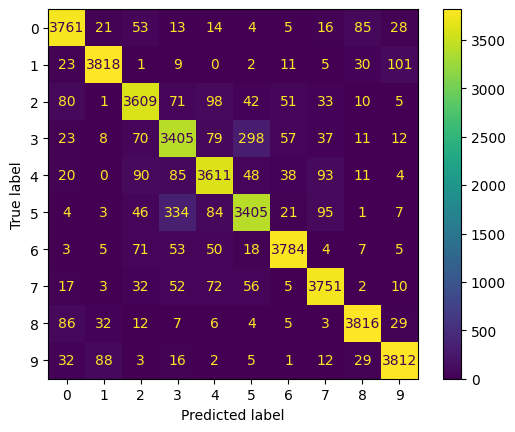

validation...


(Epoch 6 | 79/79) | Data: 0.060s | Batch: 0.090s | Loss: 0.8252| GPU usage: 1.783 GB: 100%|██████████| 79/79 [00:07<00:00, 11.07it/s]


validation loss: 0.86510
validation accuracy: 0.81734
validation precision: 0.81710
validation recall: 0.81710
validation F1-Score: 0.81669
saving with validation loss of 0.8651021718978882
[Epoch: 7 training...]


(Epoch 7 | 313/313) | Data: 0.058s | Batch: 0.117s | Loss: 0.1939 | GPU usage: 1.772 GB: 100%|██████████| 313/313 [00:36<00:00,  8.55it/s]


learning rate is 0.00038599040893470615
training loss: 0.19389
training accuracy: 0.93435
training precision: 0.93433
training recall: 0.93435
training F1-Score: 0.93433


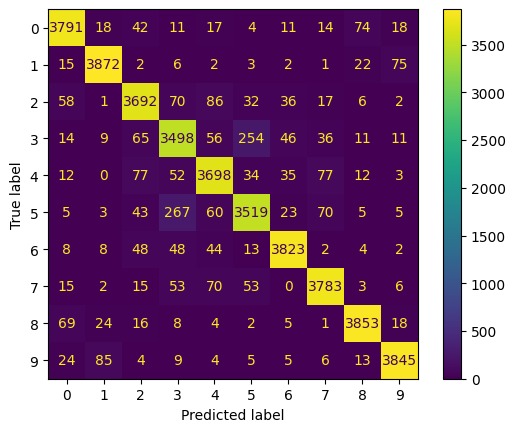

validation...


(Epoch 7 | 79/79) | Data: 0.059s | Batch: 0.089s | Loss: 0.7711| GPU usage: 1.772 GB: 100%|██████████| 79/79 [00:07<00:00, 11.22it/s]


validation loss: 0.76922
validation accuracy: 0.83365
validation precision: 0.82910
validation recall: 0.82910
validation F1-Score: 0.83022
saving with validation loss of 0.7692211866378784
[Epoch: 8 training...]


(Epoch 8 | 313/313) | Data: 0.054s | Batch: 0.109s | Loss: 0.1547 | GPU usage: 1.772 GB: 100%|██████████| 313/313 [00:34<00:00,  9.18it/s]


learning rate is 0.0003810129969669709
training loss: 0.15480
training accuracy: 0.94855
training precision: 0.94854
training recall: 0.94855
training F1-Score: 0.94853


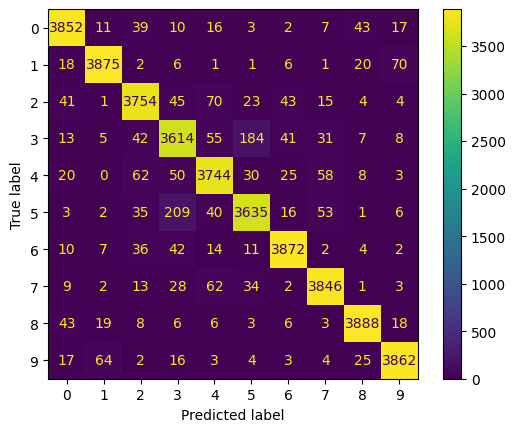

validation...


(Epoch 8 | 79/79) | Data: 0.061s | Batch: 0.088s | Loss: 0.6104| GPU usage: 1.772 GB: 100%|██████████| 79/79 [00:07<00:00, 11.24it/s]


validation loss: 0.61061
validation accuracy: 0.84009
validation precision: 0.82870
validation recall: 0.82870
validation F1-Score: 0.83094
saving with validation loss of 0.6106071472167969
[Epoch: 9 training...]


(Epoch 9 | 313/313) | Data: 0.060s | Batch: 0.124s | Loss: 0.1263 | GPU usage: 1.772 GB: 100%|██████████| 313/313 [00:38<00:00,  8.06it/s]


learning rate is 0.0003753231826687508
training loss: 0.12668
training accuracy: 0.95735
training precision: 0.95733
training recall: 0.95735
training F1-Score: 0.95733


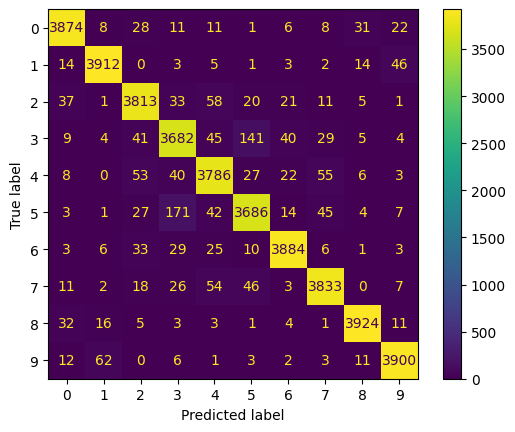

validation...


(Epoch 9 | 79/79) | Data: 0.063s | Batch: 0.095s | Loss: 0.7905| GPU usage: 1.772 GB: 100%|██████████| 79/79 [00:07<00:00, 10.47it/s]


validation loss: 0.80008
validation accuracy: 0.82756
validation precision: 0.81710
validation recall: 0.81710
validation F1-Score: 0.81882
[Epoch: 10 training...]


(Epoch 10 | 313/313) | Data: 0.059s | Batch: 0.125s | Loss: 0.1090 | GPU usage: 1.772 GB: 100%|██████████| 313/313 [00:39<00:00,  7.97it/s]


learning rate is 0.00036894342113765204
training loss: 0.10921
training accuracy: 0.96305
training precision: 0.96305
training recall: 0.96305
training F1-Score: 0.96304


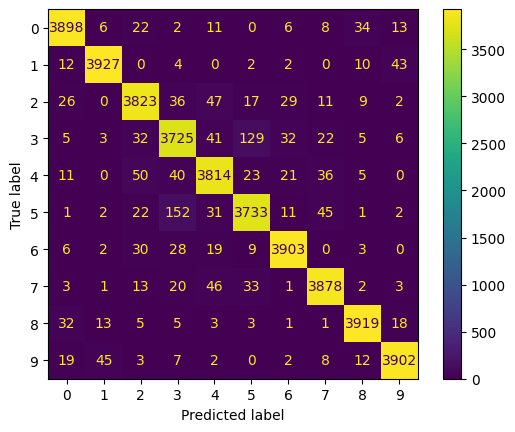

validation...


(Epoch 10 | 79/79) | Data: 0.060s | Batch: 0.091s | Loss: 0.7882| GPU usage: 1.772 GB: 100%|██████████| 79/79 [00:07<00:00, 10.95it/s]


validation loss: 0.78715
validation accuracy: 0.84080
validation precision: 0.83930
validation recall: 0.83930
validation F1-Score: 0.83857
[Epoch: 11 training...]


(Epoch 11 | 313/313) | Data: 0.059s | Batch: 0.124s | Loss: 0.0909 | GPU usage: 1.772 GB: 100%|██████████| 313/313 [00:38<00:00,  8.03it/s]


learning rate is 0.000361898890377802
training loss: 0.09087
training accuracy: 0.96995
training precision: 0.96996
training recall: 0.96995
training F1-Score: 0.96995


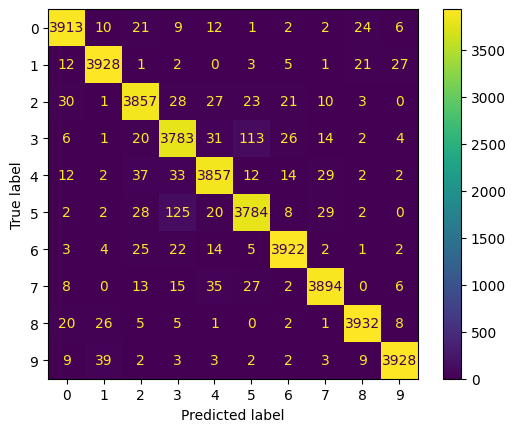

validation...


(Epoch 11 | 79/79) | Data: 0.060s | Batch: 0.090s | Loss: 0.6695| GPU usage: 1.772 GB: 100%|██████████| 79/79 [00:07<00:00, 11.05it/s]


validation loss: 0.67175
validation accuracy: 0.84354
validation precision: 0.83690
validation recall: 0.83690
validation F1-Score: 0.83798
saving with validation loss of 0.671750545501709
[Epoch: 12 training...]


(Epoch 12 | 313/313) | Data: 0.059s | Batch: 0.122s | Loss: 0.0760 | GPU usage: 1.772 GB: 100%|██████████| 313/313 [00:38<00:00,  8.16it/s]


learning rate is 0.00035421739193377
training loss: 0.07601
training accuracy: 0.97477
training precision: 0.97476
training recall: 0.97477
training F1-Score: 0.97477


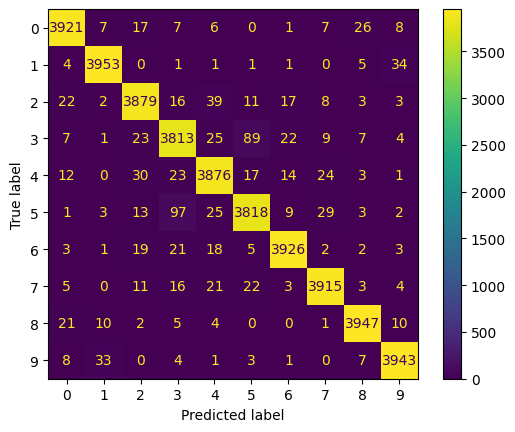

validation...


(Epoch 12 | 79/79) | Data: 0.060s | Batch: 0.088s | Loss: 0.6228| GPU usage: 1.772 GB: 100%|██████████| 79/79 [00:07<00:00, 11.22it/s]


validation loss: 0.62787
validation accuracy: 0.84713
validation precision: 0.84670
validation recall: 0.84670
validation F1-Score: 0.84684
saving with validation loss of 0.6278691291809082
[Epoch: 13 training...]


(Epoch 13 | 313/313) | Data: 0.060s | Batch: 0.126s | Loss: 0.0668 | GPU usage: 1.772 GB: 100%|██████████| 313/313 [00:39<00:00,  7.90it/s]


learning rate is 0.0003459292411705716
training loss: 0.06703
training accuracy: 0.97795
training precision: 0.97795
training recall: 0.97795
training F1-Score: 0.97795


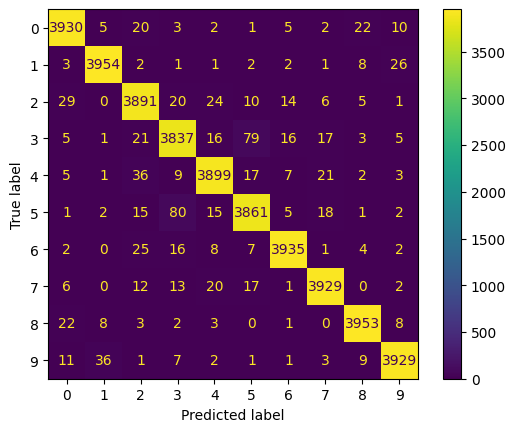

validation...


(Epoch 13 | 79/79) | Data: 0.061s | Batch: 0.090s | Loss: 0.6271| GPU usage: 1.772 GB: 100%|██████████| 79/79 [00:07<00:00, 10.99it/s]


validation loss: 0.62919
validation accuracy: 0.84601
validation precision: 0.83990
validation recall: 0.83990
validation F1-Score: 0.84156
saving with validation loss of 0.6291940212249756
[Epoch: 14 training...]


(Epoch 14 | 313/313) | Data: 0.060s | Batch: 0.121s | Loss: 0.0584 | GPU usage: 1.770 GB: 100%|██████████| 313/313 [00:38<00:00,  8.22it/s]


learning rate is 0.00033706714763277344
training loss: 0.05865
training accuracy: 0.98033
training precision: 0.98032
training recall: 0.98033
training F1-Score: 0.98032


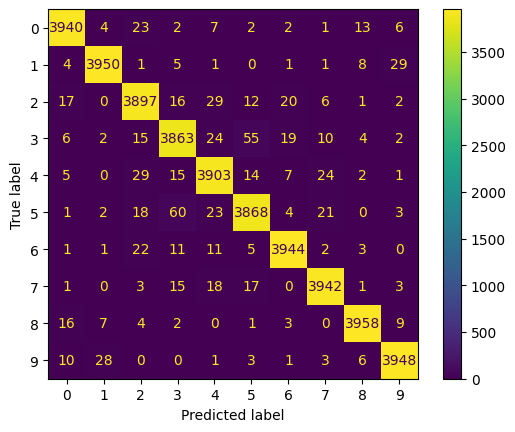

validation...


(Epoch 14 | 79/79) | Data: 0.062s | Batch: 0.092s | Loss: 0.6882| GPU usage: 1.770 GB: 100%|██████████| 79/79 [00:07<00:00, 10.86it/s]


validation loss: 0.68399
validation accuracy: 0.84542
validation precision: 0.83590
validation recall: 0.83590
validation F1-Score: 0.83752
[Epoch: 15 training...]


(Epoch 15 | 313/313) | Data: 0.060s | Batch: 0.123s | Loss: 0.0513 | GPU usage: 1.770 GB: 100%|██████████| 313/313 [00:38<00:00,  8.15it/s]


learning rate is 0.0003276660859548636
training loss: 0.05137
training accuracy: 0.98218
training precision: 0.98217
training recall: 0.98218
training F1-Score: 0.98217


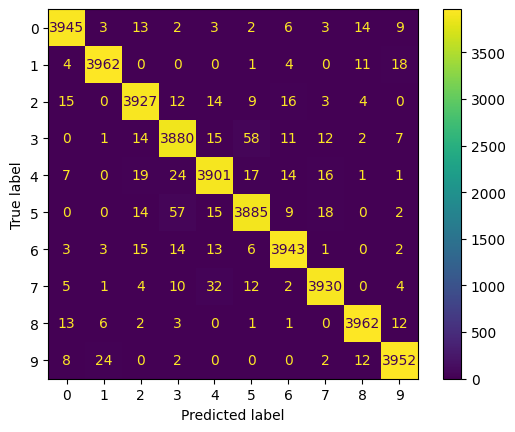

validation...


(Epoch 15 | 79/79) | Data: 0.062s | Batch: 0.092s | Loss: 0.9940| GPU usage: 1.770 GB: 100%|██████████| 79/79 [00:07<00:00, 10.77it/s]


validation loss: 0.98868
validation accuracy: 0.84885
validation precision: 0.84230
validation recall: 0.84230
validation F1-Score: 0.84429
[Epoch: 16 training...]


(Epoch 16 | 313/313) | Data: 0.059s | Batch: 0.124s | Loss: 0.0468 | GPU usage: 1.770 GB: 100%|██████████| 313/313 [00:38<00:00,  8.08it/s]


learning rate is 0.00031776315783234847
training loss: 0.04699
training accuracy: 0.98450
training precision: 0.98450
training recall: 0.98450
training F1-Score: 0.98450


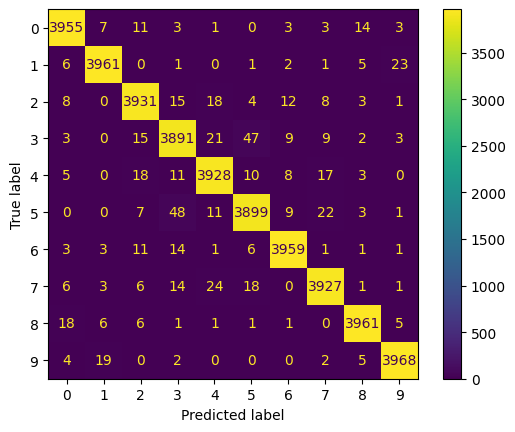

validation...


(Epoch 16 | 79/79) | Data: 0.063s | Batch: 0.095s | Loss: 0.6885| GPU usage: 1.770 GB: 100%|██████████| 79/79 [00:07<00:00, 10.42it/s]


validation loss: 0.68752
validation accuracy: 0.84410
validation precision: 0.84160
validation recall: 0.84160
validation F1-Score: 0.84154
[Epoch: 17 training...]


(Epoch 17 | 313/313) | Data: 0.060s | Batch: 0.124s | Loss: 0.0447 | GPU usage: 1.770 GB: 100%|██████████| 313/313 [00:39<00:00,  8.03it/s]


learning rate is 0.0003073974455983098
training loss: 0.04469
training accuracy: 0.98515
training precision: 0.98515
training recall: 0.98515
training F1-Score: 0.98515


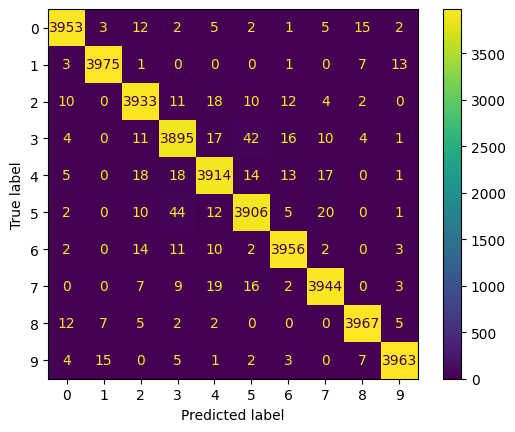

validation...


(Epoch 17 | 79/79) | Data: 0.060s | Batch: 0.091s | Loss: 0.7314| GPU usage: 1.770 GB: 100%|██████████| 79/79 [00:07<00:00, 10.95it/s]


validation loss: 0.73206
validation accuracy: 0.84489
validation precision: 0.84560
validation recall: 0.84560
validation F1-Score: 0.84438
[Epoch: 18 training...]


(Epoch 18 | 313/313) | Data: 0.059s | Batch: 0.124s | Loss: 0.0392 | GPU usage: 1.770 GB: 100%|██████████| 313/313 [00:38<00:00,  8.05it/s]


learning rate is 0.0002966098579832922
training loss: 0.03919
training accuracy: 0.98765
training precision: 0.98766
training recall: 0.98765
training F1-Score: 0.98765


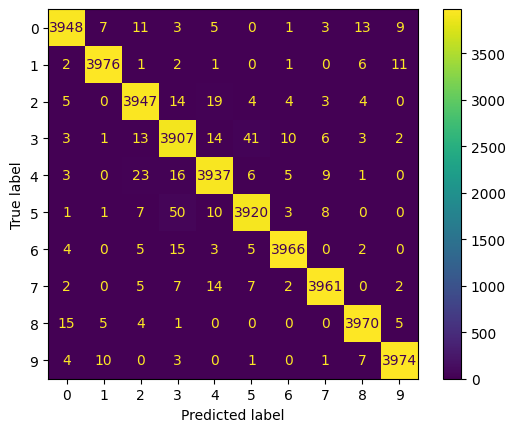

validation...


(Epoch 18 | 79/79) | Data: 0.062s | Batch: 0.093s | Loss: 0.7040| GPU usage: 1.770 GB: 100%|██████████| 79/79 [00:07<00:00, 10.64it/s]


validation loss: 0.69985
validation accuracy: 0.85152
validation precision: 0.85000
validation recall: 0.85000
validation F1-Score: 0.84966
[Epoch: 19 training...]


(Epoch 19 | 313/313) | Data: 0.059s | Batch: 0.123s | Loss: 0.0334 | GPU usage: 1.770 GB: 100%|██████████| 313/313 [00:38<00:00,  8.10it/s]


learning rate is 0.000285442968667232
training loss: 0.03356
training accuracy: 0.98925
training precision: 0.98925
training recall: 0.98925
training F1-Score: 0.98925


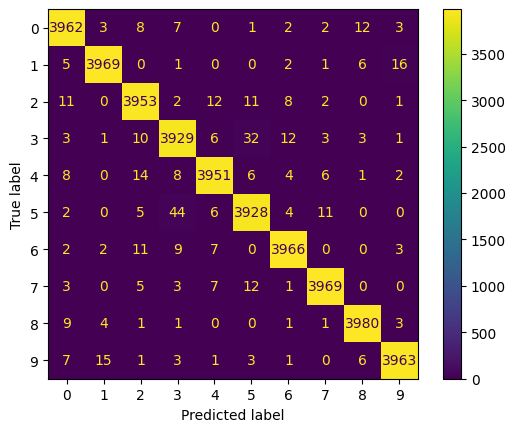

validation...


(Epoch 19 | 79/79) | Data: 0.062s | Batch: 0.093s | Loss: 0.6414| GPU usage: 1.770 GB: 100%|██████████| 79/79 [00:07<00:00, 10.73it/s]


validation loss: 0.64319
validation accuracy: 0.85853
validation precision: 0.85730
validation recall: 0.85730
validation F1-Score: 0.85759
saving with validation loss of 0.6431922912597656
[Epoch: 20 training...]


(Epoch 20 | 313/313) | Data: 0.059s | Batch: 0.123s | Loss: 0.0293 | GPU usage: 1.770 GB: 100%|██████████| 313/313 [00:38<00:00,  8.11it/s]


learning rate is 0.0002739408482605933
training loss: 0.02937
training accuracy: 0.99020
training precision: 0.99020
training recall: 0.99020
training F1-Score: 0.99020


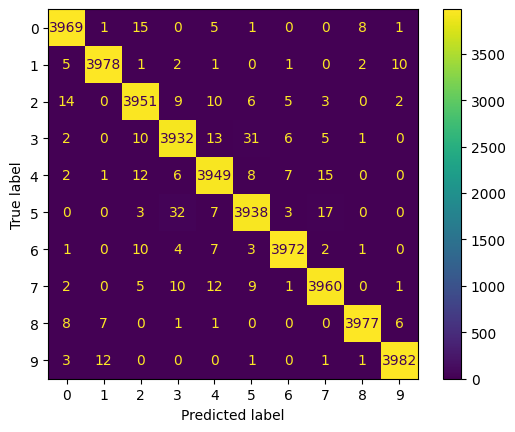

validation...


(Epoch 20 | 79/79) | Data: 0.060s | Batch: 0.088s | Loss: 0.7634| GPU usage: 1.770 GB: 100%|██████████| 79/79 [00:07<00:00, 11.25it/s]


validation loss: 0.77456
validation accuracy: 0.84425
validation precision: 0.84230
validation recall: 0.84230
validation F1-Score: 0.84194
[Epoch: 21 training...]


(Epoch 21 | 313/313) | Data: 0.059s | Batch: 0.126s | Loss: 0.0255 | GPU usage: 1.770 GB: 100%|██████████| 313/313 [00:39<00:00,  7.90it/s]


learning rate is 0.00026214889037780206
training loss: 0.02570
training accuracy: 0.99165
training precision: 0.99165
training recall: 0.99165
training F1-Score: 0.99165


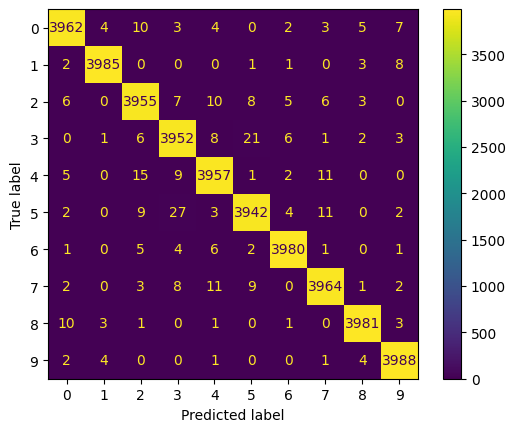

validation...


(Epoch 21 | 79/79) | Data: 0.057s | Batch: 0.085s | Loss: 0.6849| GPU usage: 1.770 GB: 100%|██████████| 79/79 [00:06<00:00, 11.72it/s]


validation loss: 0.68299
validation accuracy: 0.85631
validation precision: 0.85320
validation recall: 0.85320
validation F1-Score: 0.85392
[Epoch: 22 training...]


(Epoch 22 | 313/313) | Data: 0.059s | Batch: 0.121s | Loss: 0.0226 | GPU usage: 1.770 GB: 100%|██████████| 313/313 [00:38<00:00,  8.22it/s]


learning rate is 0.0002501136324893885
training loss: 0.02268
training accuracy: 0.99287
training precision: 0.99287
training recall: 0.99287
training F1-Score: 0.99287


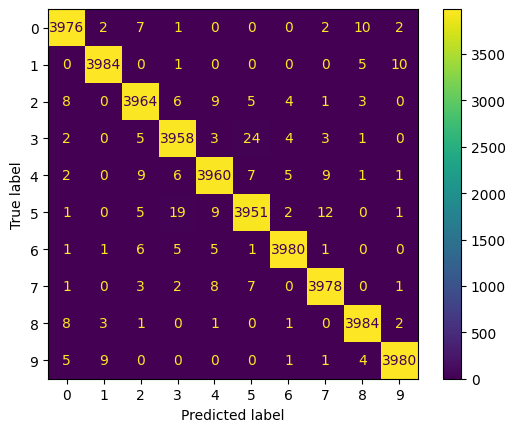

validation...


(Epoch 22 | 79/79) | Data: 0.061s | Batch: 0.090s | Loss: 0.6954| GPU usage: 1.770 GB: 100%|██████████| 79/79 [00:07<00:00, 10.99it/s]


validation loss: 0.69707
validation accuracy: 0.85894
validation precision: 0.85580
validation recall: 0.85580
validation F1-Score: 0.85640
[Epoch: 23 training...]


(Epoch 23 | 313/313) | Data: 0.059s | Batch: 0.124s | Loss: 0.0206 | GPU usage: 1.770 GB: 100%|██████████| 313/313 [00:38<00:00,  8.06it/s]


learning rate is 0.0002378825722598521
training loss: 0.02058
training accuracy: 0.99328
training precision: 0.99328
training recall: 0.99327
training F1-Score: 0.99328


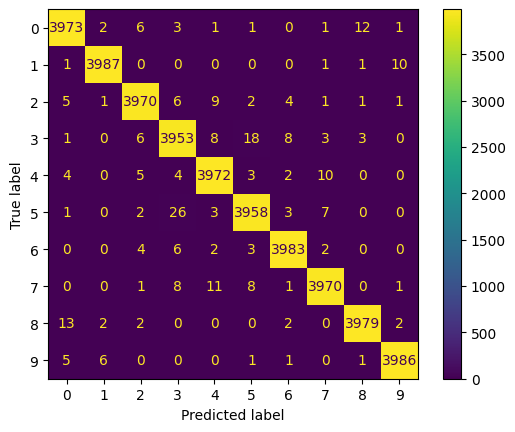

validation...


(Epoch 23 | 79/79) | Data: 0.060s | Batch: 0.089s | Loss: 0.6469| GPU usage: 1.770 GB: 100%|██████████| 79/79 [00:07<00:00, 11.13it/s]


validation loss: 0.64791
validation accuracy: 0.86314
validation precision: 0.86270
validation recall: 0.86270
validation F1-Score: 0.86239
saving with validation loss of 0.6479079723358154
[Epoch: 24 training...]


(Epoch 24 | 313/313) | Data: 0.060s | Batch: 0.125s | Loss: 0.0192 | GPU usage: 1.770 GB: 100%|██████████| 313/313 [00:39<00:00,  8.01it/s]


learning rate is 0.00022550398009607873
training loss: 0.01916
training accuracy: 0.99345
training precision: 0.99345
training recall: 0.99345
training F1-Score: 0.99345


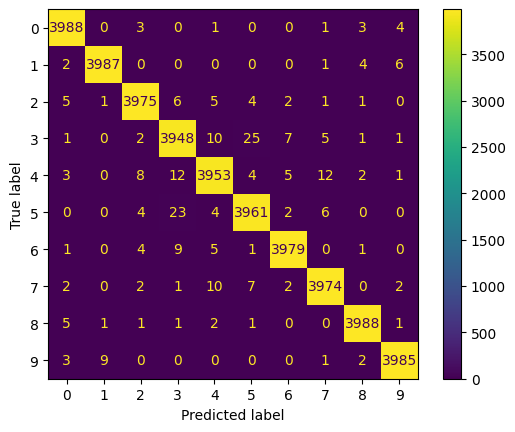

validation...


(Epoch 24 | 79/79) | Data: 0.061s | Batch: 0.095s | Loss: 0.7238| GPU usage: 1.766 GB: 100%|██████████| 79/79 [00:07<00:00, 10.44it/s]


validation loss: 0.72878
validation accuracy: 0.85580
validation precision: 0.85340
validation recall: 0.85340
validation F1-Score: 0.85411
[Epoch: 25 training...]


(Epoch 25 | 313/313) | Data: 0.059s | Batch: 0.122s | Loss: 0.0186 | GPU usage: 1.761 GB: 100%|██████████| 313/313 [00:38<00:00,  8.15it/s]


learning rate is 0.00021302670864609802
training loss: 0.01855
training accuracy: 0.99380
training precision: 0.99380
training recall: 0.99380
training F1-Score: 0.99380


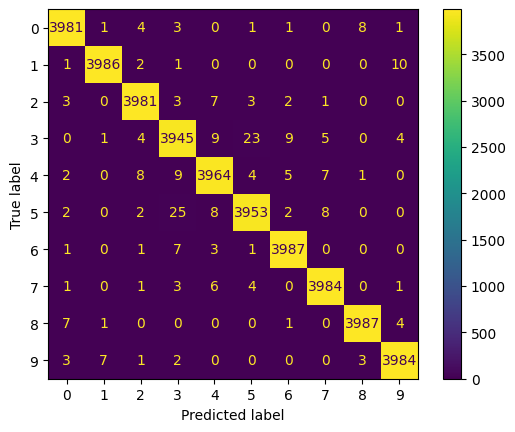

validation...


(Epoch 25 | 79/79) | Data: 0.061s | Batch: 0.092s | Loss: 0.6834| GPU usage: 1.761 GB: 100%|██████████| 79/79 [00:07<00:00, 10.84it/s]


validation loss: 0.68739
validation accuracy: 0.85918
validation precision: 0.85950
validation recall: 0.85950
validation F1-Score: 0.85893
[Epoch: 26 training...]


(Epoch 26 | 313/313) | Data: 0.059s | Batch: 0.125s | Loss: 0.0148 | GPU usage: 1.761 GB: 100%|██████████| 313/313 [00:39<00:00,  8.02it/s]


learning rate is 0.0002005
training loss: 0.01478
training accuracy: 0.99543
training precision: 0.99543
training recall: 0.99543
training F1-Score: 0.99542


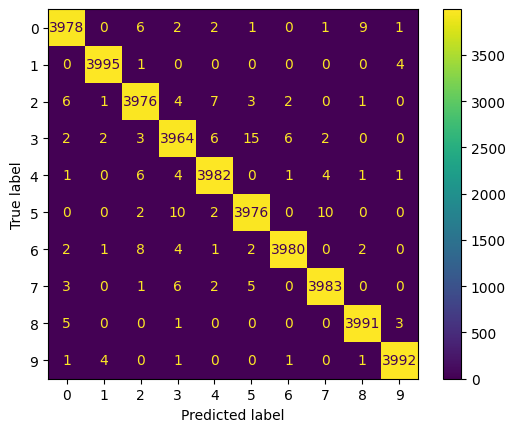

validation...


(Epoch 26 | 79/79) | Data: 0.063s | Batch: 0.095s | Loss: 0.7170| GPU usage: 1.761 GB: 100%|██████████| 79/79 [00:07<00:00, 10.50it/s]


validation loss: 0.71831
validation accuracy: 0.85744
validation precision: 0.85670
validation recall: 0.85670
validation F1-Score: 0.85619
[Epoch: 27 training...]


(Epoch 27 | 313/313) | Data: 0.060s | Batch: 0.124s | Loss: 0.0141 | GPU usage: 1.756 GB: 100%|██████████| 313/313 [00:38<00:00,  8.07it/s]


learning rate is 0.00018797329135390197
training loss: 0.01419
training accuracy: 0.99550
training precision: 0.99550
training recall: 0.99550
training F1-Score: 0.99550


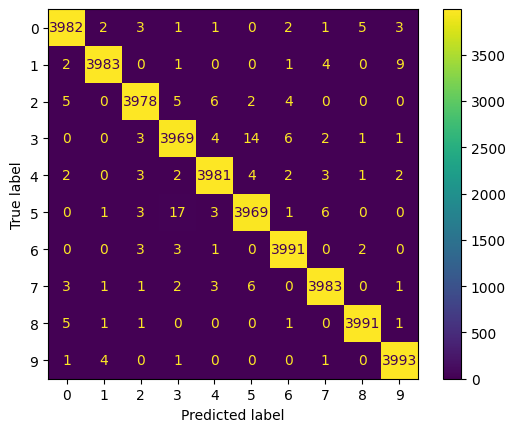

validation...


(Epoch 27 | 79/79) | Data: 0.059s | Batch: 0.087s | Loss: 0.6849| GPU usage: 1.759 GB: 100%|██████████| 79/79 [00:06<00:00, 11.39it/s]


validation loss: 0.68563
validation accuracy: 0.86712
validation precision: 0.86610
validation recall: 0.86610
validation F1-Score: 0.86636
[Epoch: 28 training...]


(Epoch 28 | 313/313) | Data: 0.058s | Batch: 0.123s | Loss: 0.0117 | GPU usage: 1.758 GB: 100%|██████████| 313/313 [00:38<00:00,  8.13it/s]


learning rate is 0.0001754960199039213
training loss: 0.01176
training accuracy: 0.99650
training precision: 0.99650
training recall: 0.99650
training F1-Score: 0.99650


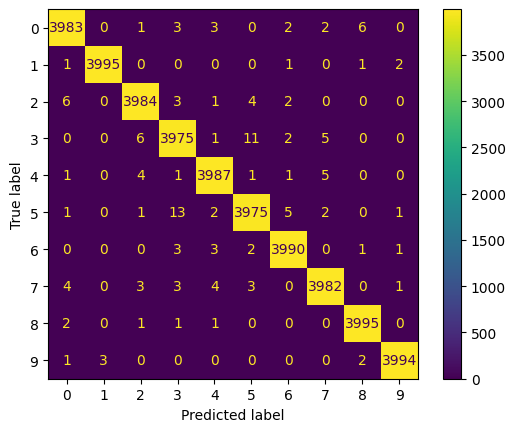

validation...


(Epoch 28 | 79/79) | Data: 0.060s | Batch: 0.088s | Loss: 0.7235| GPU usage: 1.758 GB: 100%|██████████| 79/79 [00:06<00:00, 11.30it/s]


validation loss: 0.72330
validation accuracy: 0.86200
validation precision: 0.86280
validation recall: 0.86280
validation F1-Score: 0.86177
[Epoch: 29 training...]


(Epoch 29 | 313/313) | Data: 0.059s | Batch: 0.123s | Loss: 0.0105 | GPU usage: 1.758 GB: 100%|██████████| 313/313 [00:38<00:00,  8.14it/s]


learning rate is 0.00016311742774014794
training loss: 0.01046
training accuracy: 0.99647
training precision: 0.99648
training recall: 0.99647
training F1-Score: 0.99648


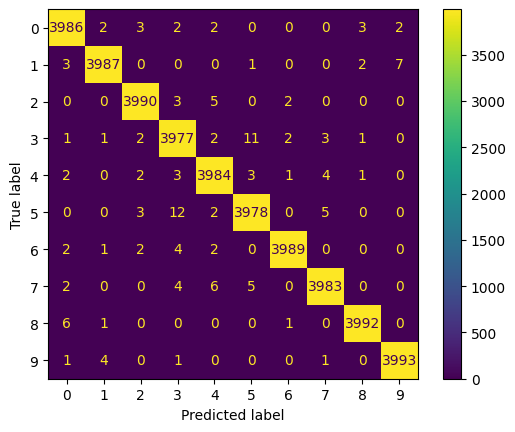

validation...


(Epoch 29 | 79/79) | Data: 0.059s | Batch: 0.087s | Loss: 0.7887| GPU usage: 1.758 GB: 100%|██████████| 79/79 [00:06<00:00, 11.43it/s]


validation loss: 0.78936
validation accuracy: 0.85898
validation precision: 0.85620
validation recall: 0.85620
validation F1-Score: 0.85667
[Epoch: 30 training...]


(Epoch 30 | 313/313) | Data: 0.059s | Batch: 0.121s | Loss: 0.0105 | GPU usage: 1.758 GB: 100%|██████████| 313/313 [00:37<00:00,  8.27it/s]


learning rate is 0.00015088636751061144
training loss: 0.01057
training accuracy: 0.99657
training precision: 0.99658
training recall: 0.99657
training F1-Score: 0.99658


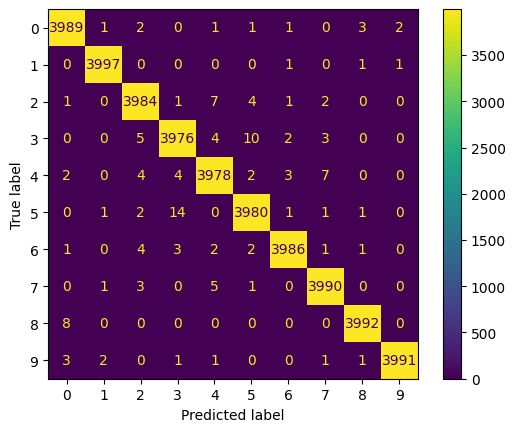

validation...


(Epoch 30 | 79/79) | Data: 0.061s | Batch: 0.091s | Loss: 0.7589| GPU usage: 1.758 GB: 100%|██████████| 79/79 [00:07<00:00, 10.97it/s]


validation loss: 0.75562
validation accuracy: 0.86680
validation precision: 0.86400
validation recall: 0.86400
validation F1-Score: 0.86450
[Epoch: 31 training...]


(Epoch 31 | 313/313) | Data: 0.059s | Batch: 0.123s | Loss: 0.0087 | GPU usage: 1.758 GB: 100%|██████████| 313/313 [00:38<00:00,  8.10it/s]


learning rate is 0.00013885110962219804
training loss: 0.00874
training accuracy: 0.99705
training precision: 0.99705
training recall: 0.99705
training F1-Score: 0.99705


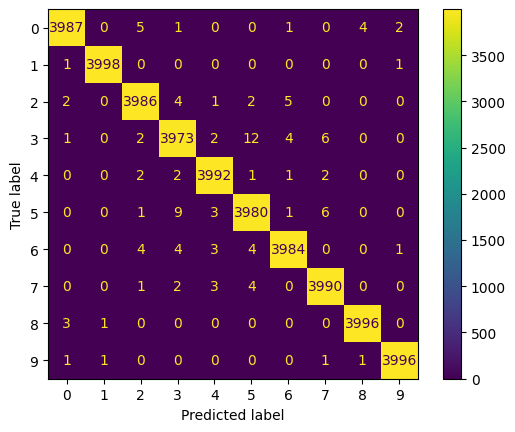

validation...


(Epoch 31 | 79/79) | Data: 0.061s | Batch: 0.091s | Loss: 0.7532| GPU usage: 1.758 GB: 100%|██████████| 79/79 [00:07<00:00, 10.86it/s]


validation loss: 0.75019
validation accuracy: 0.86482
validation precision: 0.86540
validation recall: 0.86540
validation F1-Score: 0.86481
[Epoch: 32 training...]


(Epoch 32 | 313/313) | Data: 0.060s | Batch: 0.125s | Loss: 0.0077 | GPU usage: 1.758 GB: 100%|██████████| 313/313 [00:39<00:00,  8.00it/s]


learning rate is 0.0001270591517394068
training loss: 0.00768
training accuracy: 0.99748
training precision: 0.99748
training recall: 0.99748
training F1-Score: 0.99748


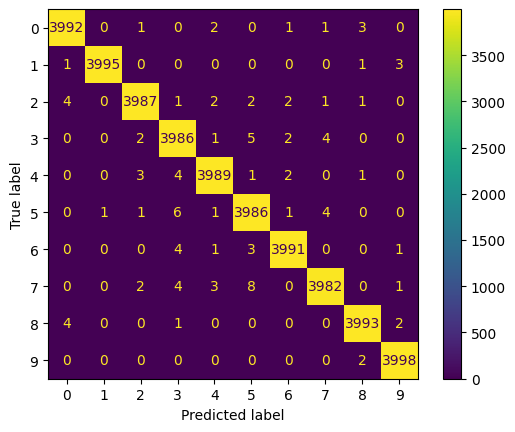

validation...


(Epoch 32 | 79/79) | Data: 0.062s | Batch: 0.092s | Loss: 0.7495| GPU usage: 1.758 GB: 100%|██████████| 79/79 [00:07<00:00, 10.84it/s]


validation loss: 0.74708
validation accuracy: 0.86460
validation precision: 0.86290
validation recall: 0.86290
validation F1-Score: 0.86326
[Epoch: 33 training...]


(Epoch 33 | 313/313) | Data: 0.052s | Batch: 0.104s | Loss: 0.0069 | GPU usage: 1.758 GB: 100%|██████████| 313/313 [00:32<00:00,  9.63it/s]


learning rate is 0.000115557031332768
training loss: 0.00687
training accuracy: 0.99752
training precision: 0.99753
training recall: 0.99752
training F1-Score: 0.99752


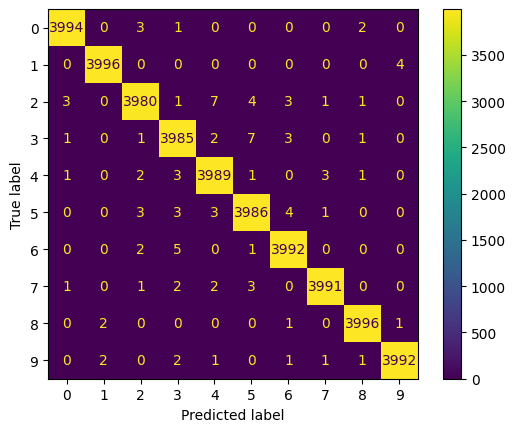

validation...


(Epoch 33 | 79/79) | Data: 0.050s | Batch: 0.076s | Loss: 0.7605| GPU usage: 1.758 GB: 100%|██████████| 79/79 [00:06<00:00, 12.98it/s]


validation loss: 0.75880
validation accuracy: 0.86384
validation precision: 0.86360
validation recall: 0.86360
validation F1-Score: 0.86330
[Epoch: 34 training...]


(Epoch 34 | 313/313) | Data: 0.052s | Batch: 0.106s | Loss: 0.0063 | GPU usage: 1.758 GB: 100%|██████████| 313/313 [00:33<00:00,  9.46it/s]


learning rate is 0.00010439014201670777
training loss: 0.00629
training accuracy: 0.99800
training precision: 0.99800
training recall: 0.99800
training F1-Score: 0.99800


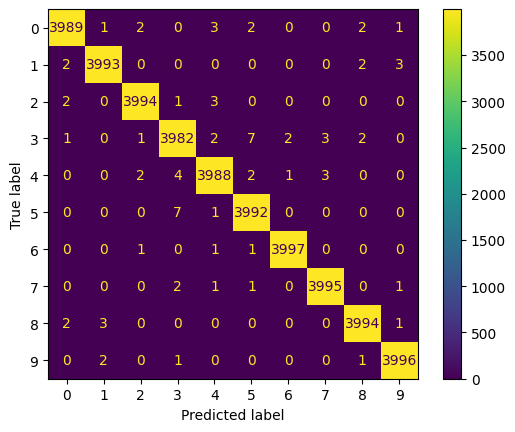

validation...


(Epoch 34 | 79/79) | Data: 0.049s | Batch: 0.075s | Loss: 0.7482| GPU usage: 1.758 GB: 100%|██████████| 79/79 [00:06<00:00, 13.14it/s]


validation loss: 0.74430
validation accuracy: 0.86719
validation precision: 0.86710
validation recall: 0.86710
validation F1-Score: 0.86648
[Epoch: 35 training...]


(Epoch 35 | 313/313) | Data: 0.058s | Batch: 0.119s | Loss: 0.0045 | GPU usage: 1.758 GB: 100%|██████████| 313/313 [00:37<00:00,  8.37it/s]


learning rate is 9.360255440169011e-05
training loss: 0.00452
training accuracy: 0.99855
training precision: 0.99855
training recall: 0.99855
training F1-Score: 0.99855


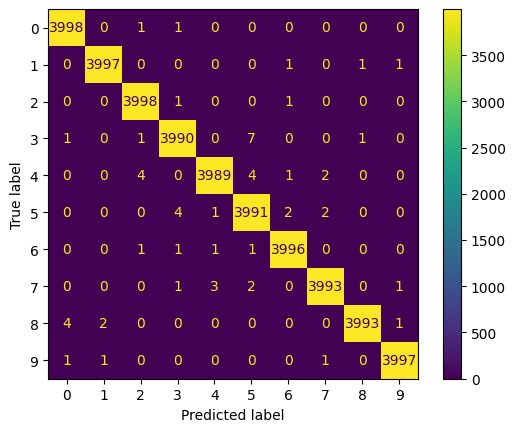

validation...


(Epoch 35 | 79/79) | Data: 0.060s | Batch: 0.092s | Loss: 0.7579| GPU usage: 1.758 GB: 100%|██████████| 79/79 [00:07<00:00, 10.75it/s]


validation loss: 0.75793
validation accuracy: 0.87028
validation precision: 0.87050
validation recall: 0.87050
validation F1-Score: 0.87029
[Epoch: 36 training...]


(Epoch 36 | 313/313) | Data: 0.060s | Batch: 0.125s | Loss: 0.0045 | GPU usage: 1.758 GB: 100%|██████████| 313/313 [00:39<00:00,  7.99it/s]


learning rate is 8.323684216765163e-05
training loss: 0.00451
training accuracy: 0.99882
training precision: 0.99883
training recall: 0.99883
training F1-Score: 0.99883


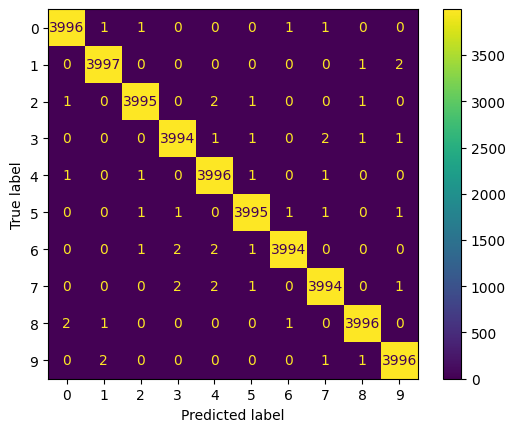

validation...


(Epoch 36 | 79/79) | Data: 0.052s | Batch: 0.080s | Loss: 0.7516| GPU usage: 1.758 GB: 100%|██████████| 79/79 [00:06<00:00, 12.40it/s]


validation loss: 0.74879
validation accuracy: 0.86993
validation precision: 0.86960
validation recall: 0.86960
validation F1-Score: 0.86941
[Epoch: 37 training...]


(Epoch 37 | 313/313) | Data: 0.049s | Batch: 0.099s | Loss: 0.0039 | GPU usage: 1.758 GB: 100%|██████████| 313/313 [00:31<00:00, 10.08it/s]


learning rate is 7.33339140451364e-05
training loss: 0.00388
training accuracy: 0.99885
training precision: 0.99885
training recall: 0.99885
training F1-Score: 0.99885


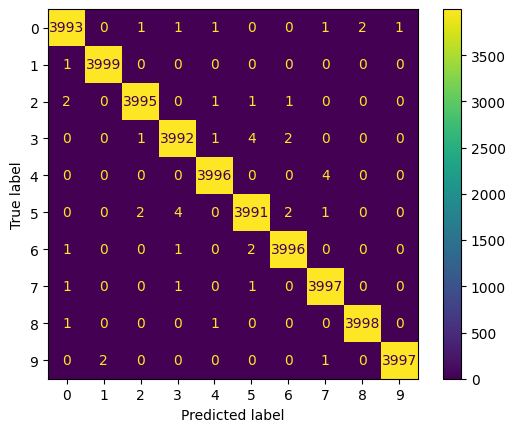

validation...


(Epoch 37 | 79/79) | Data: 0.049s | Batch: 0.075s | Loss: 0.7828| GPU usage: 1.758 GB: 100%|██████████| 79/79 [00:05<00:00, 13.20it/s]


validation loss: 0.77928
validation accuracy: 0.86796
validation precision: 0.86810
validation recall: 0.86810
validation F1-Score: 0.86779
[Epoch: 38 training...]


(Epoch 38 | 313/313) | Data: 0.050s | Batch: 0.097s | Loss: 0.0032 | GPU usage: 1.758 GB: 100%|██████████| 313/313 [00:30<00:00, 10.27it/s]


learning rate is 6.39328523672266e-05
training loss: 0.00320
training accuracy: 0.99895
training precision: 0.99895
training recall: 0.99895
training F1-Score: 0.99895


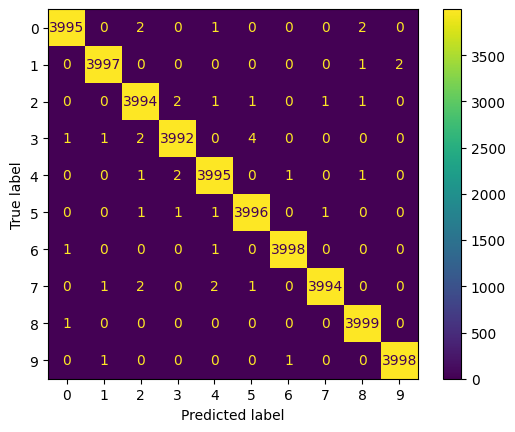

validation...


(Epoch 38 | 79/79) | Data: 0.048s | Batch: 0.074s | Loss: 0.7569| GPU usage: 1.758 GB: 100%|██████████| 79/79 [00:05<00:00, 13.38it/s]


validation loss: 0.75818
validation accuracy: 0.87237
validation precision: 0.87190
validation recall: 0.87190
validation F1-Score: 0.87197
[Epoch: 39 training...]


(Epoch 39 | 313/313) | Data: 0.055s | Batch: 0.114s | Loss: 0.0037 | GPU usage: 1.758 GB: 100%|██████████| 313/313 [00:35<00:00,  8.75it/s]


learning rate is 5.507075882942844e-05
training loss: 0.00369
training accuracy: 0.99887
training precision: 0.99888
training recall: 0.99887
training F1-Score: 0.99888


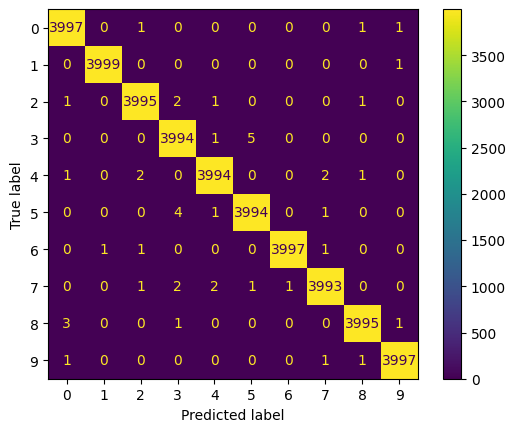

validation...


(Epoch 39 | 79/79) | Data: 0.063s | Batch: 0.094s | Loss: 0.7548| GPU usage: 1.758 GB: 100%|██████████| 79/79 [00:07<00:00, 10.61it/s]


validation loss: 0.75316
validation accuracy: 0.87382
validation precision: 0.87310
validation recall: 0.87310
validation F1-Score: 0.87323
[Epoch: 40 training...]


(Epoch 40 | 313/313) | Data: 0.060s | Batch: 0.124s | Loss: 0.0028 | GPU usage: 1.758 GB: 100%|██████████| 313/313 [00:39<00:00,  8.02it/s]


learning rate is 4.6782608066230065e-05
training loss: 0.00279
training accuracy: 0.99920
training precision: 0.99920
training recall: 0.99920
training F1-Score: 0.99920


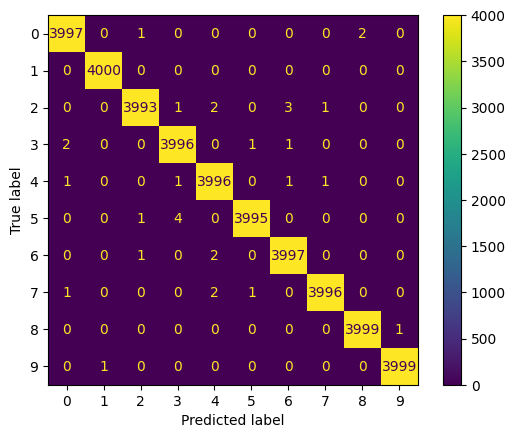

validation...


(Epoch 40 | 79/79) | Data: 0.062s | Batch: 0.093s | Loss: 0.7588| GPU usage: 1.758 GB: 100%|██████████| 79/79 [00:07<00:00, 10.72it/s]


validation loss: 0.75616
validation accuracy: 0.87524
validation precision: 0.87490
validation recall: 0.87490
validation F1-Score: 0.87498
[Epoch: 41 training...]


(Epoch 41 | 313/313) | Data: 0.060s | Batch: 0.124s | Loss: 0.0035 | GPU usage: 1.758 GB: 100%|██████████| 313/313 [00:38<00:00,  8.08it/s]


learning rate is 3.9101109622198e-05
training loss: 0.00348
training accuracy: 0.99895
training precision: 0.99895
training recall: 0.99895
training F1-Score: 0.99895


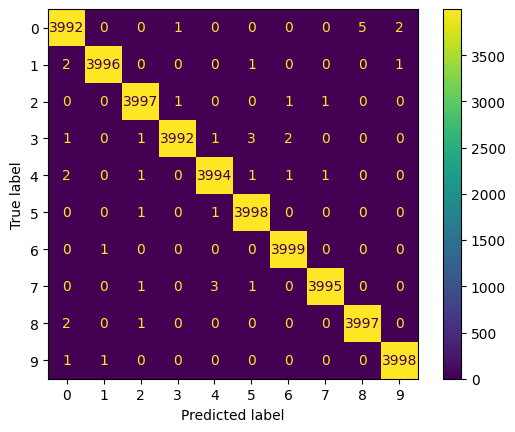

validation...


(Epoch 41 | 79/79) | Data: 0.060s | Batch: 0.089s | Loss: 0.7556| GPU usage: 1.758 GB: 100%|██████████| 79/79 [00:07<00:00, 11.21it/s]


validation loss: 0.75374
validation accuracy: 0.87495
validation precision: 0.87470
validation recall: 0.87470
validation F1-Score: 0.87472
[Epoch: 42 training...]


(Epoch 42 | 313/313) | Data: 0.058s | Batch: 0.124s | Loss: 0.0026 | GPU usage: 1.758 GB: 100%|██████████| 313/313 [00:38<00:00,  8.06it/s]


learning rate is 3.2056578862348035e-05
training loss: 0.00261
training accuracy: 0.99928
training precision: 0.99928
training recall: 0.99928
training F1-Score: 0.99927


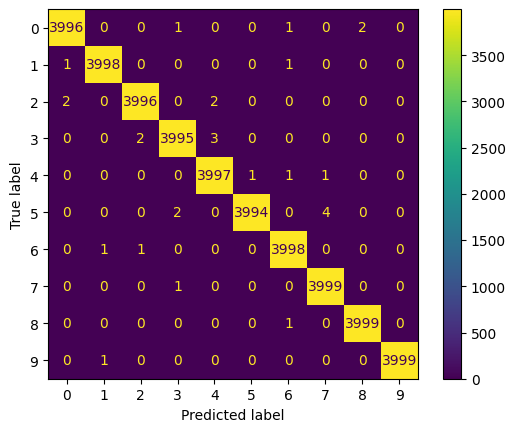

validation...


(Epoch 42 | 79/79) | Data: 0.059s | Batch: 0.089s | Loss: 0.7789| GPU usage: 1.758 GB: 100%|██████████| 79/79 [00:07<00:00, 11.18it/s]


validation loss: 0.77521
validation accuracy: 0.87250
validation precision: 0.87240
validation recall: 0.87240
validation F1-Score: 0.87220
[Epoch: 43 training...]


(Epoch 43 | 313/313) | Data: 0.054s | Batch: 0.109s | Loss: 0.0021 | GPU usage: 1.758 GB: 100%|██████████| 313/313 [00:34<00:00,  9.13it/s]


learning rate is 2.5676817331249216e-05
training loss: 0.00208
training accuracy: 0.99945
training precision: 0.99945
training recall: 0.99945
training F1-Score: 0.99945


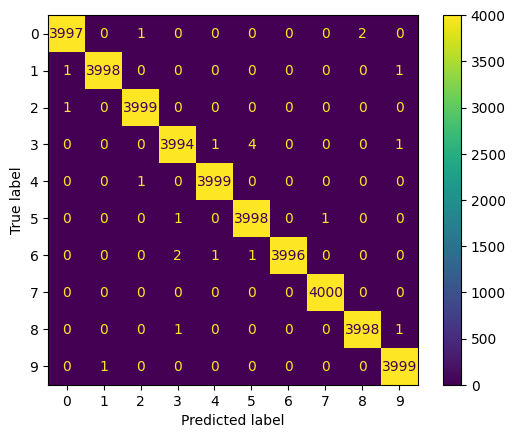

validation...


(Epoch 43 | 79/79) | Data: 0.059s | Batch: 0.092s | Loss: 0.7994| GPU usage: 1.758 GB: 100%|██████████| 79/79 [00:07<00:00, 10.81it/s]


validation loss: 0.79549
validation accuracy: 0.87348
validation precision: 0.87330
validation recall: 0.87330
validation F1-Score: 0.87303
[Epoch: 44 training...]


(Epoch 44 | 313/313) | Data: 0.058s | Batch: 0.121s | Loss: 0.0016 | GPU usage: 1.758 GB: 100%|██████████| 313/313 [00:37<00:00,  8.28it/s]


learning rate is 1.998700303302914e-05
training loss: 0.00159
training accuracy: 0.99948
training precision: 0.99948
training recall: 0.99948
training F1-Score: 0.99948


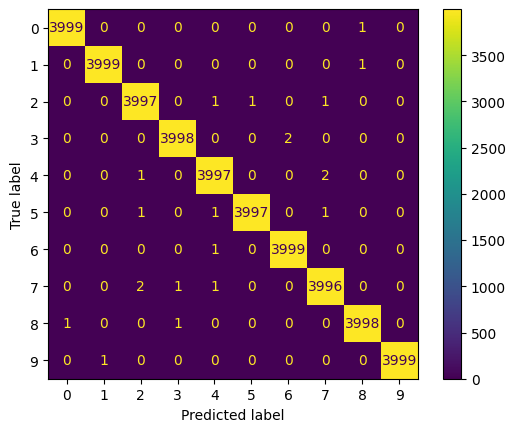

validation...


(Epoch 44 | 79/79) | Data: 0.060s | Batch: 0.087s | Loss: 0.8029| GPU usage: 1.758 GB: 100%|██████████| 79/79 [00:06<00:00, 11.43it/s]


validation loss: 0.80010
validation accuracy: 0.86903
validation precision: 0.86920
validation recall: 0.86920
validation F1-Score: 0.86900
[Epoch: 45 training...]


(Epoch 45 | 313/313) | Data: 0.052s | Batch: 0.103s | Loss: 0.0022 | GPU usage: 1.758 GB: 100%|██████████| 313/313 [00:32<00:00,  9.71it/s]


learning rate is 1.5009591065293856e-05
training loss: 0.00222
training accuracy: 0.99930
training precision: 0.99930
training recall: 0.99930
training F1-Score: 0.99930


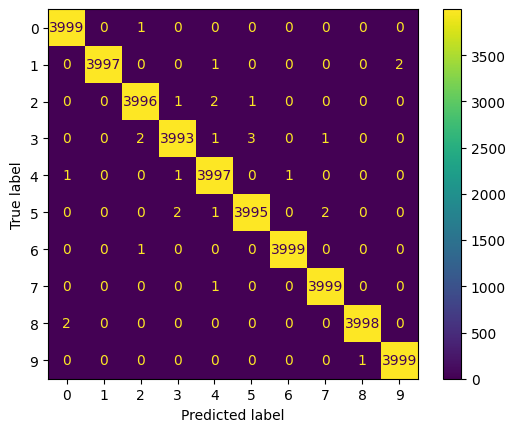

validation...


(Epoch 45 | 79/79) | Data: 0.051s | Batch: 0.075s | Loss: 0.7941| GPU usage: 1.758 GB: 100%|██████████| 79/79 [00:05<00:00, 13.27it/s]


validation loss: 0.78961
validation accuracy: 0.87247
validation precision: 0.87230
validation recall: 0.87230
validation F1-Score: 0.87222
[Epoch: 46 training...]


(Epoch 46 | 313/313) | Data: 0.056s | Batch: 0.120s | Loss: 0.0020 | GPU usage: 1.758 GB: 100%|██████████| 313/313 [00:37<00:00,  8.33it/s]


learning rate is 1.0764224999116871e-05
training loss: 0.00202
training accuracy: 0.99935
training precision: 0.99935
training recall: 0.99935
training F1-Score: 0.99935


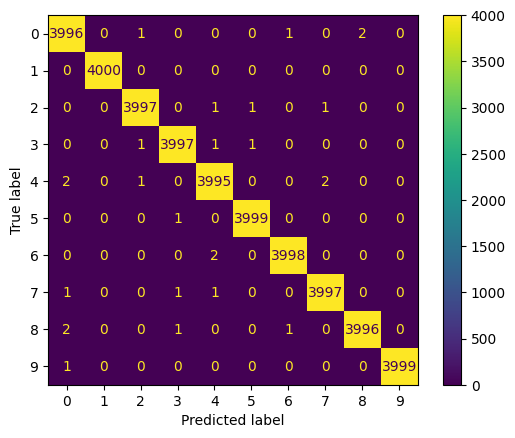

validation...


(Epoch 46 | 79/79) | Data: 0.061s | Batch: 0.091s | Loss: 0.7883| GPU usage: 1.758 GB: 100%|██████████| 79/79 [00:07<00:00, 10.94it/s]


validation loss: 0.78653
validation accuracy: 0.87264
validation precision: 0.87210
validation recall: 0.87210
validation F1-Score: 0.87217
[Epoch: 47 training...]


(Epoch 47 | 313/313) | Data: 0.060s | Batch: 0.124s | Loss: 0.0020 | GPU usage: 1.758 GB: 100%|██████████| 313/313 [00:38<00:00,  8.03it/s]


learning rate is 7.267659354838122e-06
training loss: 0.00205
training accuracy: 0.99948
training precision: 0.99948
training recall: 0.99948
training F1-Score: 0.99948


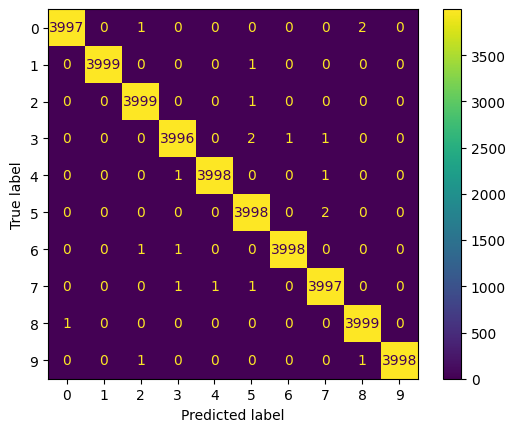

validation...


(Epoch 47 | 79/79) | Data: 0.059s | Batch: 0.087s | Loss: 0.7863| GPU usage: 1.758 GB: 100%|██████████| 79/79 [00:06<00:00, 11.40it/s]


validation loss: 0.78404
validation accuracy: 0.87436
validation precision: 0.87410
validation recall: 0.87410
validation F1-Score: 0.87404
[Epoch: 48 training...]


(Epoch 48 | 313/313) | Data: 0.052s | Batch: 0.104s | Loss: 0.0019 | GPU usage: 1.758 GB: 100%|██████████| 313/313 [00:32<00:00,  9.60it/s]


learning rate is 4.5336934796266e-06
training loss: 0.00190
training accuracy: 0.99948
training precision: 0.99948
training recall: 0.99948
training F1-Score: 0.99948


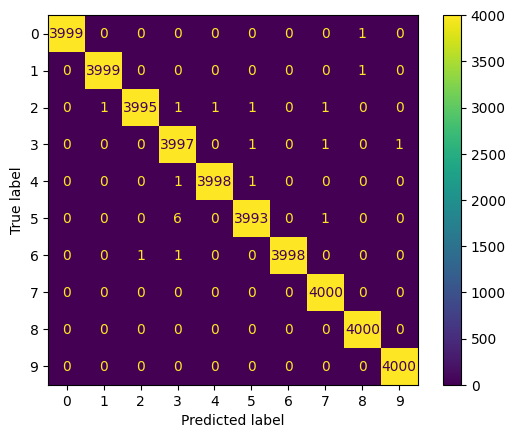

validation...


(Epoch 48 | 79/79) | Data: 0.048s | Batch: 0.073s | Loss: 0.8059| GPU usage: 1.758 GB: 100%|██████████| 79/79 [00:05<00:00, 13.61it/s]


validation loss: 0.80297
validation accuracy: 0.87144
validation precision: 0.87110
validation recall: 0.87110
validation F1-Score: 0.87104
[Epoch: 49 training...]


(Epoch 49 | 313/313) | Data: 0.049s | Batch: 0.098s | Loss: 0.0021 | GPU usage: 1.758 GB: 100%|██████████| 313/313 [00:30<00:00, 10.24it/s]


learning rate is 2.5731170877616857e-06
training loss: 0.00210
training accuracy: 0.99948
training precision: 0.99948
training recall: 0.99948
training F1-Score: 0.99948


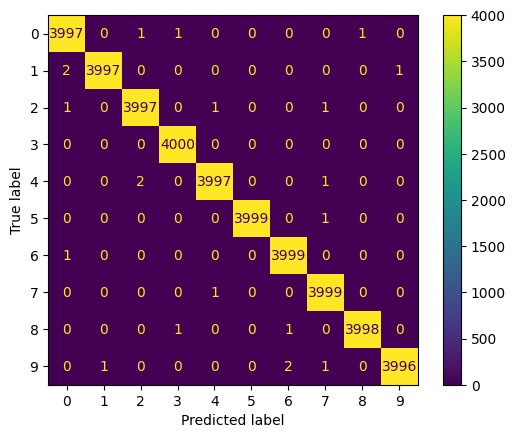

validation...


(Epoch 49 | 79/79) | Data: 0.051s | Batch: 0.077s | Loss: 0.7858| GPU usage: 1.758 GB: 100%|██████████| 79/79 [00:06<00:00, 12.96it/s]


validation loss: 0.78473
validation accuracy: 0.87019
validation precision: 0.87000
validation recall: 0.87000
validation F1-Score: 0.86974
[Epoch: 50 training...]


(Epoch 50 | 313/313) | Data: 0.050s | Batch: 0.099s | Loss: 0.0019 | GPU usage: 1.758 GB: 100%|██████████| 313/313 [00:31<00:00, 10.08it/s]


learning rate is 1.393667678559824e-06
training loss: 0.00190
training accuracy: 0.99945
training precision: 0.99945
training recall: 0.99945
training F1-Score: 0.99945


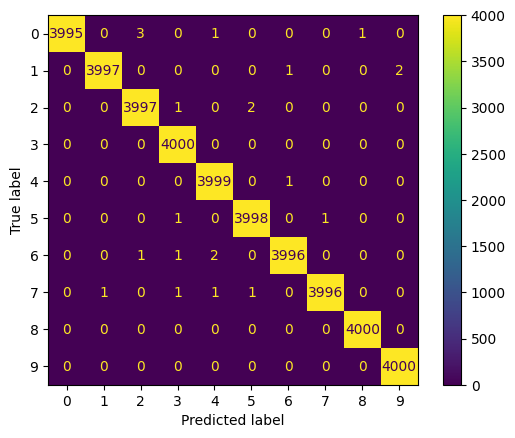

validation...


(Epoch 50 | 79/79) | Data: 0.059s | Batch: 0.088s | Loss: 0.8067| GPU usage: 1.758 GB: 100%|██████████| 79/79 [00:07<00:00, 11.27it/s]


validation loss: 0.80335
validation accuracy: 0.87081
validation precision: 0.87070
validation recall: 0.87070
validation F1-Score: 0.87052


In [46]:
training_funcs.train_model(model, train_loader, num_epochs, writer_train, writer_val, device, val_loader, optimizer, criterion, num_classes, scheduler, training_des, lr, model_name, save_dir, grad_accum, start_epoch, min_loss_diff, min_loss_mean, scaler)
